<a href="https://colab.research.google.com/github/RNTUNOOB/Image_generation/blob/main/GAN0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# libraries
import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

In [ ]:
# visualizing function

def show(tensor, ch=1, size=(28,28), num=16):
  # incoming tensor size = 128 x 784    ----------128(batch size) x 784 (28*28)

  data = tensor.detach().cpu().view(-1, ch, *size)   # 128 x 1 x 28 x 28
  grid = make_grid(data[:num], nrow = 4).permute(1,2,0)    # return first 16 from data 16 x 1 x 28 x 28 --nrow-- [ 16 = 4x4 ]   --permute-- 1 x 28x 28 => 28 x 28 x 1
  plt.imshow(grid)
  plt.show()

In [ ]:
# setup for main parameters and hyperparmeters

epochs = 500
cur_step = 0
info_step = 300
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64
lr = 0.00001
loss_func = nn.BCEWithLogitsLoss()

bs = 128
device = 'cuda'

dataloader = DataLoader(MNIST('.', download=True, transform=transforms.ToTensor()),shuffle=True, batch_size = bs)

In [ ]:
# declare a generator

#generatr

def genblock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.BatchNorm1d(out),
      nn.ReLU(inplace = True)
  )


class Generator(nn.Module):

  def __init__(self, z_dim = 64, i_dim = 784, h_dim = 128):
    super().__init__()
    self.gen = nn.Sequential(
        genblock(z_dim, h_dim),      # 64 x 128
        genblock(h_dim, h_dim*2),    # 128 x 256
        genblock(h_dim*2, h_dim*4),  # 256 x 512
        genblock(h_dim*4, h_dim*8),  # 512 x 1024
        nn.Linear(h_dim*8, i_dim),    # 1024 x 784
        nn.Sigmoid()
    )

  def forward(self,noise):
    return self.gen(noise)

def gen_noise(number, z_dim):
  return torch.randn(number, z_dim).to(device)


# discriminator

def discblock(inp, out):
  return nn.Sequential(
      nn.Linear(inp, out),
      nn.LeakyReLU(0.2)
  )


class Discriminator(nn.Module):

  def __init__(self, i_dim=784, h_dim = 256):
    super().__init__()
    self.disc = nn.Sequential(
        discblock(i_dim, h_dim*4),    # 784 x 1024
        discblock(h_dim*4, h_dim*2),  # 1024 x 512
        discblock(h_dim*2, h_dim),    # 512 x 256
        nn.Linear(h_dim, 1)           # 256 x 1
    )

  def forward(self, image):
    return self.disc(image)

In [ ]:
gen  = Generator(z_dim).to(device)
gen_opti = torch.optim.Adam(gen.parameters(), lr = lr)
disc = Discriminator().to(device)
disc_opti = torch.optim.Adam(disc.parameters(), lr = lr)

In [ ]:
gen


Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=64, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

In [ ]:
disc


Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Linear(in_features=784, out_features=1024, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (1): Sequential(
      (0): Linear(in_features=1024, out_features=512, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (2): Sequential(
      (0): Linear(in_features=512, out_features=256, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (3): Linear(in_features=256, out_features=1, bias=True)
  )
)

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([8, 2, 8, 0, 9, 6, 1, 1, 0, 8])


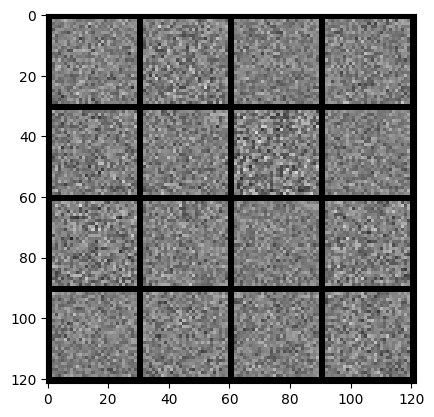

In [ ]:
# iteration

x,y = next(iter(dataloader))
print(x.shape, y.shape)
print(y[:10])

noise = gen_noise(bs, z_dim)
fake = gen(noise)

show(fake)

In [ ]:
# generator loss

def calc_gen_loss(loss_func, gen, disc, number, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  pred = disc(fake)
  target = torch.ones_like(pred)
  gen_loss = loss_func(pred, target)

  return gen_loss

def calc_disc_loss(loss_func, gen, disc, number, real, z_dim):
  noise = gen_noise(number, z_dim)
  fake = gen(noise)
  fake_pred = disc(fake.detach())
  fake_pred_target = torch.zeros_like(fake_pred)
  fake_pred_loss = loss_func(fake_pred, fake_pred_target)

  real_pred = disc(real)
  real_pred_target = torch.ones_like(real_pred)
  real_pred_loss = loss_func(real_pred, real_pred_target)

  return (fake_pred_loss + real_pred_loss)/2

  0%|          | 0/469 [00:00<?, ?it/s]

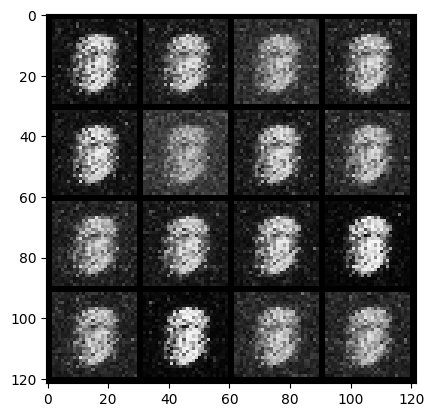

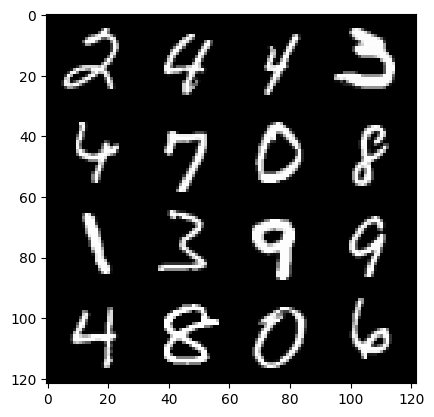

0: step 300/ gen loss: 1.845826004942258 / disc loss: 0.3445556672414141


  0%|          | 0/469 [00:00<?, ?it/s]

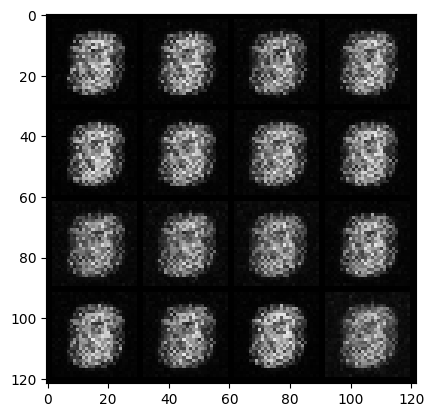

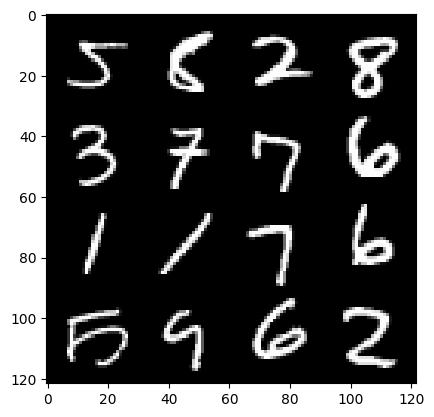

1: step 600/ gen loss: 3.372421867847443 / disc loss: 0.12160689773658911


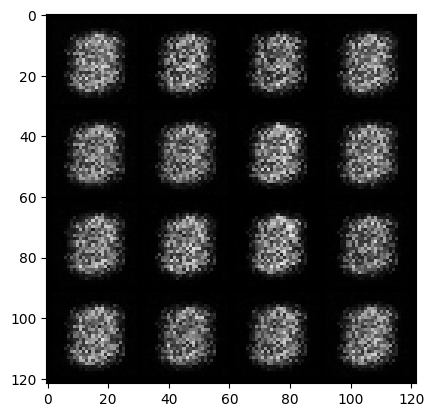

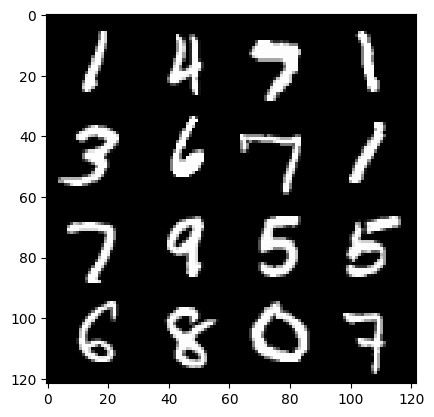

1: step 900/ gen loss: 3.3940729157129925 / disc loss: 0.057178766566018314


  0%|          | 0/469 [00:00<?, ?it/s]

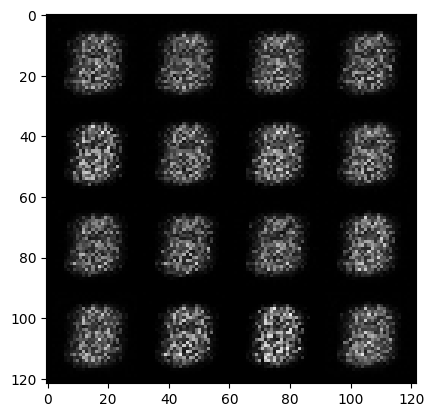

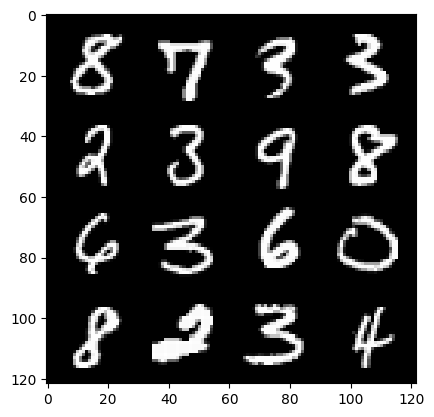

2: step 1200/ gen loss: 3.4564119458198546 / disc loss: 0.03922204951445262


  0%|          | 0/469 [00:00<?, ?it/s]

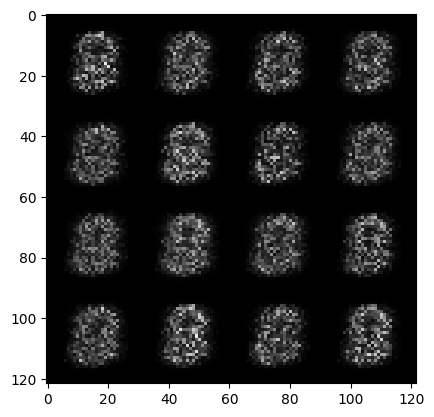

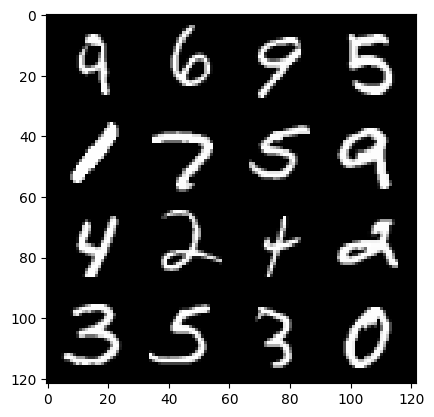

3: step 1500/ gen loss: 3.409631785551707 / disc loss: 0.04091457467526195


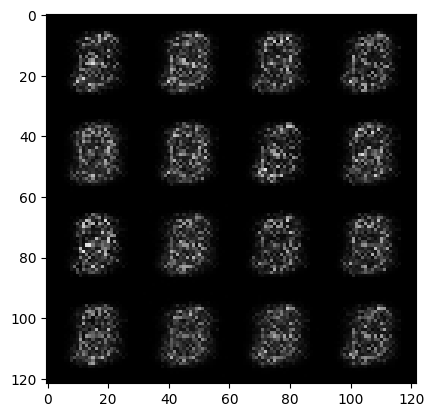

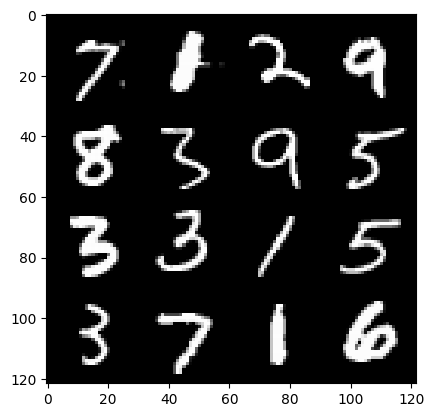

3: step 1800/ gen loss: 3.3979369616508497 / disc loss: 0.04346484503398342


  0%|          | 0/469 [00:00<?, ?it/s]

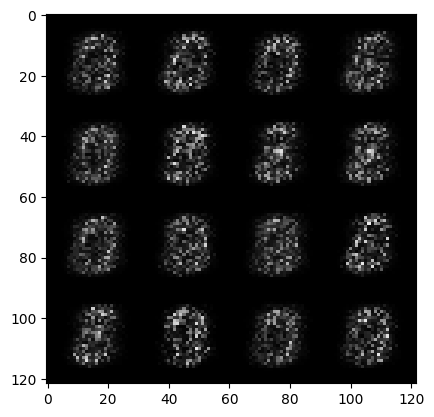

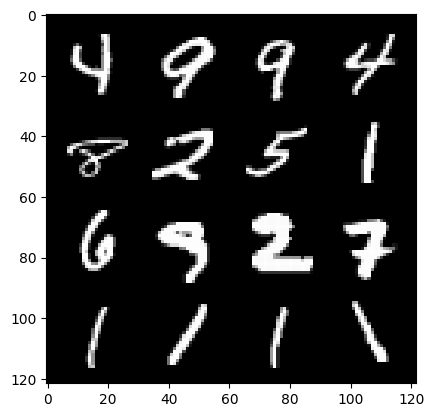

4: step 2100/ gen loss: 3.6991569066047676 / disc loss: 0.03656555807217953


  0%|          | 0/469 [00:00<?, ?it/s]

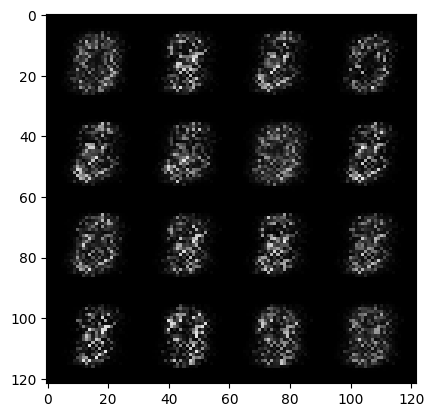

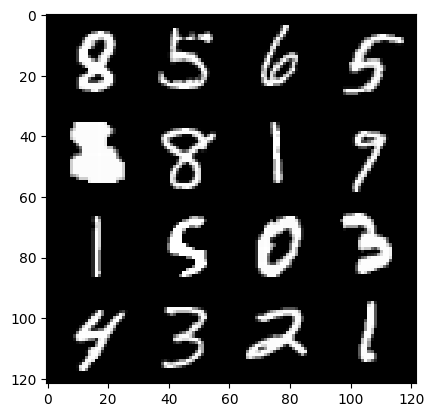

5: step 2400/ gen loss: 3.9961006712913543 / disc loss: 0.032189851452906926


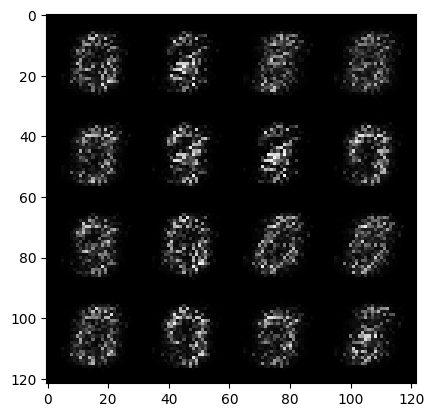

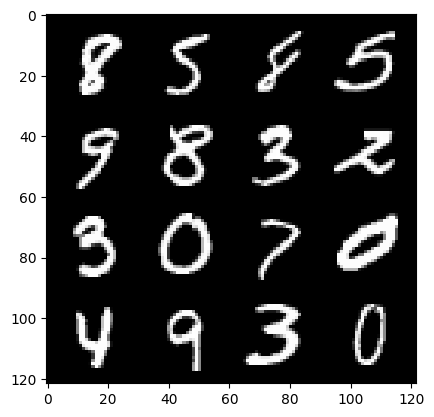

5: step 2700/ gen loss: 4.397849365075429 / disc loss: 0.02664288162253796


  0%|          | 0/469 [00:00<?, ?it/s]

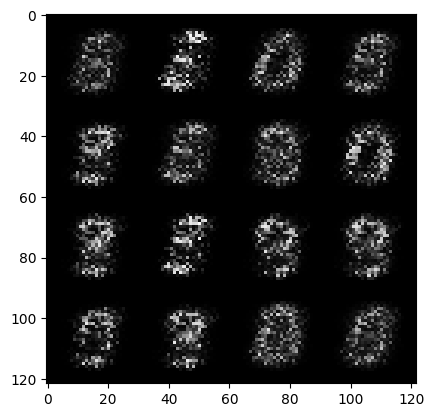

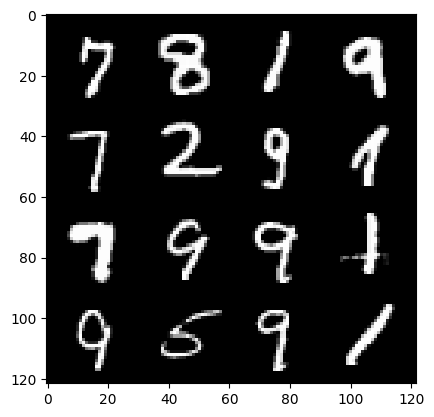

6: step 3000/ gen loss: 4.766123708089192 / disc loss: 0.02227712106890976


  0%|          | 0/469 [00:00<?, ?it/s]

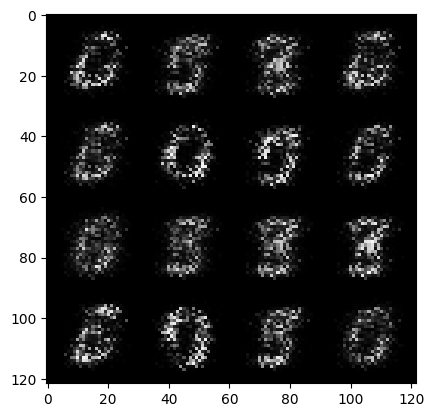

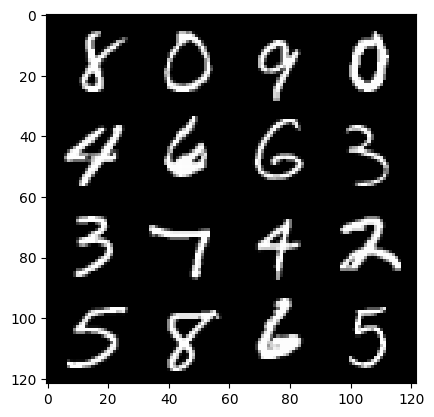

7: step 3300/ gen loss: 5.098316025733948 / disc loss: 0.02013725297215084


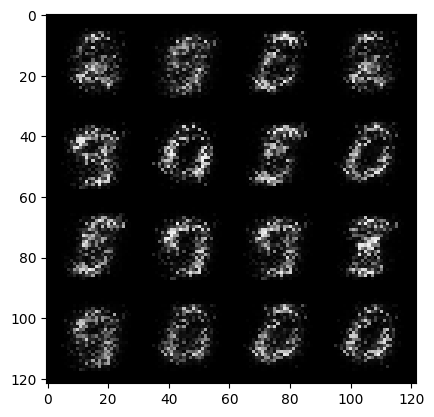

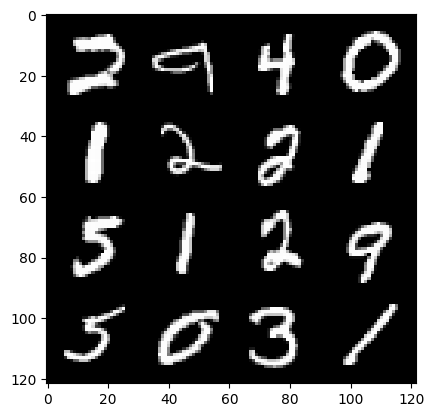

7: step 3600/ gen loss: 5.459917518297836 / disc loss: 0.017598345096533498


  0%|          | 0/469 [00:00<?, ?it/s]

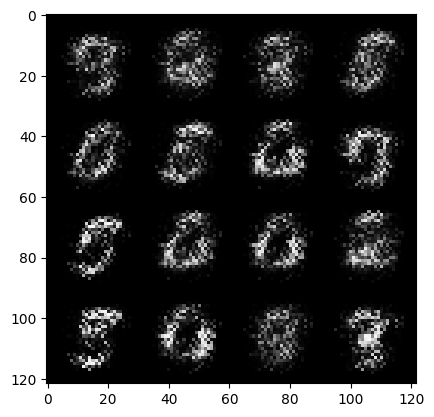

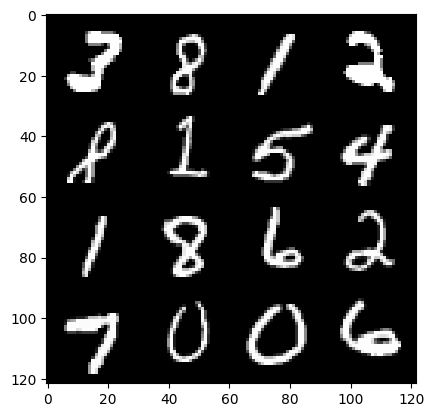

8: step 3900/ gen loss: 5.51180072307587 / disc loss: 0.019302683041120563


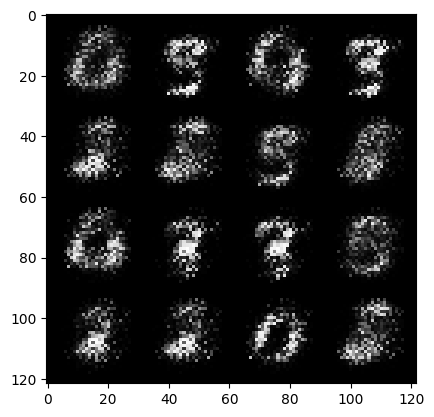

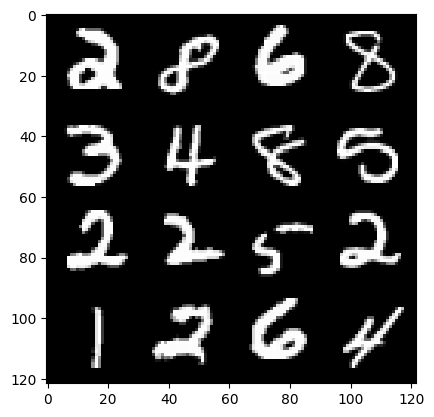

8: step 4200/ gen loss: 5.810086119969686 / disc loss: 0.019444603612646463


  0%|          | 0/469 [00:00<?, ?it/s]

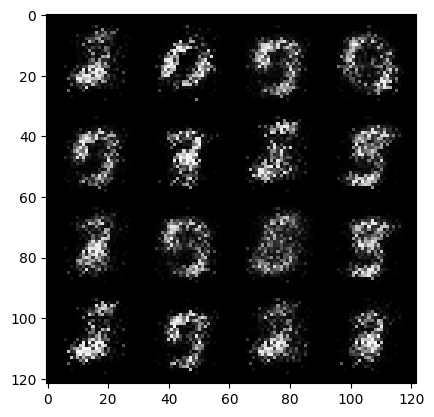

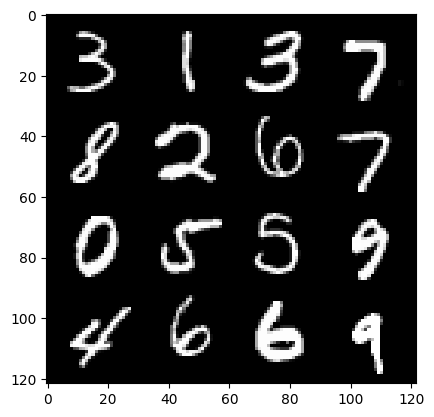

9: step 4500/ gen loss: 6.161018126805624 / disc loss: 0.019636591457140952


  0%|          | 0/469 [00:00<?, ?it/s]

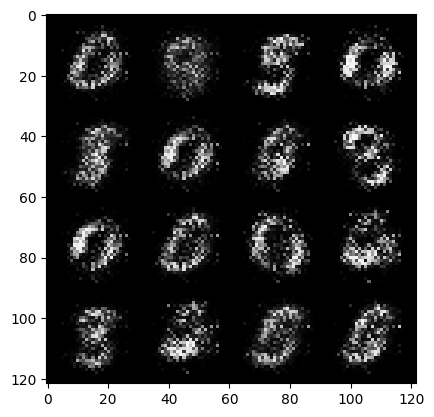

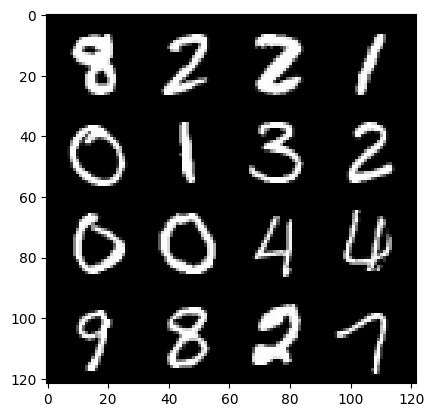

10: step 4800/ gen loss: 5.904496982892357 / disc loss: 0.017957505650507917


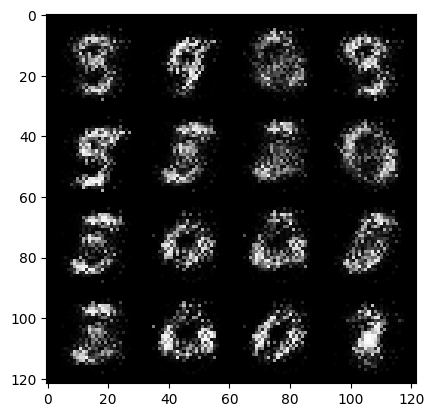

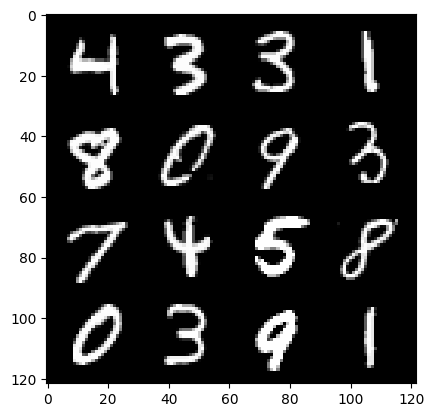

10: step 5100/ gen loss: 6.364433336257933 / disc loss: 0.016671579012957707


  0%|          | 0/469 [00:00<?, ?it/s]

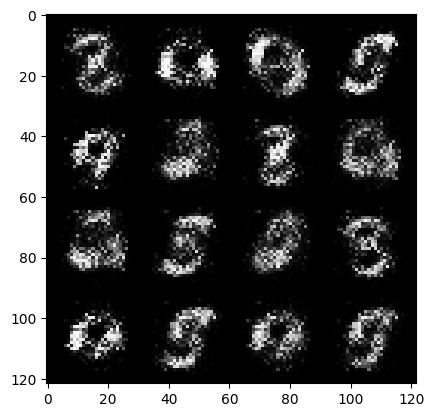

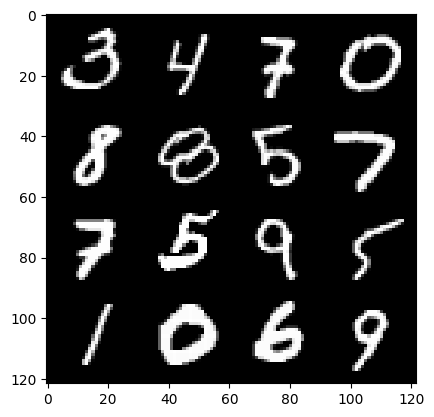

11: step 5400/ gen loss: 6.729138894081114 / disc loss: 0.016830599782988422


  0%|          | 0/469 [00:00<?, ?it/s]

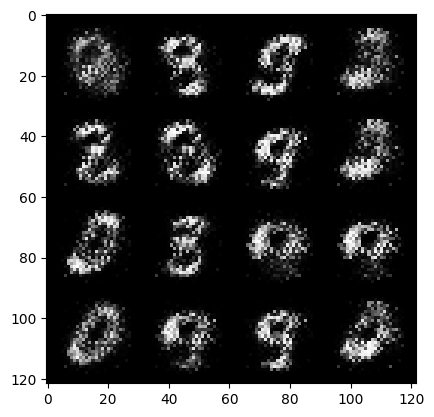

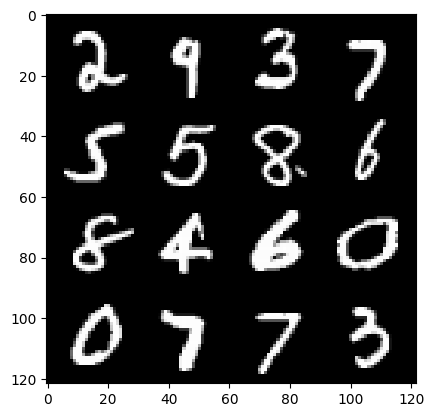

12: step 5700/ gen loss: 6.246222197214754 / disc loss: 0.015260599444930746


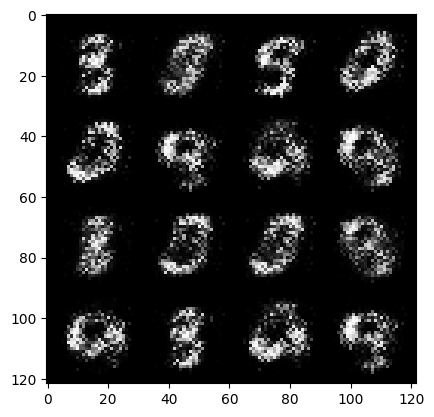

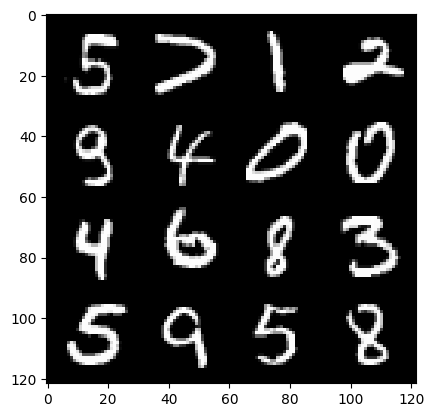

12: step 6000/ gen loss: 6.354806207021076 / disc loss: 0.013861512594545888


  0%|          | 0/469 [00:00<?, ?it/s]

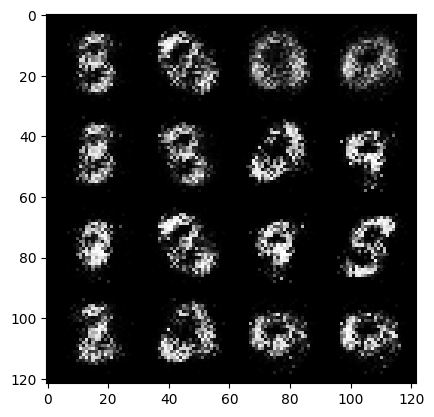

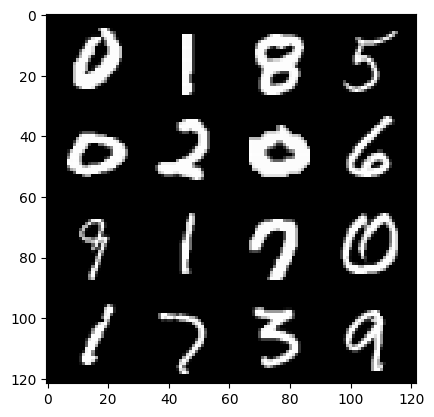

13: step 6300/ gen loss: 6.592503741582237 / disc loss: 0.012959953825920826


  0%|          | 0/469 [00:00<?, ?it/s]

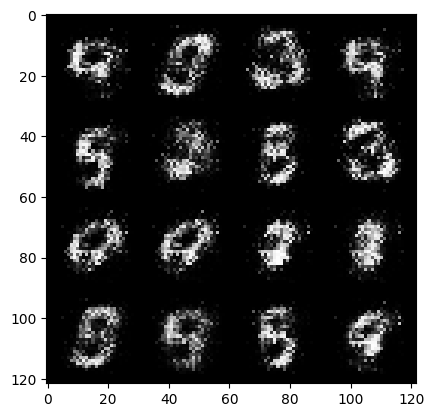

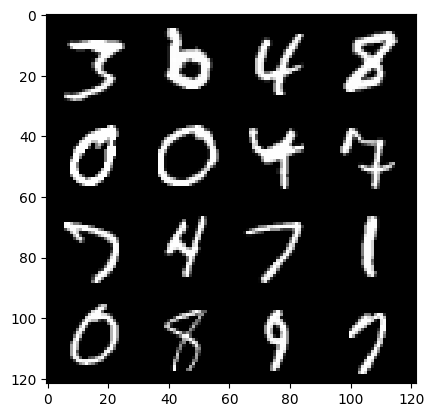

14: step 6600/ gen loss: 6.484872012138368 / disc loss: 0.015136027371821303


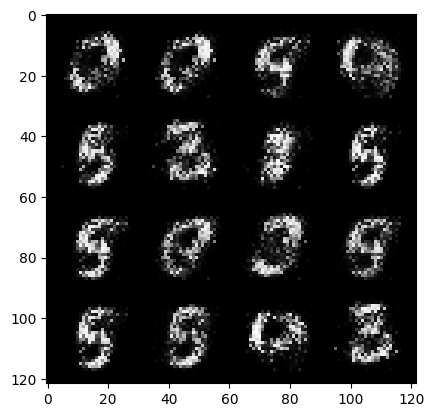

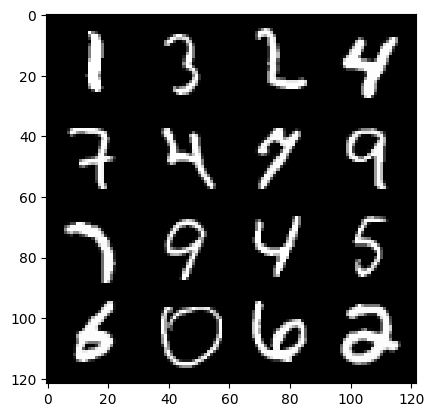

14: step 6900/ gen loss: 6.40113866011302 / disc loss: 0.014878732895789046


  0%|          | 0/469 [00:00<?, ?it/s]

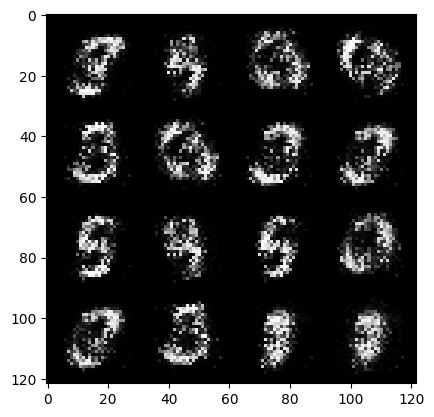

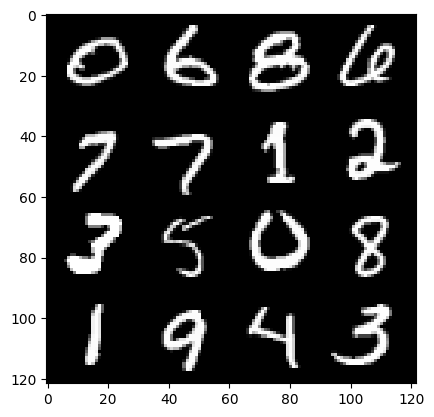

15: step 7200/ gen loss: 6.3098697916666655 / disc loss: 0.012532217072633403


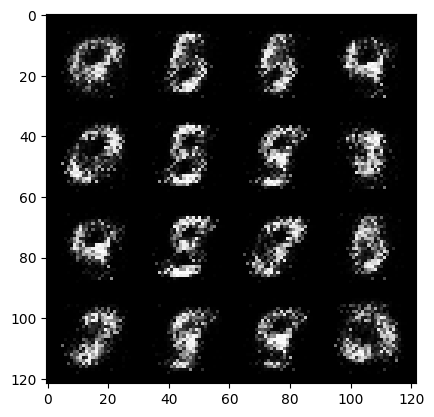

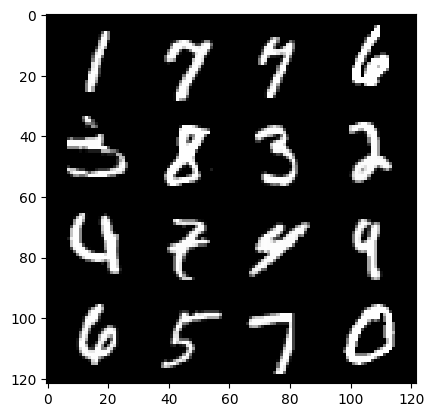

15: step 7500/ gen loss: 6.39373535474142 / disc loss: 0.011394338704024756


  0%|          | 0/469 [00:00<?, ?it/s]

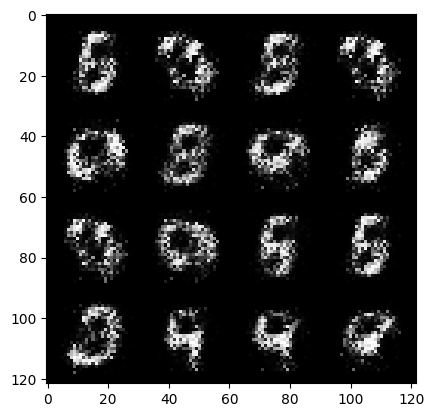

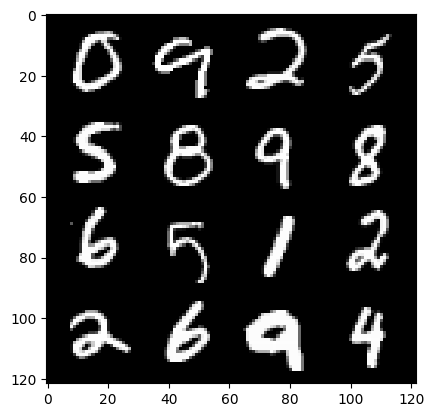

16: step 7800/ gen loss: 6.615998047192896 / disc loss: 0.01027763014193624


  0%|          | 0/469 [00:00<?, ?it/s]

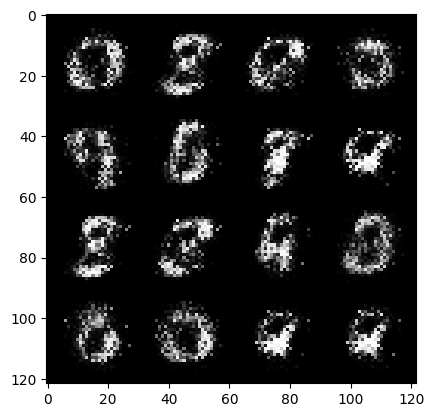

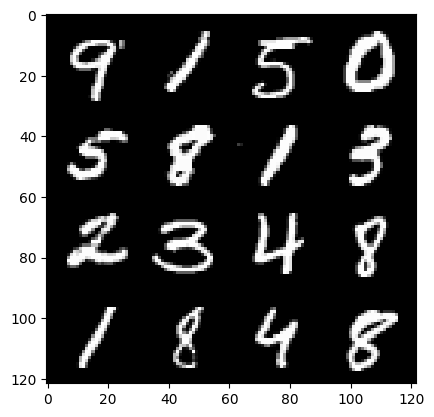

17: step 8100/ gen loss: 6.996757505734761 / disc loss: 0.010899542327970262


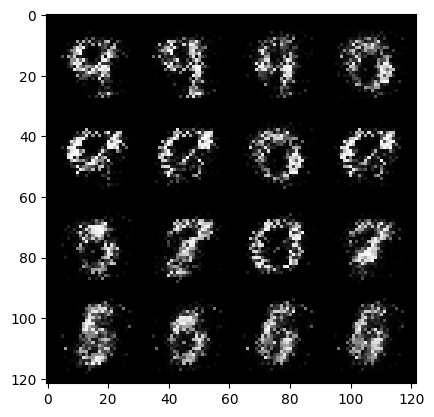

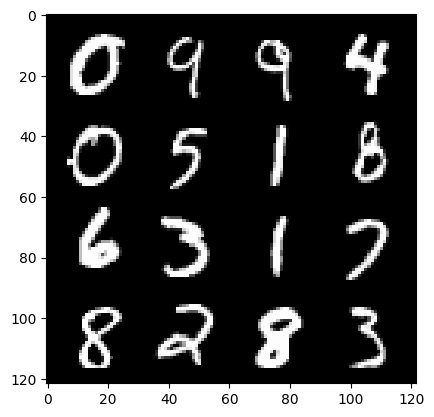

17: step 8400/ gen loss: 7.099515258471171 / disc loss: 0.009342476260693124


  0%|          | 0/469 [00:00<?, ?it/s]

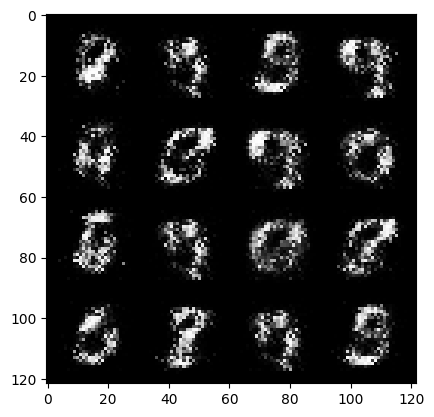

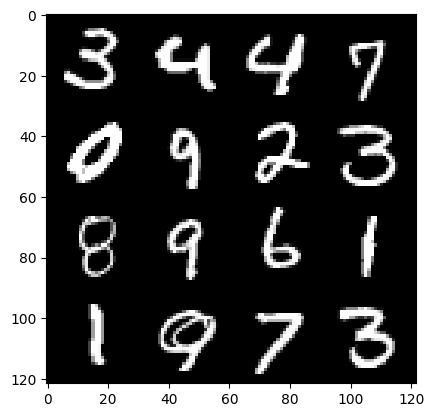

18: step 8700/ gen loss: 7.199107311566673 / disc loss: 0.008917169789007562


  0%|          | 0/469 [00:00<?, ?it/s]

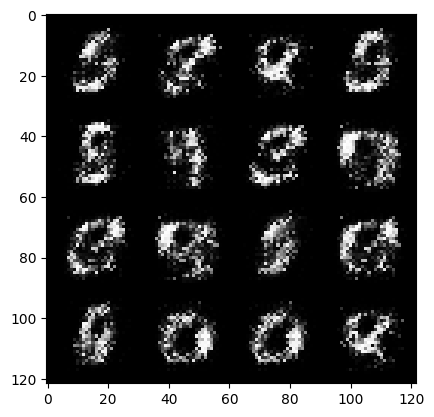

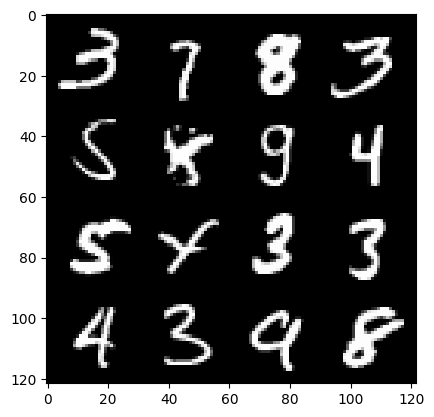

19: step 9000/ gen loss: 7.011770844459535 / disc loss: 0.008786492966270695


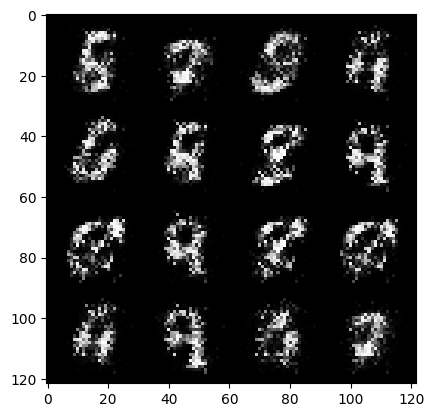

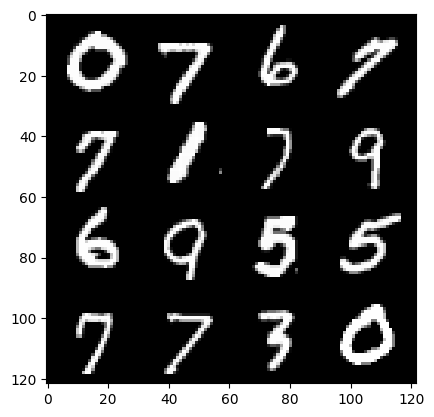

19: step 9300/ gen loss: 7.233900879224142 / disc loss: 0.008671241609069208


  0%|          | 0/469 [00:00<?, ?it/s]

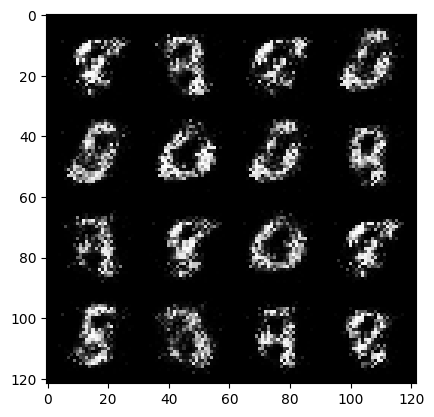

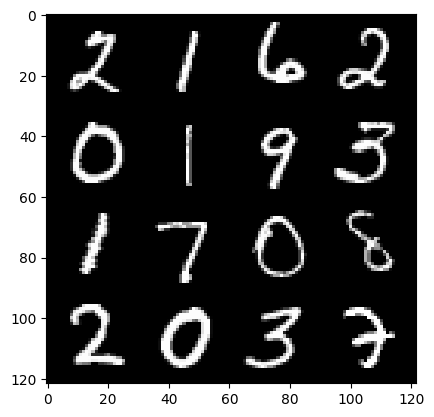

20: step 9600/ gen loss: 7.269322546323143 / disc loss: 0.00878173252179598


  0%|          | 0/469 [00:00<?, ?it/s]

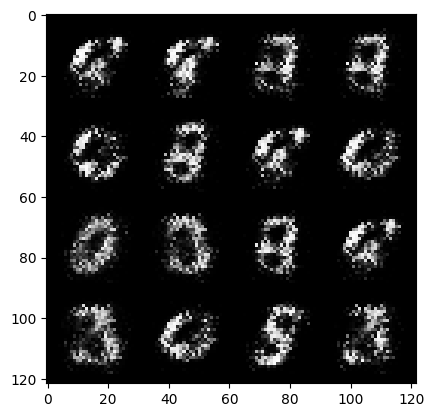

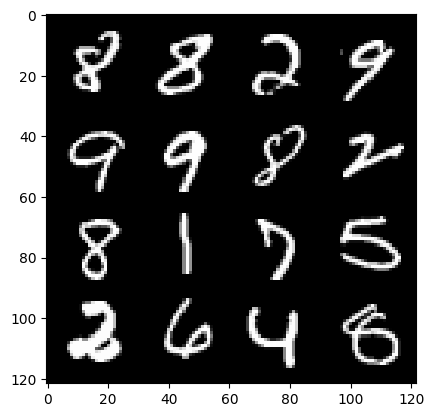

21: step 9900/ gen loss: 6.866183730761212 / disc loss: 0.011312462432154764


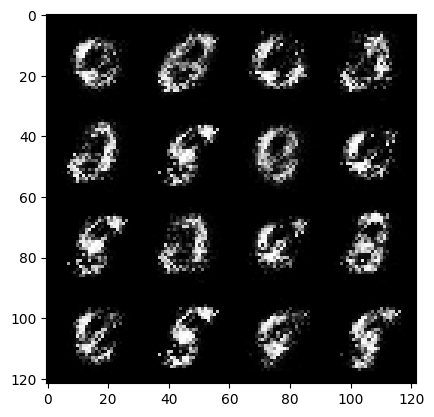

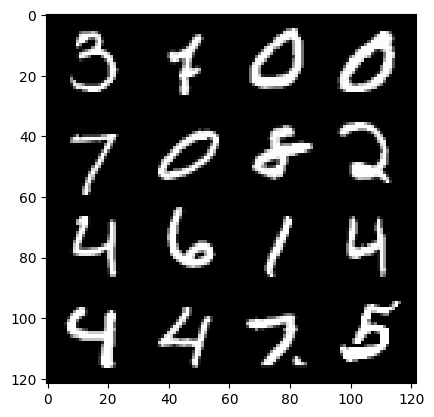

21: step 10200/ gen loss: 6.744092688560485 / disc loss: 0.012982949709209301


  0%|          | 0/469 [00:00<?, ?it/s]

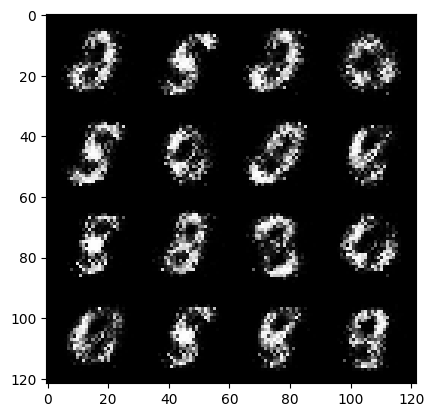

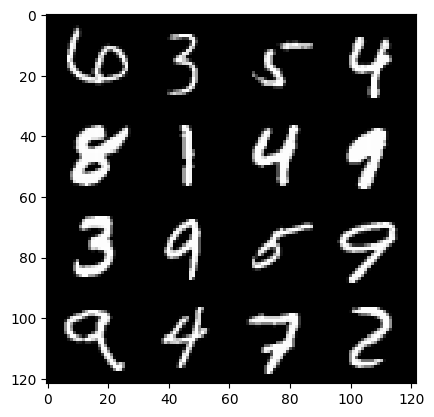

22: step 10500/ gen loss: 6.730930509567265 / disc loss: 0.013311649235741546


  0%|          | 0/469 [00:00<?, ?it/s]

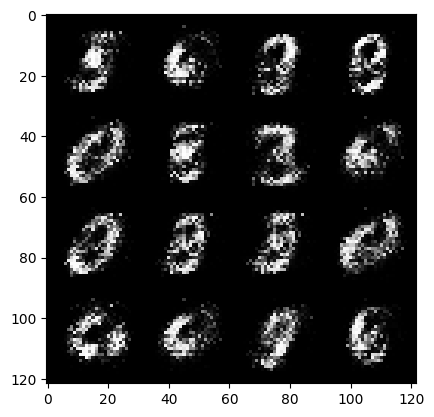

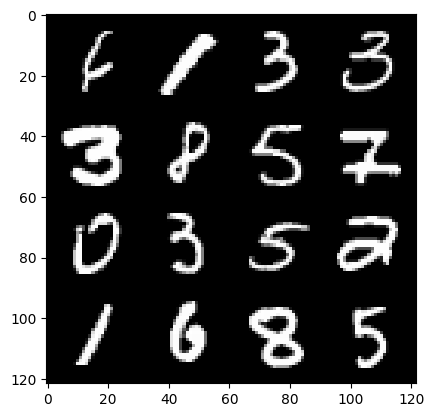

23: step 10800/ gen loss: 6.852566323280338 / disc loss: 0.0155147703139422


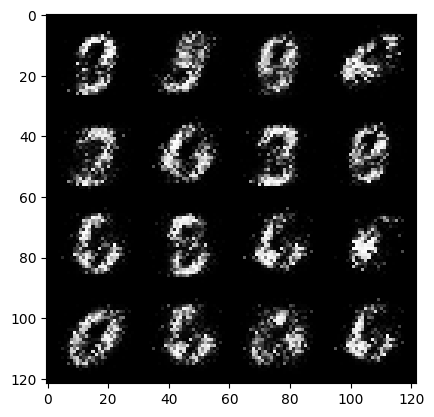

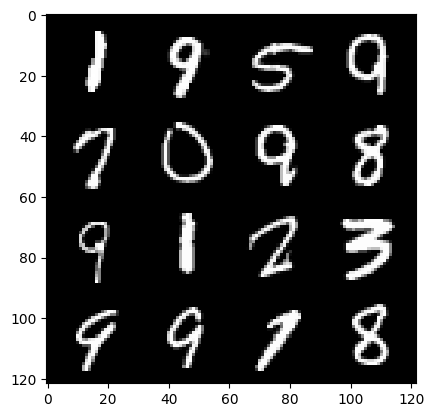

23: step 11100/ gen loss: 7.06740397453308 / disc loss: 0.014240048190113165


  0%|          | 0/469 [00:00<?, ?it/s]

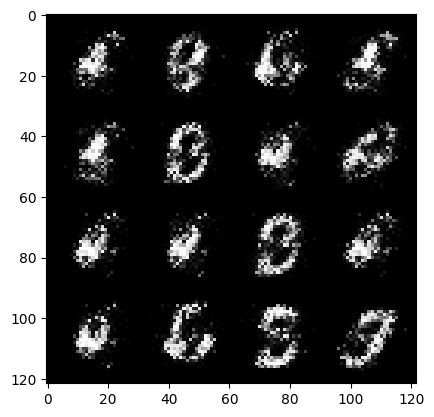

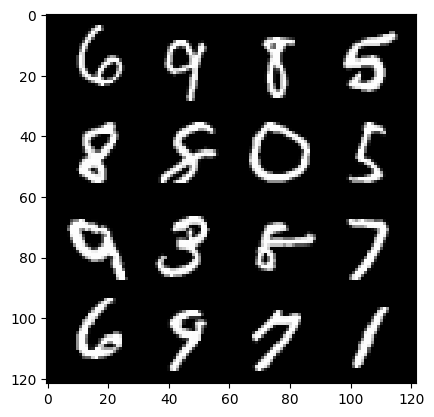

24: step 11400/ gen loss: 6.919779938062031 / disc loss: 0.012661008792153245


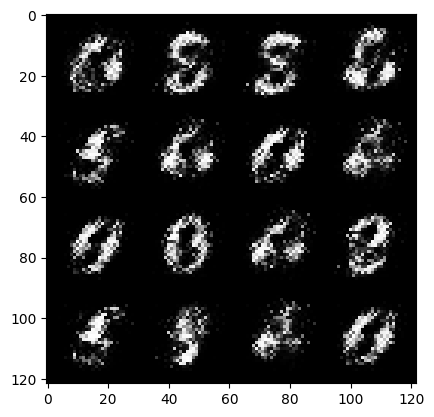

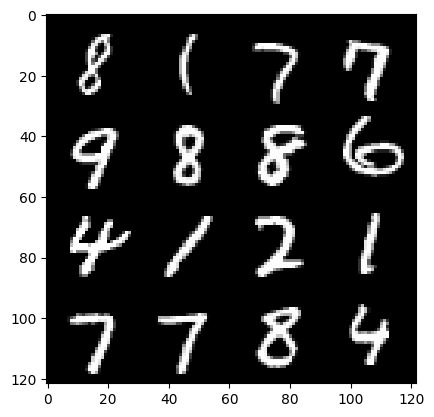

24: step 11700/ gen loss: 6.886038632392888 / disc loss: 0.01309287895758947


  0%|          | 0/469 [00:00<?, ?it/s]

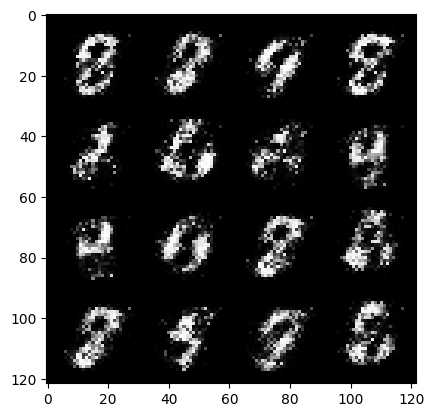

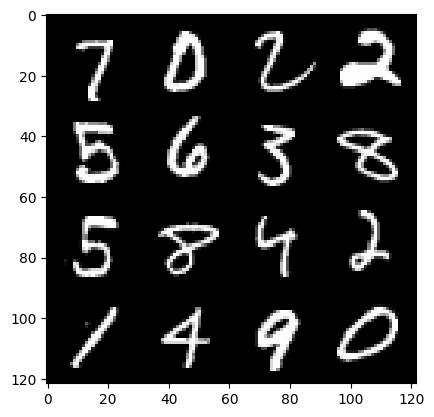

25: step 12000/ gen loss: 7.429429391225182 / disc loss: 0.012210300554676595


  0%|          | 0/469 [00:00<?, ?it/s]

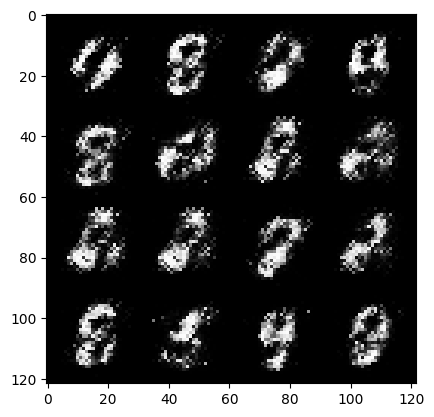

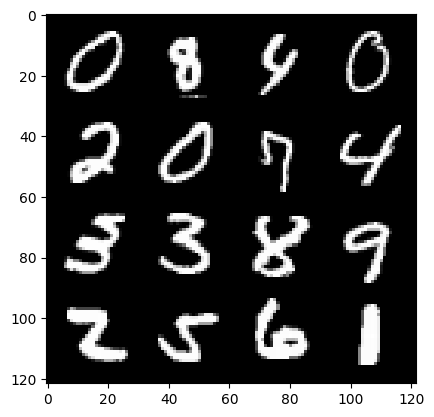

26: step 12300/ gen loss: 7.0057848294576 / disc loss: 0.015304871121576679


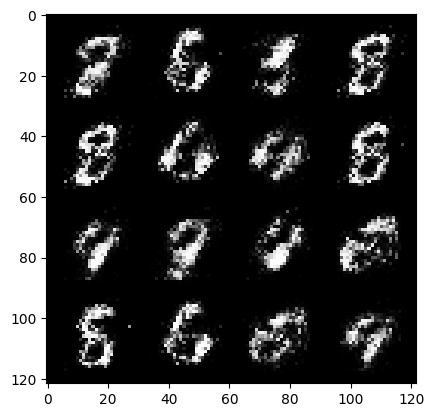

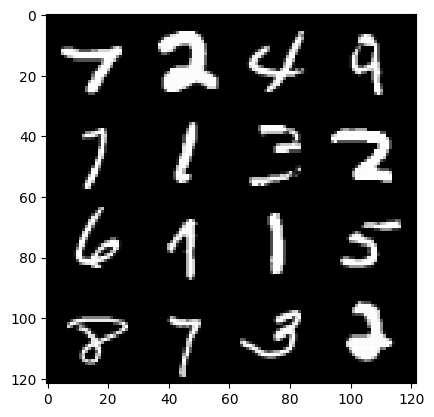

26: step 12600/ gen loss: 6.955477884610493 / disc loss: 0.016669073345450067


  0%|          | 0/469 [00:00<?, ?it/s]

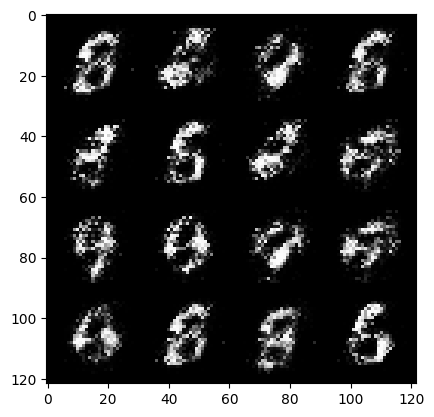

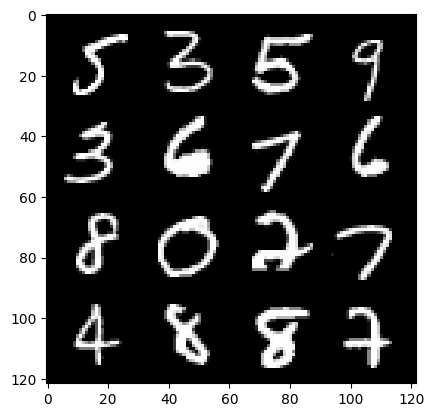

27: step 12900/ gen loss: 6.81688273588817 / disc loss: 0.014969185300481809


  0%|          | 0/469 [00:00<?, ?it/s]

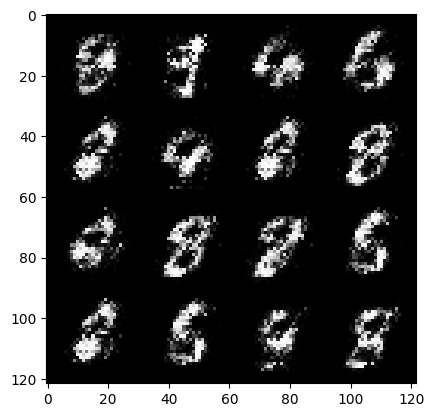

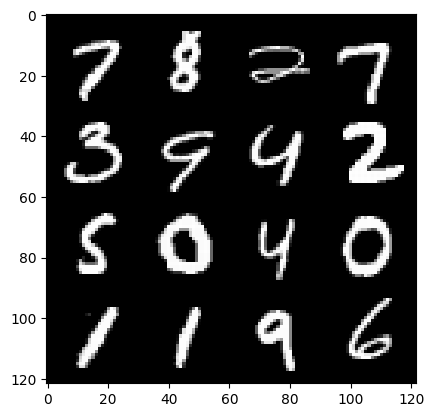

28: step 13200/ gen loss: 6.708736236890163 / disc loss: 0.014574522647696236


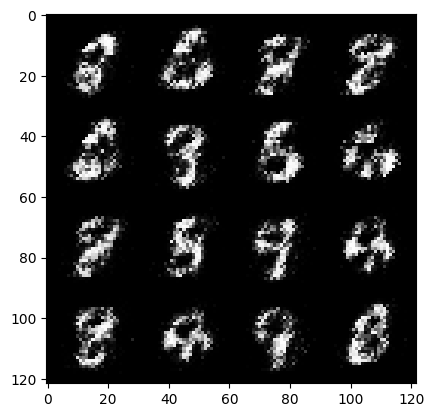

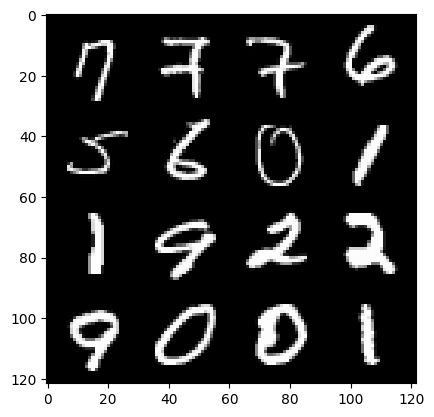

28: step 13500/ gen loss: 6.523703236579897 / disc loss: 0.01881373298664887


  0%|          | 0/469 [00:00<?, ?it/s]

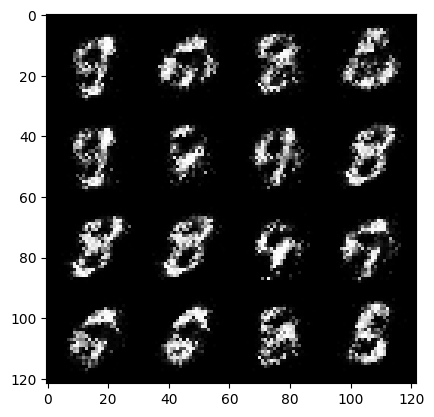

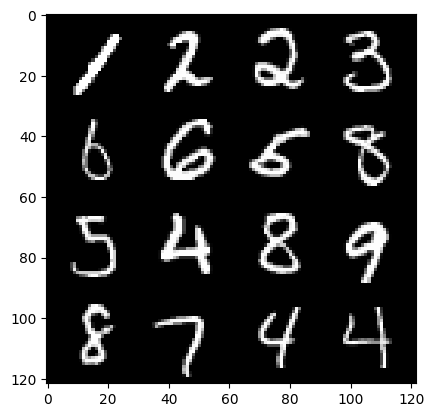

29: step 13800/ gen loss: 6.234884392420451 / disc loss: 0.019750039020242777


  0%|          | 0/469 [00:00<?, ?it/s]

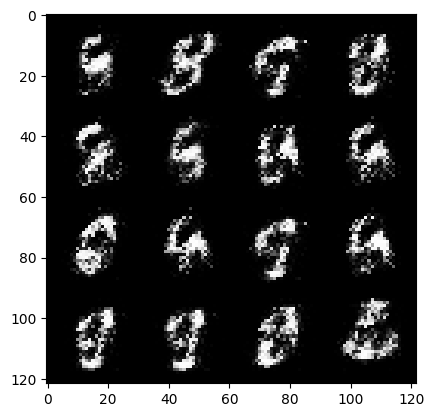

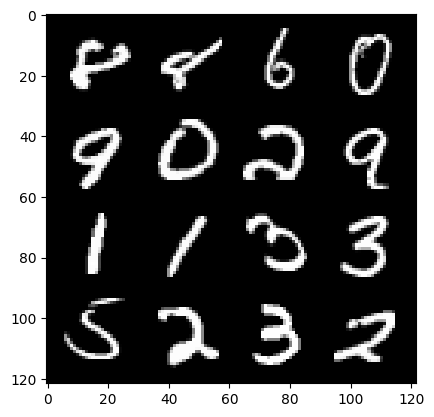

30: step 14100/ gen loss: 6.43312293688456 / disc loss: 0.01785820228047668


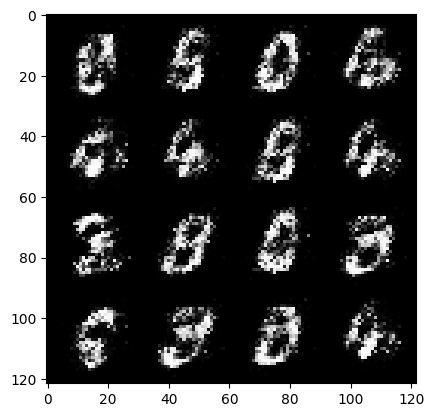

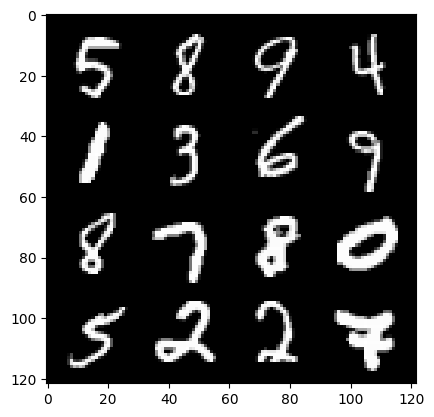

30: step 14400/ gen loss: 6.605436690648398 / disc loss: 0.016013536409785346


  0%|          | 0/469 [00:00<?, ?it/s]

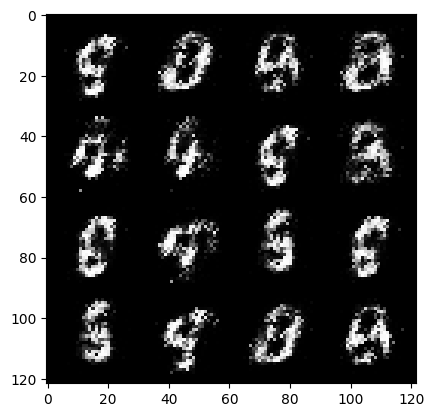

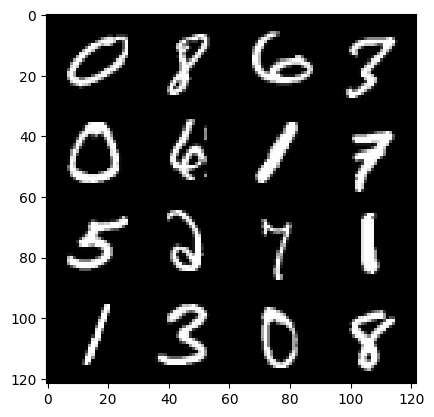

31: step 14700/ gen loss: 6.611583231290177 / disc loss: 0.01759846652237077


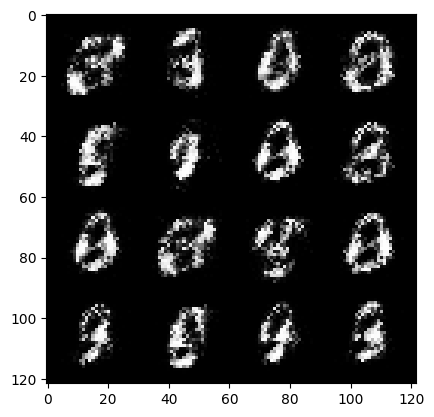

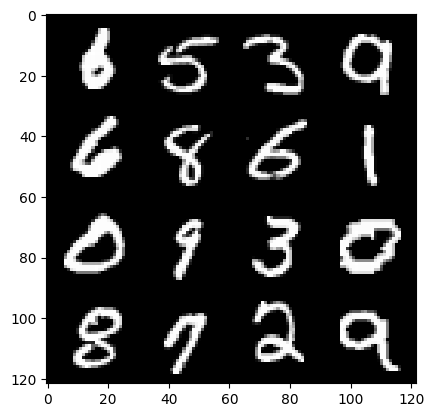

31: step 15000/ gen loss: 6.364914288520815 / disc loss: 0.018770910024953385


  0%|          | 0/469 [00:00<?, ?it/s]

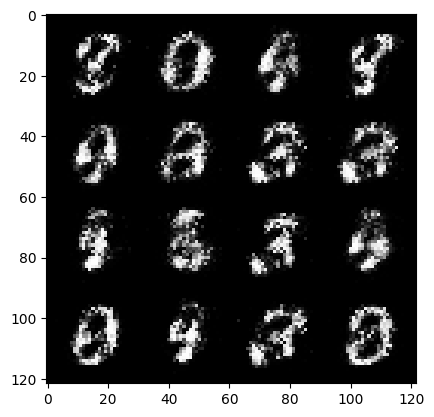

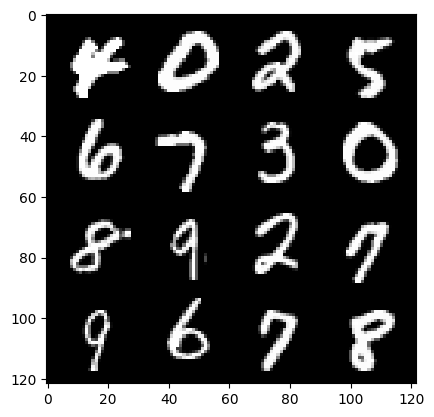

32: step 15300/ gen loss: 6.41866443792979 / disc loss: 0.021975951367057864


  0%|          | 0/469 [00:00<?, ?it/s]

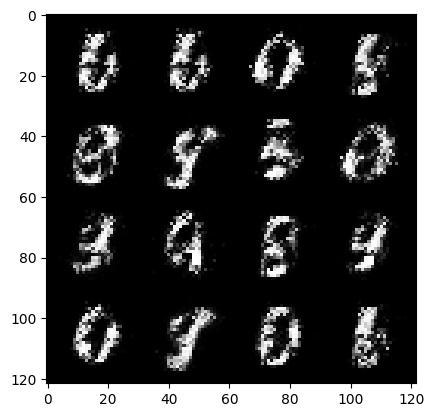

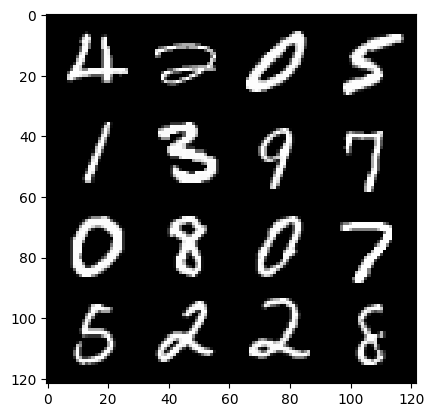

33: step 15600/ gen loss: 6.225584568977354 / disc loss: 0.027560683260671768


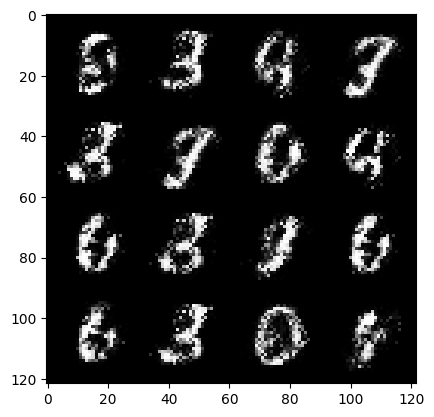

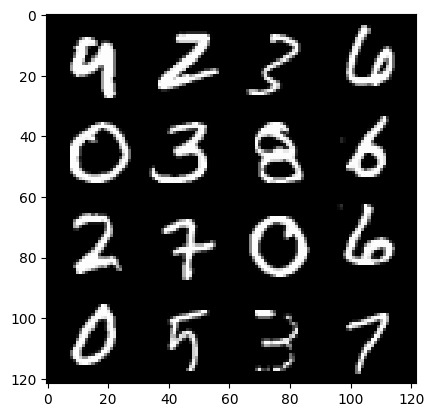

33: step 15900/ gen loss: 6.159563461939492 / disc loss: 0.027128540213840712


  0%|          | 0/469 [00:00<?, ?it/s]

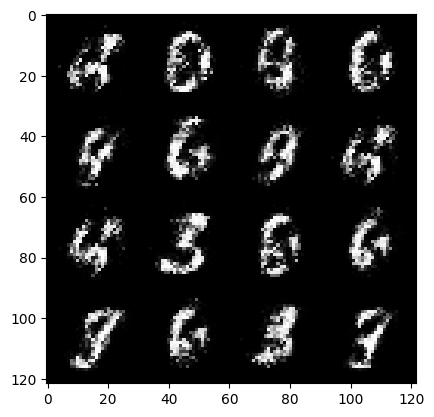

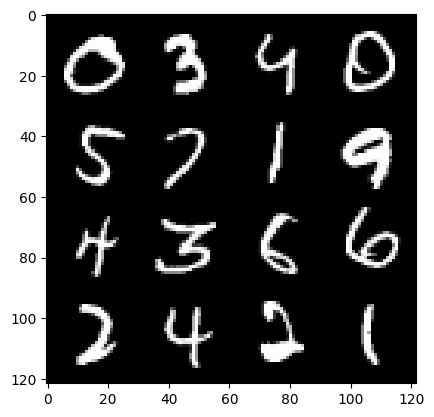

34: step 16200/ gen loss: 6.247609717051189 / disc loss: 0.02828022844002891


  0%|          | 0/469 [00:00<?, ?it/s]

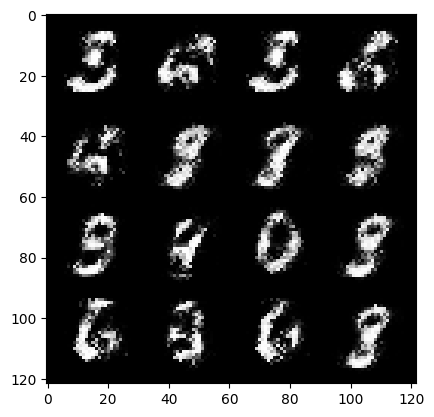

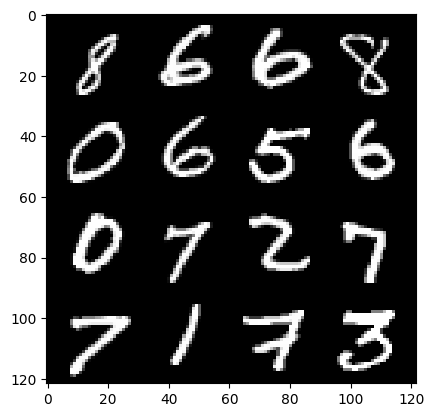

35: step 16500/ gen loss: 6.14423632780711 / disc loss: 0.03033684931385018


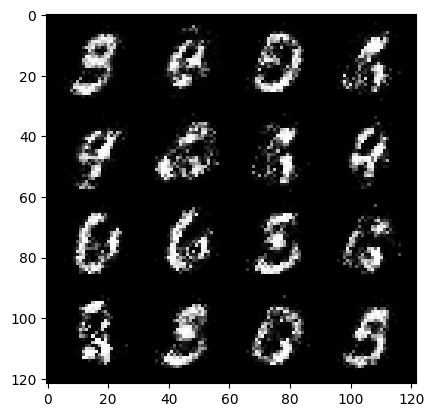

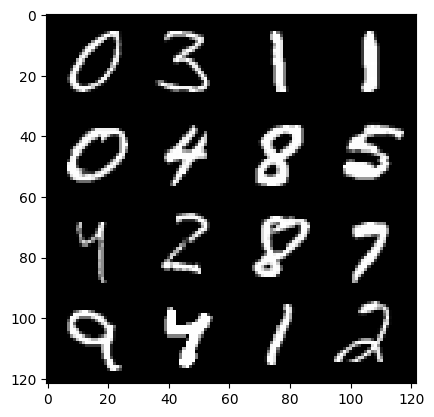

35: step 16800/ gen loss: 6.256709543863931 / disc loss: 0.029175749979913224


  0%|          | 0/469 [00:00<?, ?it/s]

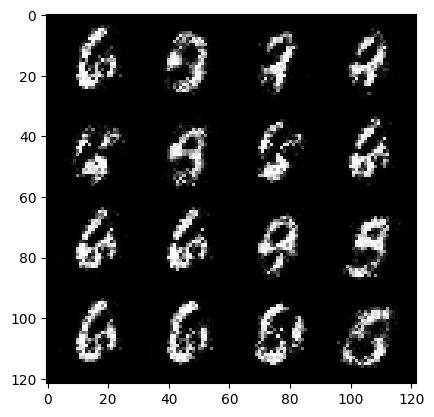

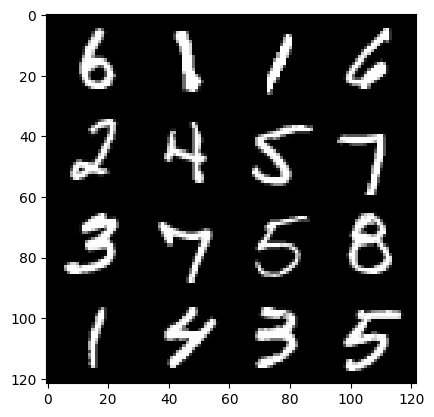

36: step 17100/ gen loss: 6.124701967239378 / disc loss: 0.025120707953659213


  0%|          | 0/469 [00:00<?, ?it/s]

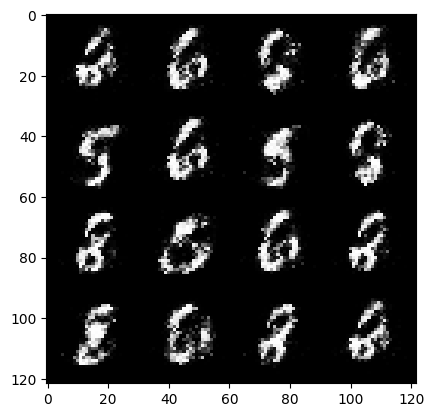

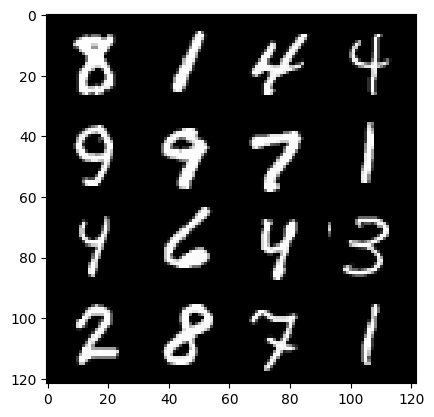

37: step 17400/ gen loss: 6.123084780375164 / disc loss: 0.024483262080078328


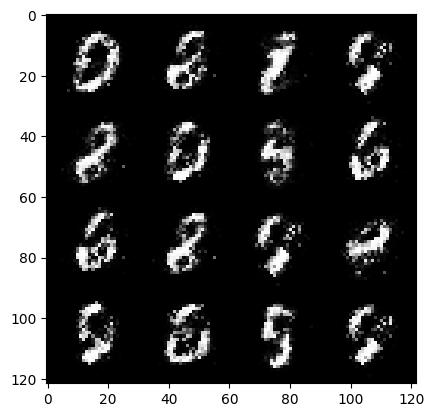

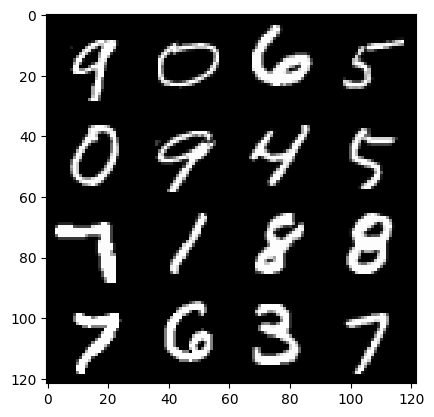

37: step 17700/ gen loss: 5.848951408068343 / disc loss: 0.03154796485944342


  0%|          | 0/469 [00:00<?, ?it/s]

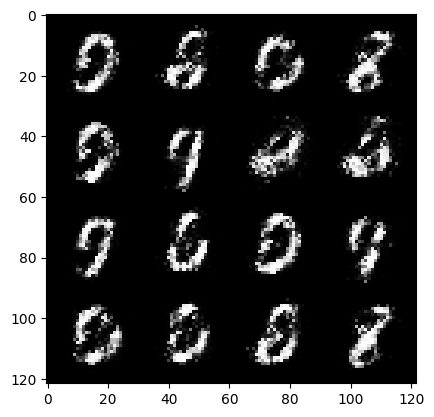

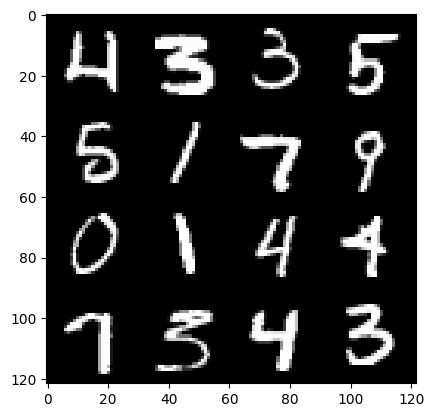

38: step 18000/ gen loss: 5.909134313265485 / disc loss: 0.0325822501288106


  0%|          | 0/469 [00:00<?, ?it/s]

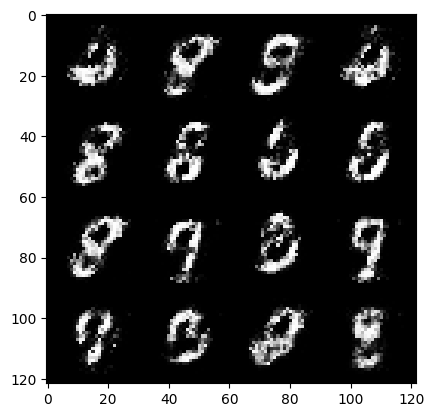

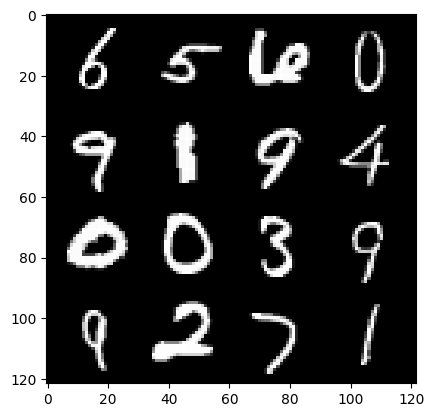

39: step 18300/ gen loss: 5.7305430666605615 / disc loss: 0.03551945014235872


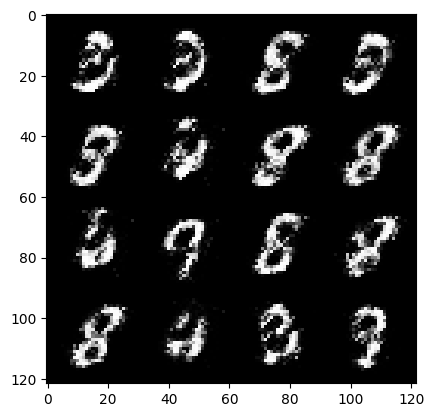

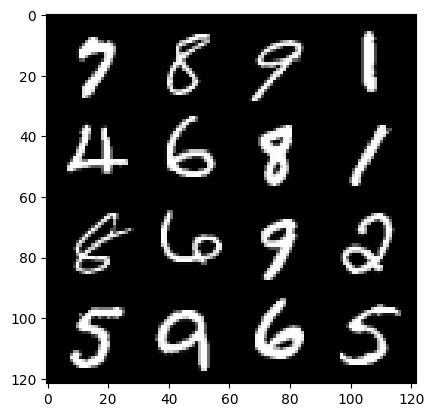

39: step 18600/ gen loss: 6.102275589307144 / disc loss: 0.02795484518166632


  0%|          | 0/469 [00:00<?, ?it/s]

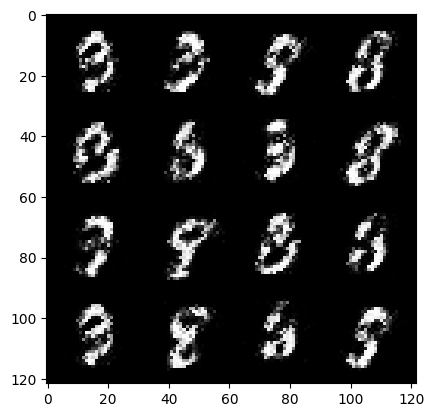

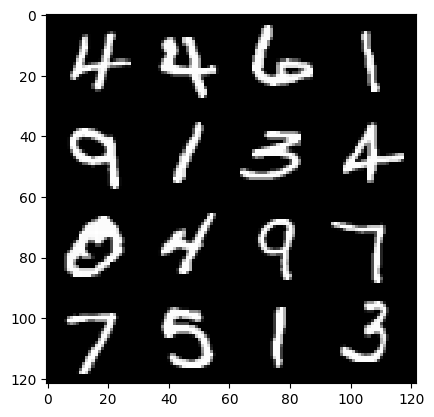

40: step 18900/ gen loss: 6.103897967338563 / disc loss: 0.03179633845575154


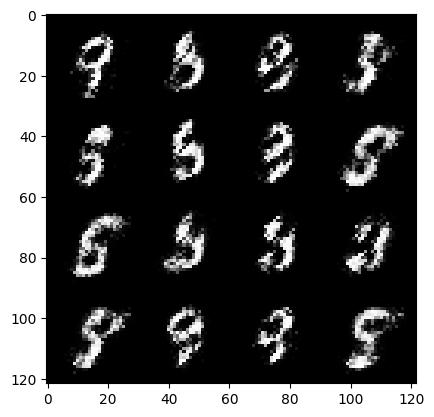

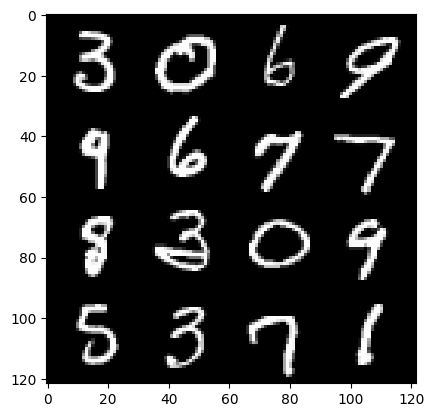

40: step 19200/ gen loss: 5.81221050103505 / disc loss: 0.03745909182354807


  0%|          | 0/469 [00:00<?, ?it/s]

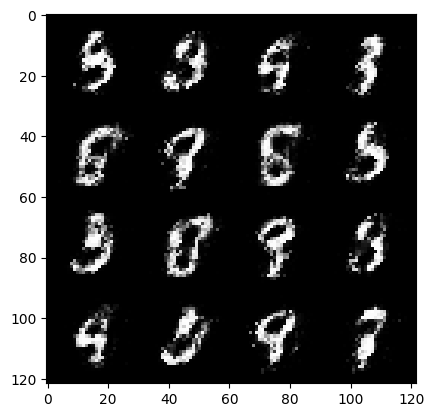

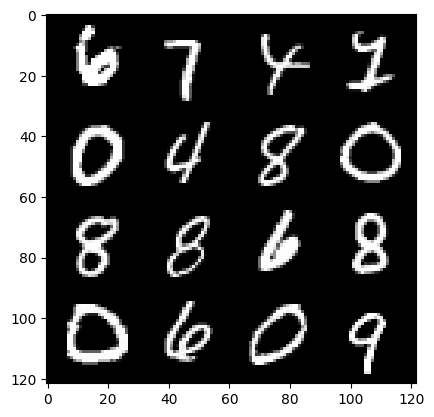

41: step 19500/ gen loss: 5.872742778460191 / disc loss: 0.03907497194595639


  0%|          | 0/469 [00:00<?, ?it/s]

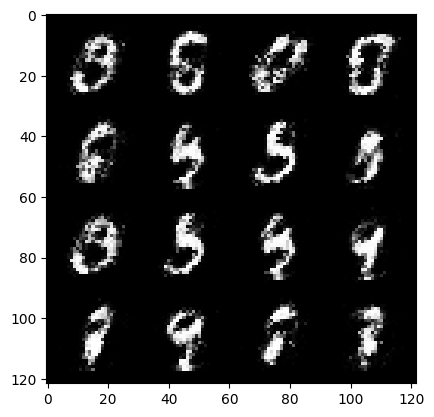

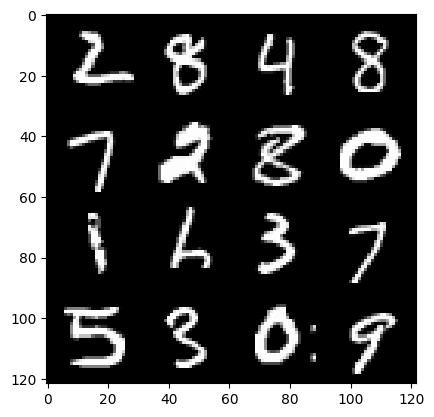

42: step 19800/ gen loss: 5.6468064244588305 / disc loss: 0.04717811291726932


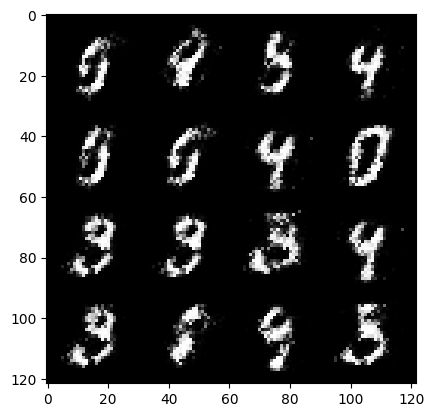

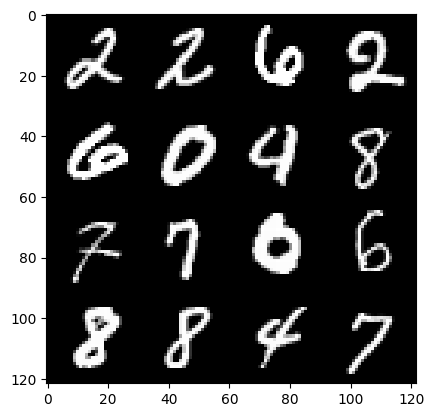

42: step 20100/ gen loss: 5.559542277654003 / disc loss: 0.04260474260896444


  0%|          | 0/469 [00:00<?, ?it/s]

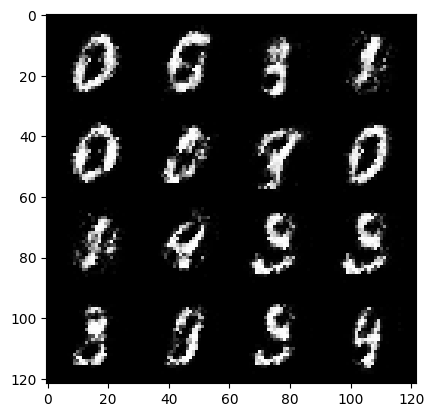

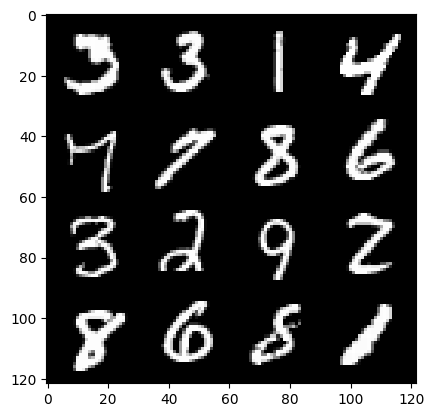

43: step 20400/ gen loss: 5.48313566843669 / disc loss: 0.038742593635494454


  0%|          | 0/469 [00:00<?, ?it/s]

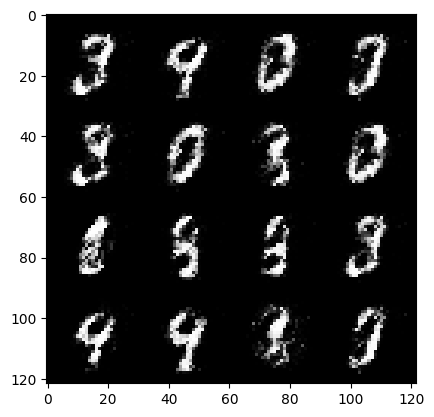

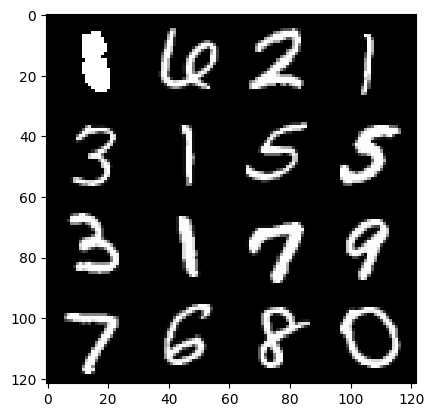

44: step 20700/ gen loss: 5.284617103735603 / disc loss: 0.04300843208407363


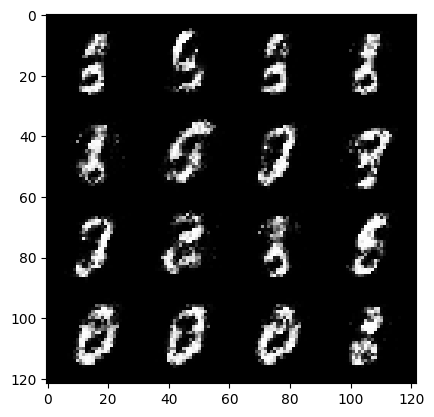

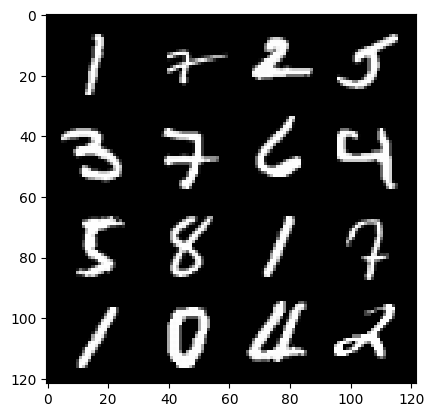

44: step 21000/ gen loss: 5.32529841899872 / disc loss: 0.04730517291619132


  0%|          | 0/469 [00:00<?, ?it/s]

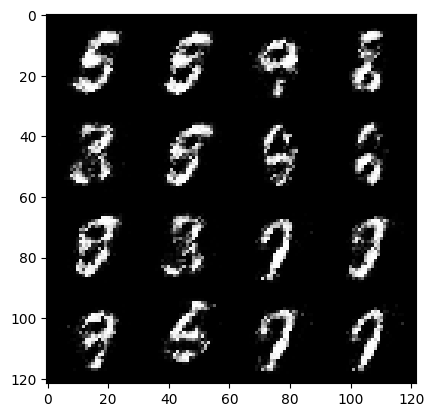

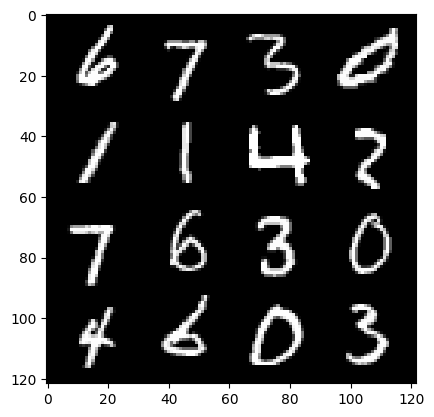

45: step 21300/ gen loss: 5.465653055508928 / disc loss: 0.04996701756492261


  0%|          | 0/469 [00:00<?, ?it/s]

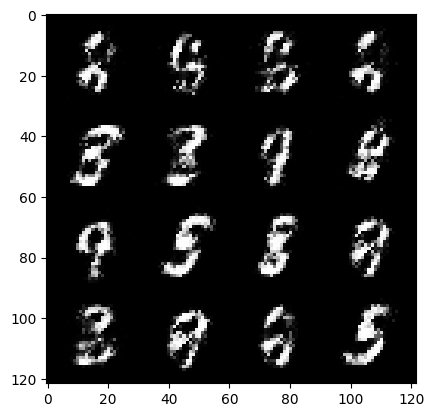

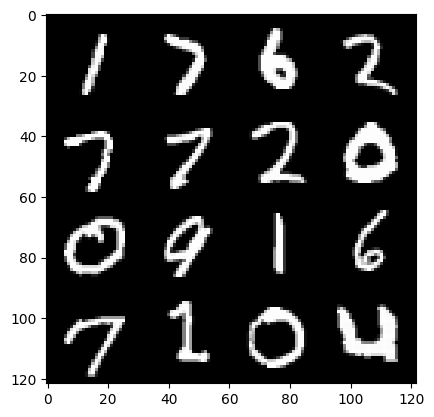

46: step 21600/ gen loss: 5.212778817017868 / disc loss: 0.06680642940724892


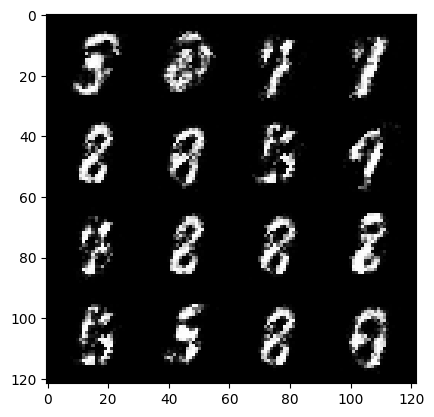

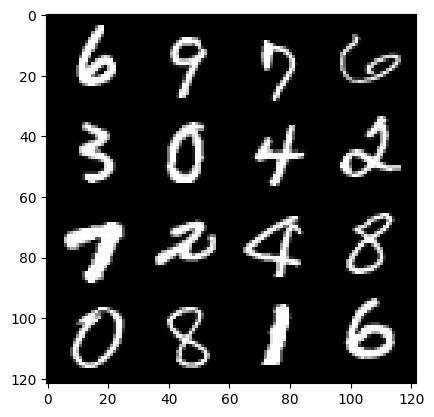

46: step 21900/ gen loss: 4.964581058820091 / disc loss: 0.06477271219094595


  0%|          | 0/469 [00:00<?, ?it/s]

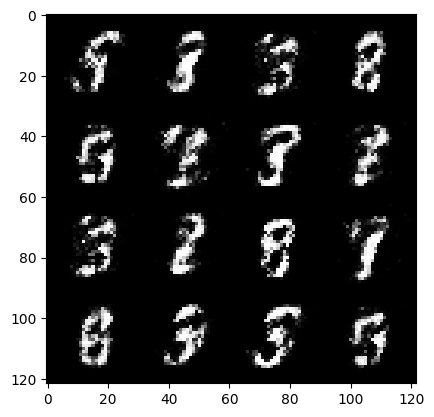

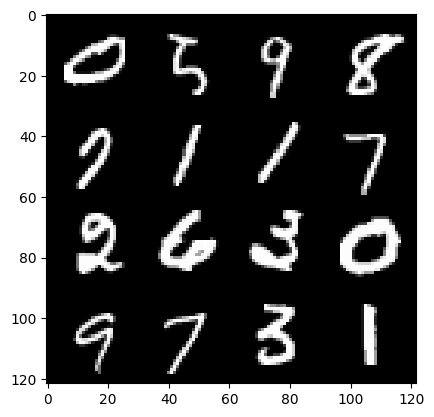

47: step 22200/ gen loss: 5.007783188025163 / disc loss: 0.06241433891157309


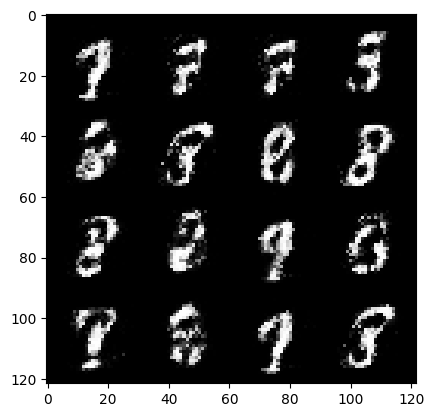

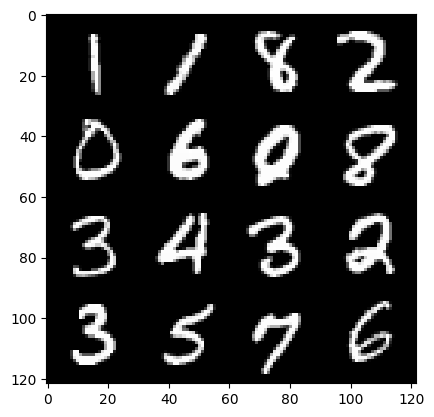

47: step 22500/ gen loss: 5.136251622835792 / disc loss: 0.060405037111292297


  0%|          | 0/469 [00:00<?, ?it/s]

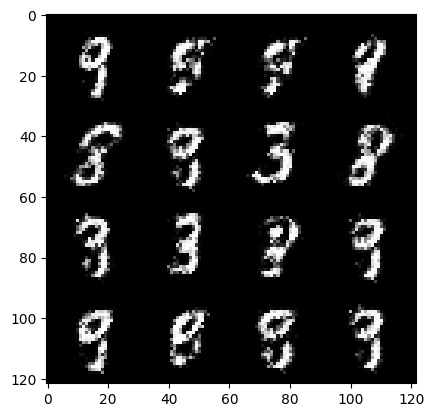

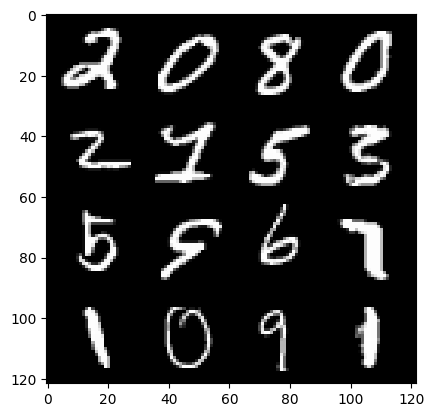

48: step 22800/ gen loss: 5.080093271732329 / disc loss: 0.06481783618529639


  0%|          | 0/469 [00:00<?, ?it/s]

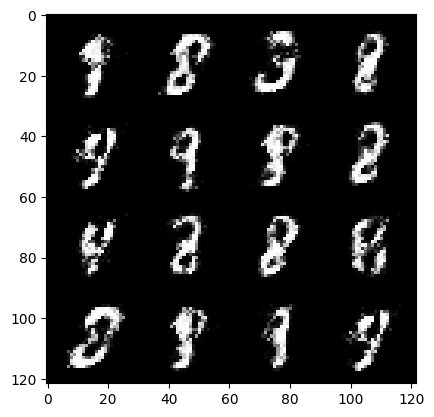

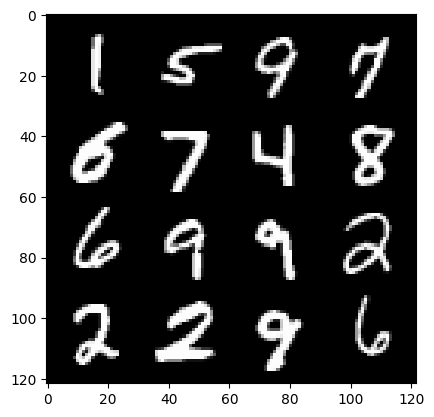

49: step 23100/ gen loss: 4.916444326241809 / disc loss: 0.06832813800623017


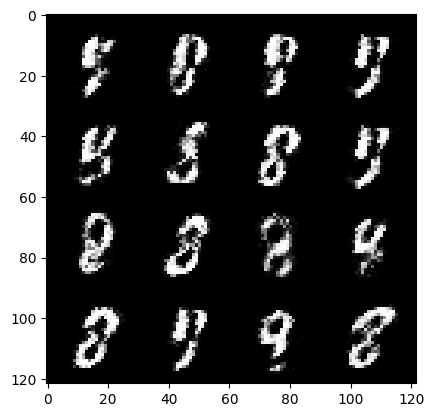

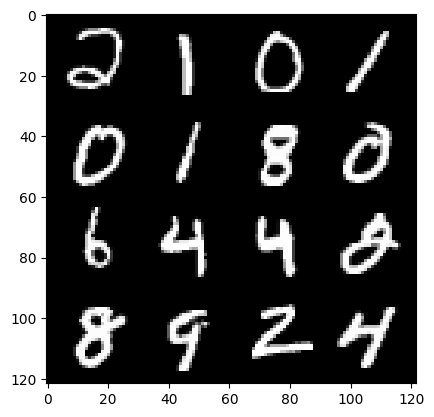

49: step 23400/ gen loss: 4.550066142876943 / disc loss: 0.09031124481931338


  0%|          | 0/469 [00:00<?, ?it/s]

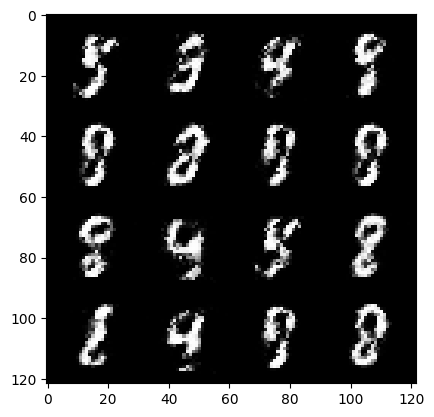

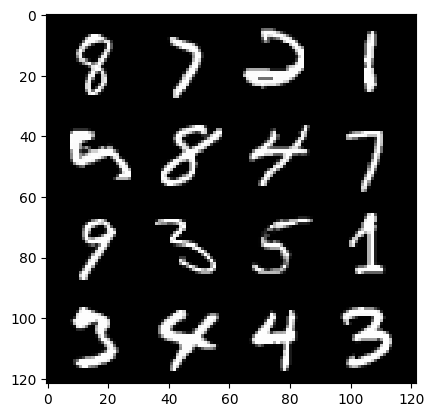

50: step 23700/ gen loss: 4.759377847512562 / disc loss: 0.07621513263011971


  0%|          | 0/469 [00:00<?, ?it/s]

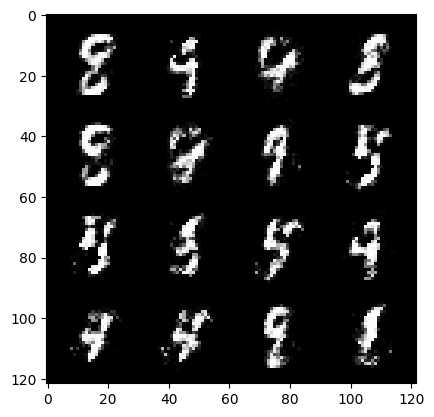

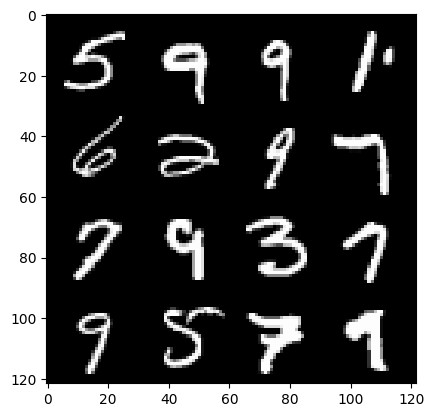

51: step 24000/ gen loss: 4.7450946338971445 / disc loss: 0.08125336528445279


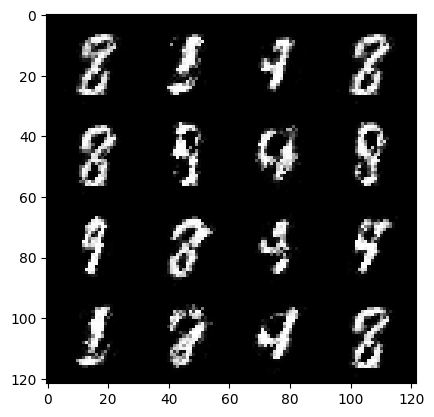

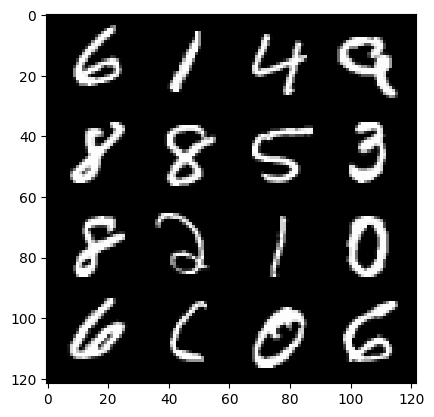

51: step 24300/ gen loss: 4.657987900575001 / disc loss: 0.07913697170093652


  0%|          | 0/469 [00:00<?, ?it/s]

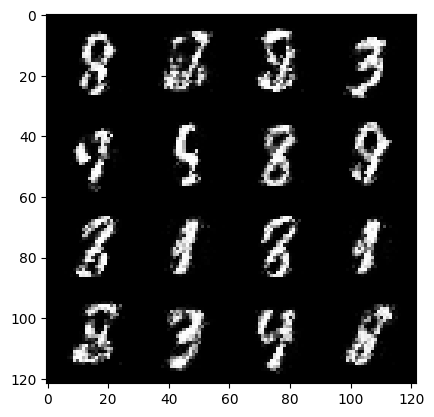

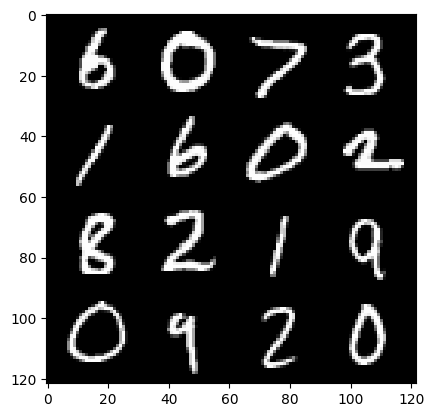

52: step 24600/ gen loss: 4.626704463958741 / disc loss: 0.09118259544173873


  0%|          | 0/469 [00:00<?, ?it/s]

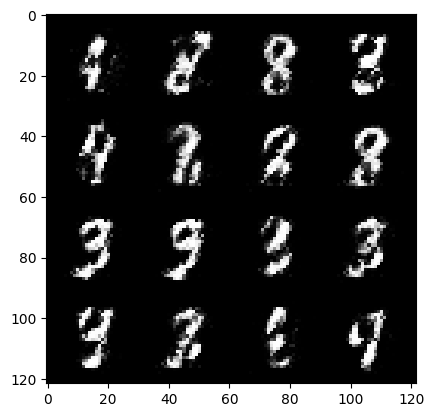

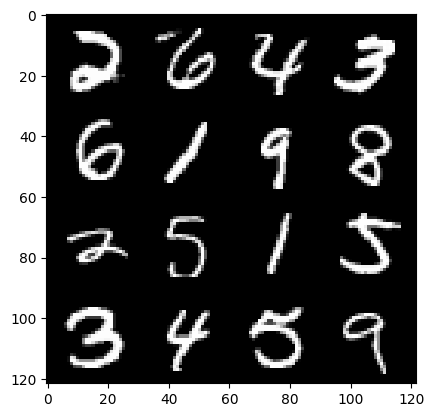

53: step 24900/ gen loss: 4.575332287947335 / disc loss: 0.08718990432719394


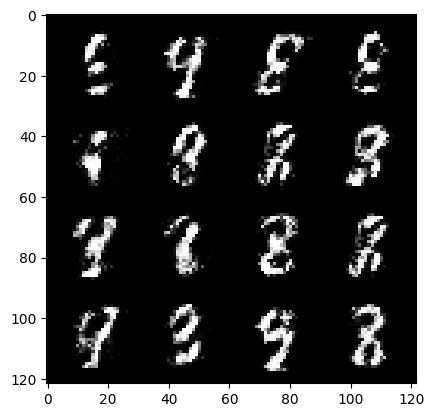

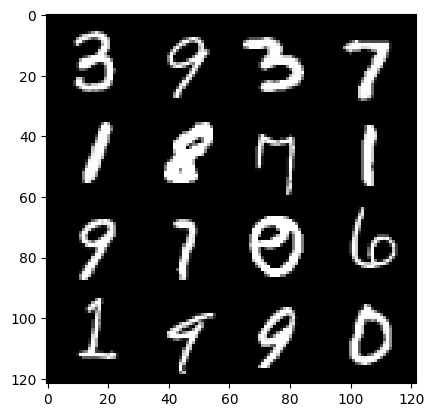

53: step 25200/ gen loss: 4.603003489971162 / disc loss: 0.07197901564960683


  0%|          | 0/469 [00:00<?, ?it/s]

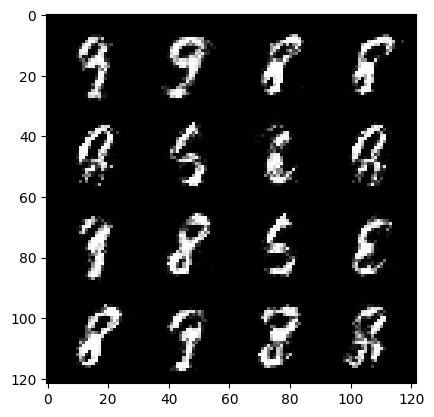

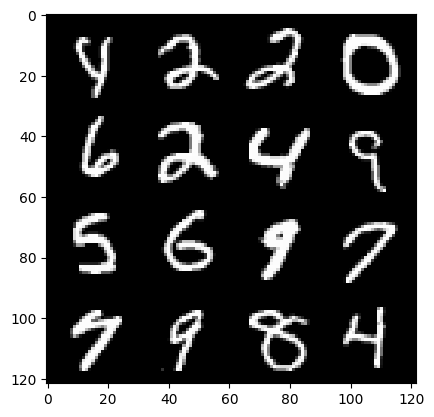

54: step 25500/ gen loss: 4.902735641002653 / disc loss: 0.06939562578996024


  0%|          | 0/469 [00:00<?, ?it/s]

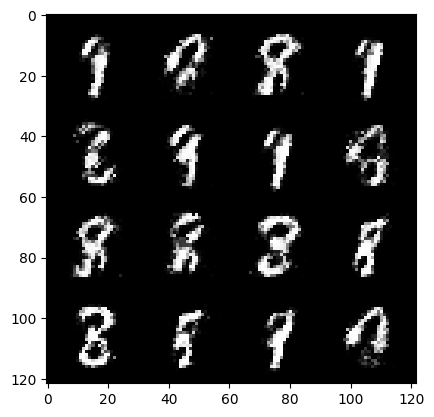

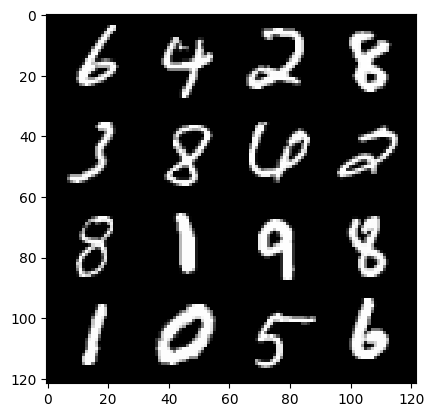

55: step 25800/ gen loss: 4.847184664408363 / disc loss: 0.08596573639040193


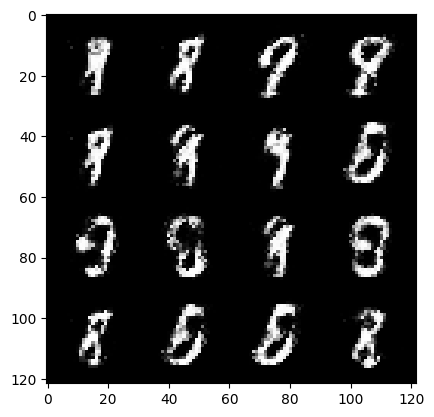

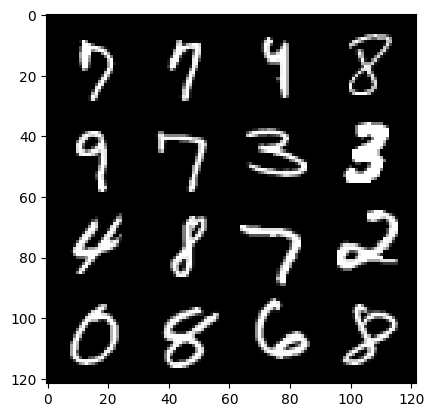

55: step 26100/ gen loss: 4.841795285542805 / disc loss: 0.07262091748416426


  0%|          | 0/469 [00:00<?, ?it/s]

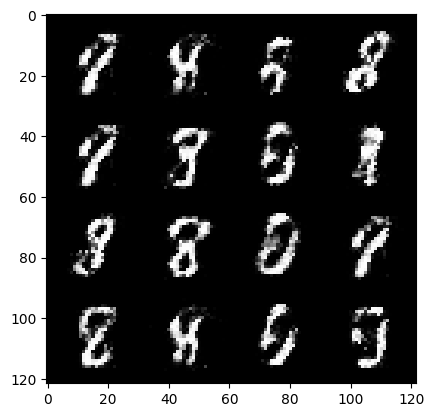

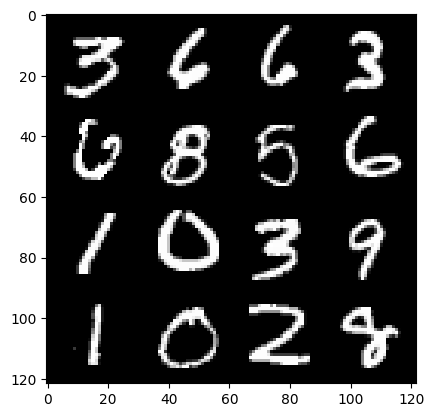

56: step 26400/ gen loss: 4.75417095899582 / disc loss: 0.08559946754326421


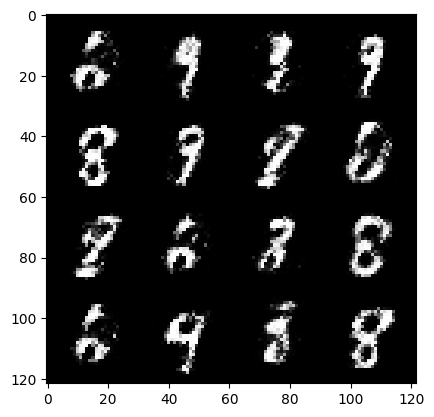

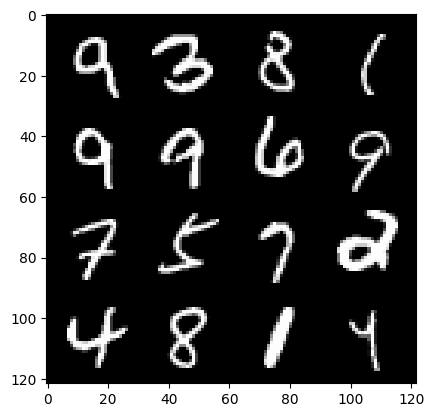

56: step 26700/ gen loss: 4.720481015046437 / disc loss: 0.08682306089748945


  0%|          | 0/469 [00:00<?, ?it/s]

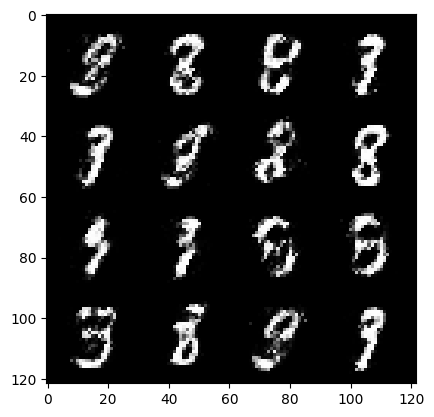

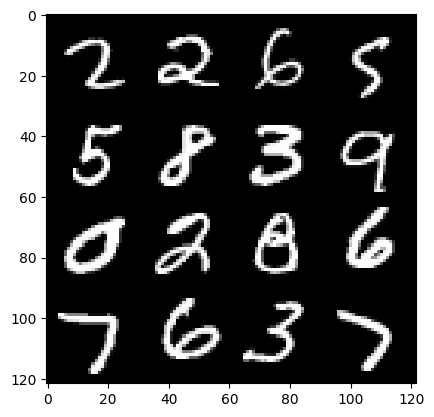

57: step 27000/ gen loss: 4.724940923849742 / disc loss: 0.08768828966965274


  0%|          | 0/469 [00:00<?, ?it/s]

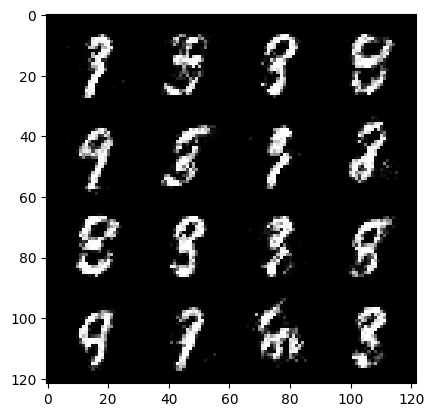

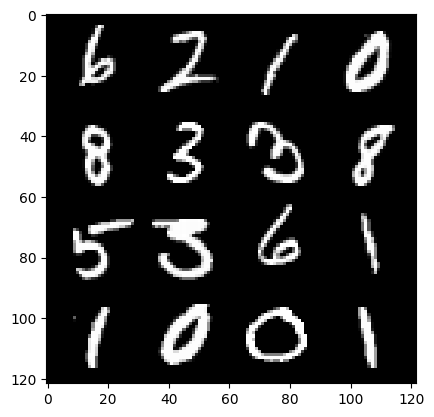

58: step 27300/ gen loss: 4.688796292146044 / disc loss: 0.08746091821541391


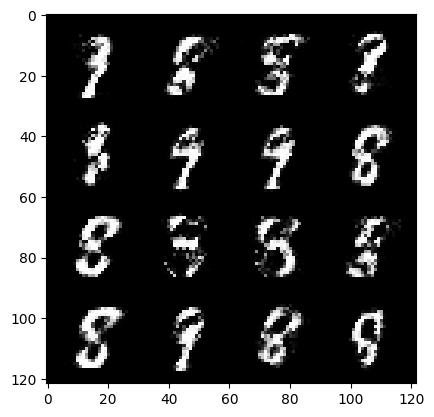

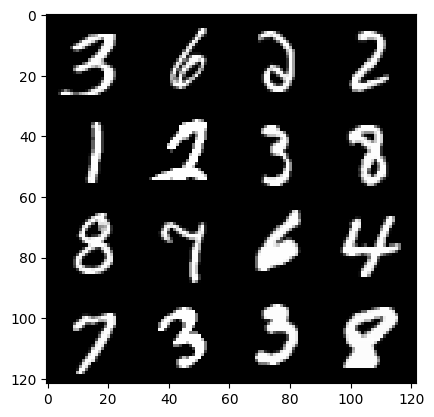

58: step 27600/ gen loss: 4.703262534936272 / disc loss: 0.08343834087873499


  0%|          | 0/469 [00:00<?, ?it/s]

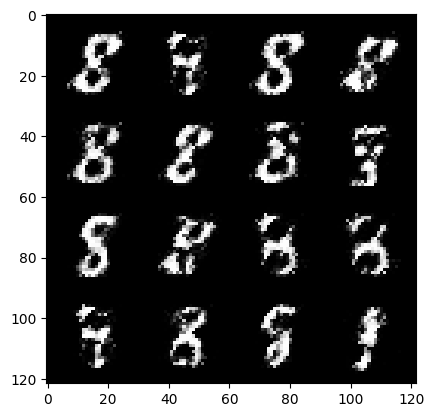

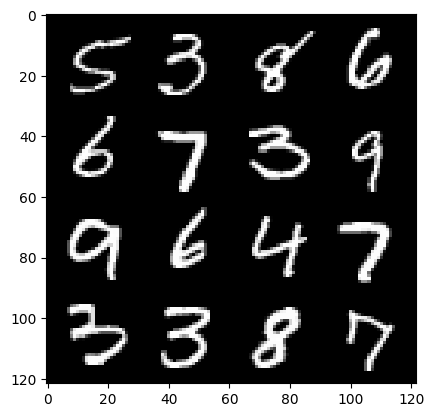

59: step 27900/ gen loss: 4.708815323511762 / disc loss: 0.09088287877539795


  0%|          | 0/469 [00:00<?, ?it/s]

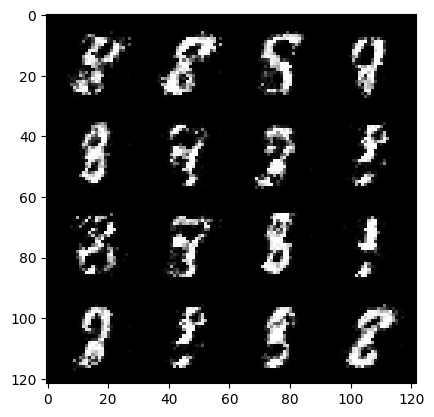

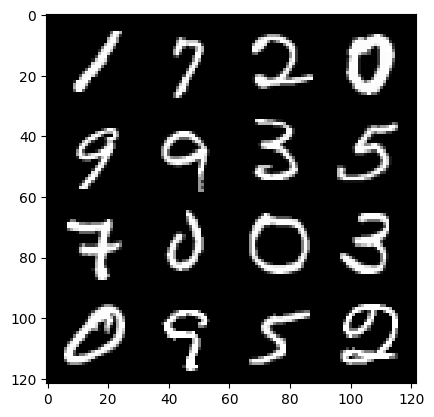

60: step 28200/ gen loss: 4.5960392506917325 / disc loss: 0.07907195266957083


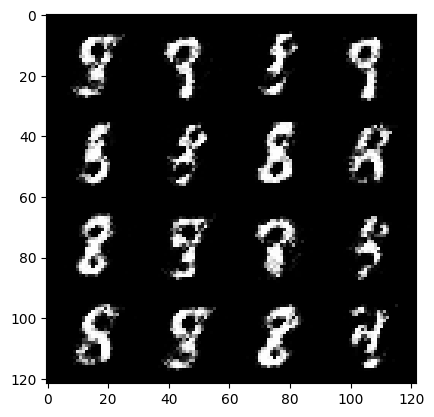

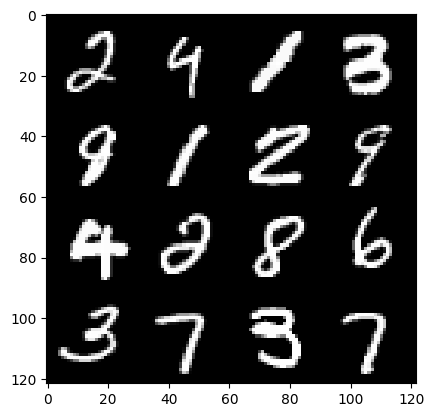

60: step 28500/ gen loss: 4.778627896308898 / disc loss: 0.0783639887658258


  0%|          | 0/469 [00:00<?, ?it/s]

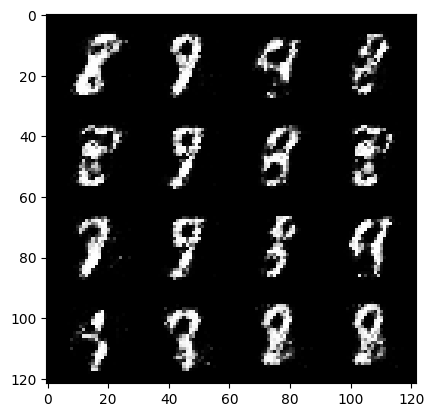

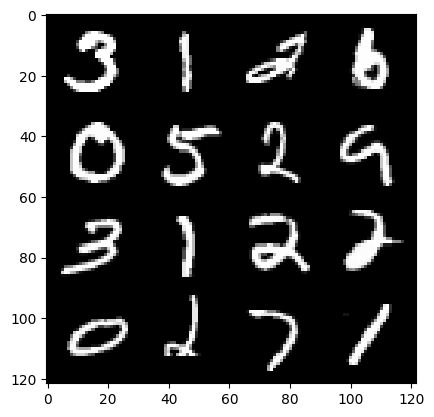

61: step 28800/ gen loss: 4.7189707493782 / disc loss: 0.08056232924883565


  0%|          | 0/469 [00:00<?, ?it/s]

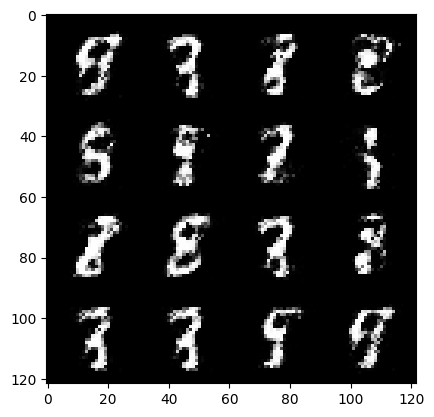

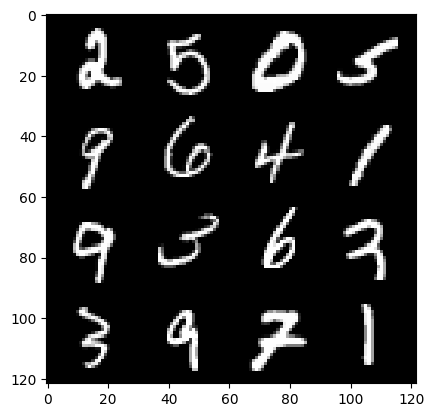

62: step 29100/ gen loss: 4.748297669887544 / disc loss: 0.07831975051512323


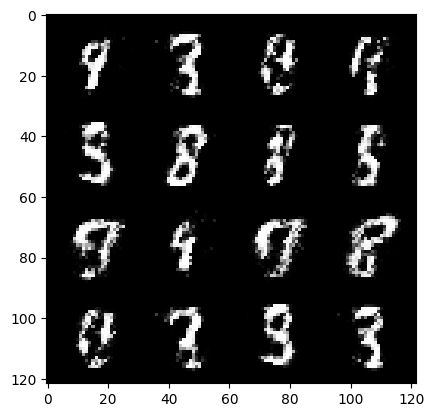

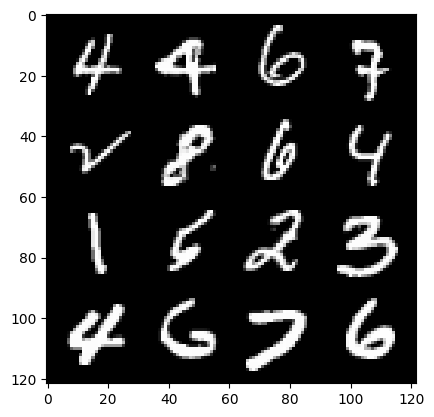

62: step 29400/ gen loss: 4.546662500699361 / disc loss: 0.10607128391663241


  0%|          | 0/469 [00:00<?, ?it/s]

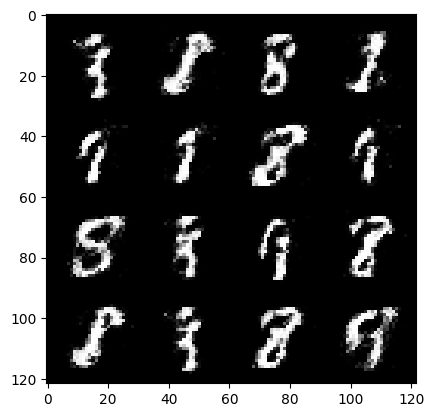

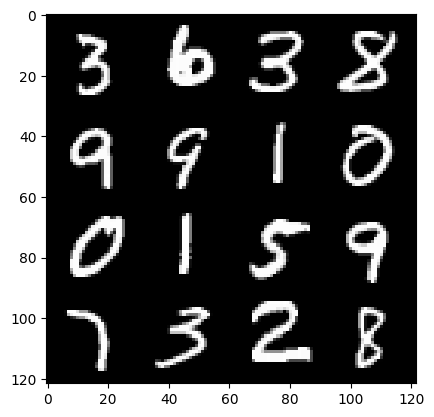

63: step 29700/ gen loss: 4.467675758202869 / disc loss: 0.10314370776216202


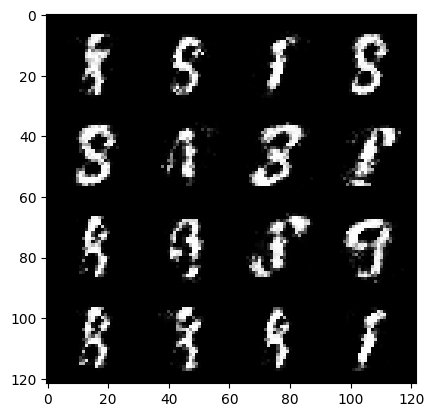

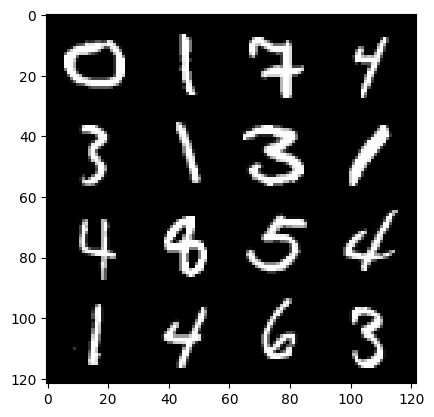

63: step 30000/ gen loss: 4.3707510630289725 / disc loss: 0.10144847190628455


  0%|          | 0/469 [00:00<?, ?it/s]

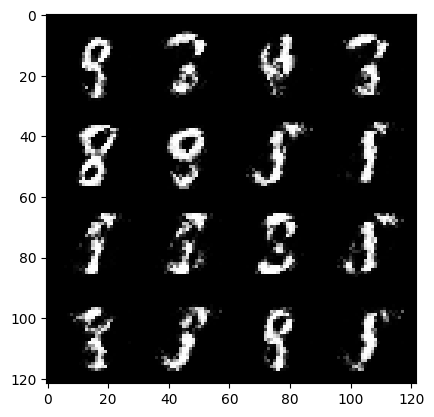

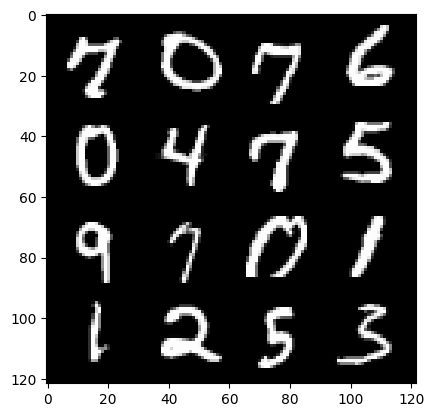

64: step 30300/ gen loss: 4.311474858125051 / disc loss: 0.110002202813824


  0%|          | 0/469 [00:00<?, ?it/s]

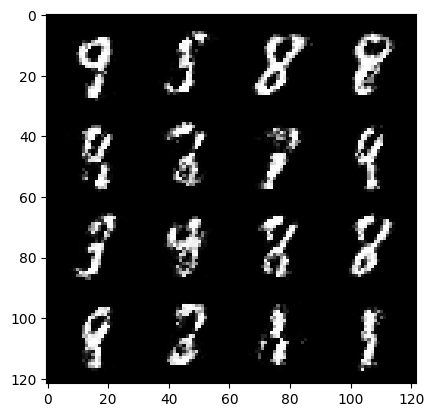

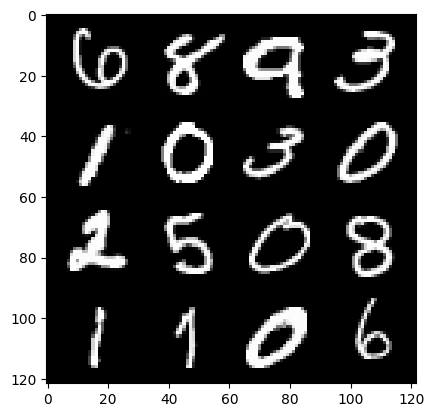

65: step 30600/ gen loss: 4.501674852371214 / disc loss: 0.08982513061414166


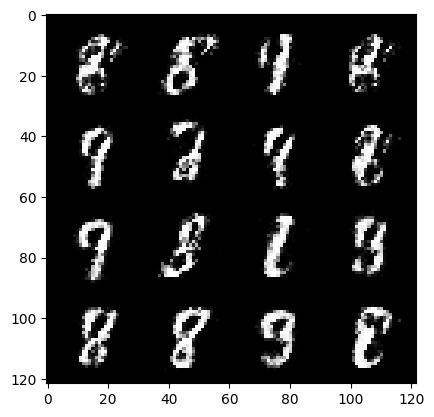

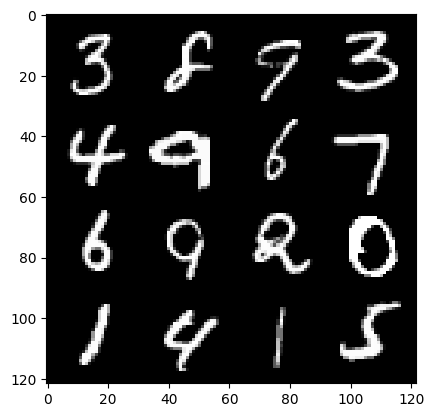

65: step 30900/ gen loss: 4.522803483804067 / disc loss: 0.09219182309384154


  0%|          | 0/469 [00:00<?, ?it/s]

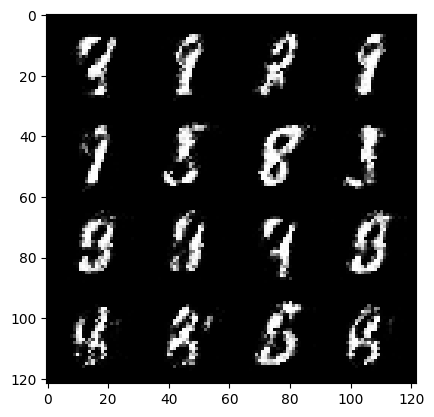

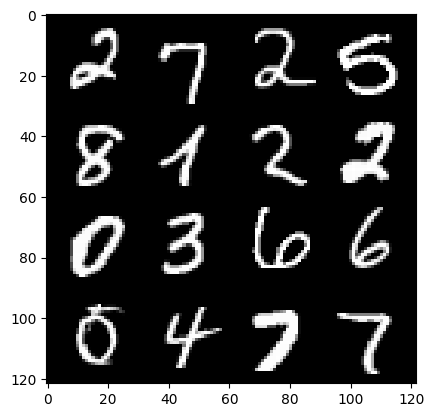

66: step 31200/ gen loss: 4.284445796012878 / disc loss: 0.1133540467793743


  0%|          | 0/469 [00:00<?, ?it/s]

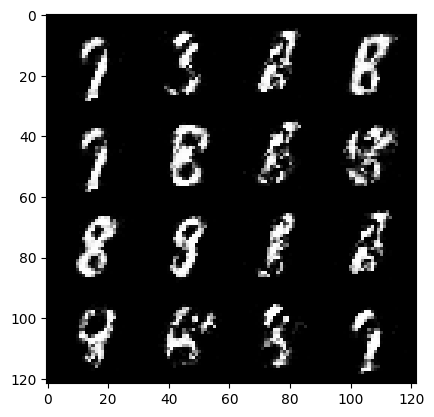

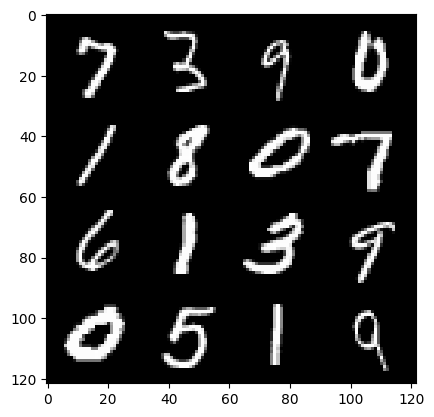

67: step 31500/ gen loss: 4.635790108839671 / disc loss: 0.09800094866504272


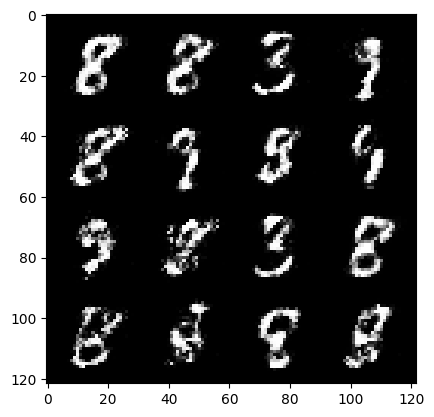

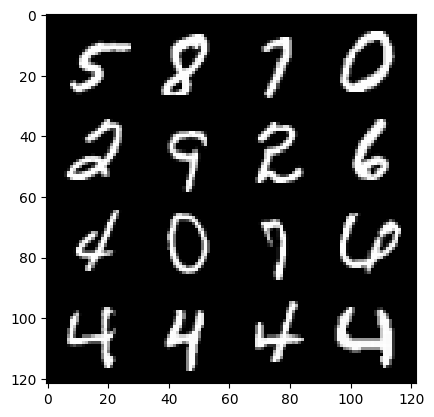

67: step 31800/ gen loss: 4.334166351159415 / disc loss: 0.11260263788203395


  0%|          | 0/469 [00:00<?, ?it/s]

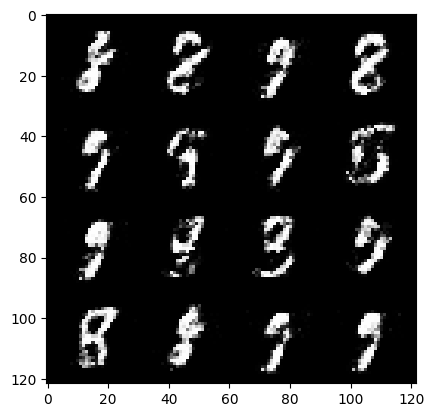

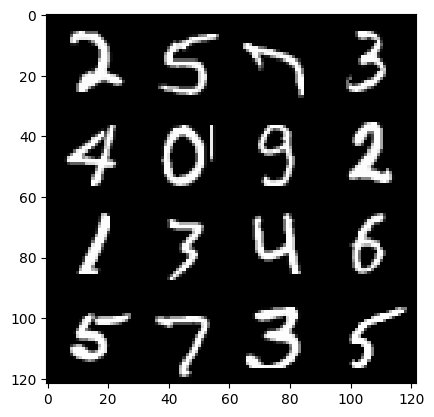

68: step 32100/ gen loss: 3.9690448760986334 / disc loss: 0.12541151539733006


  0%|          | 0/469 [00:00<?, ?it/s]

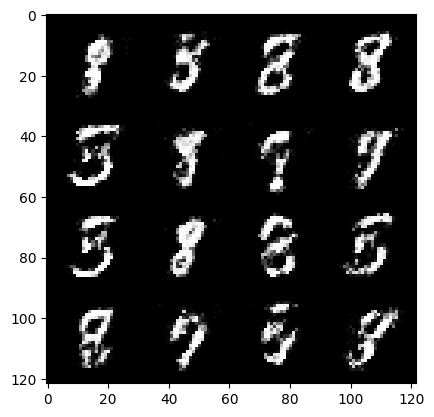

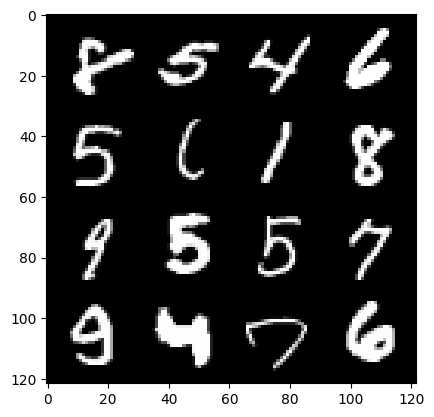

69: step 32400/ gen loss: 4.229029083251954 / disc loss: 0.10634732705851395


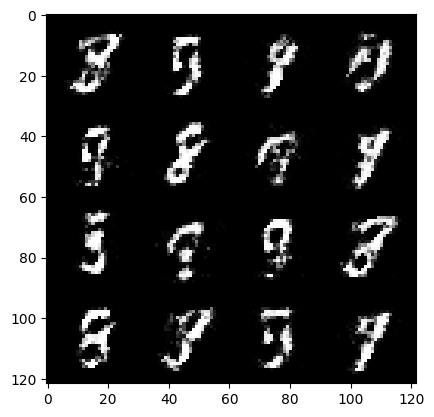

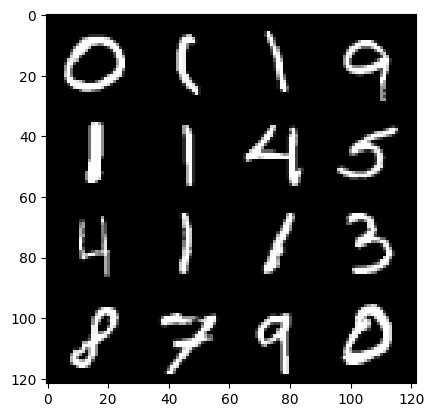

69: step 32700/ gen loss: 4.171689468224844 / disc loss: 0.11125157137711843


  0%|          | 0/469 [00:00<?, ?it/s]

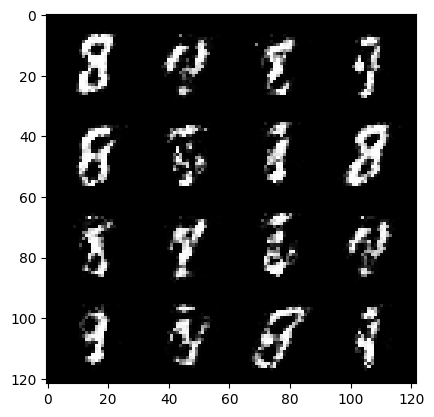

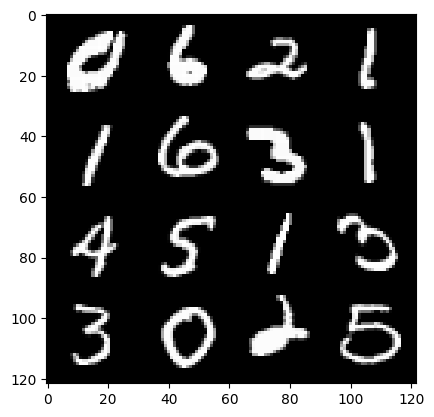

70: step 33000/ gen loss: 4.177344284852347 / disc loss: 0.11390910323709245


  0%|          | 0/469 [00:00<?, ?it/s]

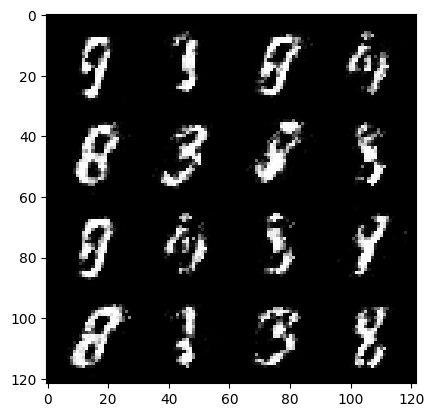

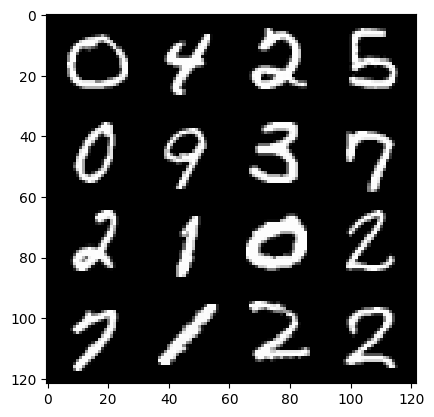

71: step 33300/ gen loss: 3.95756636460622 / disc loss: 0.11597973854591452


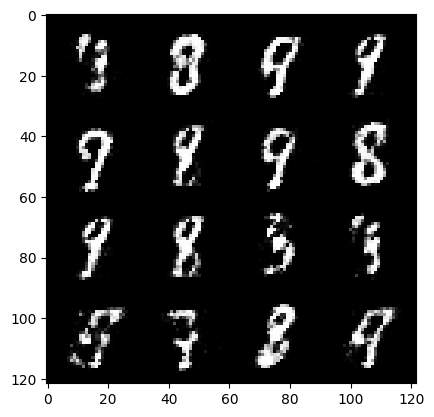

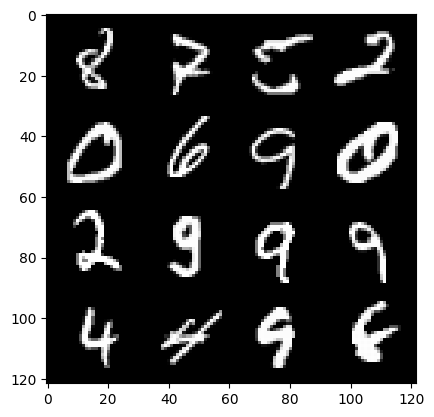

71: step 33600/ gen loss: 3.8941148392359413 / disc loss: 0.1171698532750209


  0%|          | 0/469 [00:00<?, ?it/s]

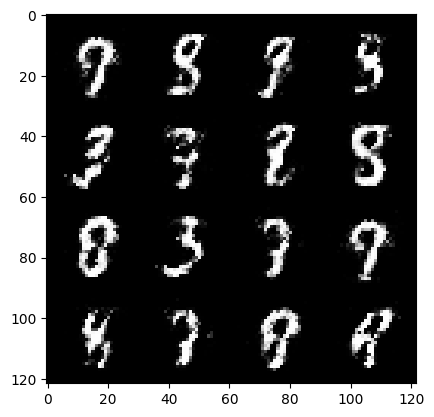

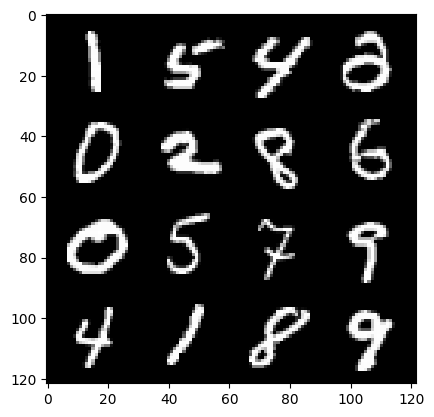

72: step 33900/ gen loss: 4.054613268375398 / disc loss: 0.09910853969554109


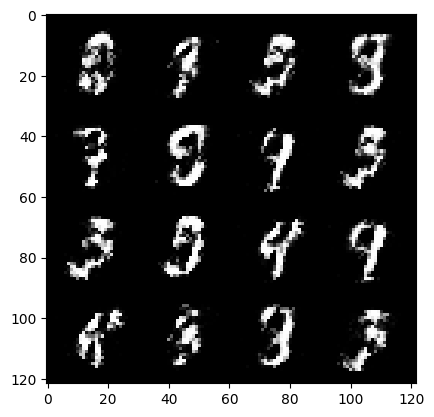

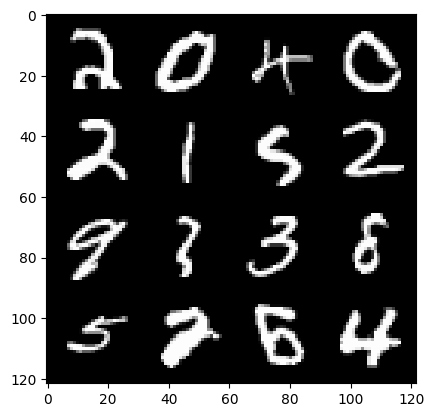

72: step 34200/ gen loss: 4.254959196249641 / disc loss: 0.10376087798426546


  0%|          | 0/469 [00:00<?, ?it/s]

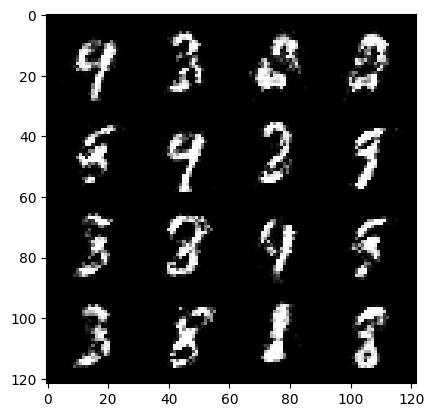

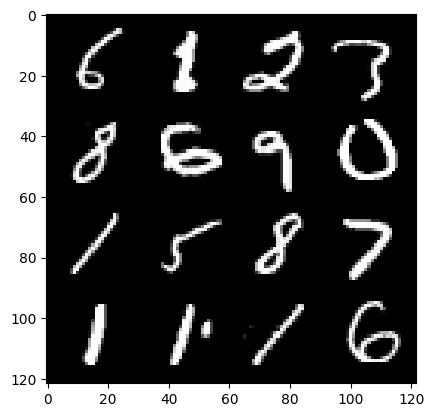

73: step 34500/ gen loss: 4.156154723962147 / disc loss: 0.12019042530407513


  0%|          | 0/469 [00:00<?, ?it/s]

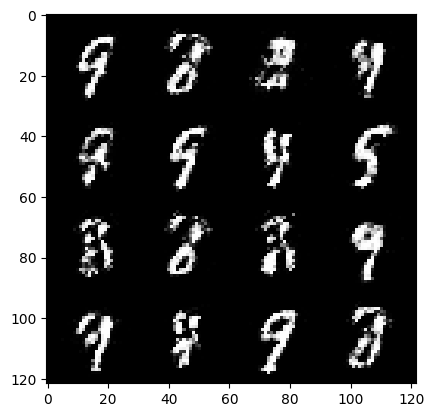

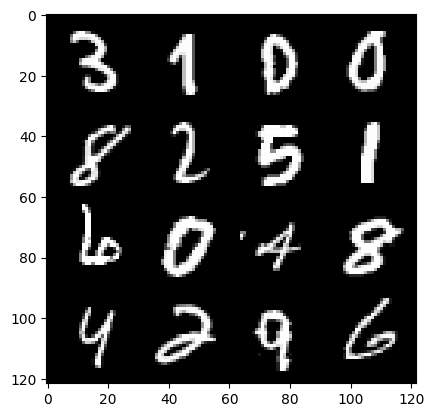

74: step 34800/ gen loss: 3.898297414779662 / disc loss: 0.13675878296295796


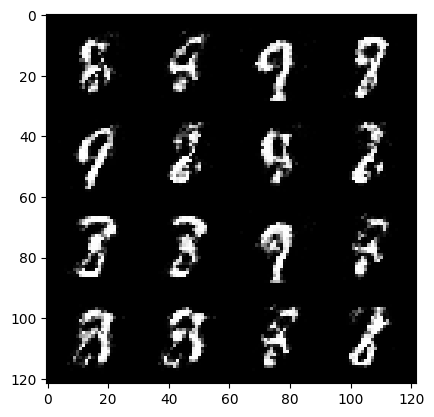

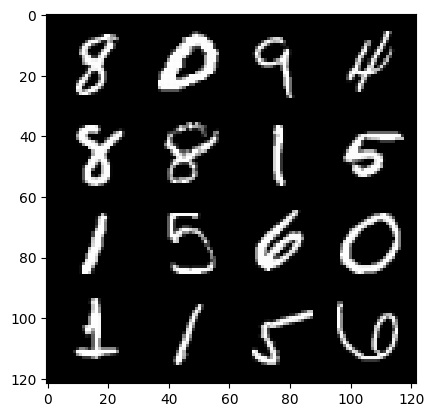

74: step 35100/ gen loss: 3.998679312864939 / disc loss: 0.11767899025231597


  0%|          | 0/469 [00:00<?, ?it/s]

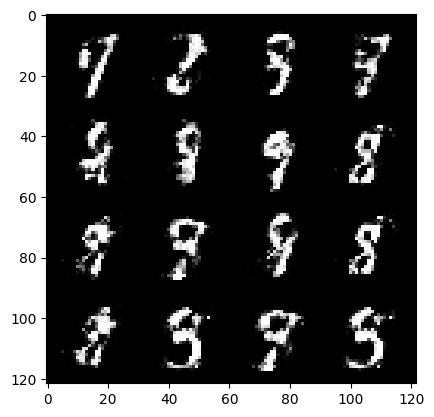

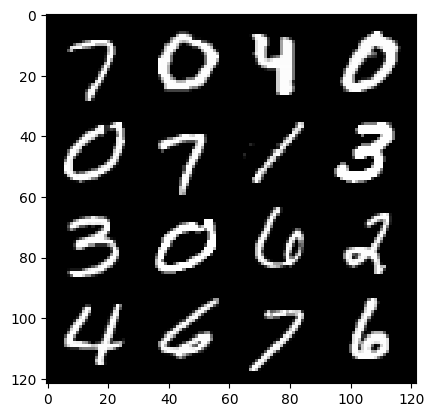

75: step 35400/ gen loss: 3.7776528350512177 / disc loss: 0.13643103569746018


  0%|          | 0/469 [00:00<?, ?it/s]

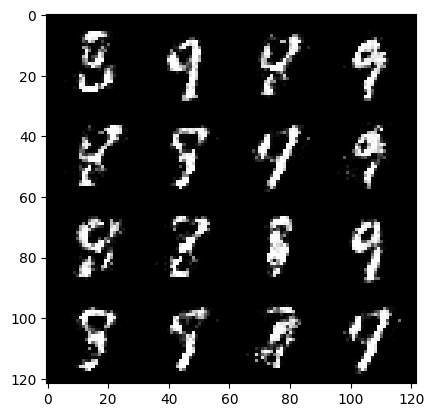

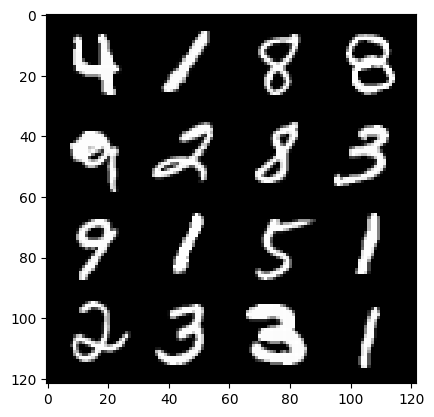

76: step 35700/ gen loss: 3.8061687080065405 / disc loss: 0.12671243216842415


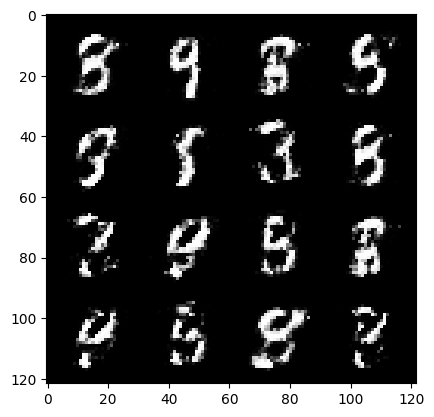

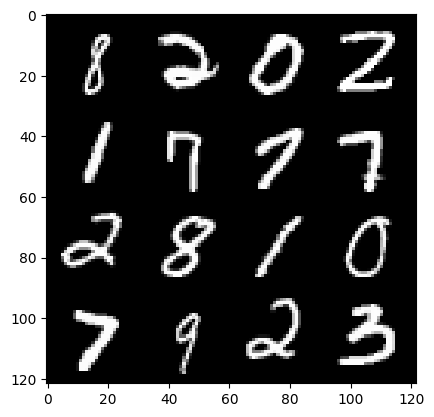

76: step 36000/ gen loss: 4.142683920860292 / disc loss: 0.11126333477596452


  0%|          | 0/469 [00:00<?, ?it/s]

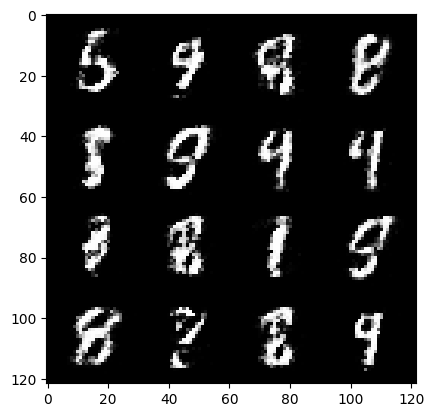

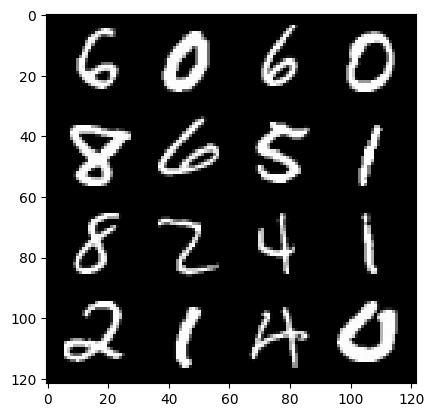

77: step 36300/ gen loss: 3.8003886500994355 / disc loss: 0.12281195256859072


  0%|          | 0/469 [00:00<?, ?it/s]

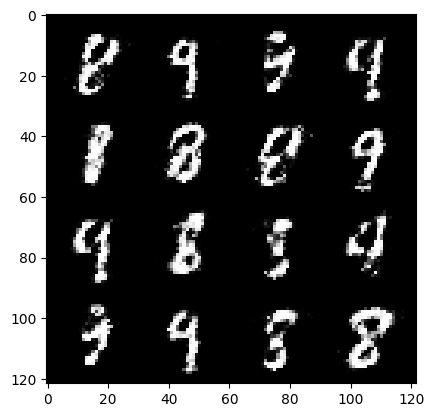

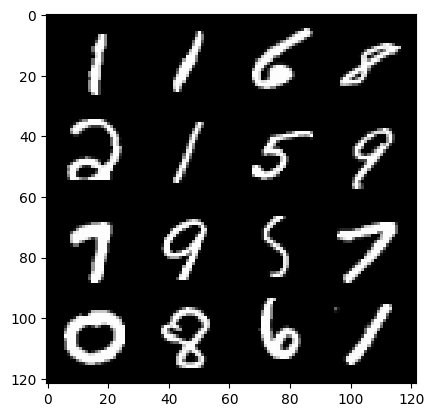

78: step 36600/ gen loss: 3.8323755606015513 / disc loss: 0.11653834652155641


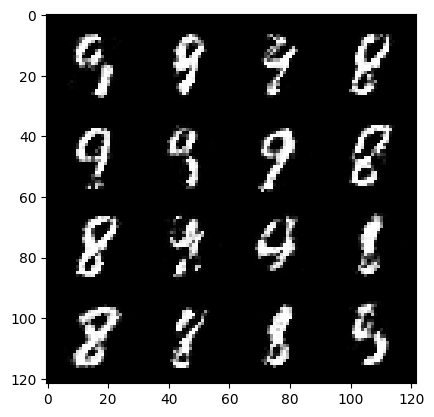

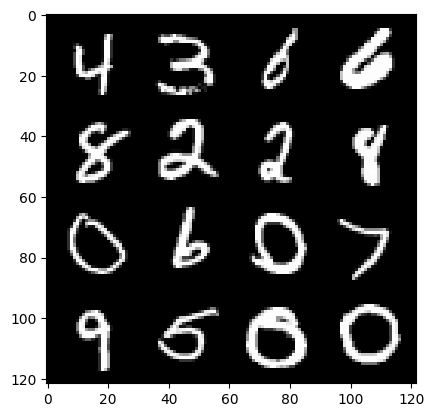

78: step 36900/ gen loss: 3.8331428654988606 / disc loss: 0.12750441701461862


  0%|          | 0/469 [00:00<?, ?it/s]

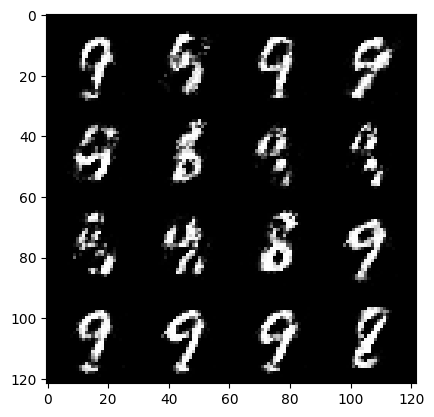

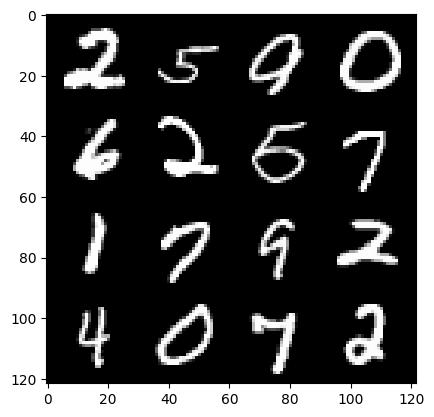

79: step 37200/ gen loss: 3.6604077720642048 / disc loss: 0.1443925416966279


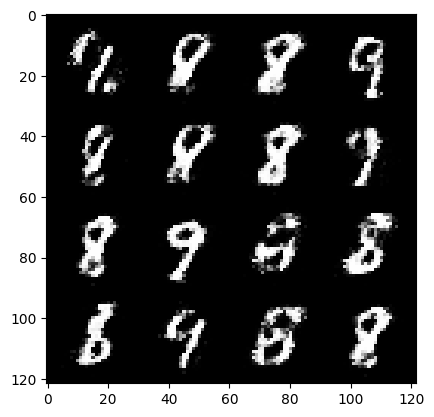

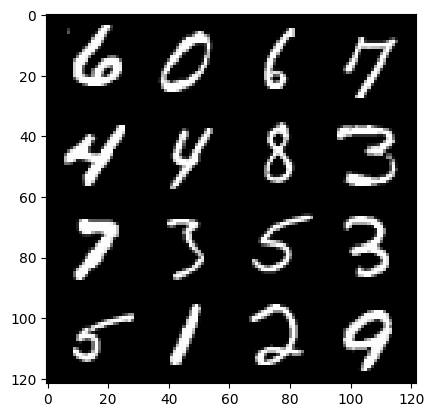

79: step 37500/ gen loss: 3.835940384070079 / disc loss: 0.13567579558740053


  0%|          | 0/469 [00:00<?, ?it/s]

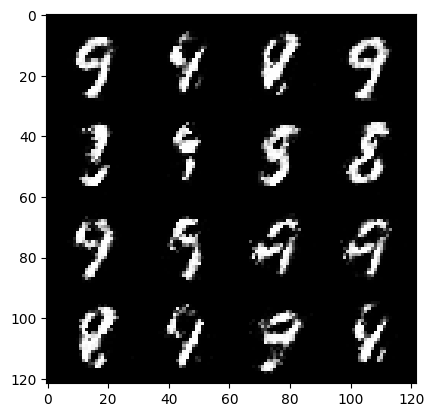

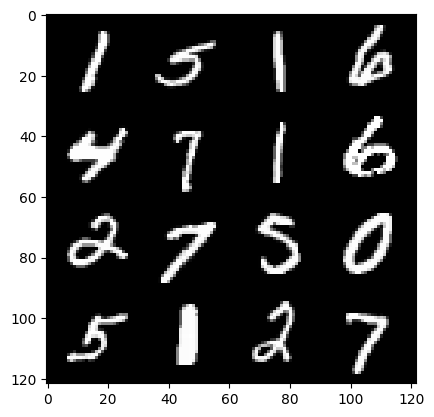

80: step 37800/ gen loss: 3.7771574147542313 / disc loss: 0.1250223023444414


  0%|          | 0/469 [00:00<?, ?it/s]

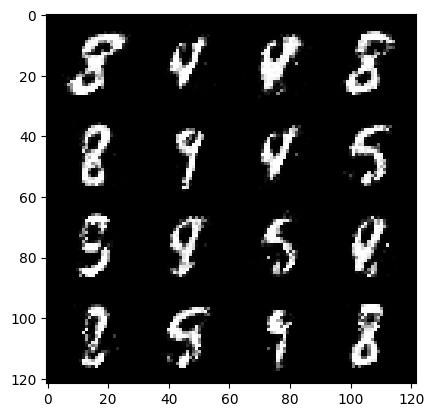

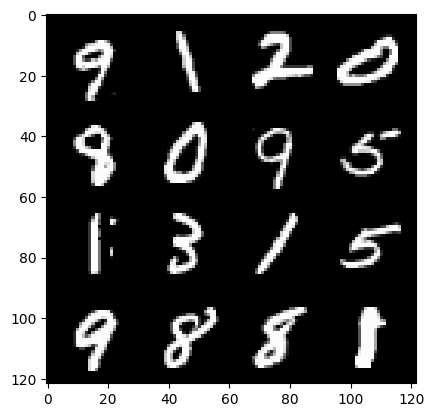

81: step 38100/ gen loss: 3.7799049425125144 / disc loss: 0.1311172838757436


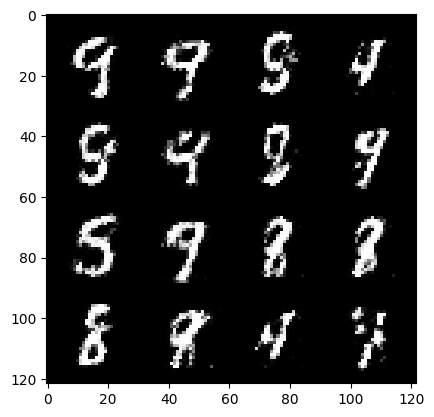

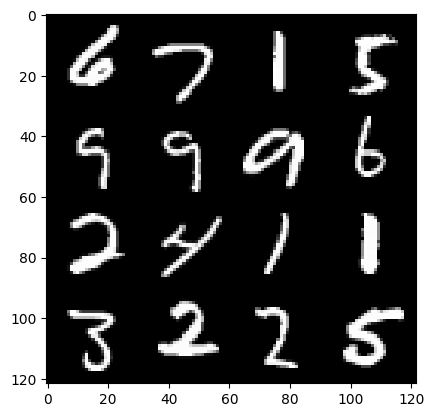

81: step 38400/ gen loss: 3.495954915682475 / disc loss: 0.16341304779052743


  0%|          | 0/469 [00:00<?, ?it/s]

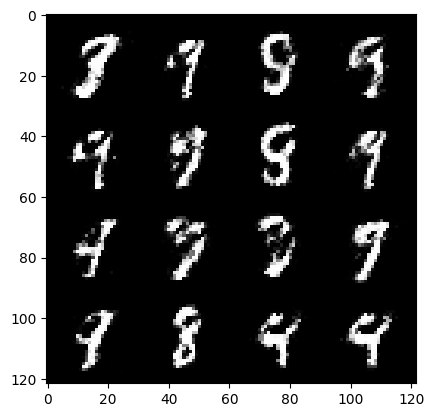

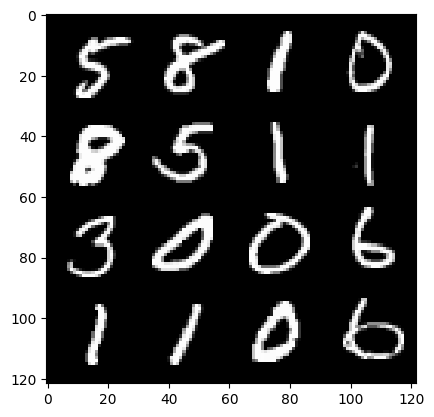

82: step 38700/ gen loss: 3.4812448573112476 / disc loss: 0.15677334224184358


  0%|          | 0/469 [00:00<?, ?it/s]

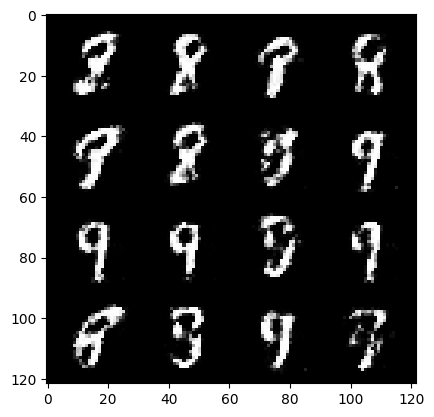

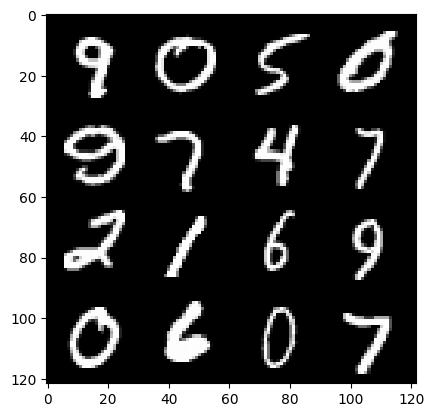

83: step 39000/ gen loss: 3.5342039791742947 / disc loss: 0.15242130545278382


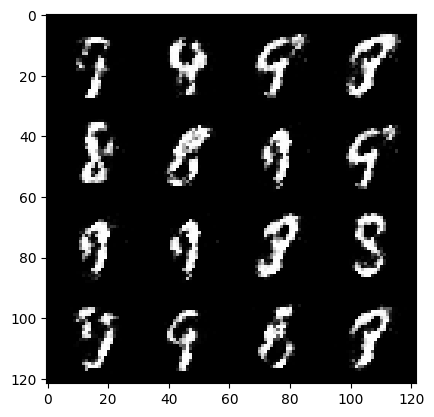

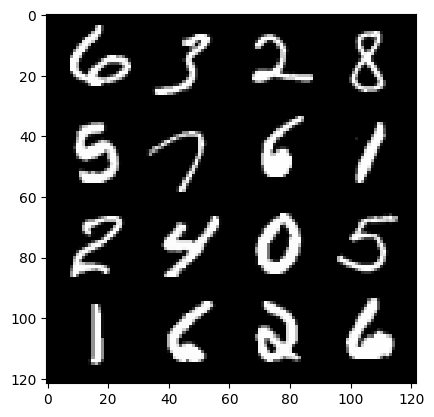

83: step 39300/ gen loss: 3.49906105041504 / disc loss: 0.14262278096129508


  0%|          | 0/469 [00:00<?, ?it/s]

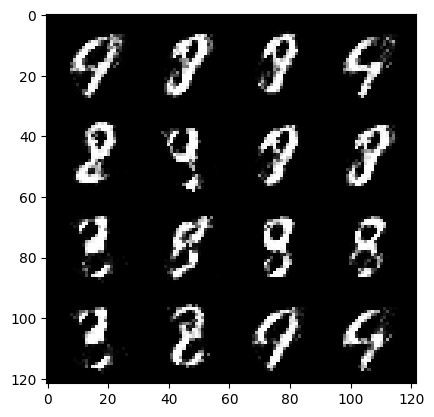

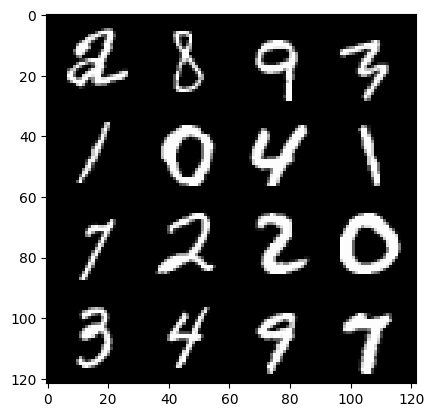

84: step 39600/ gen loss: 3.4709903160731015 / disc loss: 0.14015679286171992


  0%|          | 0/469 [00:00<?, ?it/s]

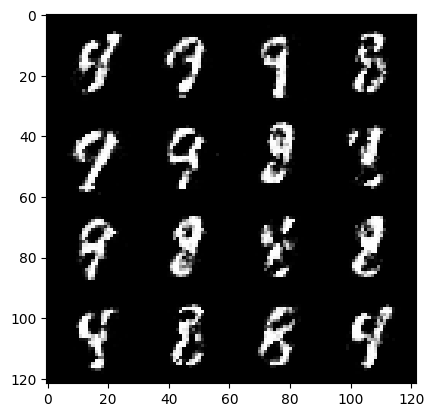

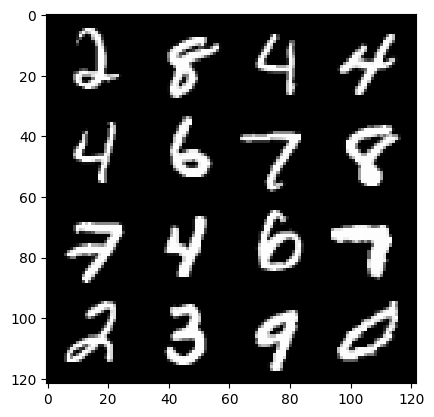

85: step 39900/ gen loss: 3.5792122864723206 / disc loss: 0.13850539964934194


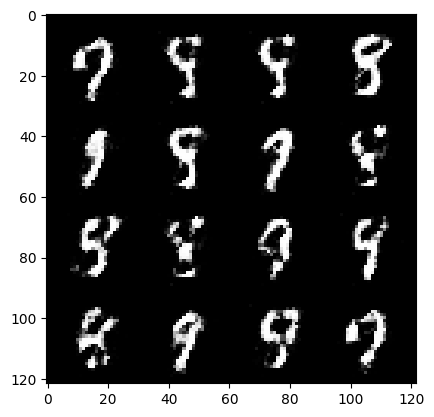

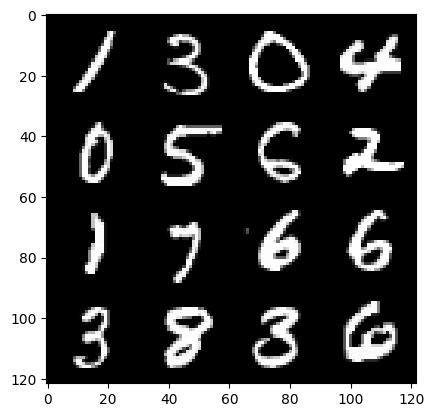

85: step 40200/ gen loss: 3.571194800535839 / disc loss: 0.1452809727936983


  0%|          | 0/469 [00:00<?, ?it/s]

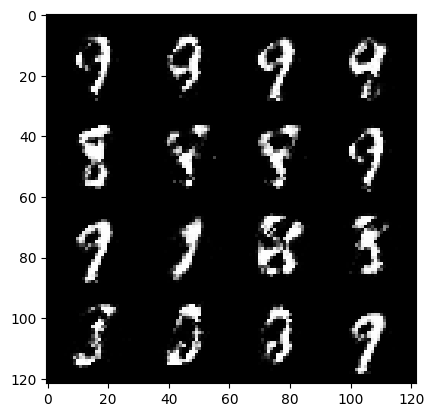

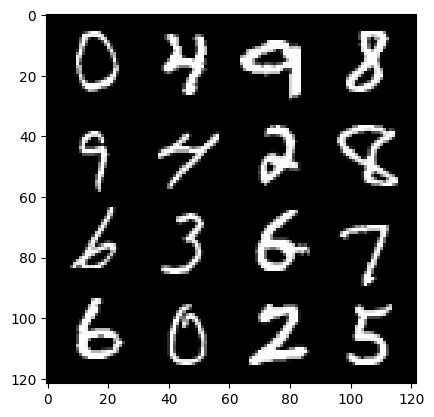

86: step 40500/ gen loss: 3.4713610935211183 / disc loss: 0.15347144208848476


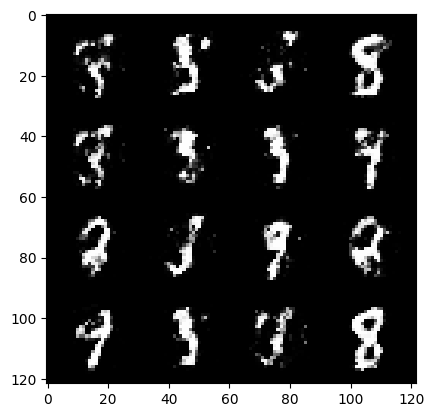

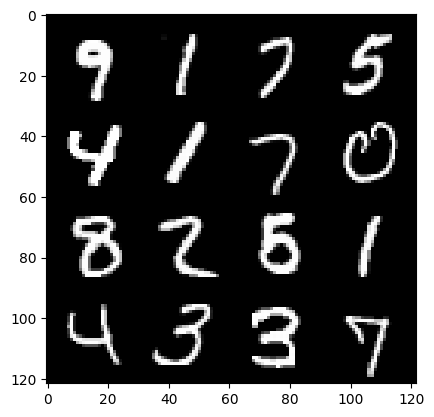

86: step 40800/ gen loss: 3.45107493718465 / disc loss: 0.14882053832213088


  0%|          | 0/469 [00:00<?, ?it/s]

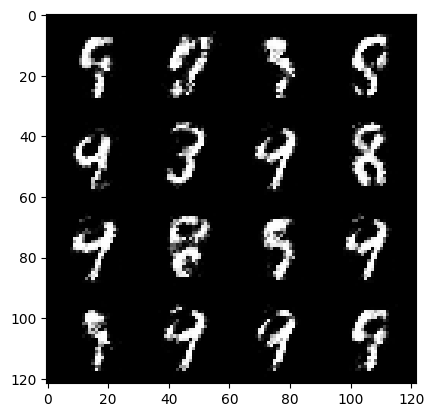

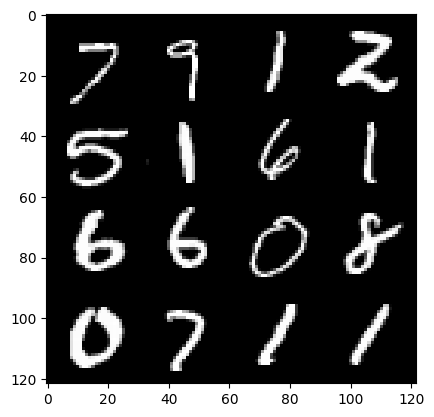

87: step 41100/ gen loss: 3.40689409653346 / disc loss: 0.13898230048517385


  0%|          | 0/469 [00:00<?, ?it/s]

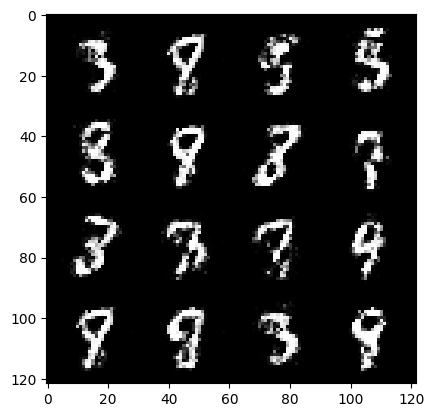

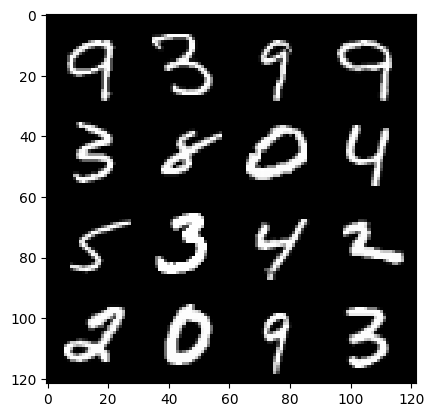

88: step 41400/ gen loss: 3.4915443054834956 / disc loss: 0.14288097828626628


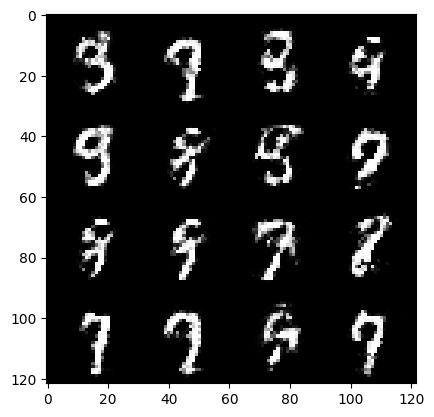

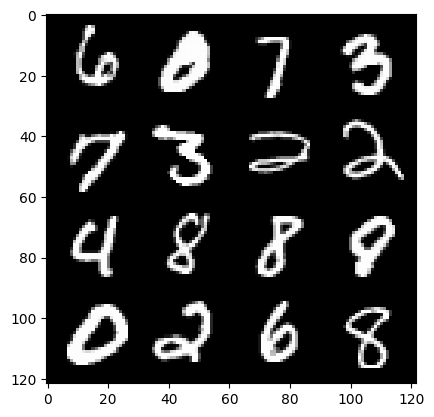

88: step 41700/ gen loss: 3.351249046325684 / disc loss: 0.16436821247140576


  0%|          | 0/469 [00:00<?, ?it/s]

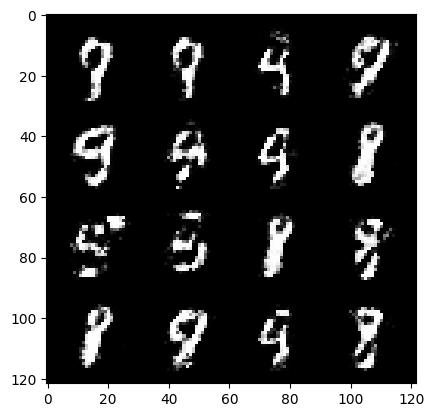

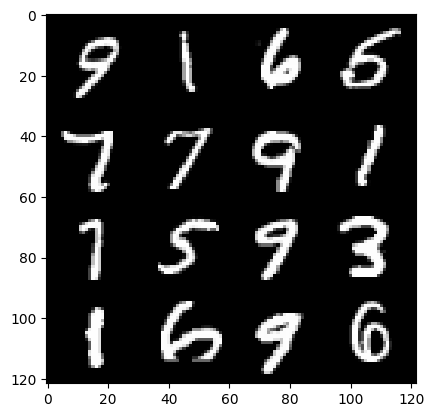

89: step 42000/ gen loss: 3.4244718146324176 / disc loss: 0.14855110349754488


  0%|          | 0/469 [00:00<?, ?it/s]

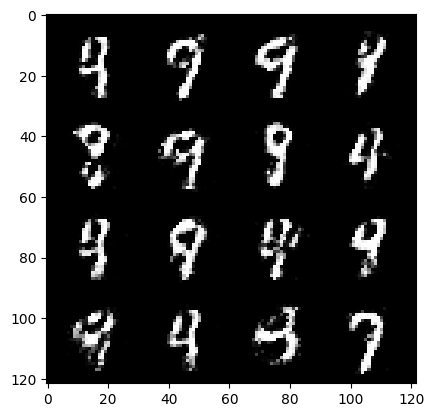

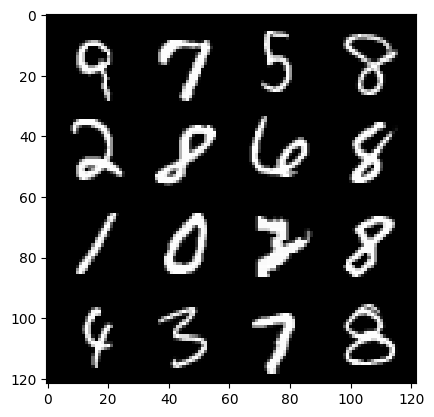

90: step 42300/ gen loss: 3.332197755177817 / disc loss: 0.1562358791877827


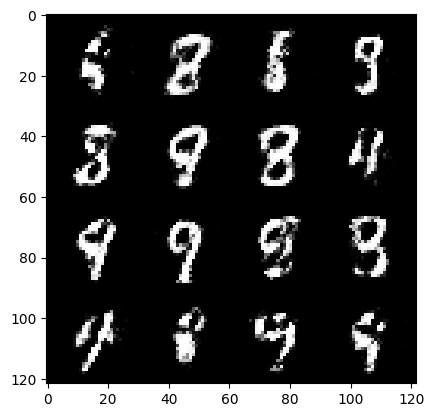

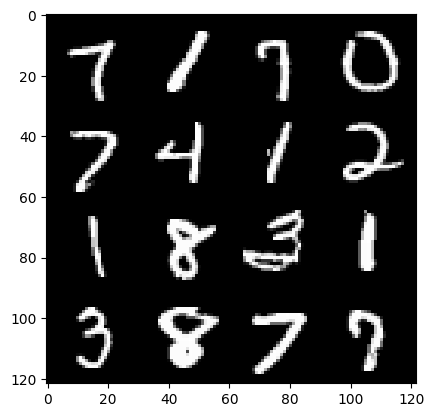

90: step 42600/ gen loss: 3.2874907104174294 / disc loss: 0.15706310678273436


  0%|          | 0/469 [00:00<?, ?it/s]

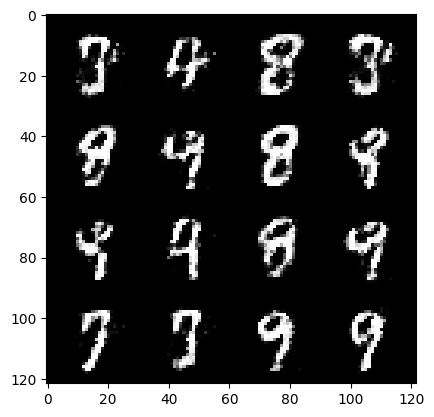

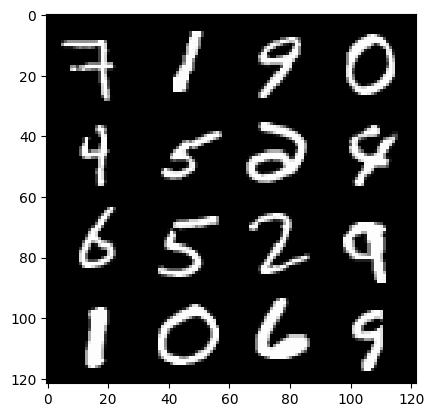

91: step 42900/ gen loss: 3.405467084248861 / disc loss: 0.15633143007755282


  0%|          | 0/469 [00:00<?, ?it/s]

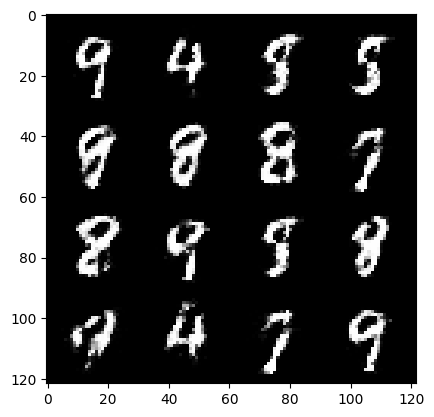

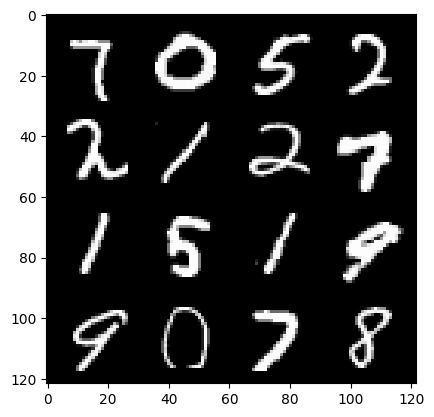

92: step 43200/ gen loss: 3.3114325992266362 / disc loss: 0.16248507144550473


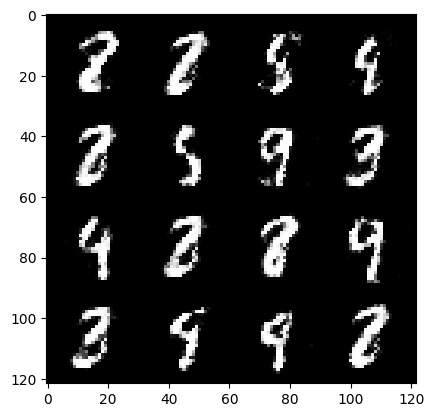

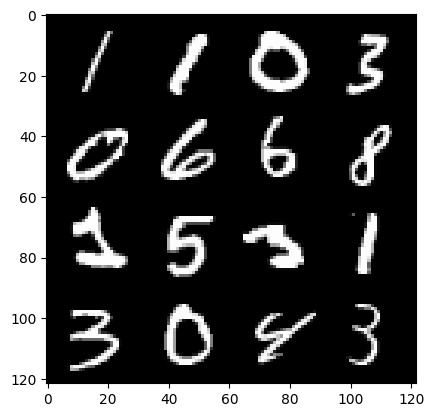

92: step 43500/ gen loss: 3.3377816041310635 / disc loss: 0.156667491843303


  0%|          | 0/469 [00:00<?, ?it/s]

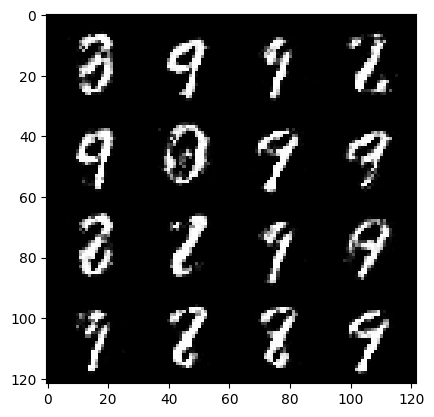

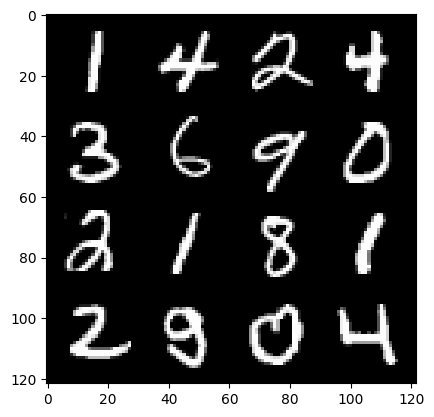

93: step 43800/ gen loss: 3.1291478013992324 / disc loss: 0.17687724786500145


  0%|          | 0/469 [00:00<?, ?it/s]

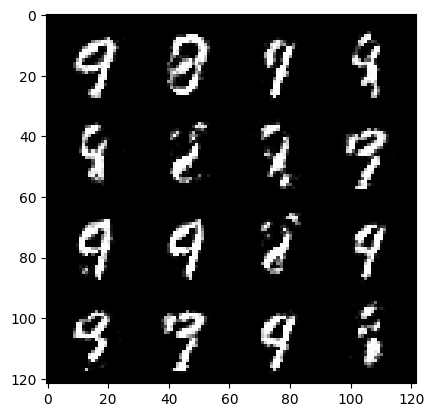

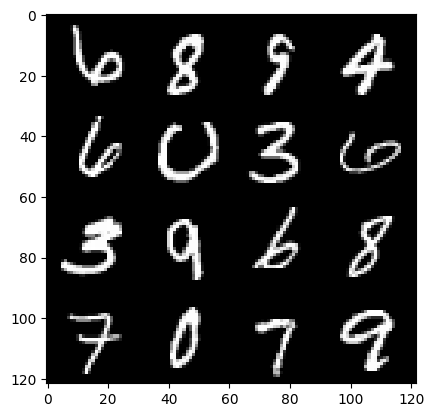

94: step 44100/ gen loss: 3.110506916046141 / disc loss: 0.18121481684346996


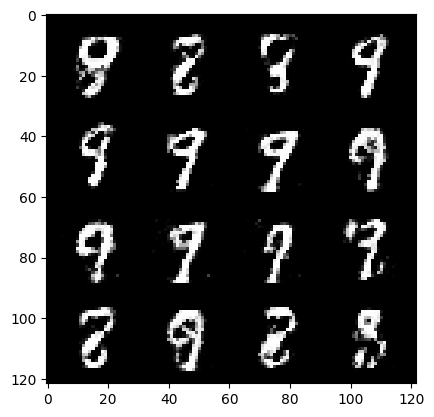

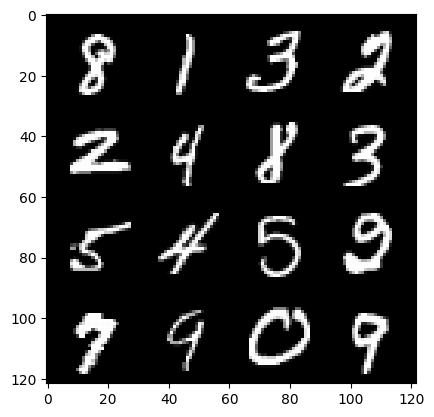

94: step 44400/ gen loss: 3.1847067387898775 / disc loss: 0.16885665886104093


  0%|          | 0/469 [00:00<?, ?it/s]

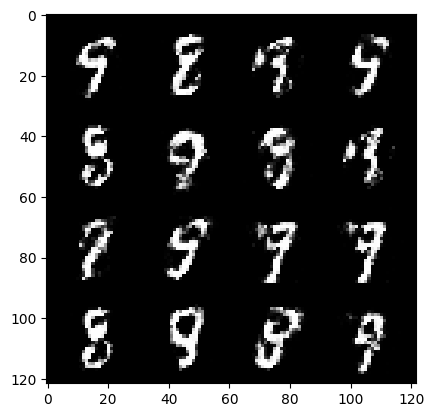

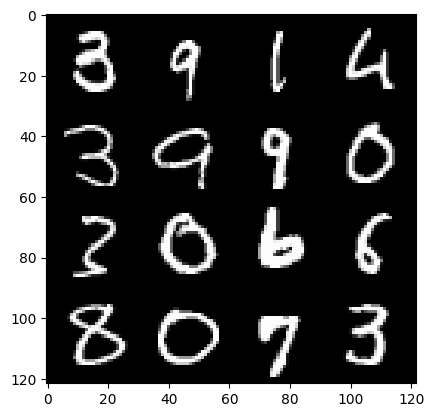

95: step 44700/ gen loss: 3.359803938070932 / disc loss: 0.16910117601354913


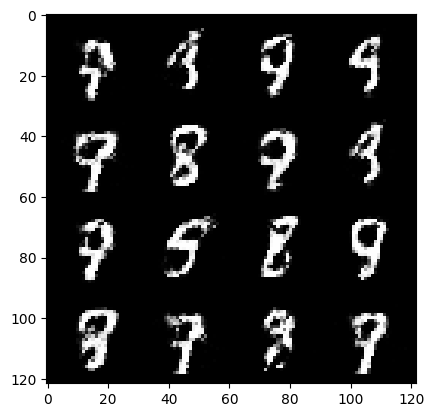

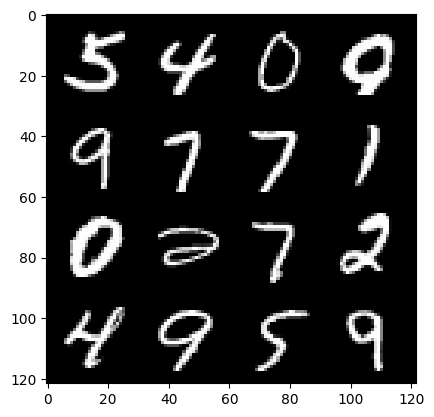

95: step 45000/ gen loss: 3.1671553683280944 / disc loss: 0.18065419199566068


  0%|          | 0/469 [00:00<?, ?it/s]

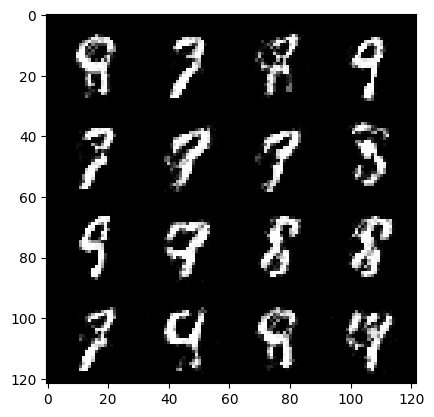

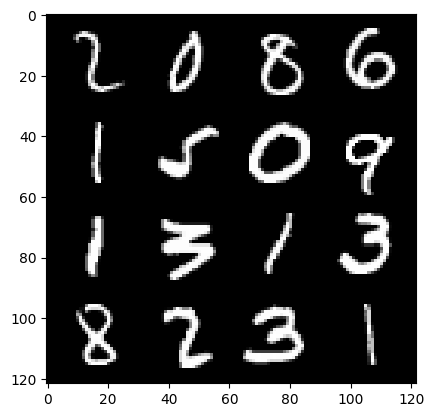

96: step 45300/ gen loss: 3.1695865956942235 / disc loss: 0.1899212825298311


  0%|          | 0/469 [00:00<?, ?it/s]

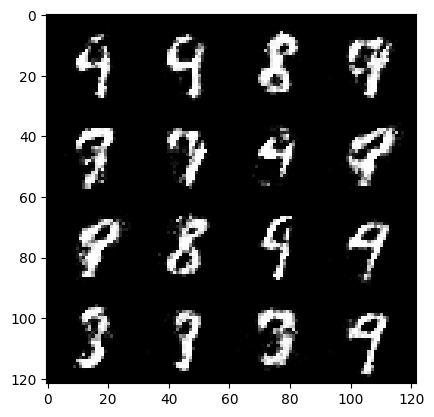

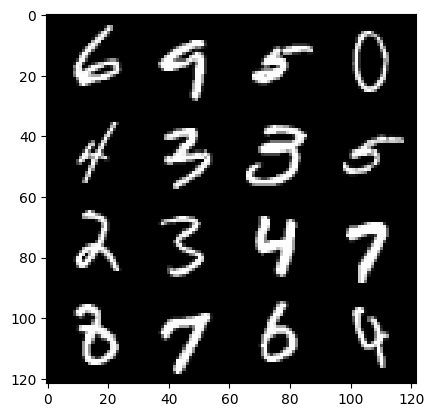

97: step 45600/ gen loss: 3.019465010960895 / disc loss: 0.19478235274553302


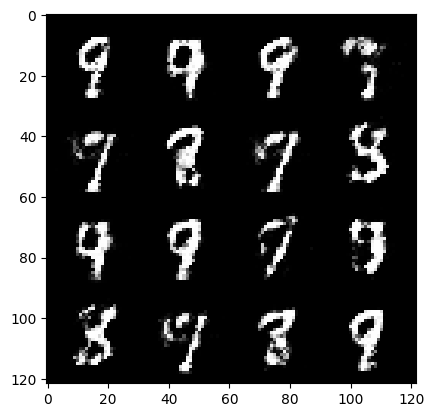

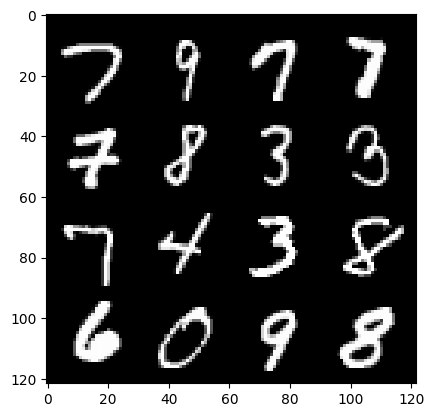

97: step 45900/ gen loss: 2.949535042444866 / disc loss: 0.20242667794227598


  0%|          | 0/469 [00:00<?, ?it/s]

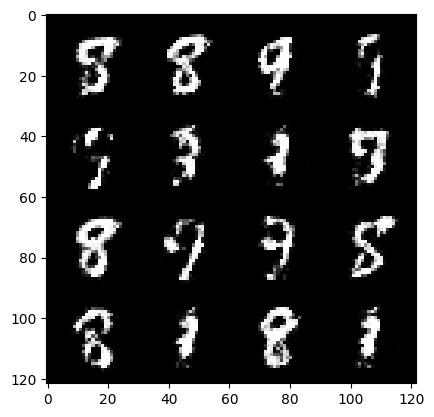

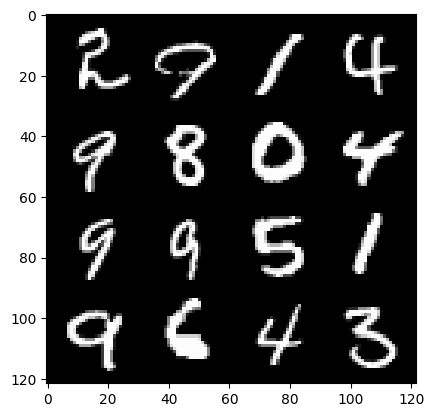

98: step 46200/ gen loss: 2.987400579452515 / disc loss: 0.2016124486426512


  0%|          | 0/469 [00:00<?, ?it/s]

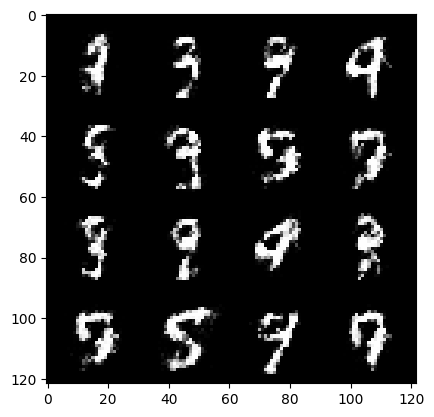

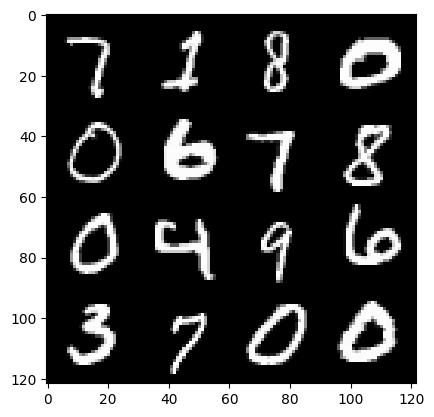

99: step 46500/ gen loss: 2.9813523856798825 / disc loss: 0.1903525068362554


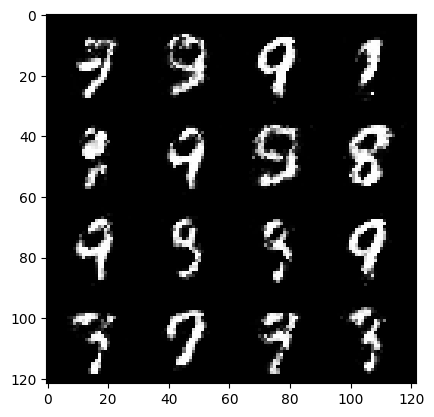

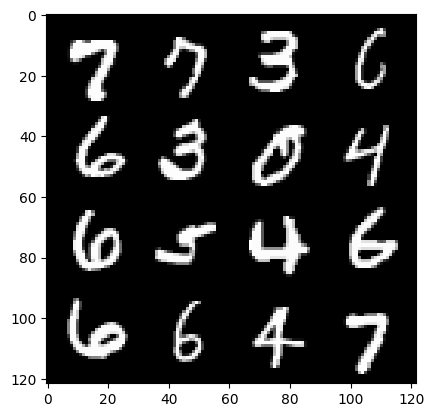

99: step 46800/ gen loss: 2.9988620583216354 / disc loss: 0.18303292331596224


  0%|          | 0/469 [00:00<?, ?it/s]

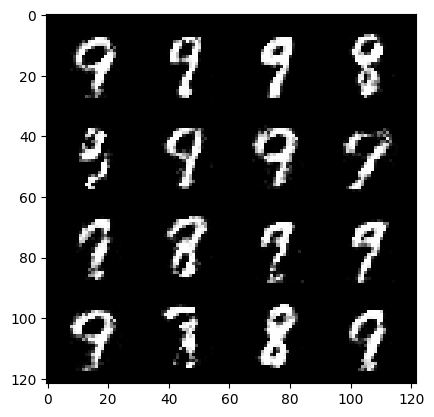

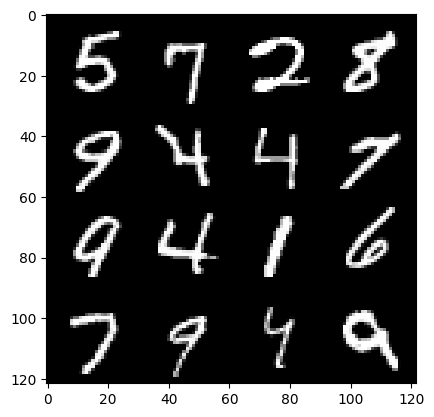

100: step 47100/ gen loss: 3.0186252713203414 / disc loss: 0.18943193798263872


  0%|          | 0/469 [00:00<?, ?it/s]

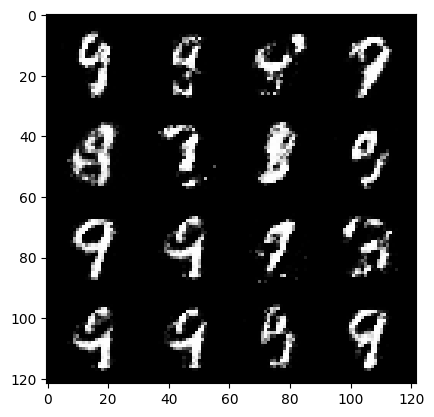

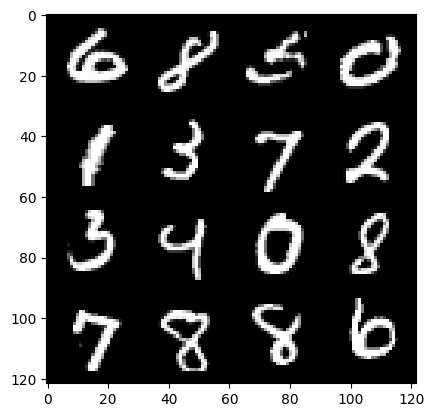

101: step 47400/ gen loss: 2.9868748633066815 / disc loss: 0.19342926770448693


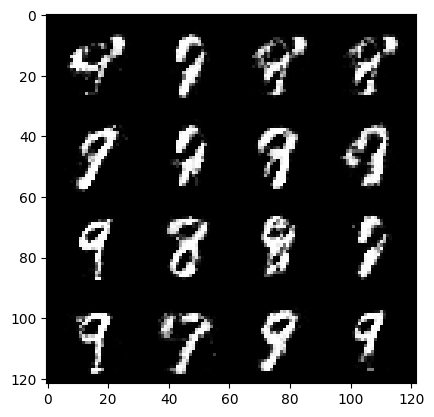

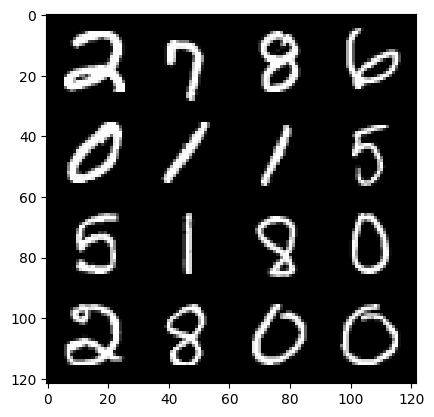

101: step 47700/ gen loss: 2.923612507184347 / disc loss: 0.2101043483614921


  0%|          | 0/469 [00:00<?, ?it/s]

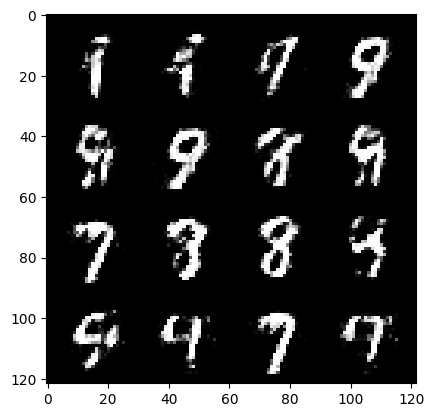

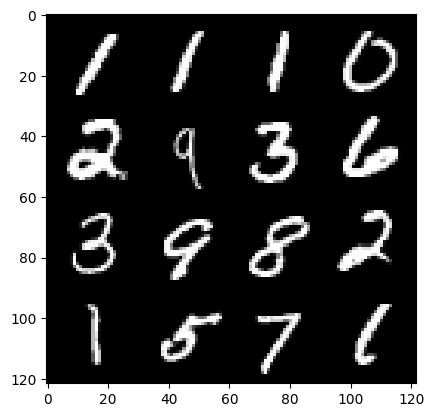

102: step 48000/ gen loss: 2.807210900783538 / disc loss: 0.21604470091561478


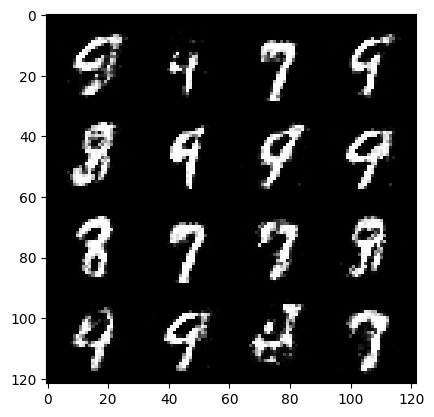

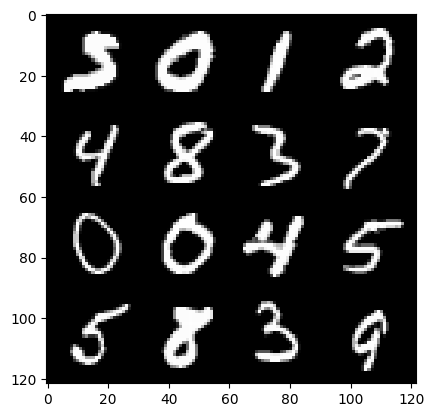

102: step 48300/ gen loss: 2.8097807343800865 / disc loss: 0.2200035892923672


  0%|          | 0/469 [00:00<?, ?it/s]

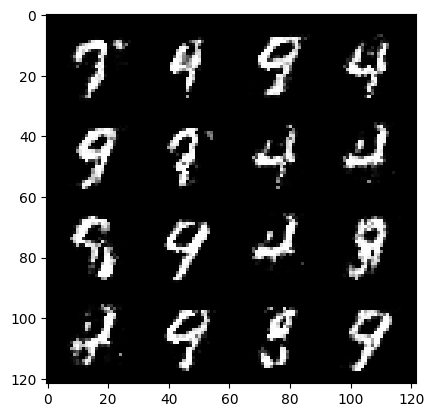

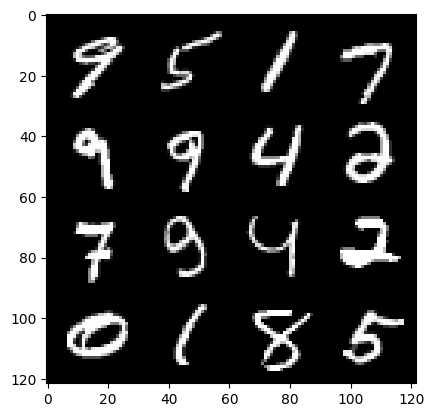

103: step 48600/ gen loss: 2.8089248307545986 / disc loss: 0.19329398492972058


  0%|          | 0/469 [00:00<?, ?it/s]

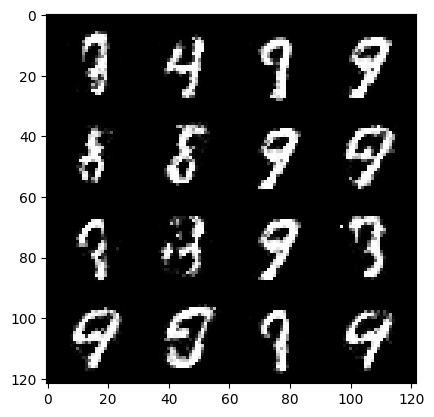

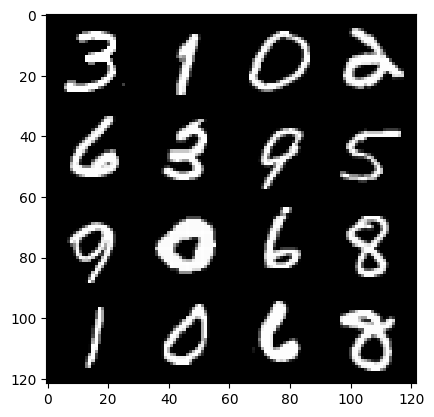

104: step 48900/ gen loss: 2.9433123620351145 / disc loss: 0.1862257190545401


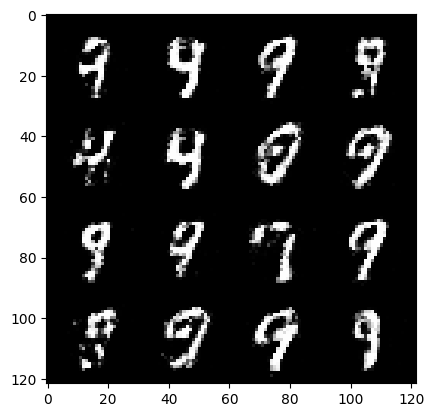

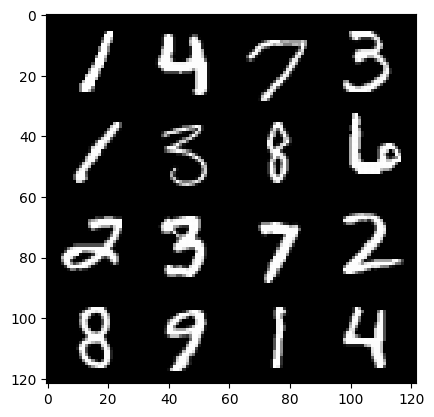

104: step 49200/ gen loss: 2.872178689638775 / disc loss: 0.19377293420334665


  0%|          | 0/469 [00:00<?, ?it/s]

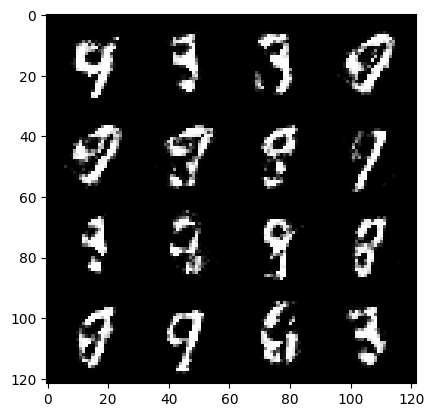

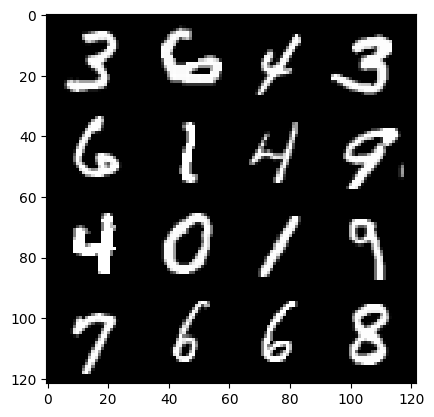

105: step 49500/ gen loss: 2.7330010207494104 / disc loss: 0.2117043991138537


  0%|          | 0/469 [00:00<?, ?it/s]

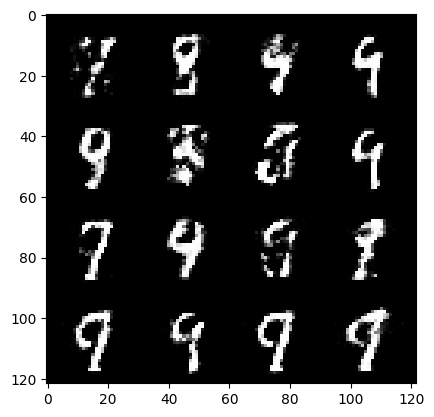

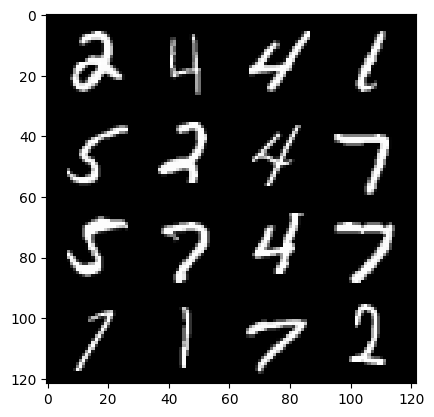

106: step 49800/ gen loss: 2.9535358540217094 / disc loss: 0.18056581186751533


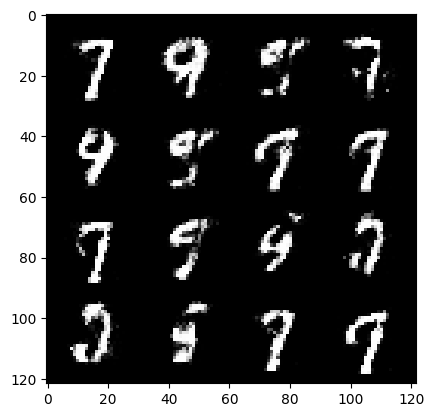

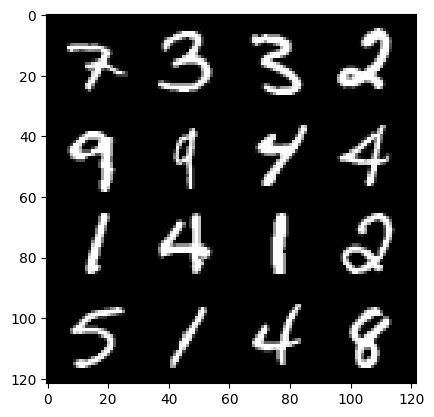

106: step 50100/ gen loss: 2.845164724191029 / disc loss: 0.20348313768704737


  0%|          | 0/469 [00:00<?, ?it/s]

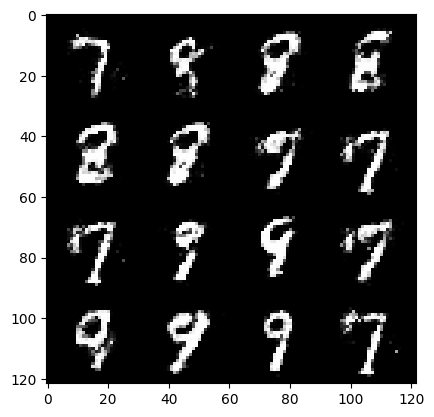

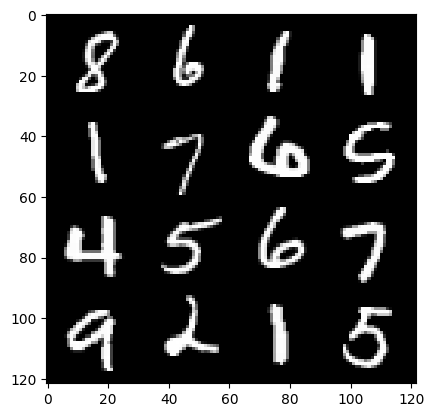

107: step 50400/ gen loss: 2.7337560375531527 / disc loss: 0.22202022448182102


  0%|          | 0/469 [00:00<?, ?it/s]

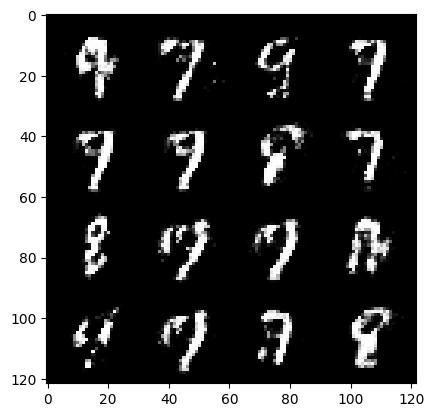

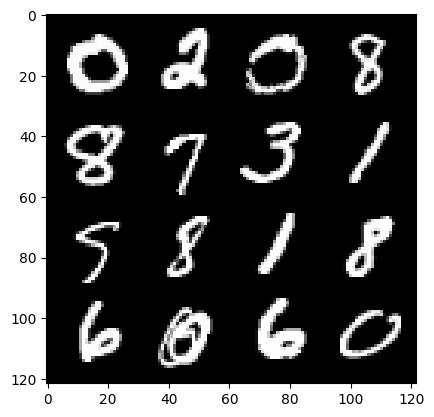

108: step 50700/ gen loss: 2.6954523674647 / disc loss: 0.21869906301299713


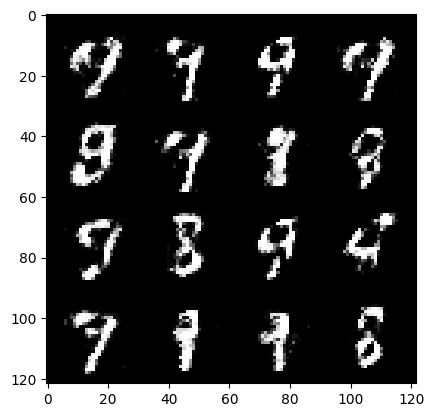

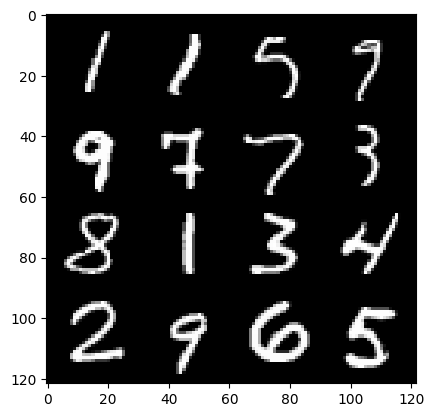

108: step 51000/ gen loss: 2.706577354272207 / disc loss: 0.21889298905928933


  0%|          | 0/469 [00:00<?, ?it/s]

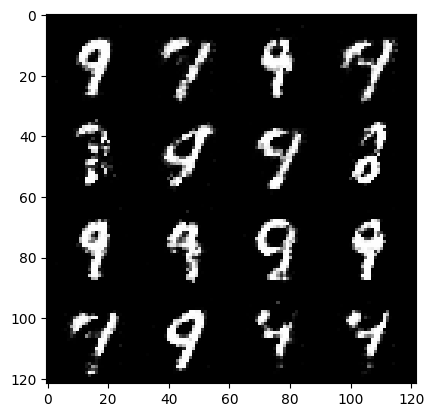

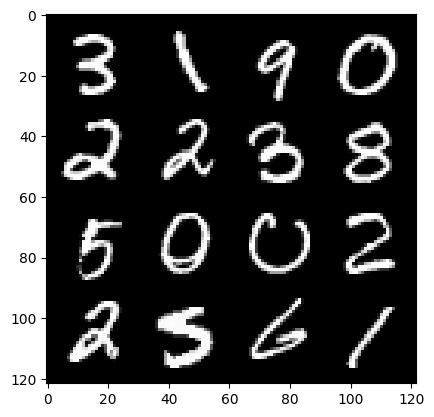

109: step 51300/ gen loss: 2.7604727109273273 / disc loss: 0.20564844680329172


  0%|          | 0/469 [00:00<?, ?it/s]

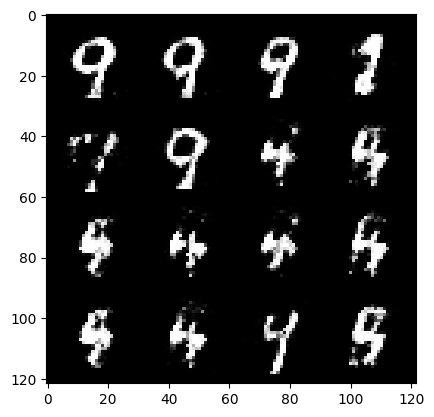

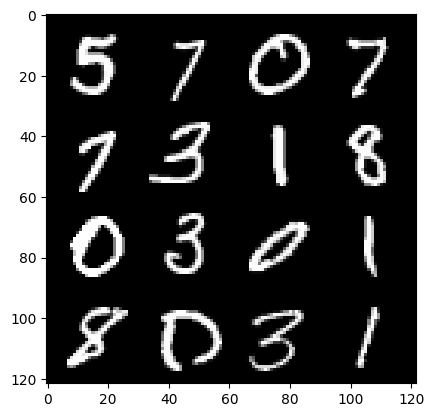

110: step 51600/ gen loss: 2.888176269531251 / disc loss: 0.1802581765751044


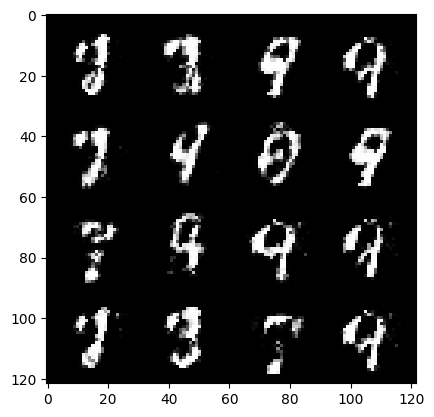

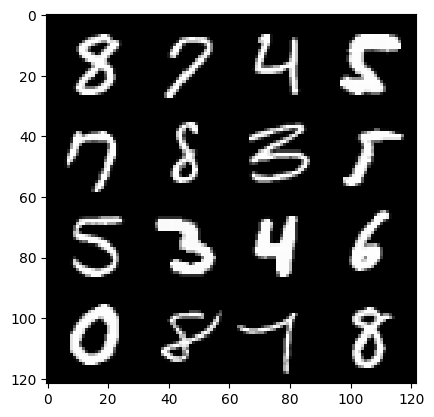

110: step 51900/ gen loss: 2.719194735685982 / disc loss: 0.2075608243544898


  0%|          | 0/469 [00:00<?, ?it/s]

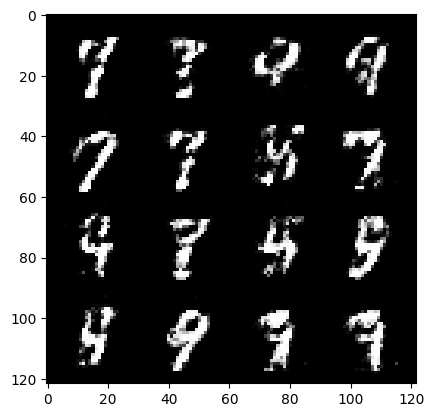

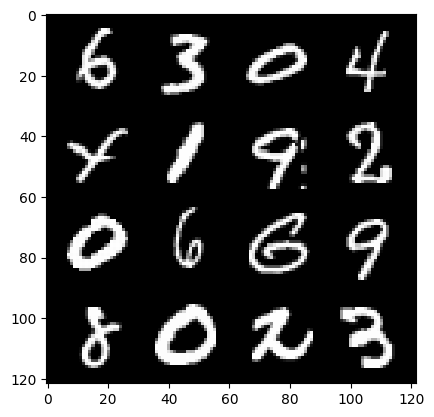

111: step 52200/ gen loss: 2.673231030305227 / disc loss: 0.2015530350059272


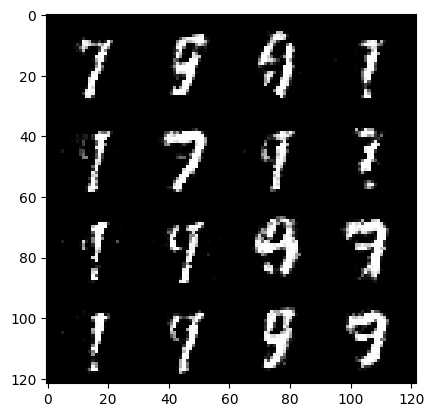

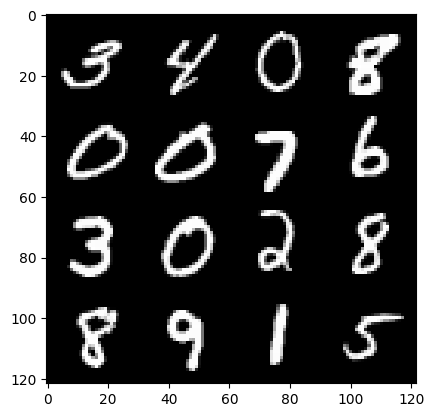

111: step 52500/ gen loss: 2.5841078543663047 / disc loss: 0.22053502738475803


  0%|          | 0/469 [00:00<?, ?it/s]

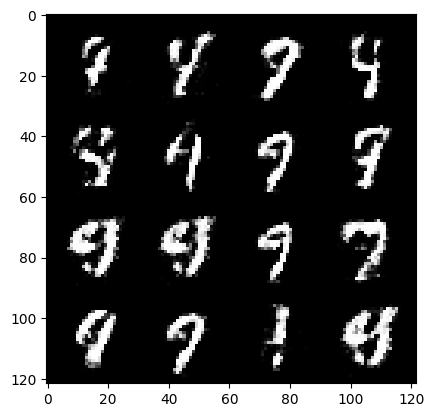

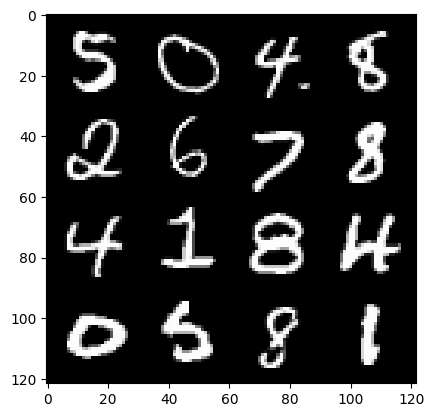

112: step 52800/ gen loss: 2.6456298597653714 / disc loss: 0.2168918603658675


  0%|          | 0/469 [00:00<?, ?it/s]

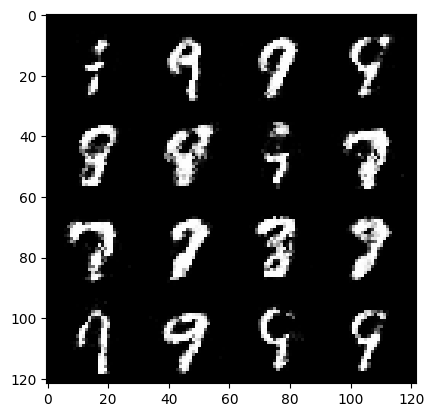

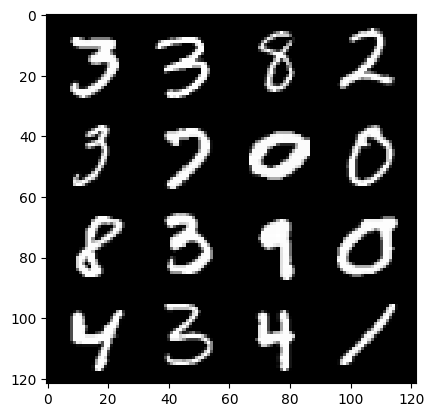

113: step 53100/ gen loss: 2.6745106744766236 / disc loss: 0.20773250425855314


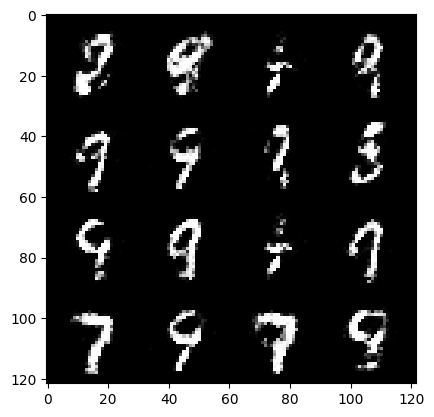

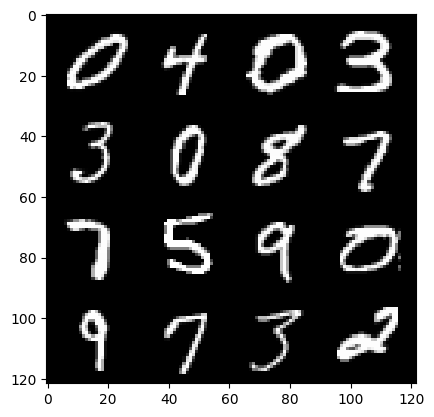

113: step 53400/ gen loss: 2.534147539138793 / disc loss: 0.22423000790178788


  0%|          | 0/469 [00:00<?, ?it/s]

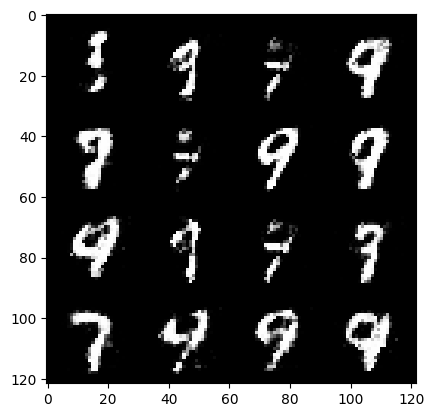

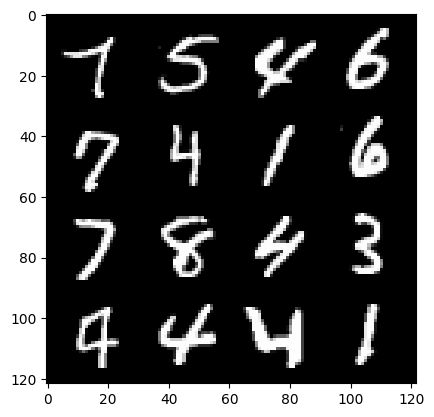

114: step 53700/ gen loss: 2.652610569000245 / disc loss: 0.21109071018795175


  0%|          | 0/469 [00:00<?, ?it/s]

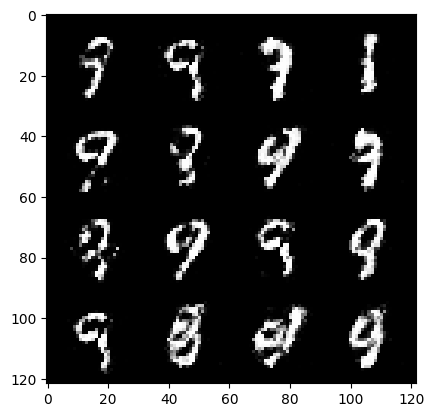

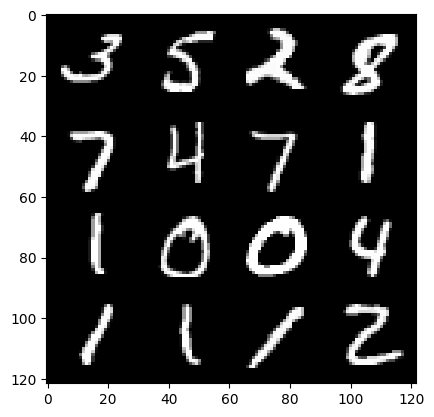

115: step 54000/ gen loss: 2.6789377637704215 / disc loss: 0.2050000473360219


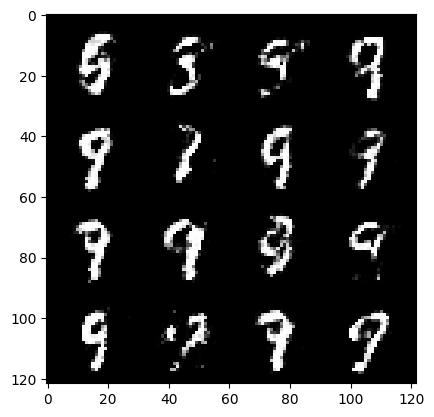

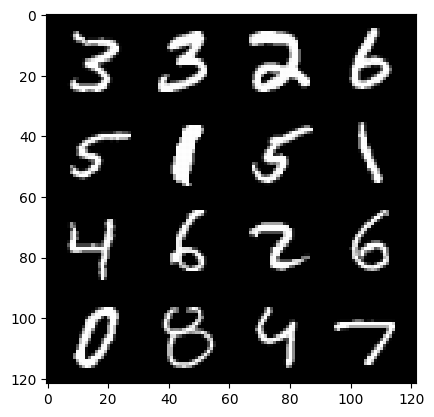

115: step 54300/ gen loss: 2.831000589529673 / disc loss: 0.17805363255242507


  0%|          | 0/469 [00:00<?, ?it/s]

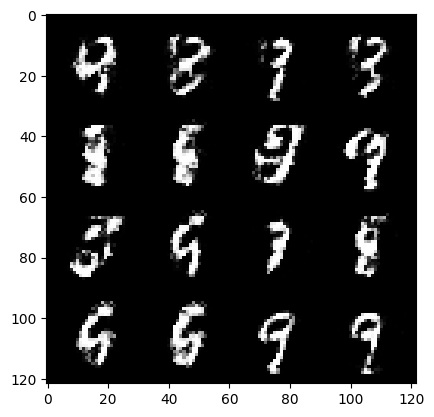

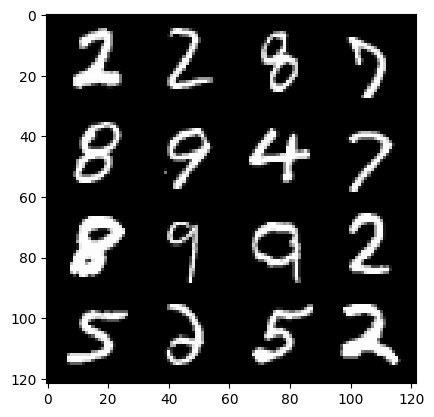

116: step 54600/ gen loss: 2.776436553796133 / disc loss: 0.20361836488048224


  0%|          | 0/469 [00:00<?, ?it/s]

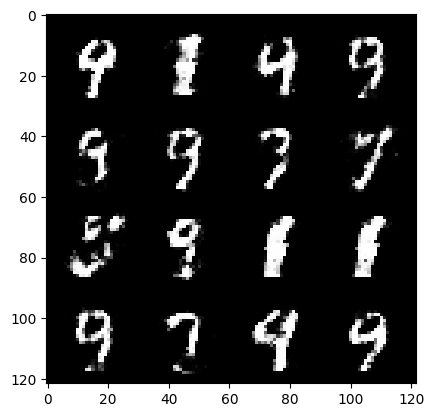

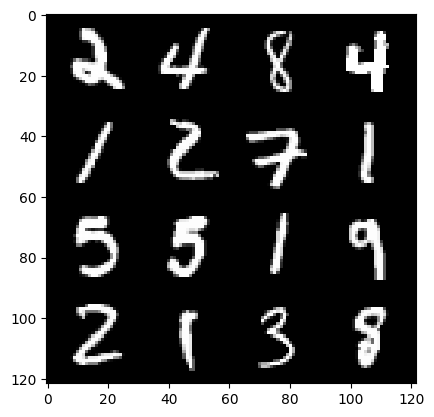

117: step 54900/ gen loss: 2.6594737601280225 / disc loss: 0.22435372029741607


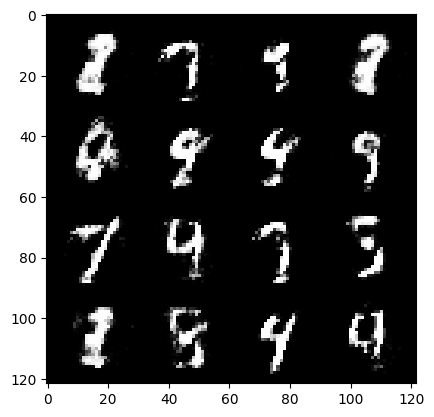

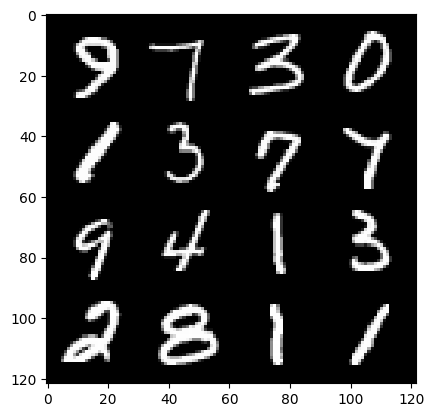

117: step 55200/ gen loss: 2.5345362218221035 / disc loss: 0.24983217209577543


  0%|          | 0/469 [00:00<?, ?it/s]

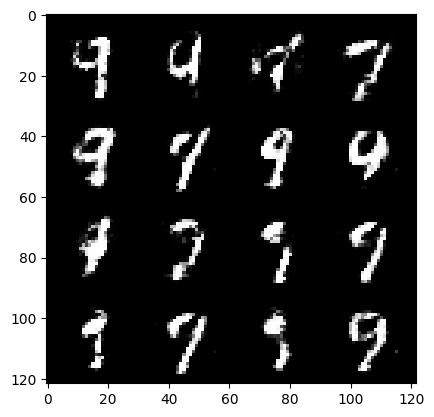

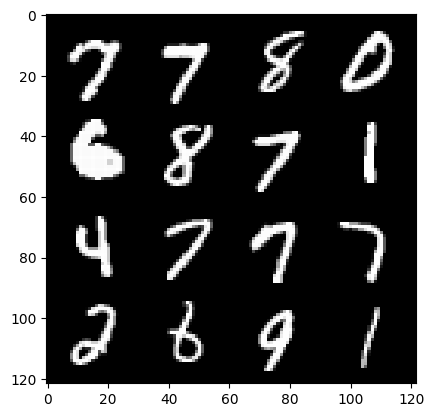

118: step 55500/ gen loss: 2.657498999436696 / disc loss: 0.20535088929037232


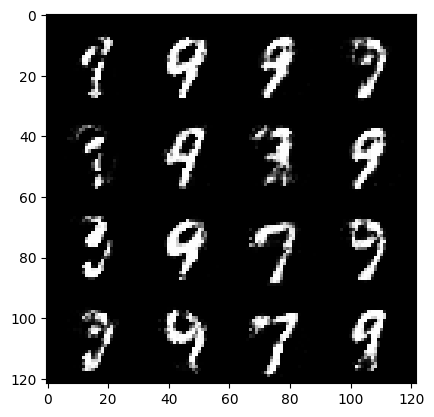

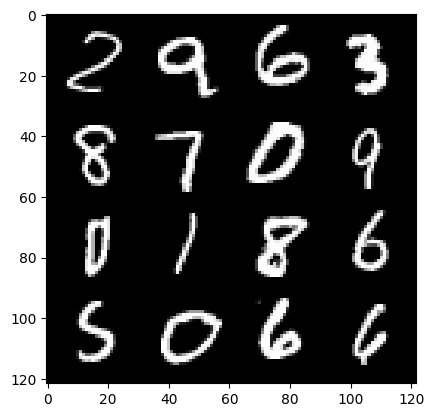

118: step 55800/ gen loss: 2.6161020807425177 / disc loss: 0.21229663719733563


  0%|          | 0/469 [00:00<?, ?it/s]

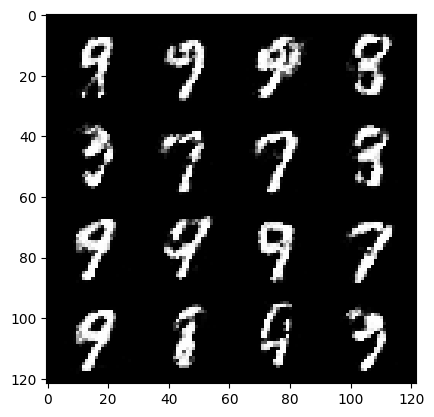

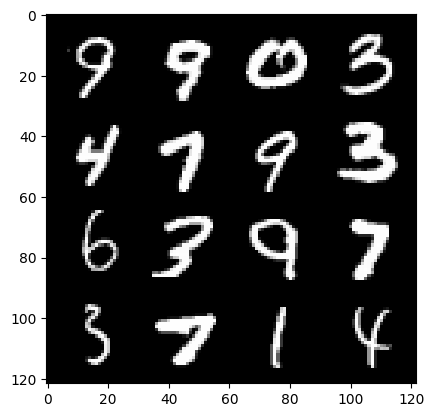

119: step 56100/ gen loss: 2.5661253825823445 / disc loss: 0.22648443629344298


  0%|          | 0/469 [00:00<?, ?it/s]

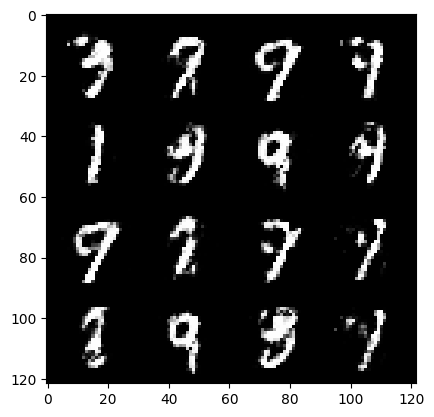

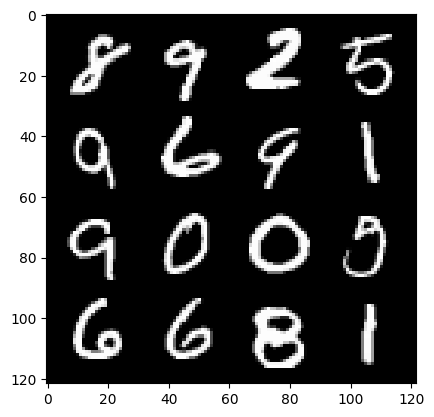

120: step 56400/ gen loss: 2.457002734343211 / disc loss: 0.24618624274929377


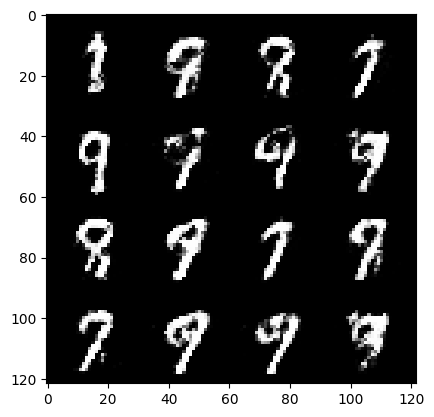

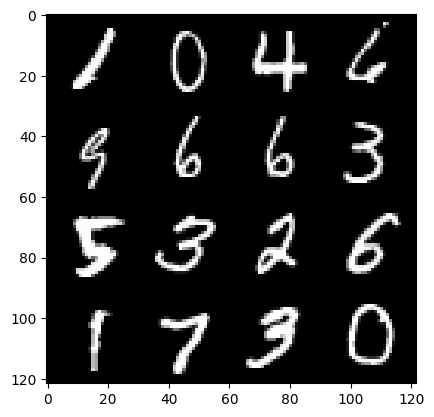

120: step 56700/ gen loss: 2.5651720873514807 / disc loss: 0.22378176108002662


  0%|          | 0/469 [00:00<?, ?it/s]

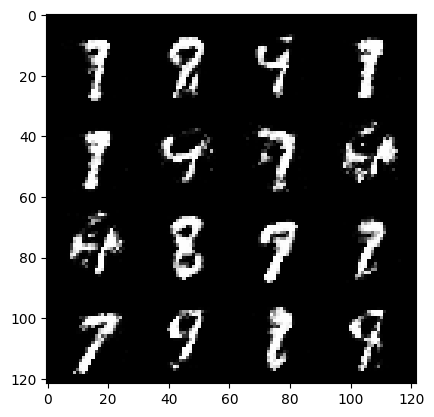

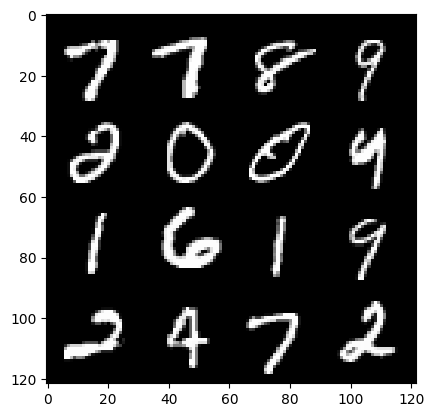

121: step 57000/ gen loss: 2.6000004076957692 / disc loss: 0.21250893212854852


  0%|          | 0/469 [00:00<?, ?it/s]

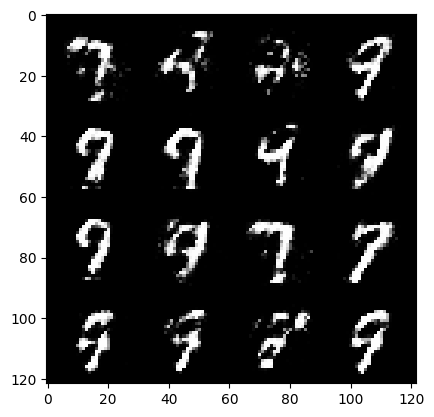

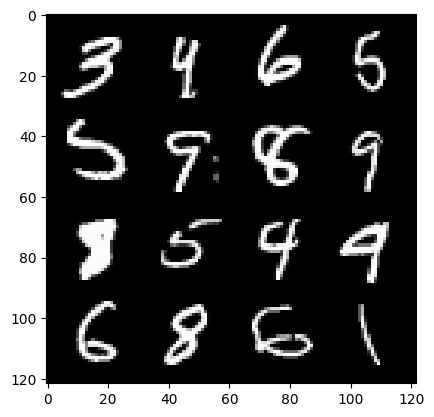

122: step 57300/ gen loss: 2.620382134914398 / disc loss: 0.2345504034558932


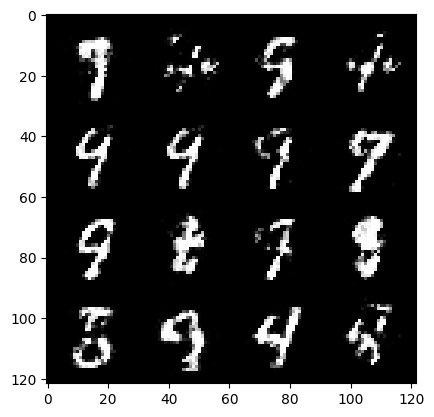

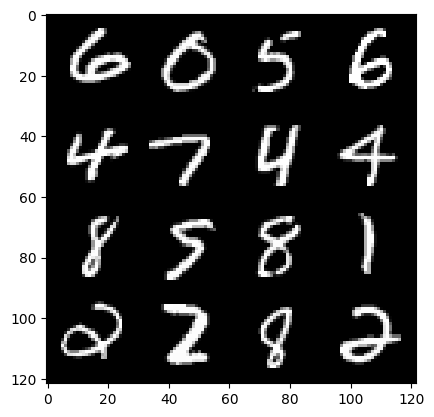

122: step 57600/ gen loss: 2.4595399570465086 / disc loss: 0.2480951544145743


  0%|          | 0/469 [00:00<?, ?it/s]

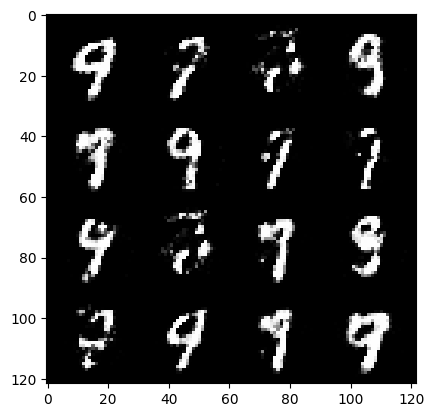

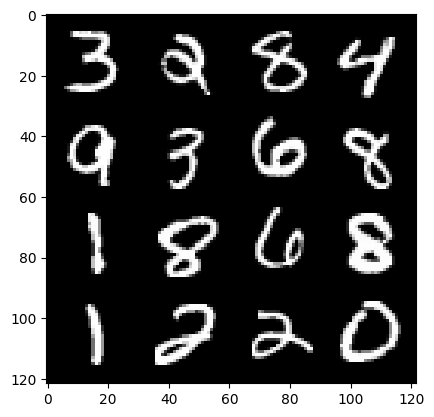

123: step 57900/ gen loss: 2.574046883583067 / disc loss: 0.21532876541217175


  0%|          | 0/469 [00:00<?, ?it/s]

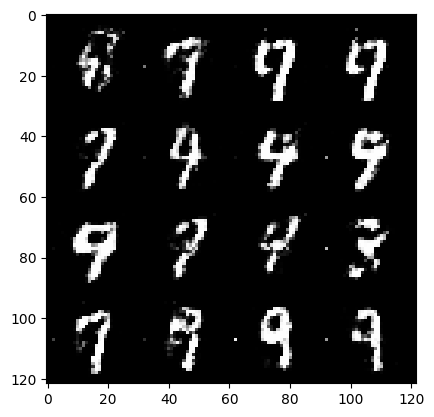

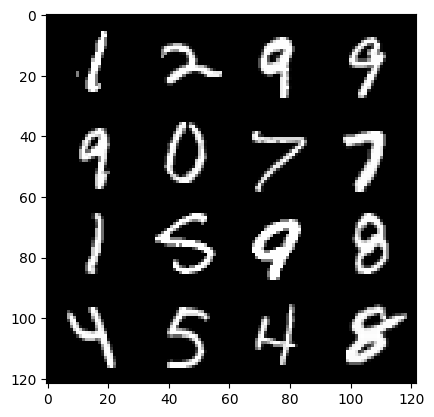

124: step 58200/ gen loss: 2.6635824720064787 / disc loss: 0.2130403530100982


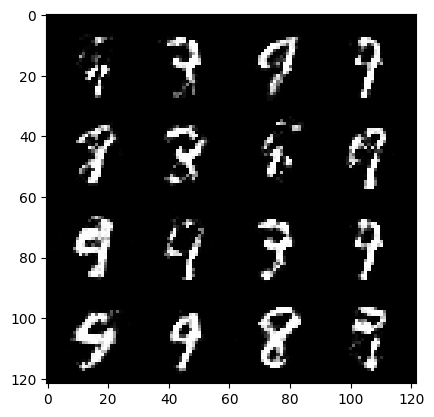

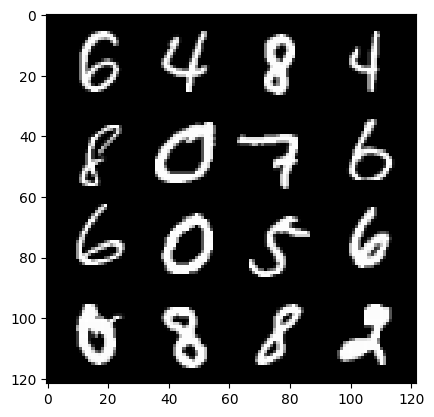

124: step 58500/ gen loss: 2.6513665564854954 / disc loss: 0.20751814357936382


  0%|          | 0/469 [00:00<?, ?it/s]

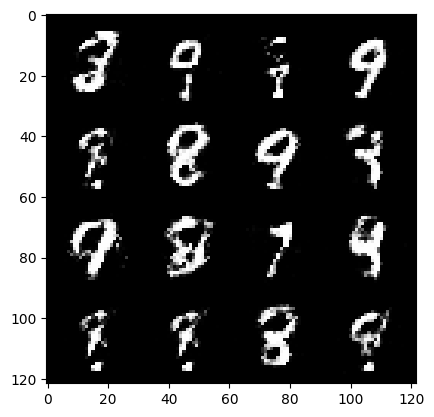

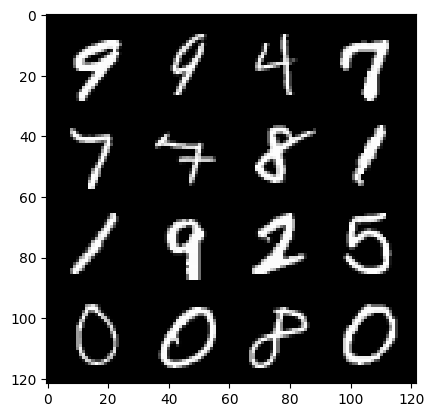

125: step 58800/ gen loss: 2.6227429815133436 / disc loss: 0.22206759805480636


  0%|          | 0/469 [00:00<?, ?it/s]

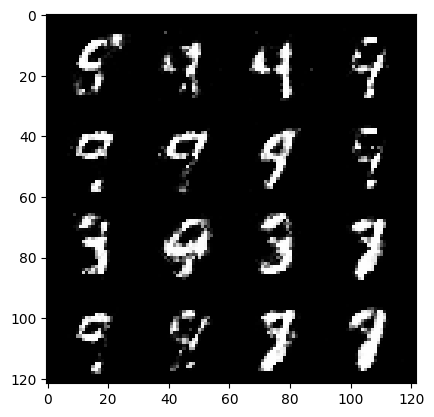

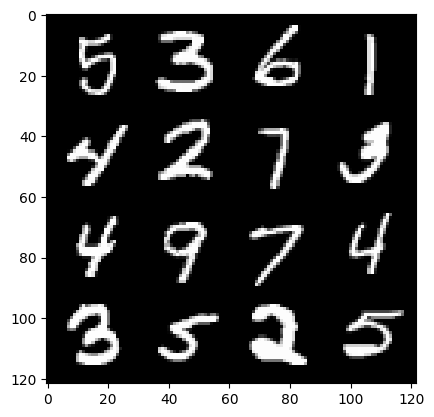

126: step 59100/ gen loss: 2.6224250217278793 / disc loss: 0.2157281425843637


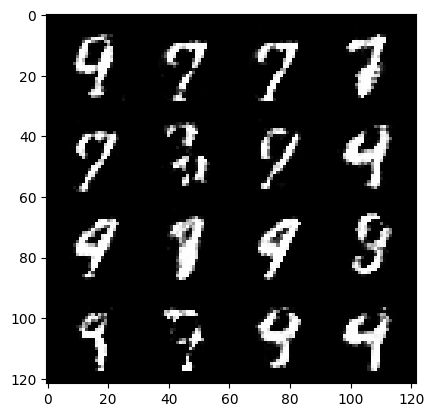

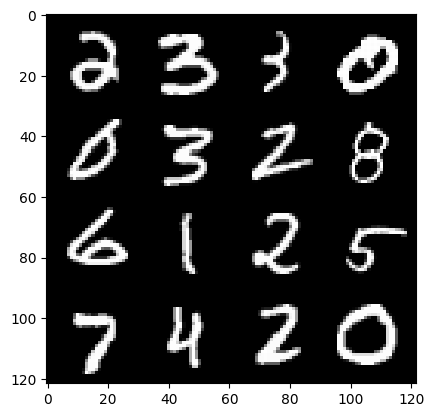

126: step 59400/ gen loss: 2.5340675187110913 / disc loss: 0.2270227384070555


  0%|          | 0/469 [00:00<?, ?it/s]

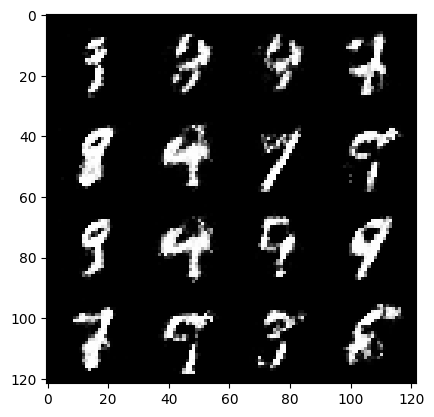

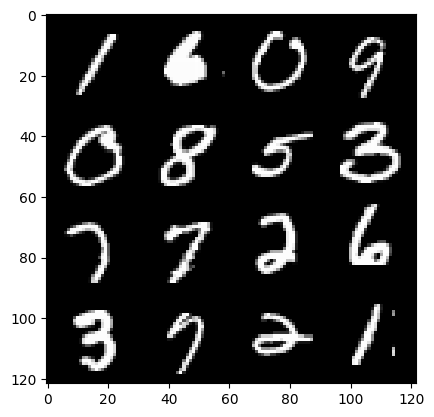

127: step 59700/ gen loss: 2.486171114444731 / disc loss: 0.240300388832887


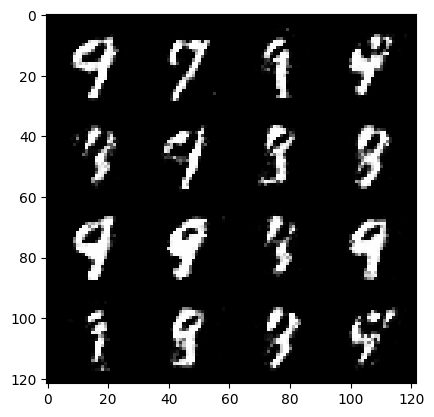

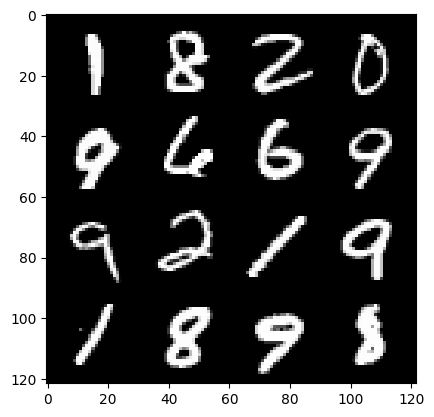

127: step 60000/ gen loss: 2.5439676117897023 / disc loss: 0.23038256953159958


  0%|          | 0/469 [00:00<?, ?it/s]

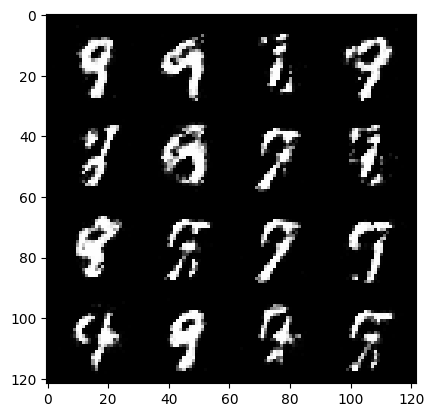

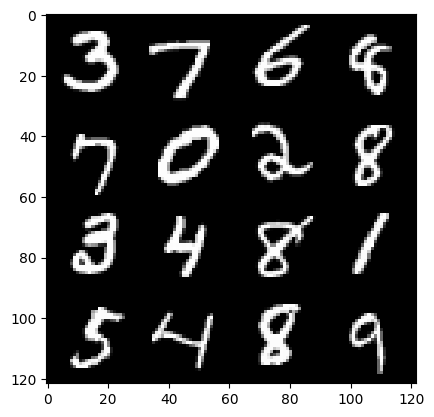

128: step 60300/ gen loss: 2.537527571519214 / disc loss: 0.22492551237344743


  0%|          | 0/469 [00:00<?, ?it/s]

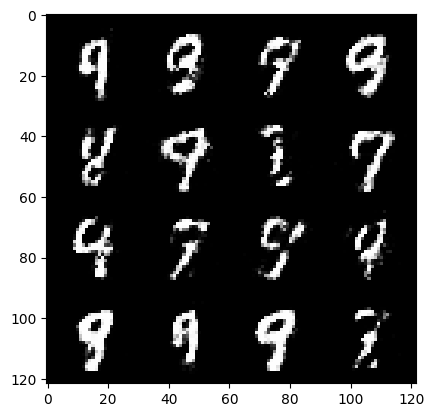

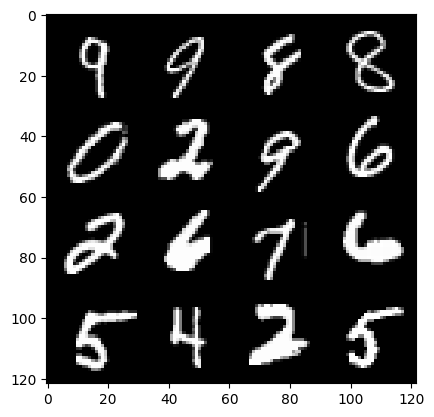

129: step 60600/ gen loss: 2.5584921105702714 / disc loss: 0.22639548619588237


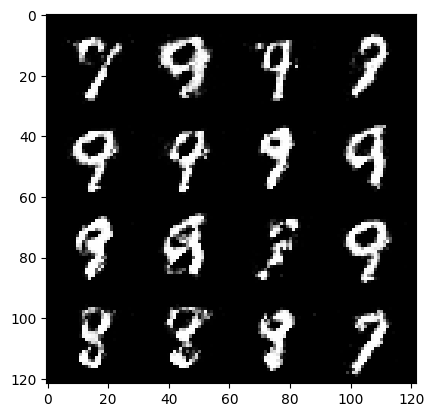

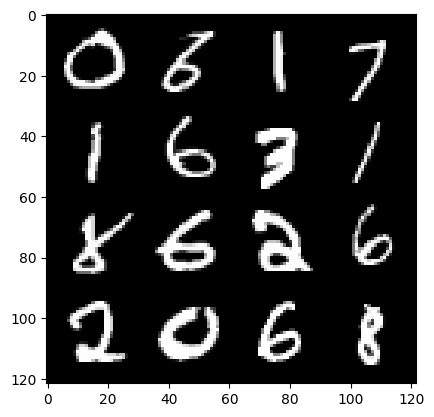

129: step 60900/ gen loss: 2.429932781060539 / disc loss: 0.24877704776823517


  0%|          | 0/469 [00:00<?, ?it/s]

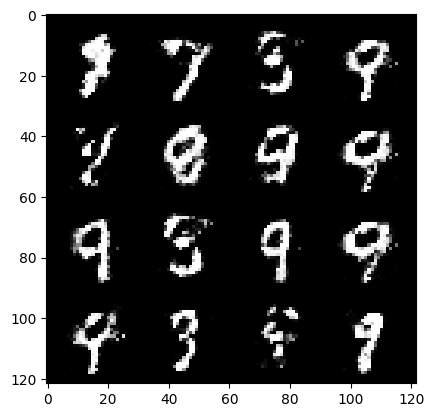

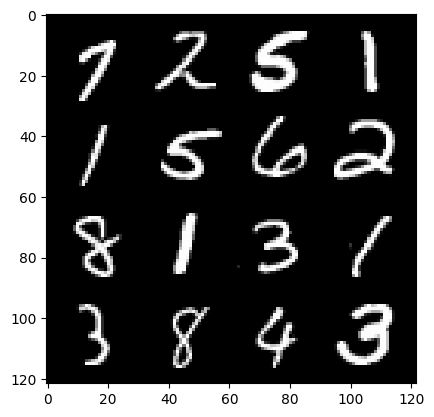

130: step 61200/ gen loss: 2.425873622894287 / disc loss: 0.24523434405525518


  0%|          | 0/469 [00:00<?, ?it/s]

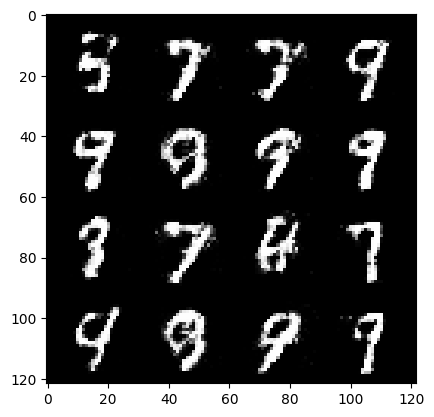

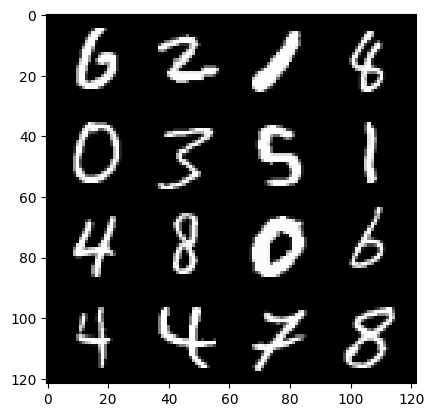

131: step 61500/ gen loss: 2.4181349615256 / disc loss: 0.24684606874982531


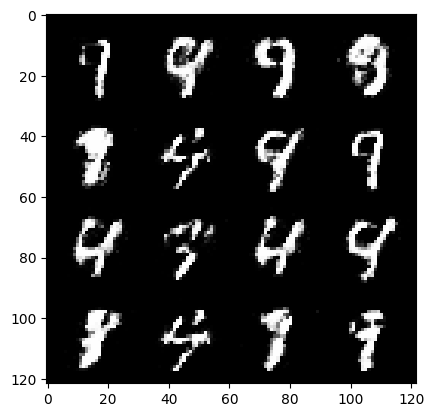

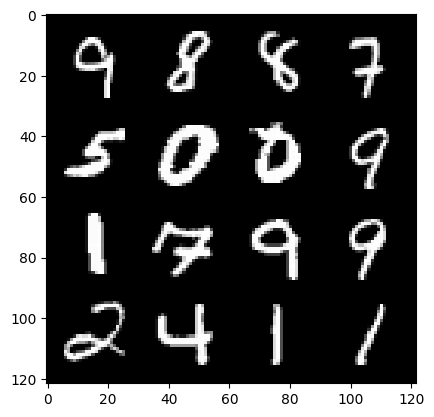

131: step 61800/ gen loss: 2.365555386145911 / disc loss: 0.24470914547642061


  0%|          | 0/469 [00:00<?, ?it/s]

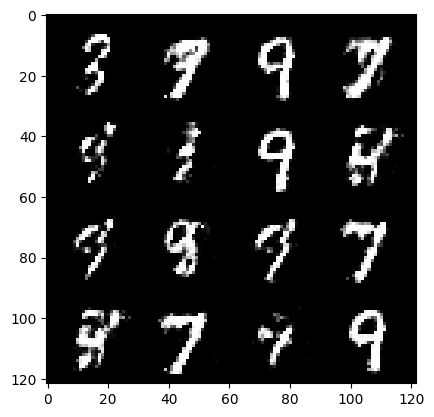

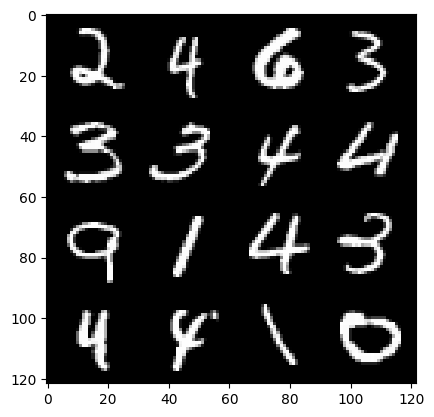

132: step 62100/ gen loss: 2.3567966874440516 / disc loss: 0.24168952956795692


  0%|          | 0/469 [00:00<?, ?it/s]

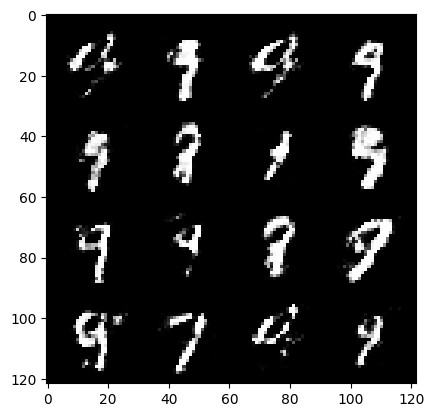

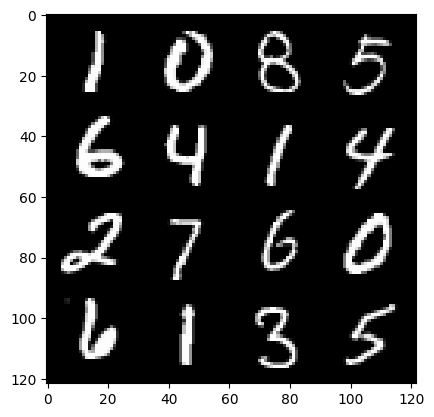

133: step 62400/ gen loss: 2.3580406447251634 / disc loss: 0.24755099053184187


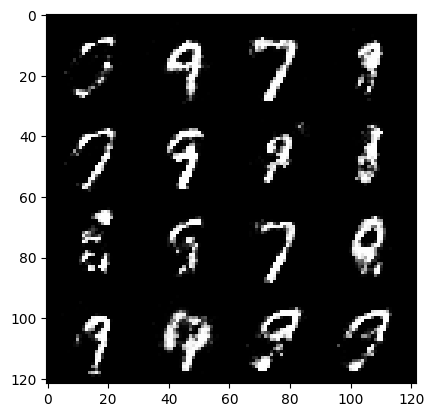

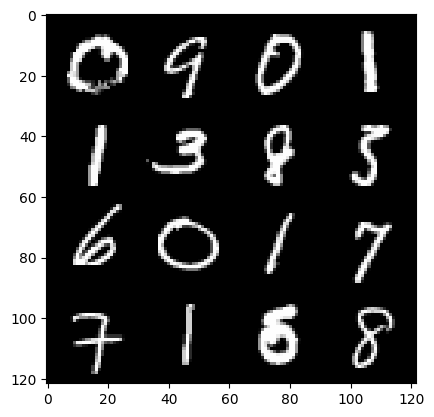

133: step 62700/ gen loss: 2.4085033154487623 / disc loss: 0.24678693786263453


  0%|          | 0/469 [00:00<?, ?it/s]

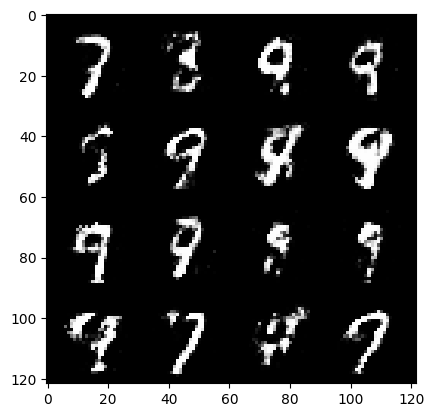

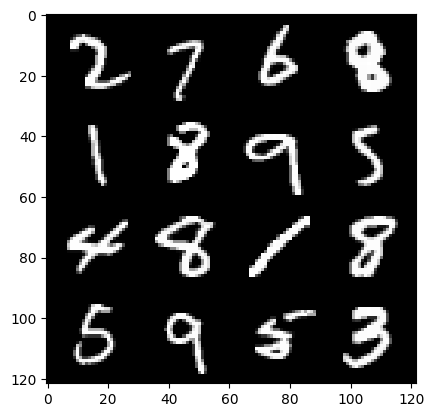

134: step 63000/ gen loss: 2.3526803044478113 / disc loss: 0.25144829536477725


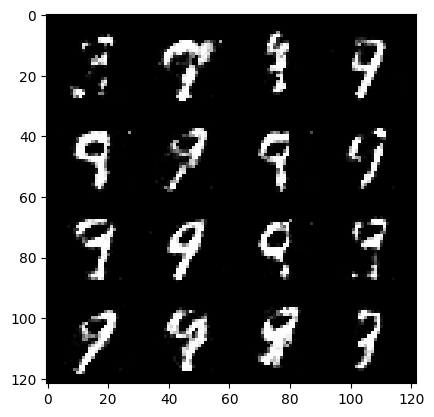

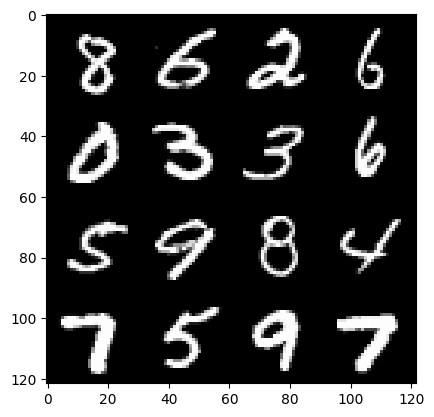

134: step 63300/ gen loss: 2.3594805534680687 / disc loss: 0.2503980635603268


  0%|          | 0/469 [00:00<?, ?it/s]

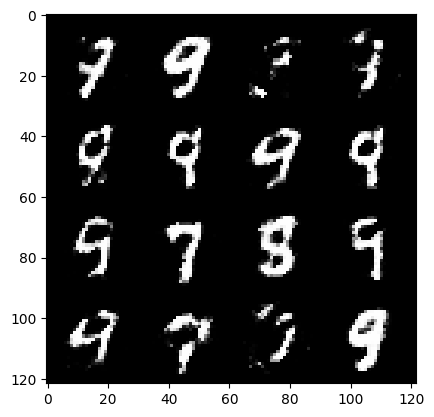

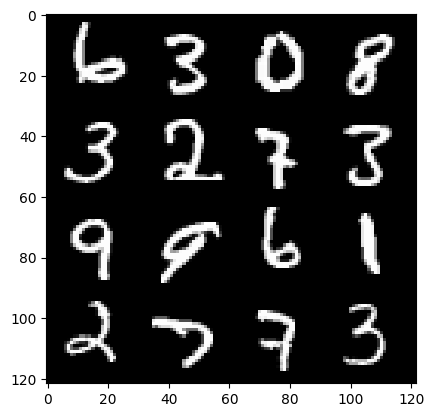

135: step 63600/ gen loss: 2.3579430747032153 / disc loss: 0.24729287172357242


  0%|          | 0/469 [00:00<?, ?it/s]

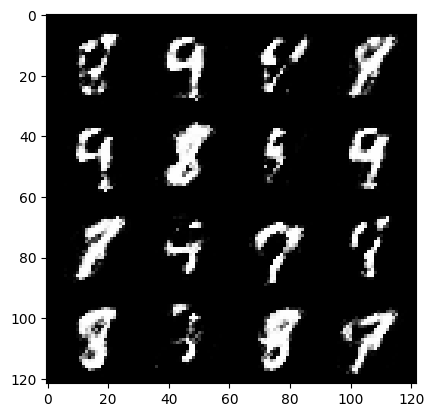

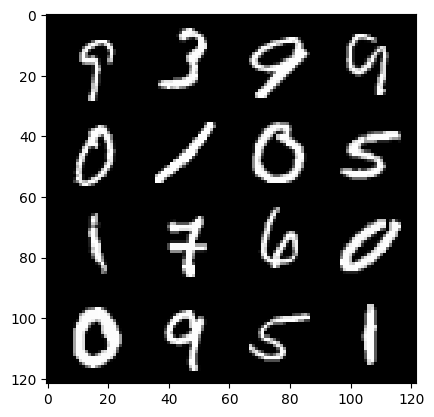

136: step 63900/ gen loss: 2.298619728485746 / disc loss: 0.25664232025543854


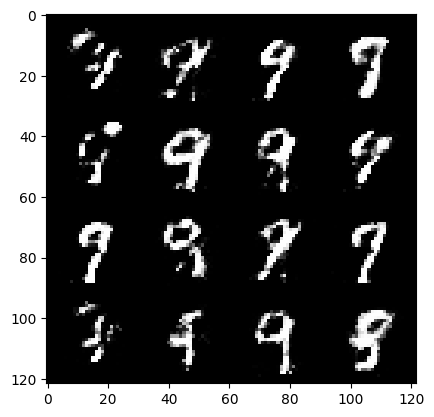

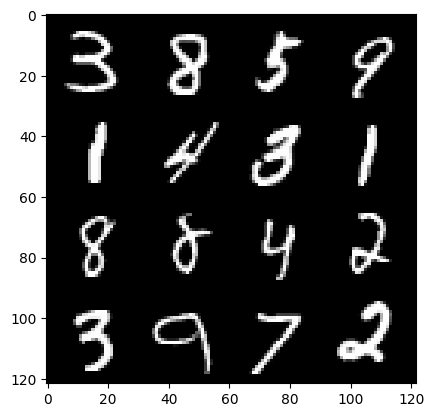

136: step 64200/ gen loss: 2.294535622199378 / disc loss: 0.25471037834882737


  0%|          | 0/469 [00:00<?, ?it/s]

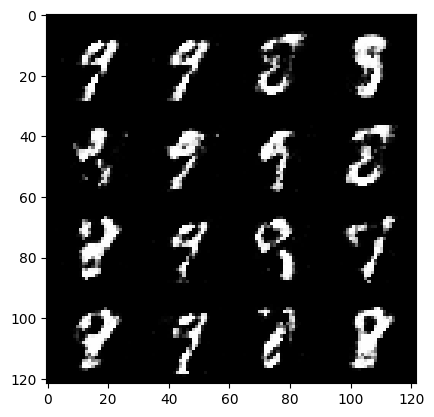

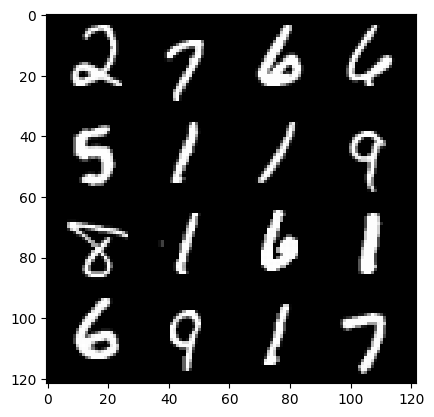

137: step 64500/ gen loss: 2.3820415143171947 / disc loss: 0.2312530208130677


  0%|          | 0/469 [00:00<?, ?it/s]

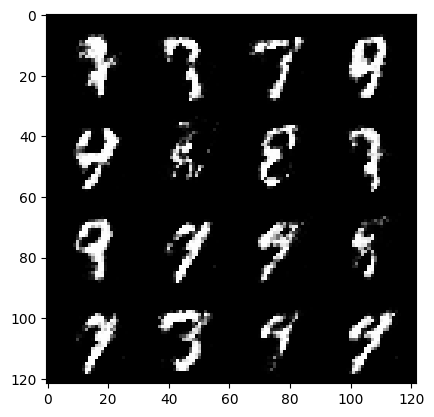

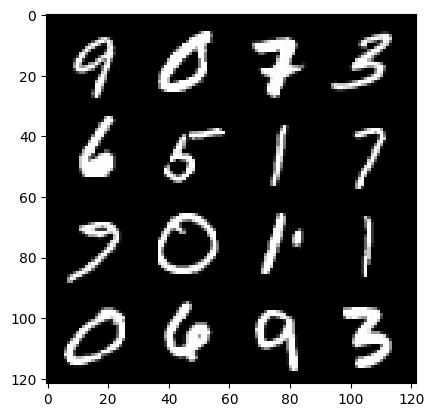

138: step 64800/ gen loss: 2.3711613909403475 / disc loss: 0.2335117152829968


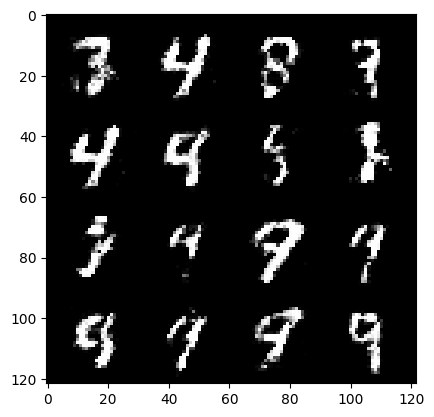

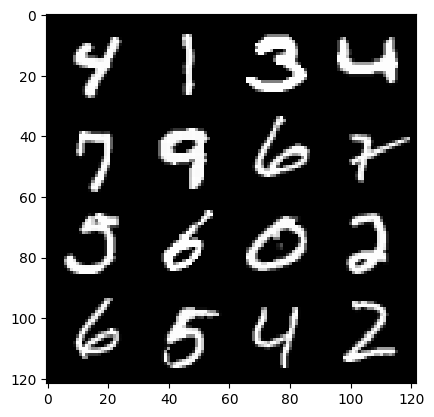

138: step 65100/ gen loss: 2.545737926959991 / disc loss: 0.21521134972572312


  0%|          | 0/469 [00:00<?, ?it/s]

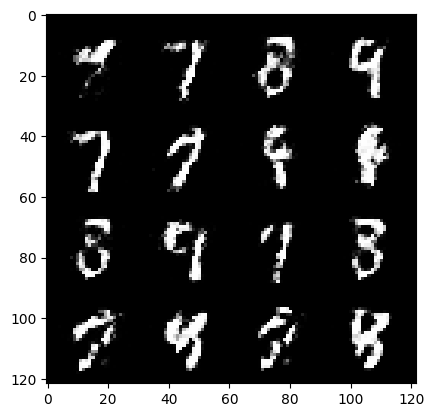

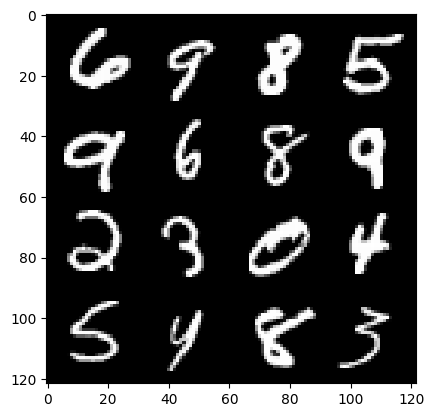

139: step 65400/ gen loss: 2.34683484474818 / disc loss: 0.2439186560610929


  0%|          | 0/469 [00:00<?, ?it/s]

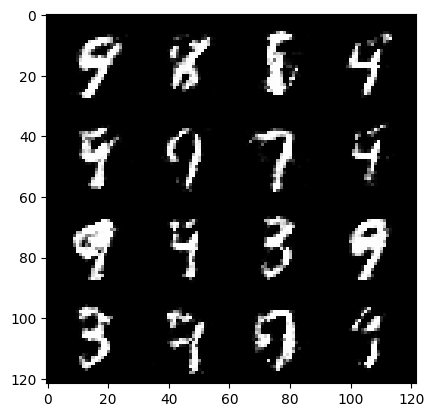

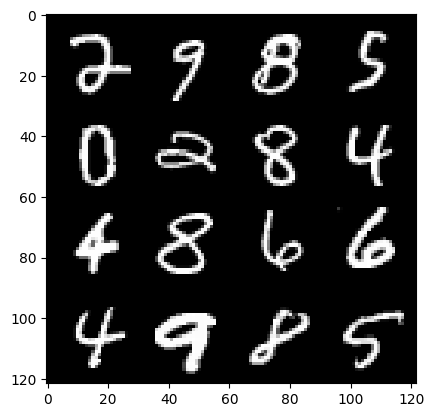

140: step 65700/ gen loss: 2.332775337298713 / disc loss: 0.2461760288476945


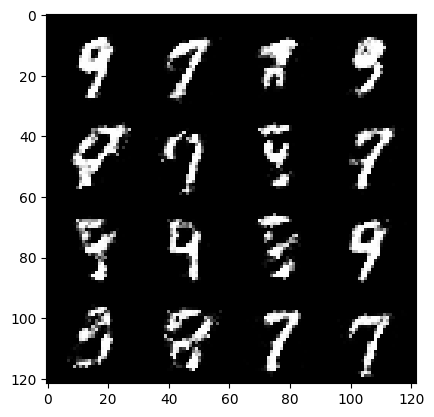

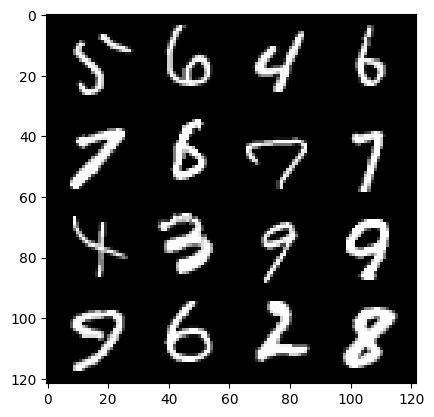

140: step 66000/ gen loss: 2.4296110320091238 / disc loss: 0.24707302903135625


  0%|          | 0/469 [00:00<?, ?it/s]

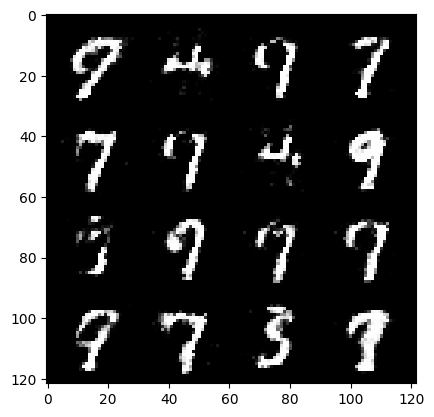

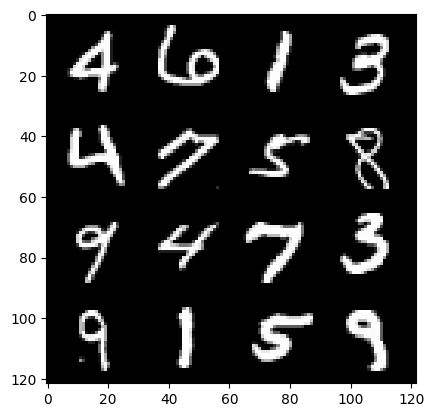

141: step 66300/ gen loss: 2.356854627927144 / disc loss: 0.24586854442954081


  0%|          | 0/469 [00:00<?, ?it/s]

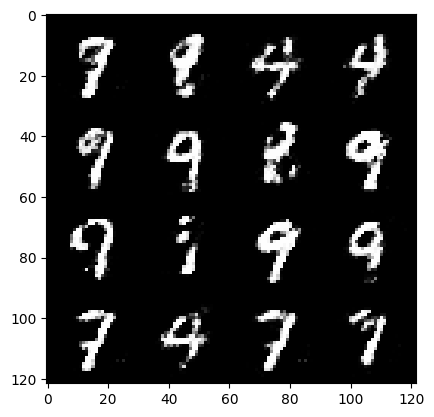

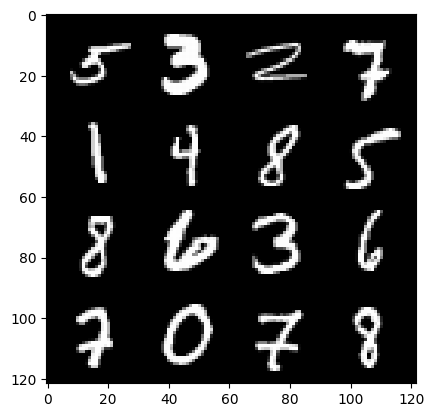

142: step 66600/ gen loss: 2.355487860043844 / disc loss: 0.23528513163328177


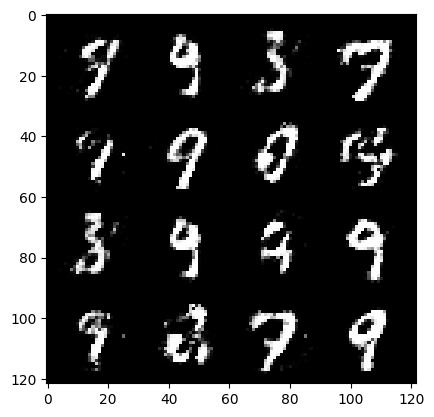

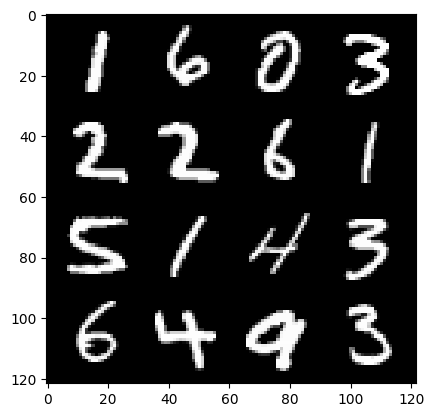

142: step 66900/ gen loss: 2.367755072116851 / disc loss: 0.2457047774891057


  0%|          | 0/469 [00:00<?, ?it/s]

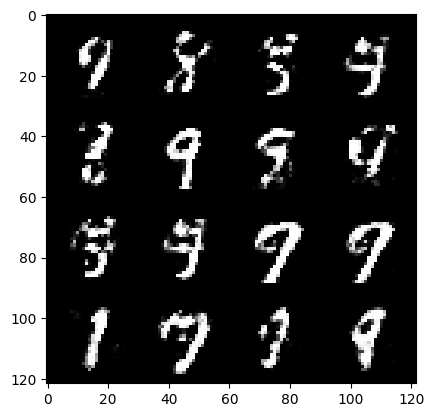

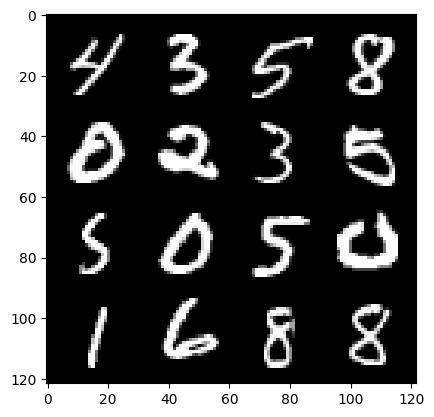

143: step 67200/ gen loss: 2.2781829730669676 / disc loss: 0.263465771029393


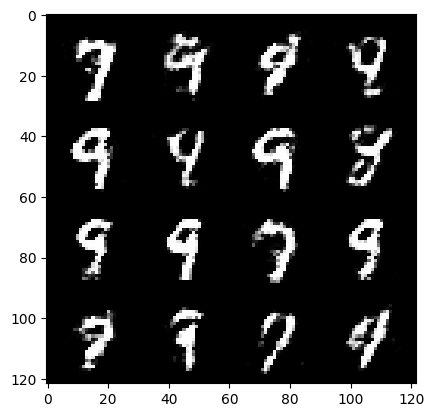

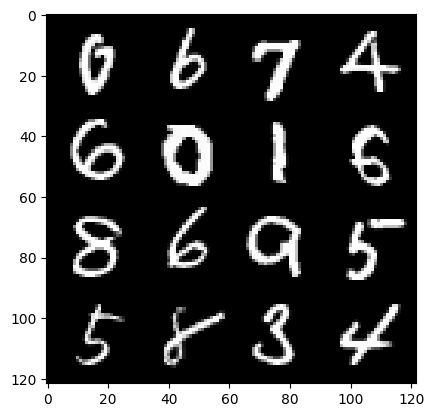

143: step 67500/ gen loss: 2.4025465567906705 / disc loss: 0.23895499169826517


  0%|          | 0/469 [00:00<?, ?it/s]

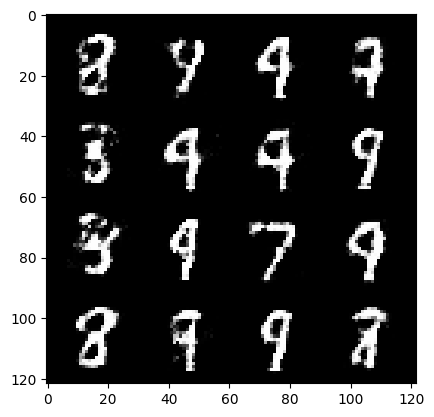

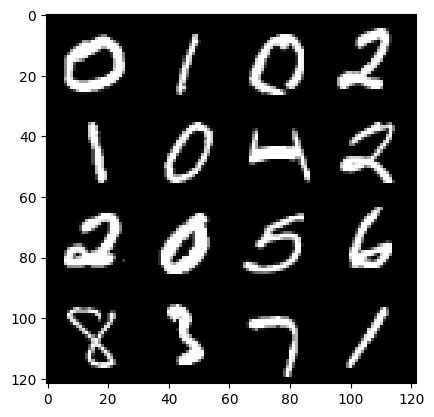

144: step 67800/ gen loss: 2.1894039225578306 / disc loss: 0.27866964608430905


  0%|          | 0/469 [00:00<?, ?it/s]

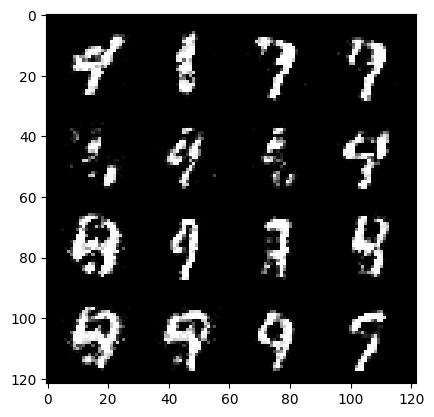

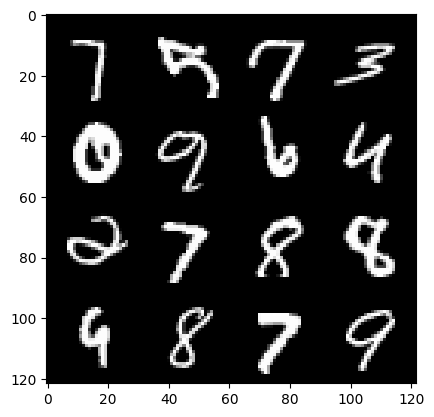

145: step 68100/ gen loss: 2.2036580288410197 / disc loss: 0.26640080139040956


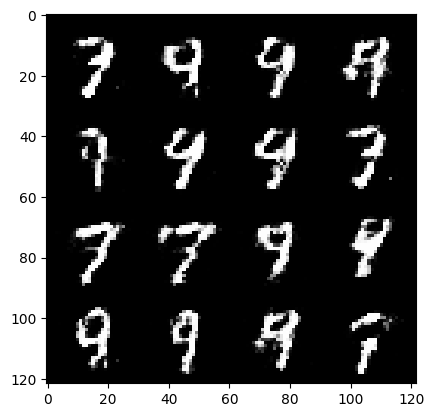

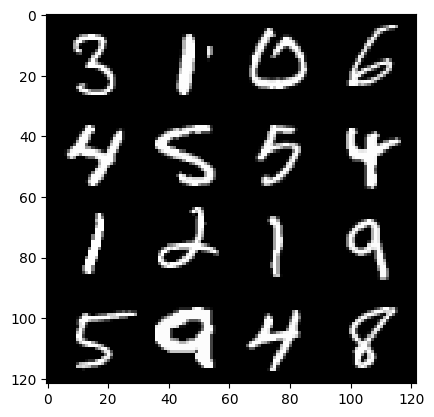

145: step 68400/ gen loss: 2.236086398760477 / disc loss: 0.2612258987625441


  0%|          | 0/469 [00:00<?, ?it/s]

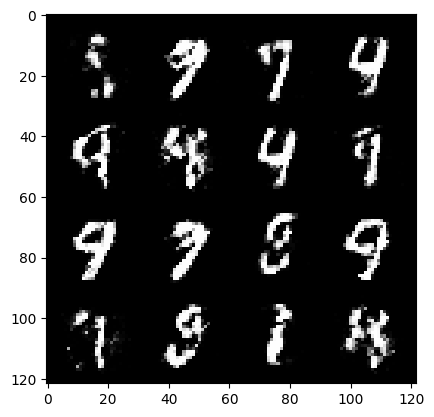

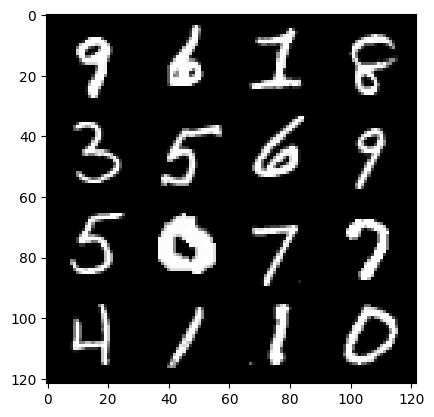

146: step 68700/ gen loss: 2.26343833843867 / disc loss: 0.2619120446840922


  0%|          | 0/469 [00:00<?, ?it/s]

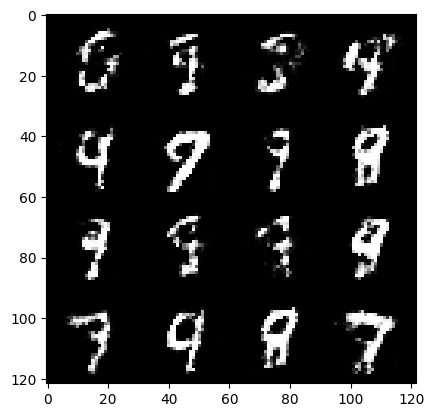

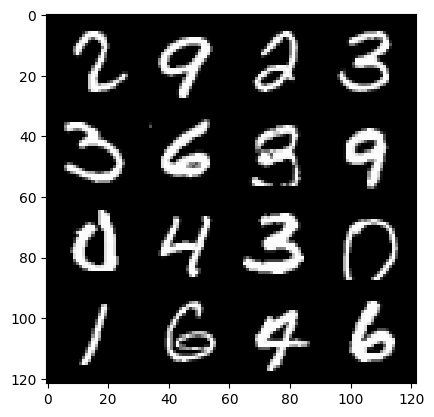

147: step 69000/ gen loss: 2.1897426215807587 / disc loss: 0.2643759863078594


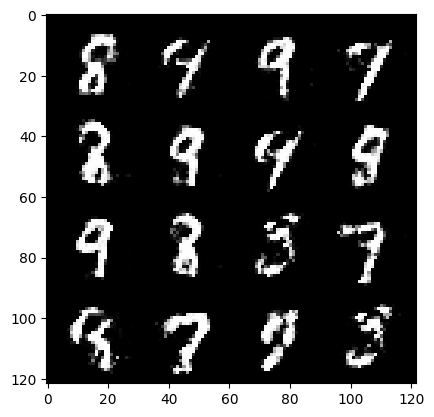

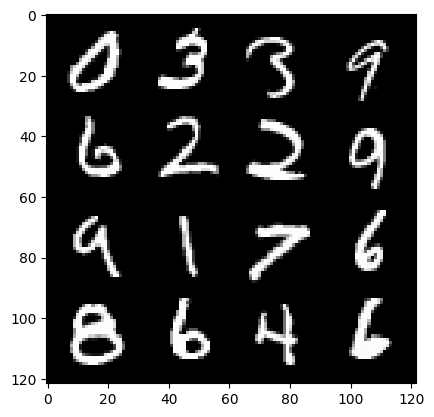

147: step 69300/ gen loss: 2.229872035185496 / disc loss: 0.256118736018737


  0%|          | 0/469 [00:00<?, ?it/s]

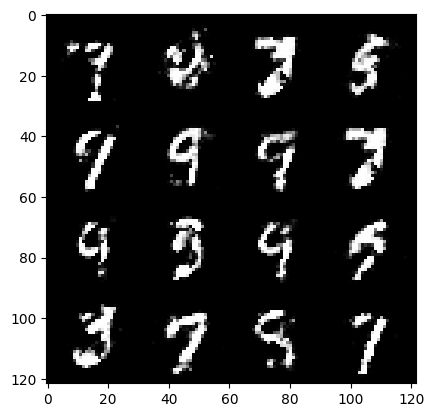

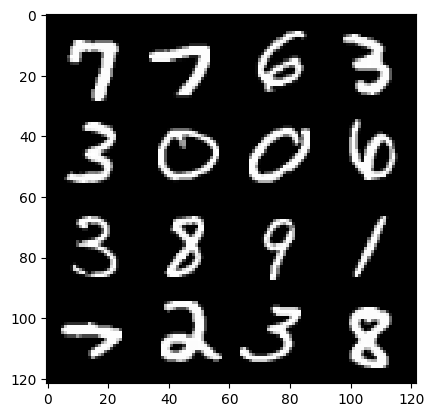

148: step 69600/ gen loss: 2.17969241420428 / disc loss: 0.268316008845965


  0%|          | 0/469 [00:00<?, ?it/s]

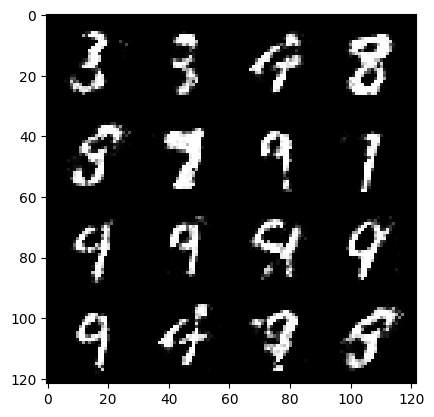

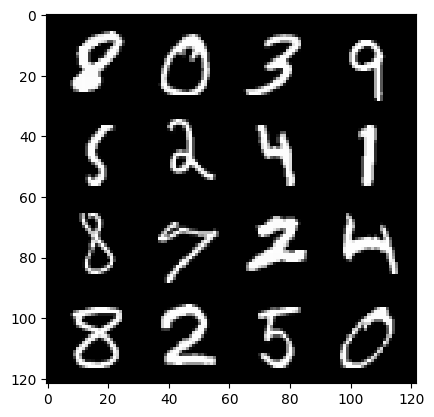

149: step 69900/ gen loss: 2.131363864739736 / disc loss: 0.28067479943235735


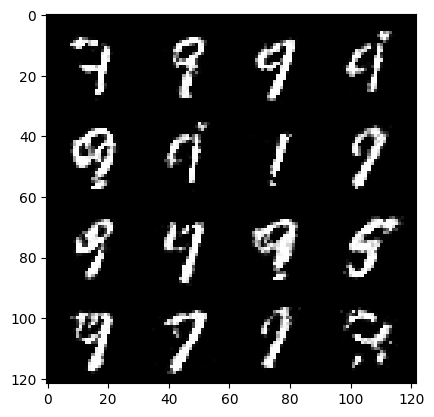

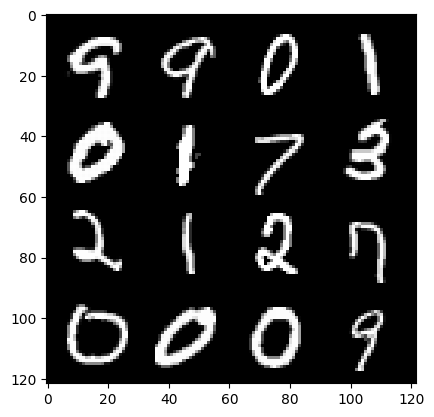

149: step 70200/ gen loss: 2.127089735666912 / disc loss: 0.27847187822063796


  0%|          | 0/469 [00:00<?, ?it/s]

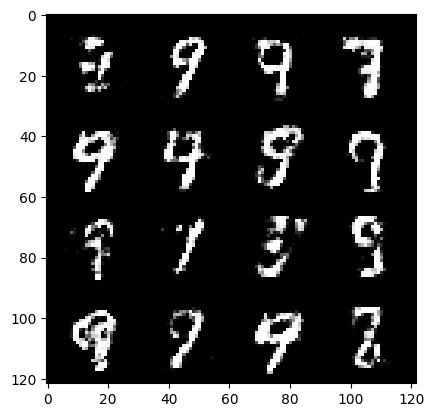

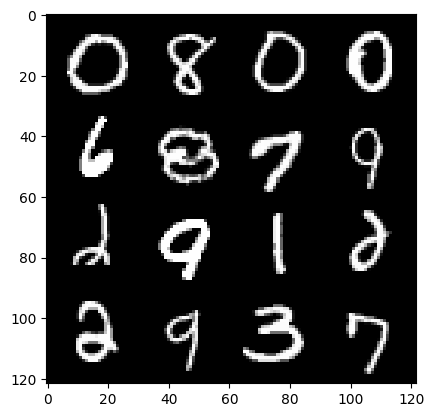

150: step 70500/ gen loss: 2.1565236838658652 / disc loss: 0.2748932268222173


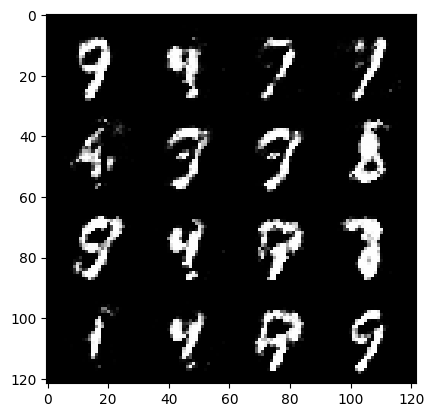

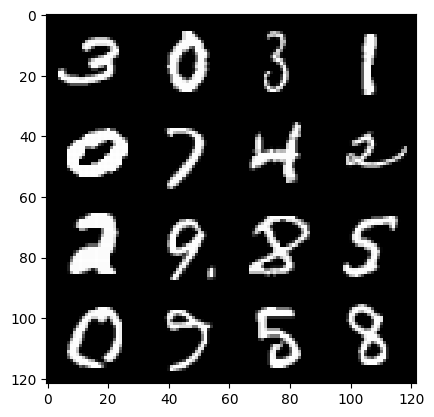

150: step 70800/ gen loss: 2.145265446503956 / disc loss: 0.2760127708812555


  0%|          | 0/469 [00:00<?, ?it/s]

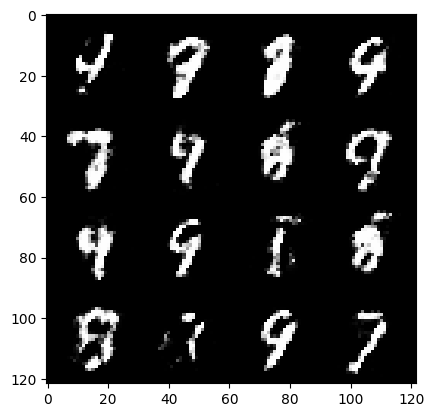

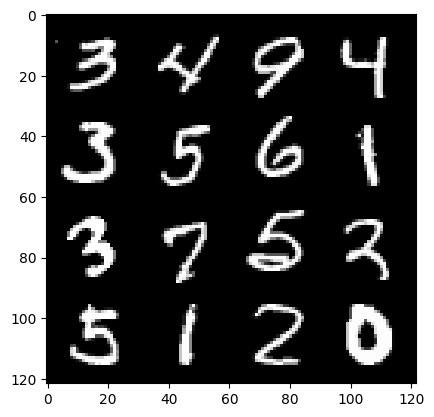

151: step 71100/ gen loss: 2.143426935275395 / disc loss: 0.27246819282571455


  0%|          | 0/469 [00:00<?, ?it/s]

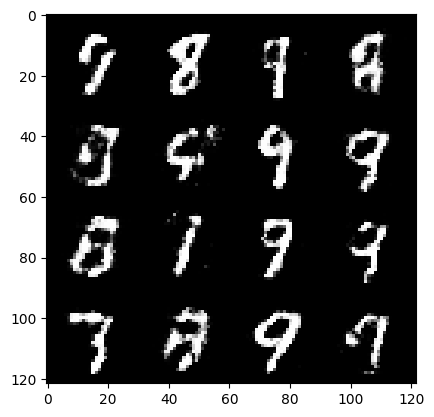

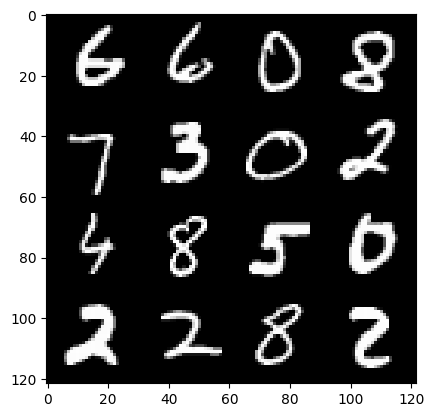

152: step 71400/ gen loss: 2.204331667820613 / disc loss: 0.26020080606142676


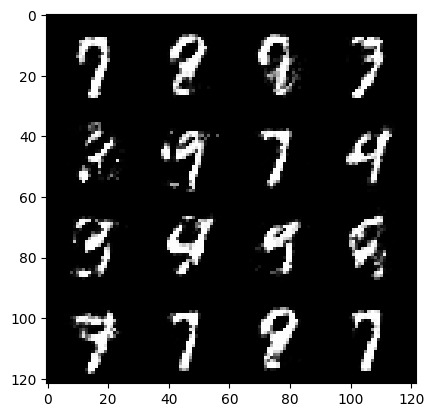

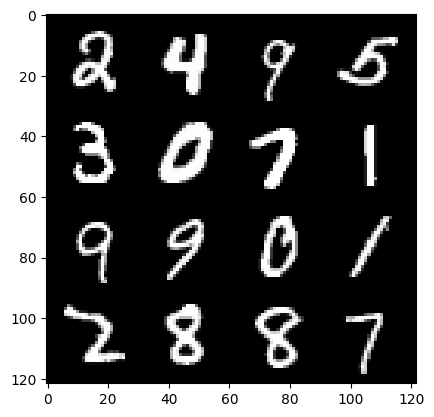

152: step 71700/ gen loss: 2.1342299985885624 / disc loss: 0.2837983158727486


  0%|          | 0/469 [00:00<?, ?it/s]

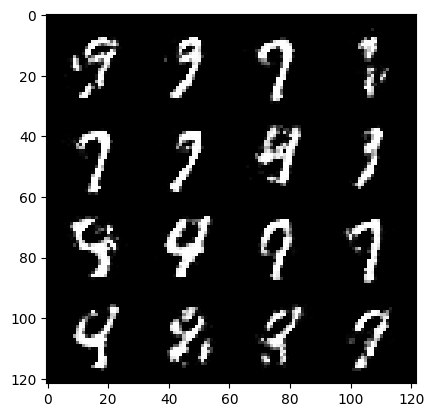

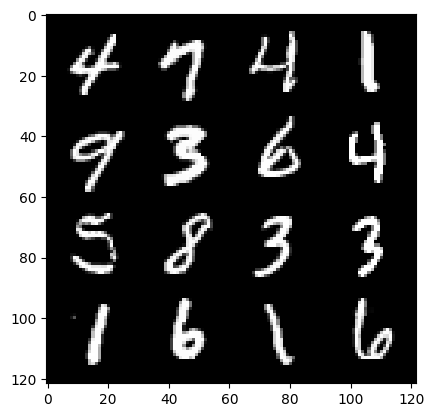

153: step 72000/ gen loss: 2.1626945535341893 / disc loss: 0.27505623022715253


  0%|          | 0/469 [00:00<?, ?it/s]

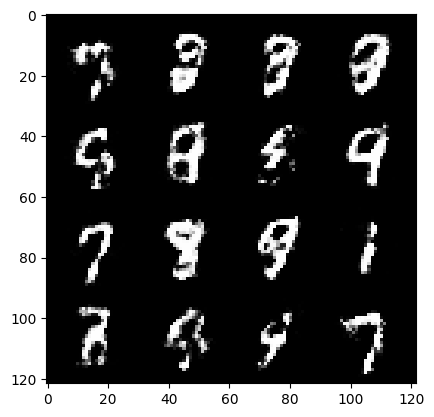

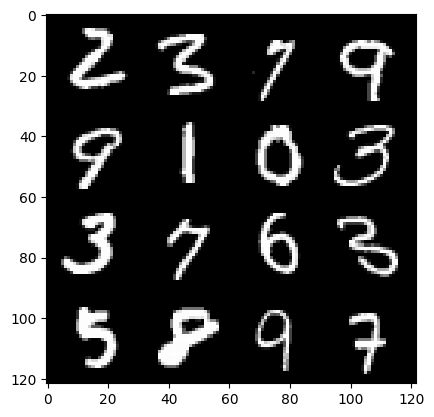

154: step 72300/ gen loss: 2.105449106693267 / disc loss: 0.2871875708301861


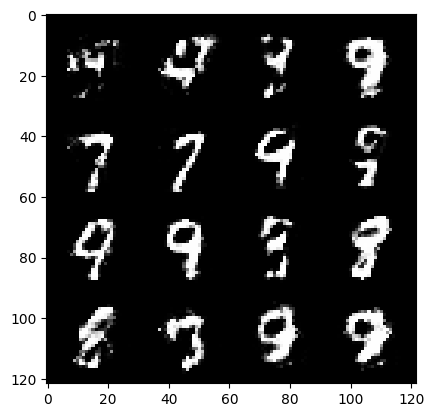

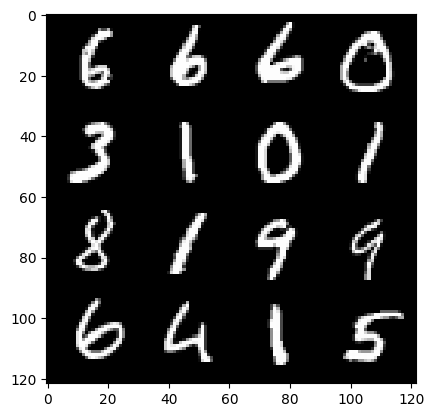

154: step 72600/ gen loss: 2.0662865118185687 / disc loss: 0.2851420792937279


  0%|          | 0/469 [00:00<?, ?it/s]

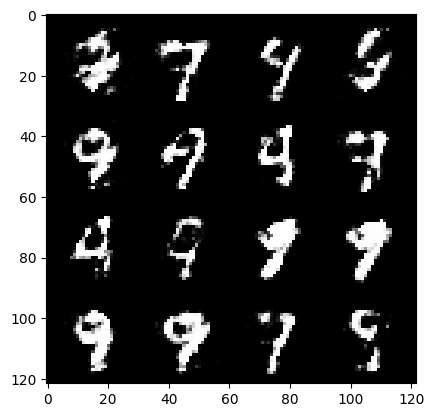

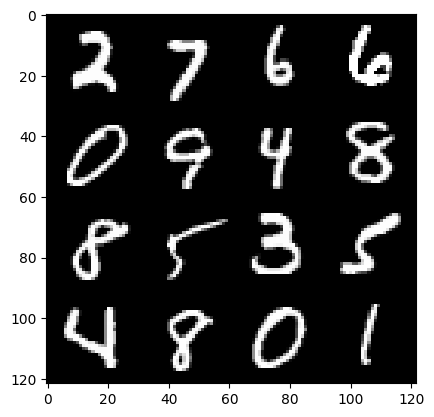

155: step 72900/ gen loss: 2.0333706883589433 / disc loss: 0.29135169600447036


  0%|          | 0/469 [00:00<?, ?it/s]

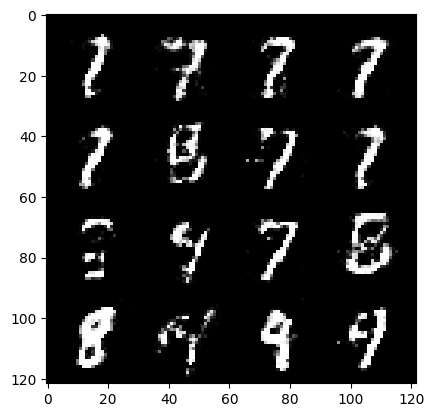

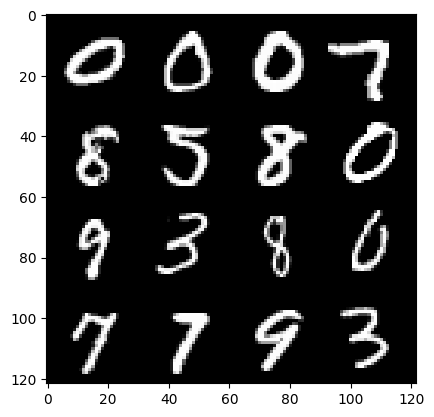

156: step 73200/ gen loss: 2.0625187635421742 / disc loss: 0.2839080110192298


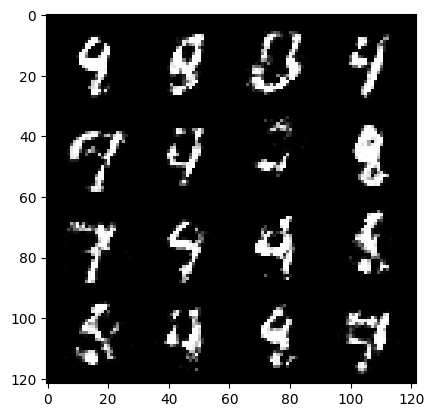

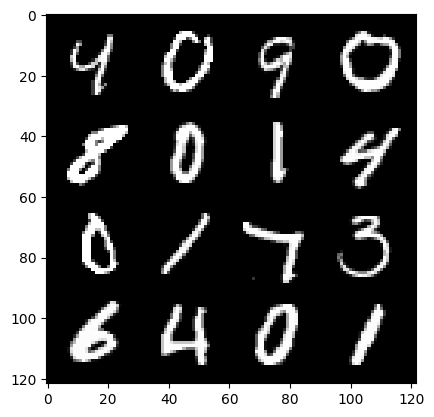

156: step 73500/ gen loss: 2.132164898316065 / disc loss: 0.25885701268911343


  0%|          | 0/469 [00:00<?, ?it/s]

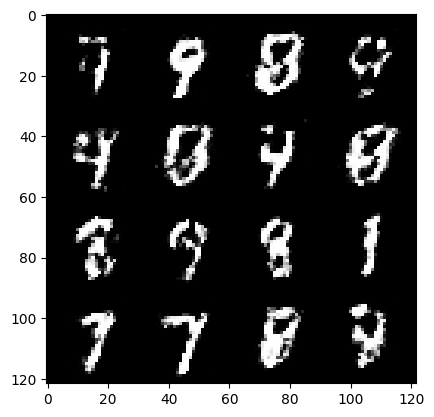

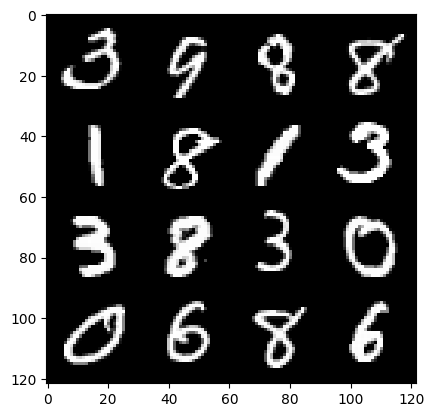

157: step 73800/ gen loss: 2.1006428726514175 / disc loss: 0.2871895240247248


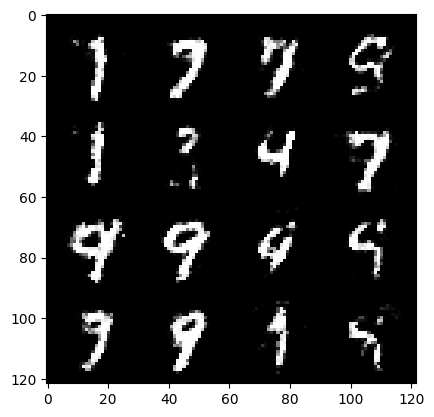

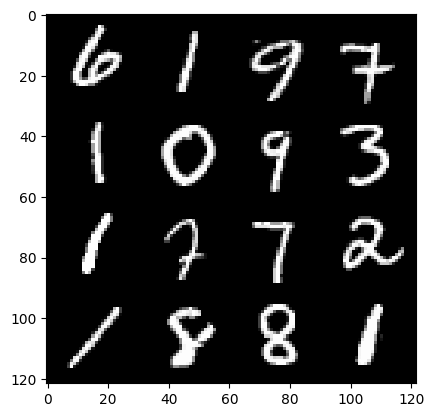

157: step 74100/ gen loss: 1.98223778327306 / disc loss: 0.2927814586460593


  0%|          | 0/469 [00:00<?, ?it/s]

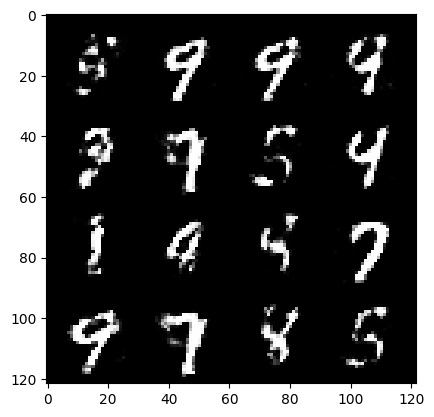

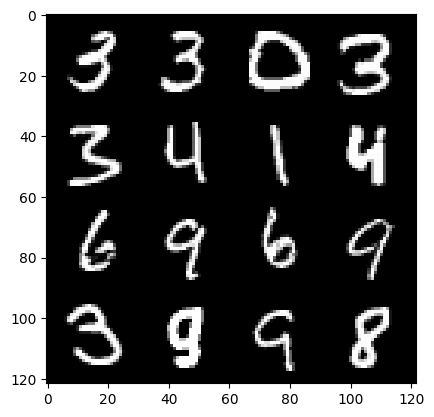

158: step 74400/ gen loss: 2.0467673679192866 / disc loss: 0.2801222626368206


  0%|          | 0/469 [00:00<?, ?it/s]

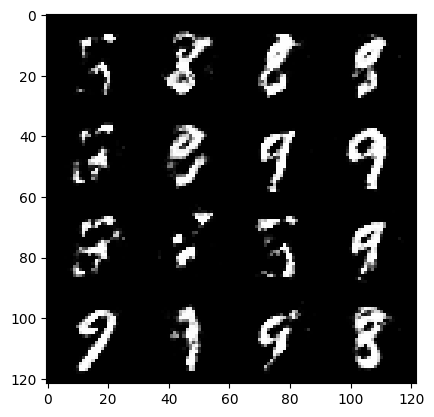

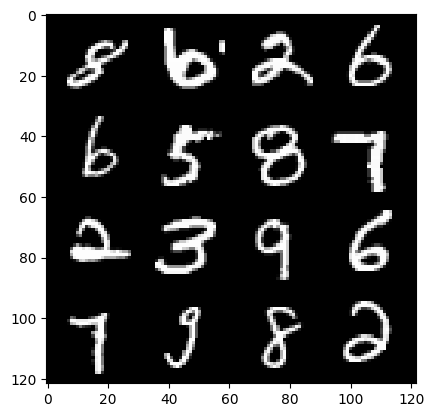

159: step 74700/ gen loss: 2.002552710374197 / disc loss: 0.2941386165718237


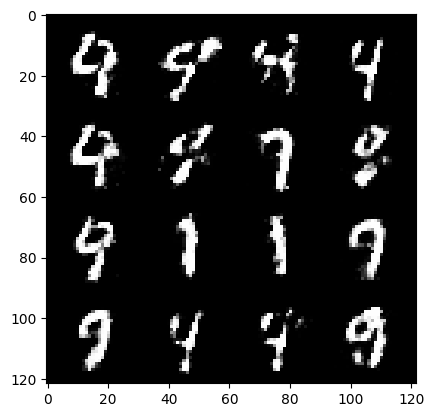

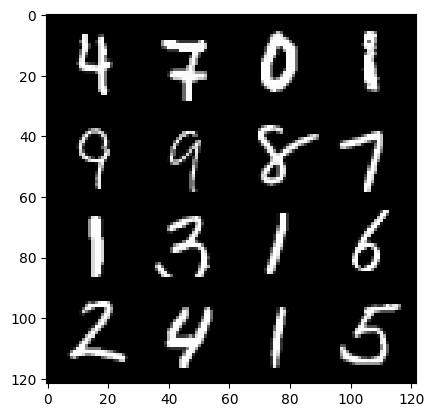

159: step 75000/ gen loss: 2.0361070227622986 / disc loss: 0.2935957380135855


  0%|          | 0/469 [00:00<?, ?it/s]

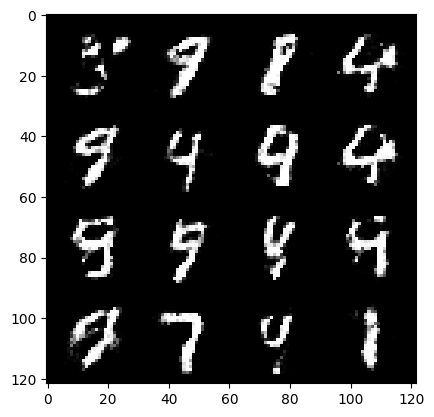

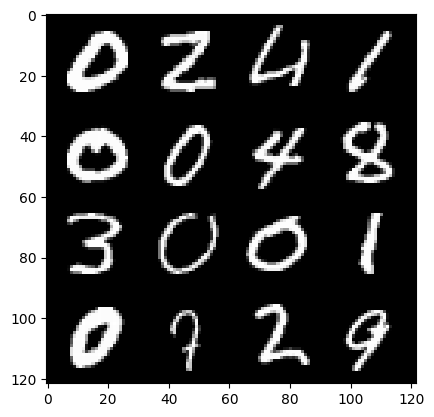

160: step 75300/ gen loss: 2.049374900658925 / disc loss: 0.29853480190038695


  0%|          | 0/469 [00:00<?, ?it/s]

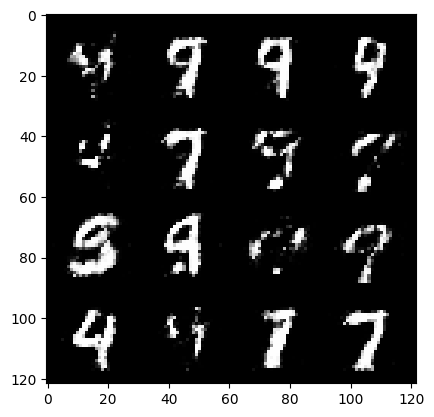

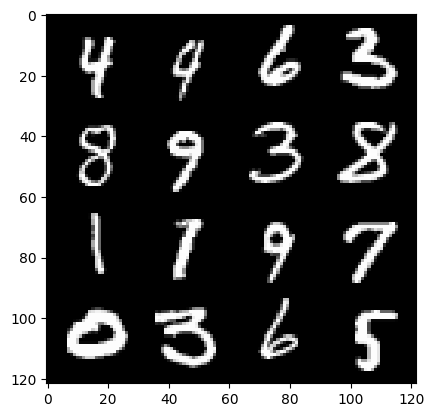

161: step 75600/ gen loss: 2.0288903673489886 / disc loss: 0.2903155749042828


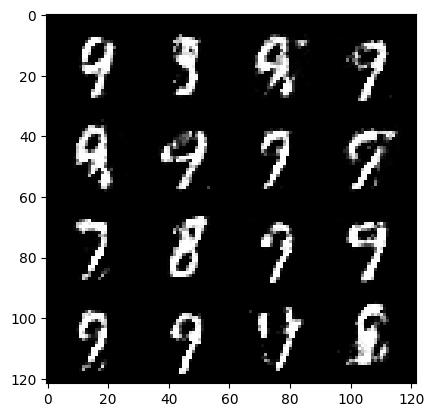

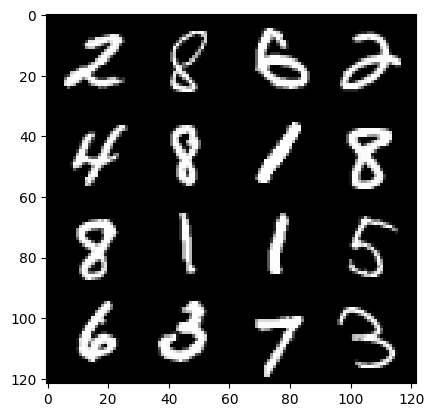

161: step 75900/ gen loss: 2.0818320814768465 / disc loss: 0.28571208099524187


  0%|          | 0/469 [00:00<?, ?it/s]

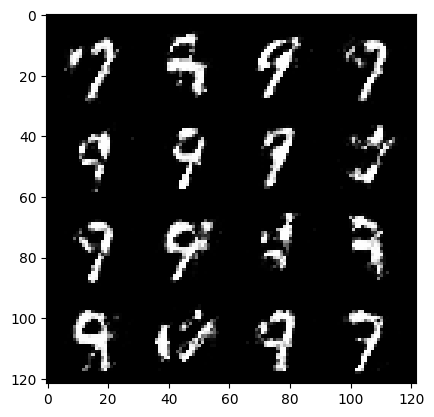

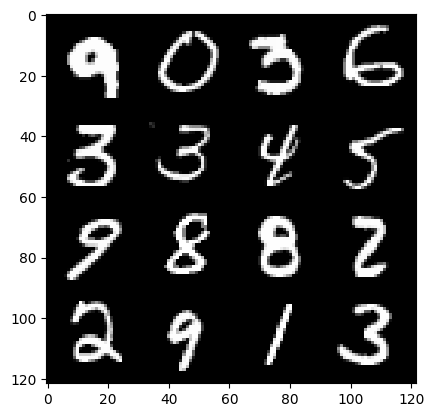

162: step 76200/ gen loss: 2.103971248070401 / disc loss: 0.2978573475778102


  0%|          | 0/469 [00:00<?, ?it/s]

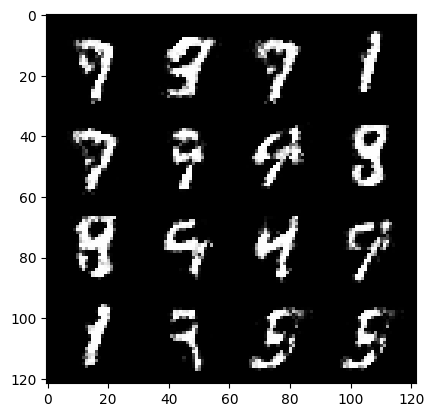

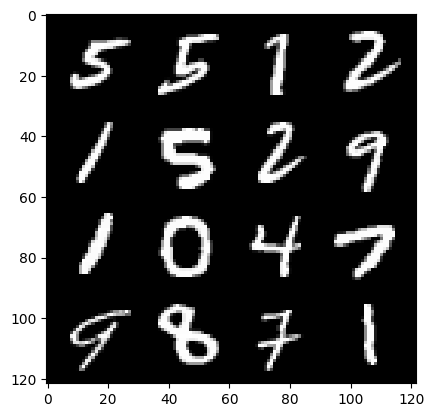

163: step 76500/ gen loss: 2.042892711162567 / disc loss: 0.3003119921684263


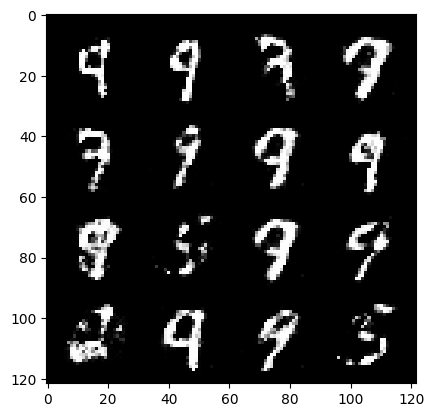

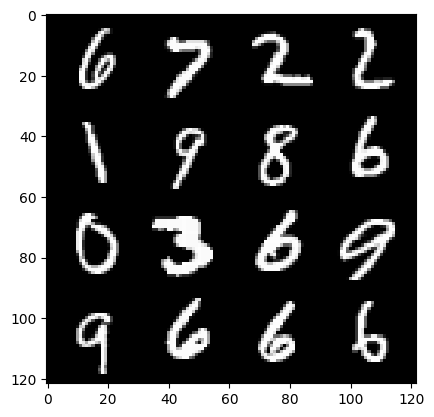

163: step 76800/ gen loss: 2.1023710151513426 / disc loss: 0.2768979898095132


  0%|          | 0/469 [00:00<?, ?it/s]

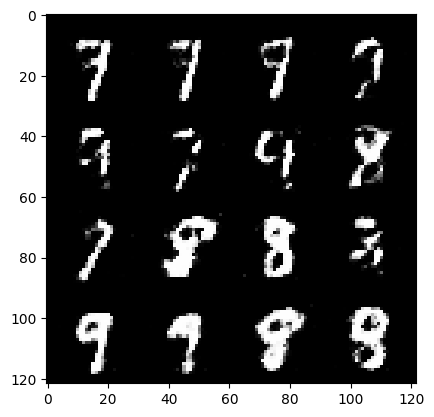

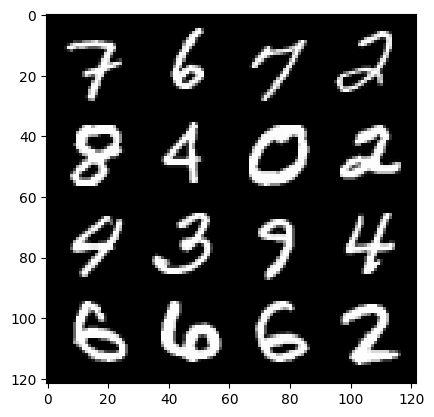

164: step 77100/ gen loss: 2.006193826993307 / disc loss: 0.29957472935318946


  0%|          | 0/469 [00:00<?, ?it/s]

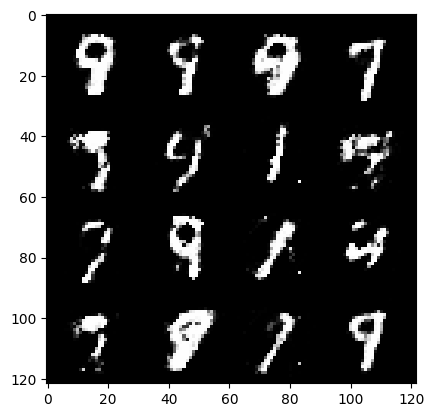

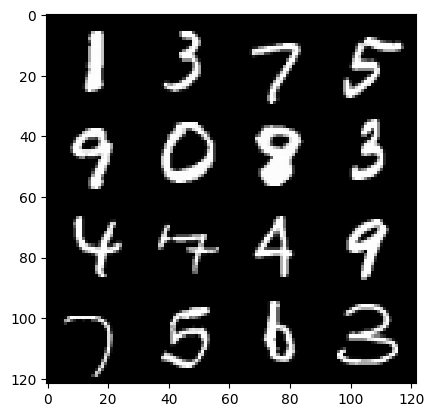

165: step 77400/ gen loss: 1.9811623167991645 / disc loss: 0.30232466747363407


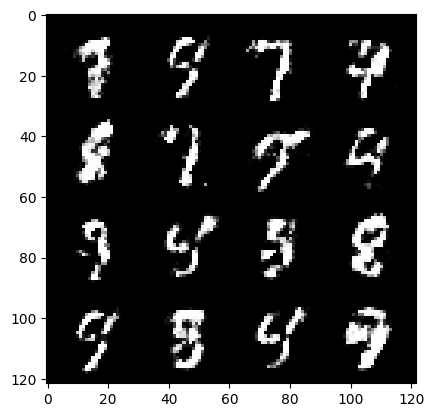

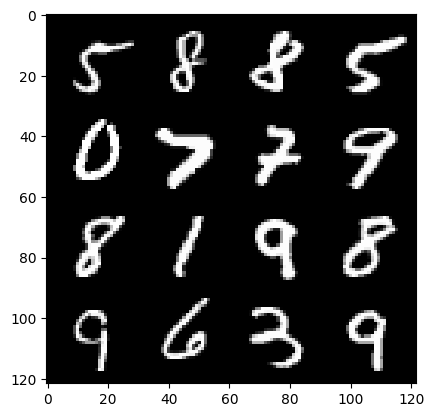

165: step 77700/ gen loss: 1.9202131319046019 / disc loss: 0.3081907200316588


  0%|          | 0/469 [00:00<?, ?it/s]

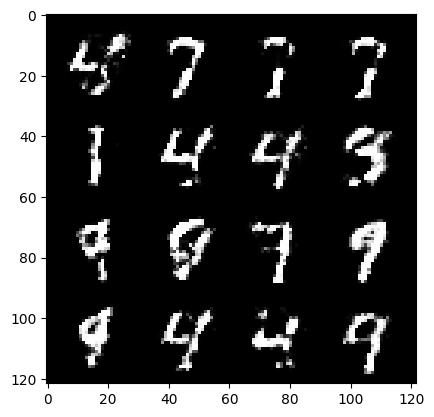

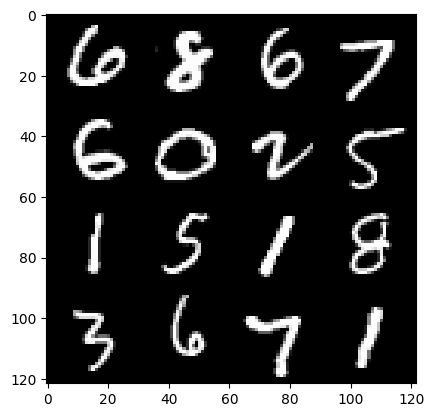

166: step 78000/ gen loss: 2.025780847469965 / disc loss: 0.2990772213538488


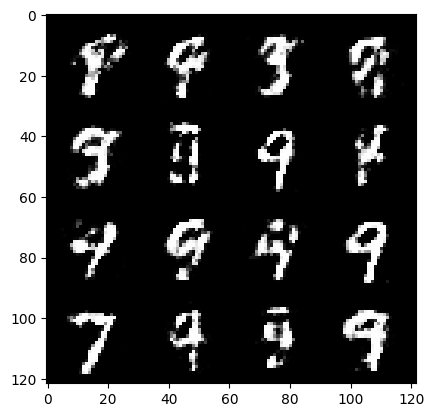

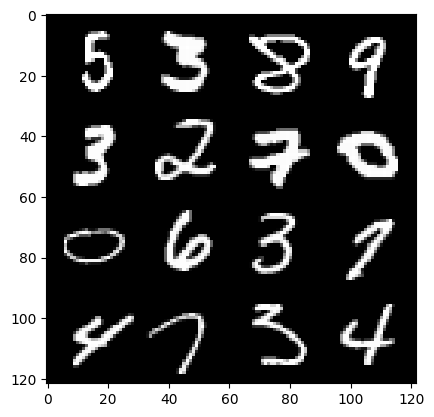

166: step 78300/ gen loss: 1.997162665128708 / disc loss: 0.312462085833152


  0%|          | 0/469 [00:00<?, ?it/s]

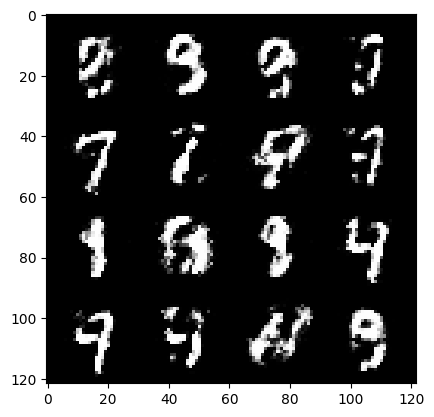

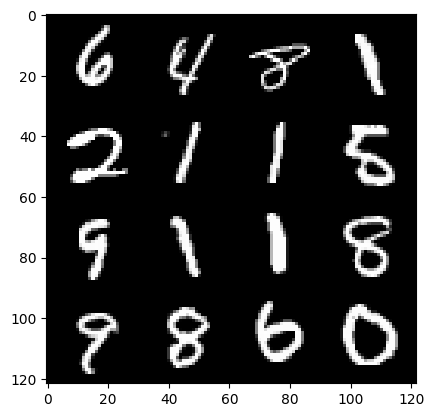

167: step 78600/ gen loss: 1.9685492392381023 / disc loss: 0.3149413007497789


  0%|          | 0/469 [00:00<?, ?it/s]

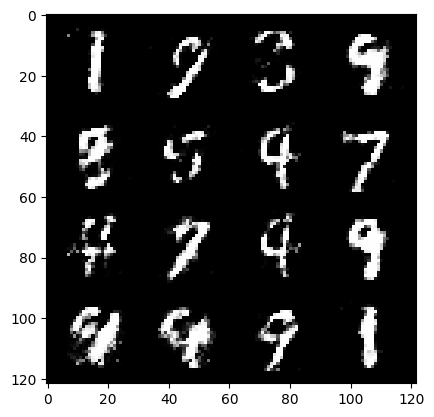

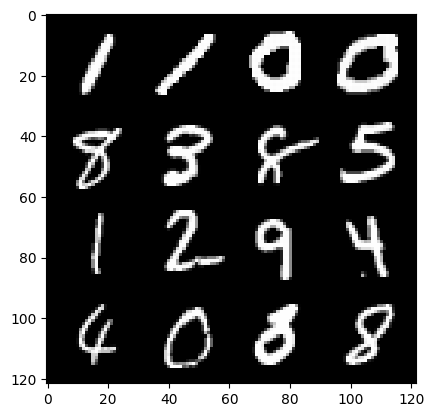

168: step 78900/ gen loss: 1.9574823133150754 / disc loss: 0.30417683556675934


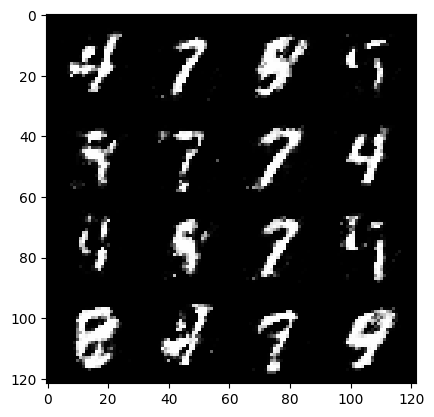

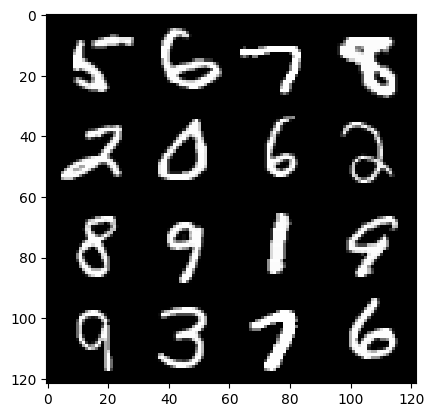

168: step 79200/ gen loss: 2.044129902124404 / disc loss: 0.29556911086042703


  0%|          | 0/469 [00:00<?, ?it/s]

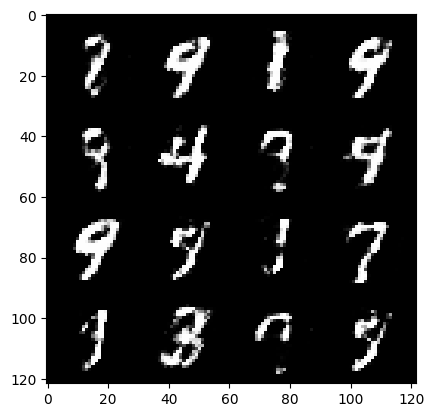

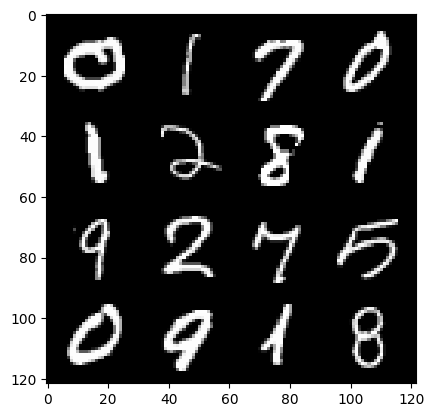

169: step 79500/ gen loss: 1.9268743904431669 / disc loss: 0.30449098914861666


  0%|          | 0/469 [00:00<?, ?it/s]

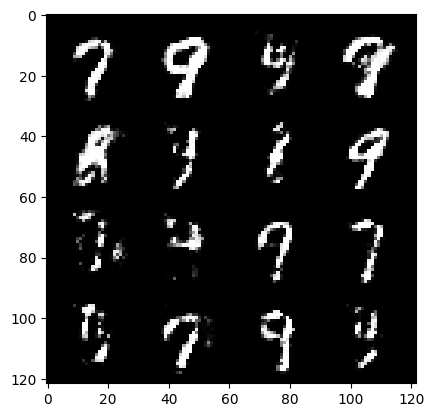

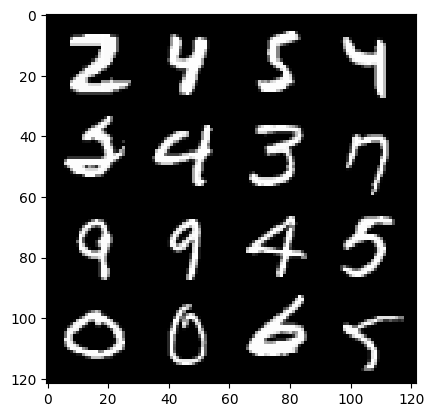

170: step 79800/ gen loss: 1.8748396420478821 / disc loss: 0.31138000875711447


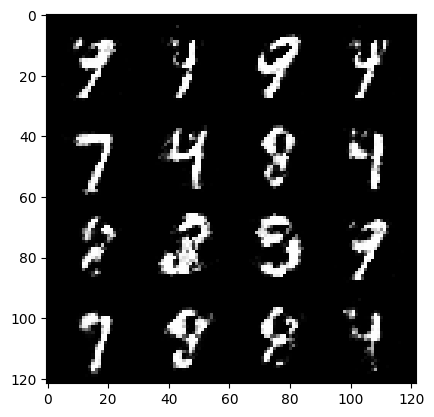

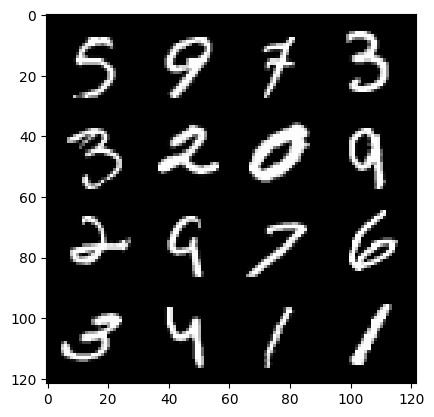

170: step 80100/ gen loss: 1.9169775533676154 / disc loss: 0.30682196274399776


  0%|          | 0/469 [00:00<?, ?it/s]

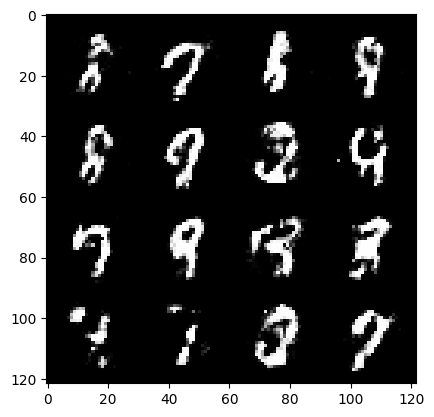

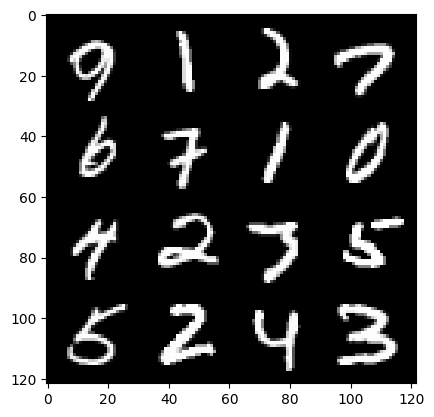

171: step 80400/ gen loss: 1.9653838006655362 / disc loss: 0.29493161718050626


  0%|          | 0/469 [00:00<?, ?it/s]

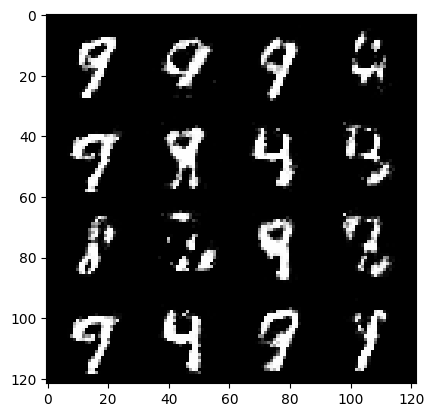

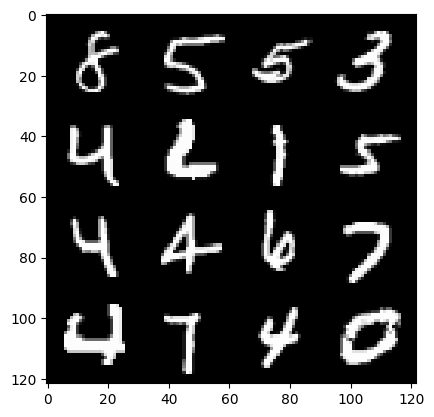

172: step 80700/ gen loss: 1.97075213154157 / disc loss: 0.3132060748835404


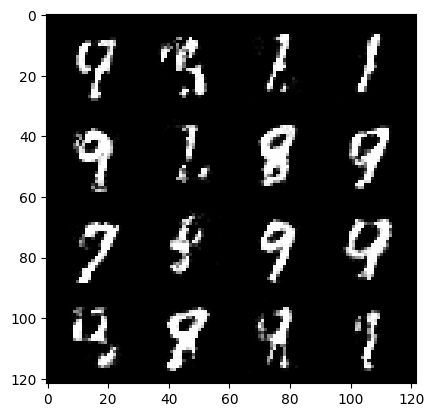

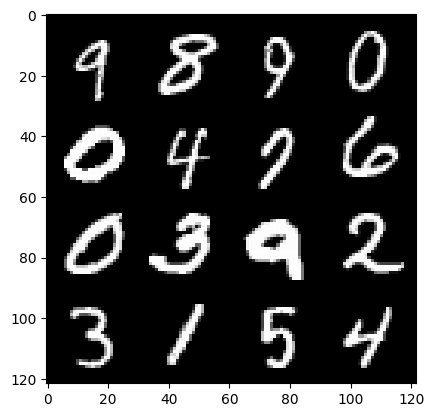

172: step 81000/ gen loss: 1.9817406352361047 / disc loss: 0.308488757163286


  0%|          | 0/469 [00:00<?, ?it/s]

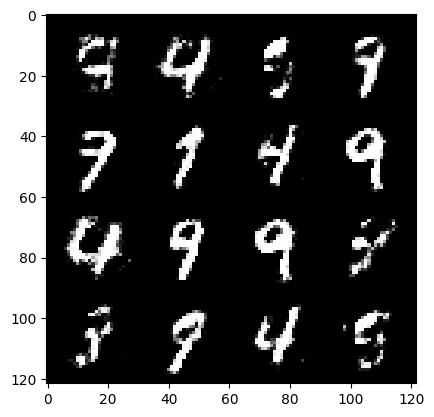

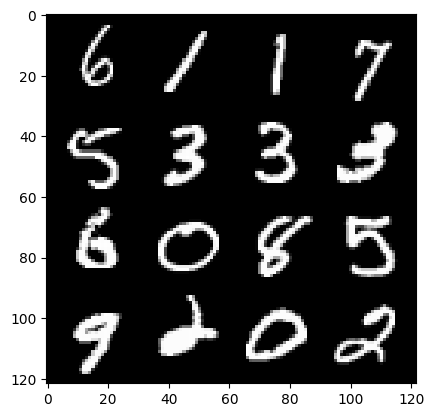

173: step 81300/ gen loss: 1.8892472795645396 / disc loss: 0.3229714614152908


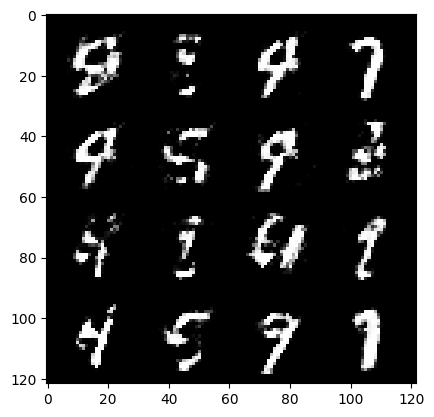

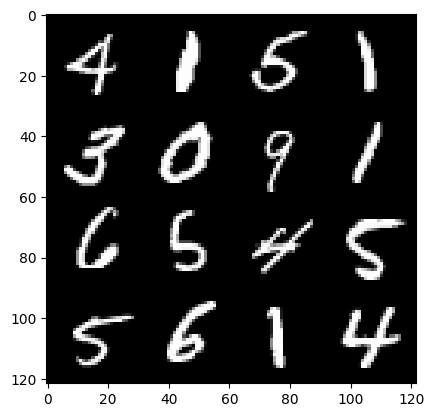

173: step 81600/ gen loss: 1.947694557507833 / disc loss: 0.31272184709707873


  0%|          | 0/469 [00:00<?, ?it/s]

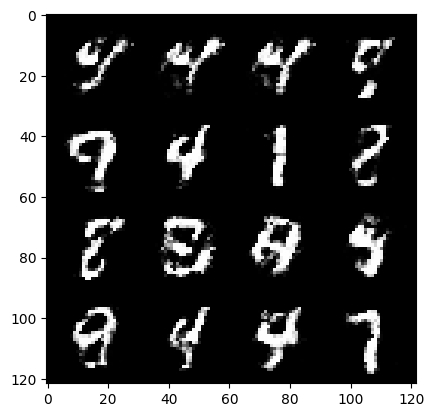

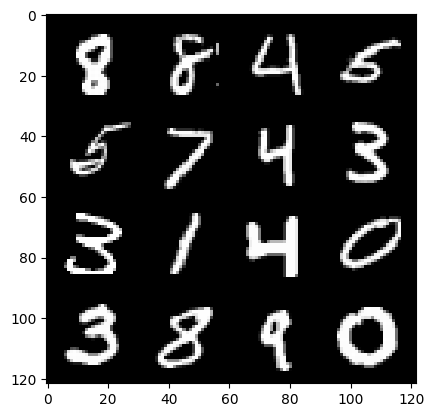

174: step 81900/ gen loss: 1.882621071338654 / disc loss: 0.3303995997210343


  0%|          | 0/469 [00:00<?, ?it/s]

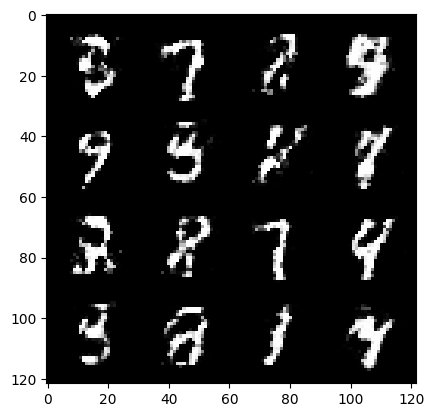

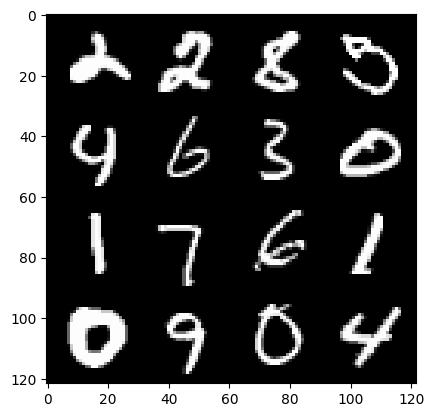

175: step 82200/ gen loss: 1.8180627759297692 / disc loss: 0.333720021545887


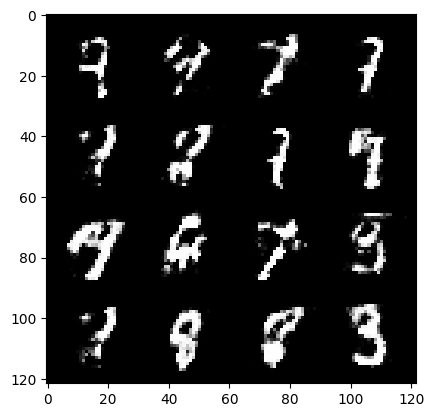

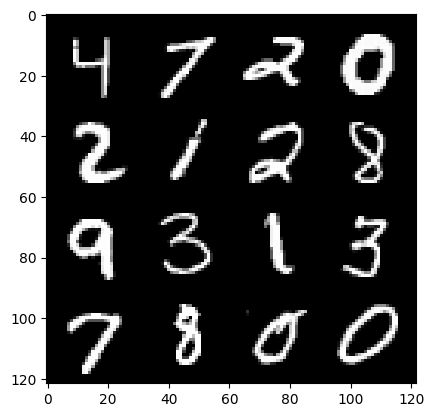

175: step 82500/ gen loss: 1.884404028256734 / disc loss: 0.3260739716390769


  0%|          | 0/469 [00:00<?, ?it/s]

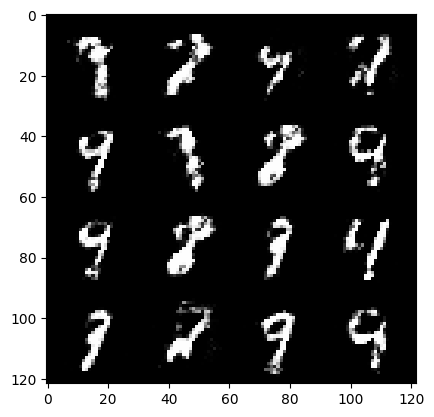

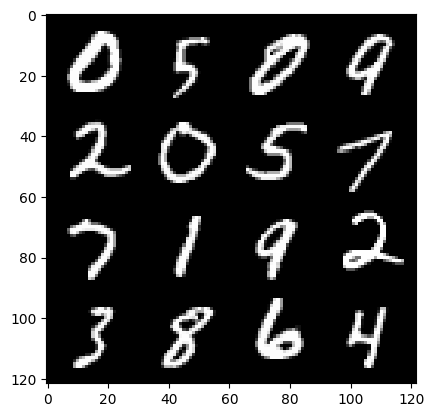

176: step 82800/ gen loss: 1.866436629692713 / disc loss: 0.33002921879291547


  0%|          | 0/469 [00:00<?, ?it/s]

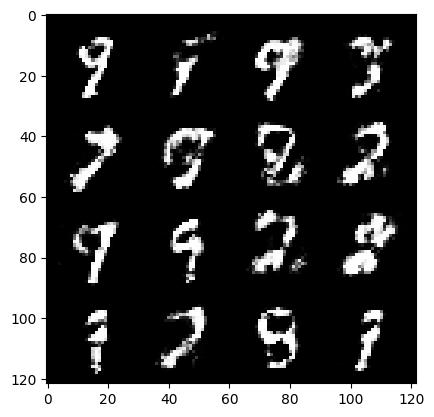

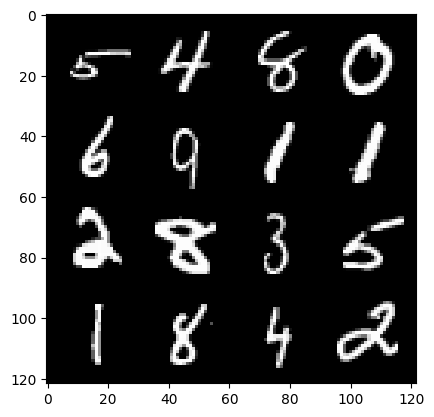

177: step 83100/ gen loss: 1.8563537406921384 / disc loss: 0.34237767944733283


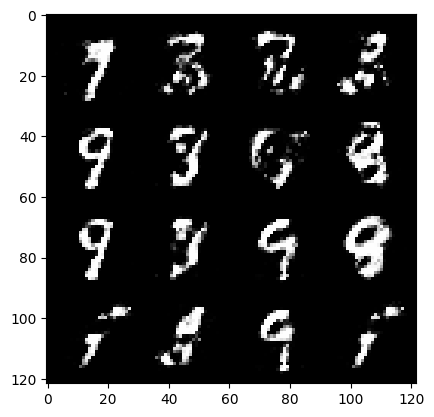

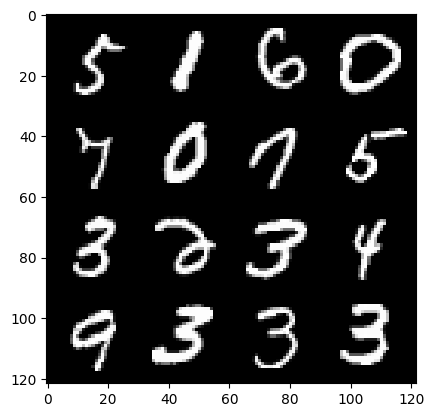

177: step 83400/ gen loss: 1.7696902171770732 / disc loss: 0.35536610315243433


  0%|          | 0/469 [00:00<?, ?it/s]

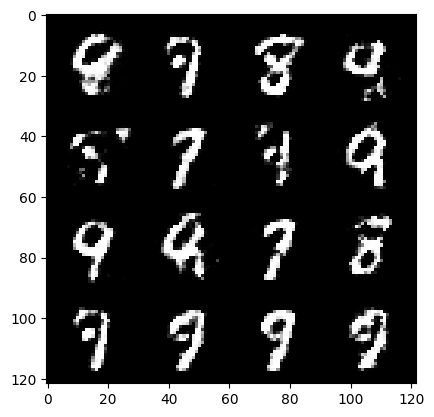

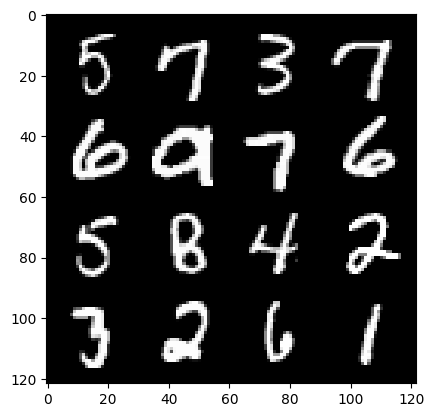

178: step 83700/ gen loss: 1.8693954511483508 / disc loss: 0.3168572906653086


  0%|          | 0/469 [00:00<?, ?it/s]

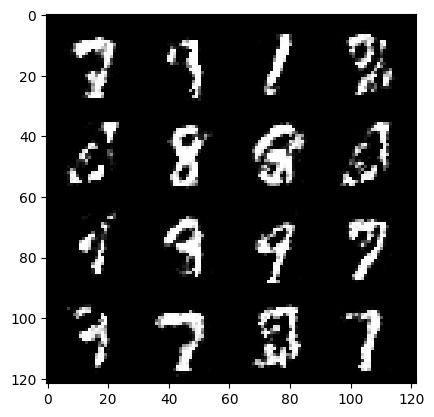

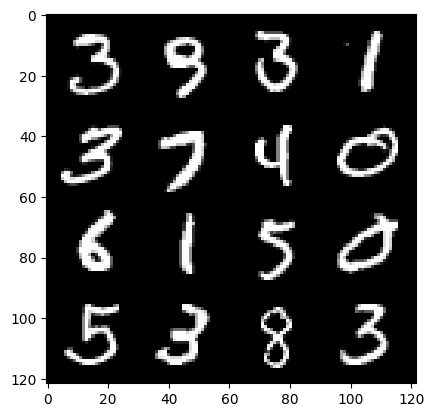

179: step 84000/ gen loss: 1.7856541776657109 / disc loss: 0.35637379144628833


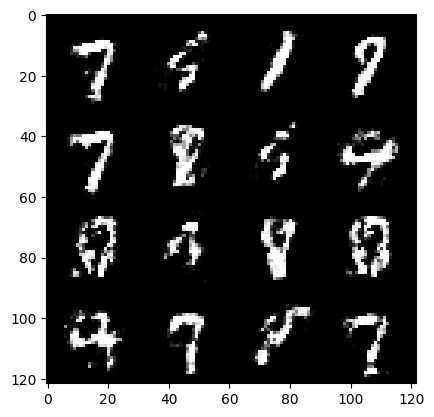

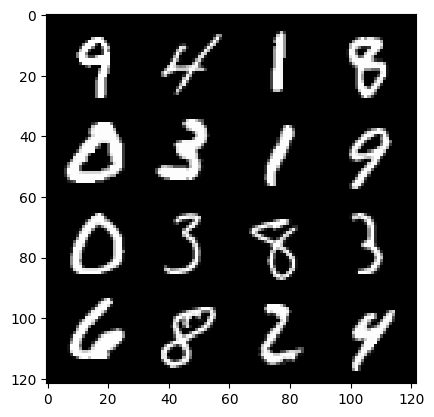

179: step 84300/ gen loss: 1.7669927326838168 / disc loss: 0.34578474005063403


  0%|          | 0/469 [00:00<?, ?it/s]

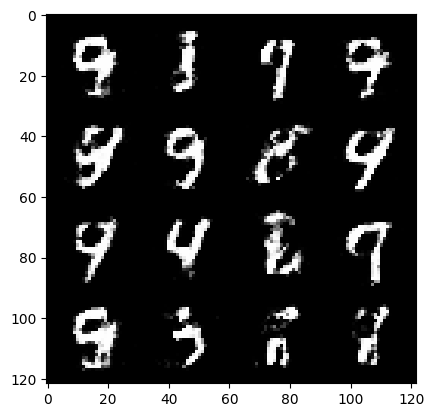

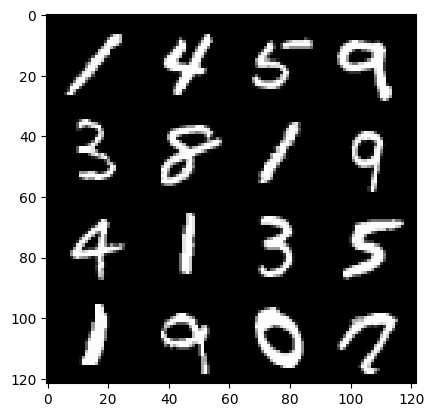

180: step 84600/ gen loss: 1.8684146841367077 / disc loss: 0.3175366423030694


  0%|          | 0/469 [00:00<?, ?it/s]

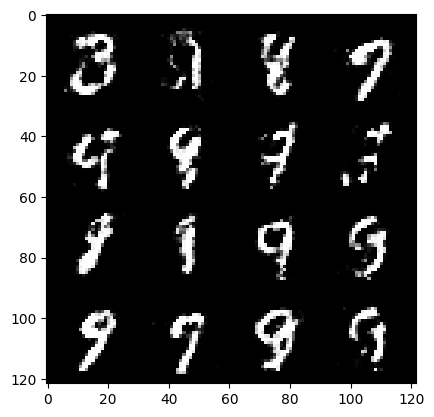

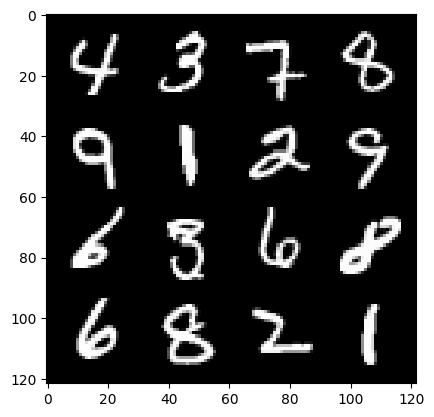

181: step 84900/ gen loss: 1.8930146074295038 / disc loss: 0.31385163694620155


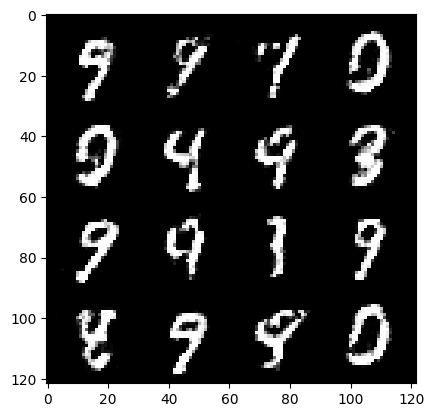

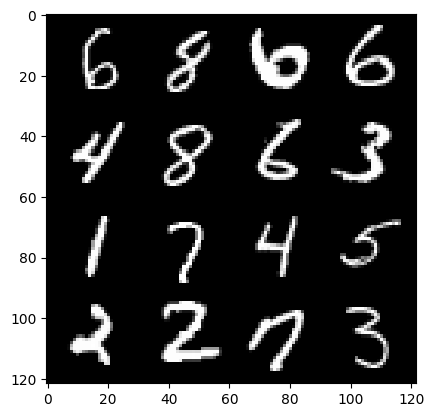

181: step 85200/ gen loss: 1.830494546095529 / disc loss: 0.3441090813279154


  0%|          | 0/469 [00:00<?, ?it/s]

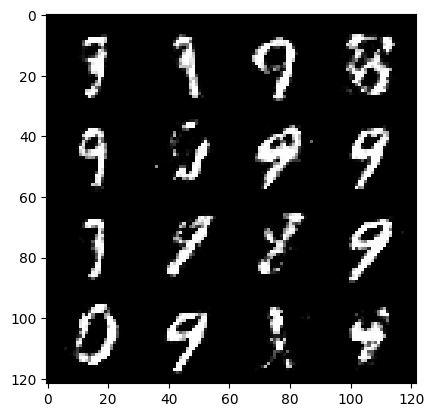

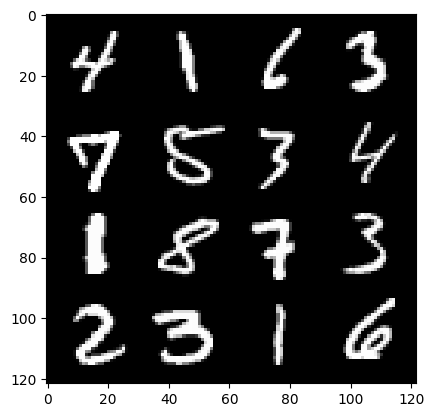

182: step 85500/ gen loss: 1.826331767241161 / disc loss: 0.33234629581371944


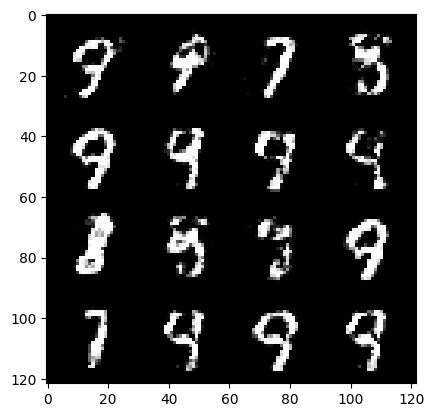

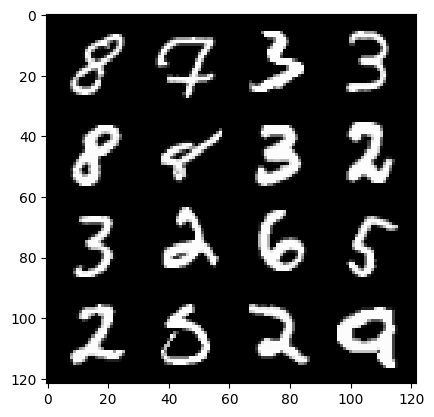

182: step 85800/ gen loss: 1.8532581388950355 / disc loss: 0.33512524262070653


  0%|          | 0/469 [00:00<?, ?it/s]

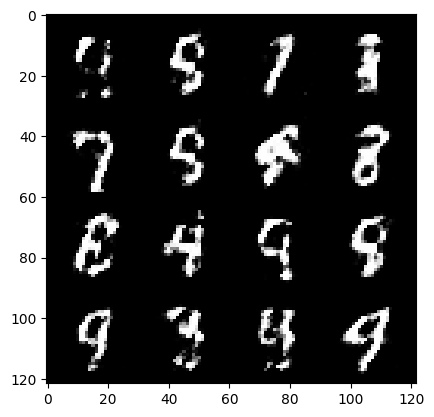

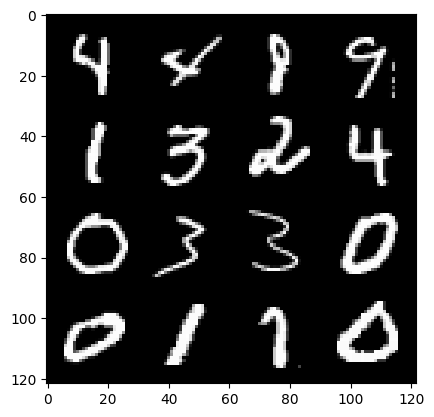

183: step 86100/ gen loss: 1.8270371079444876 / disc loss: 0.33115499724944425


  0%|          | 0/469 [00:00<?, ?it/s]

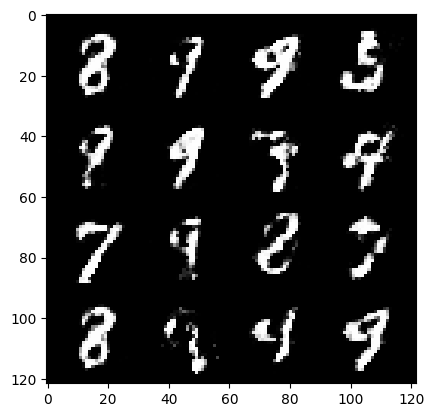

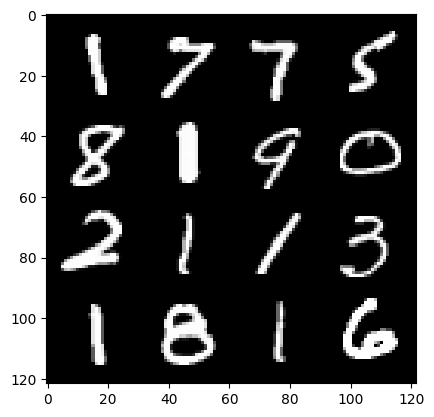

184: step 86400/ gen loss: 1.7814292363325739 / disc loss: 0.3475432174404462


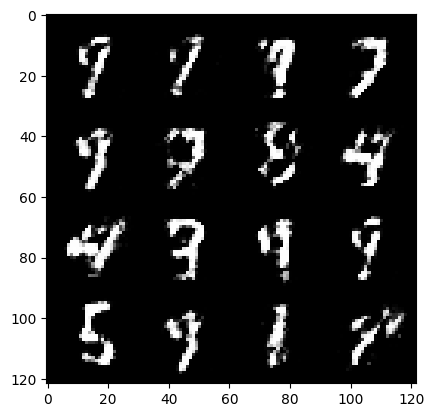

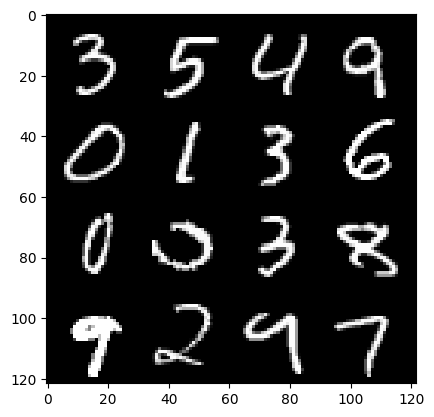

184: step 86700/ gen loss: 1.7352092107137047 / disc loss: 0.3601626094182333


  0%|          | 0/469 [00:00<?, ?it/s]

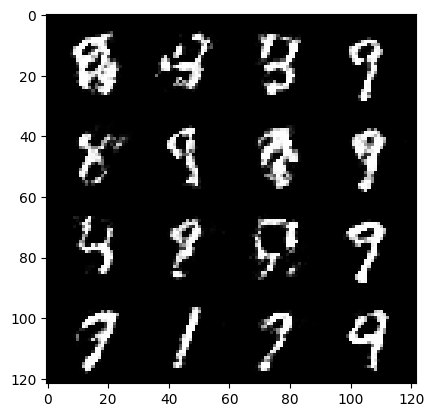

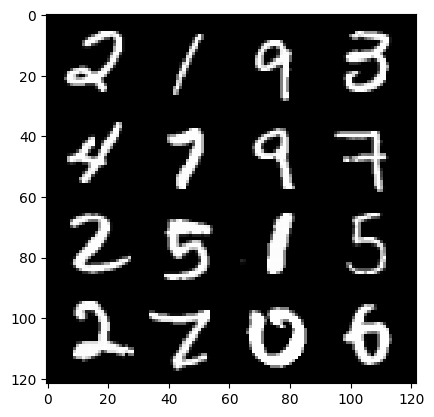

185: step 87000/ gen loss: 1.7898203202088665 / disc loss: 0.34151426156361886


  0%|          | 0/469 [00:00<?, ?it/s]

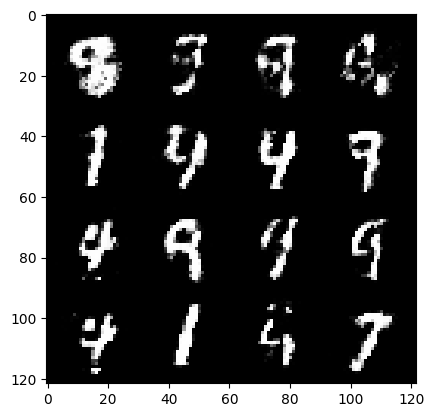

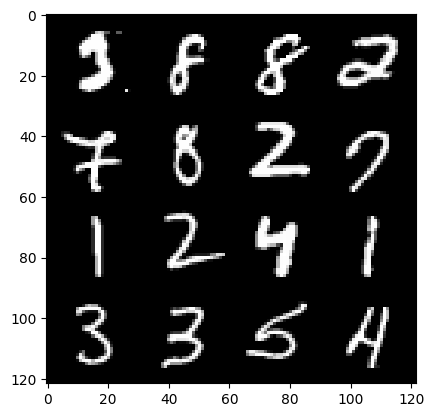

186: step 87300/ gen loss: 1.746755721966427 / disc loss: 0.3528543641169866


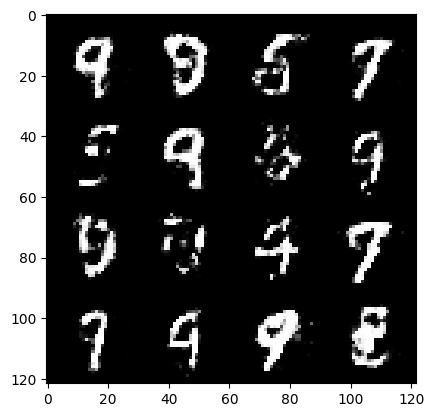

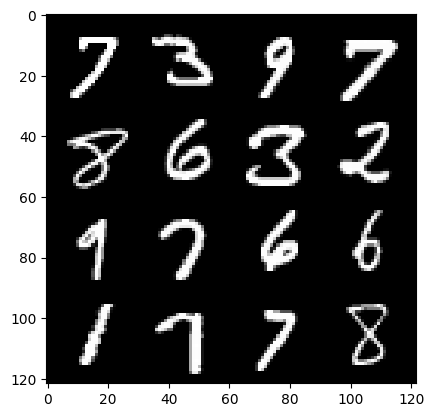

186: step 87600/ gen loss: 1.7103430060545601 / disc loss: 0.3554242687424022


  0%|          | 0/469 [00:00<?, ?it/s]

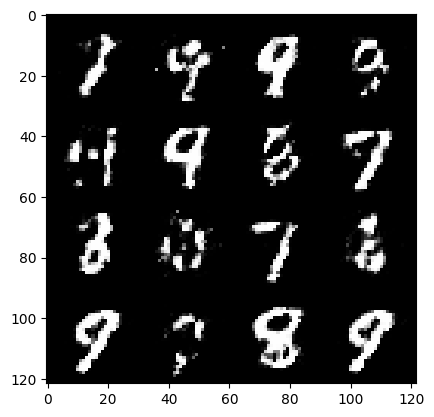

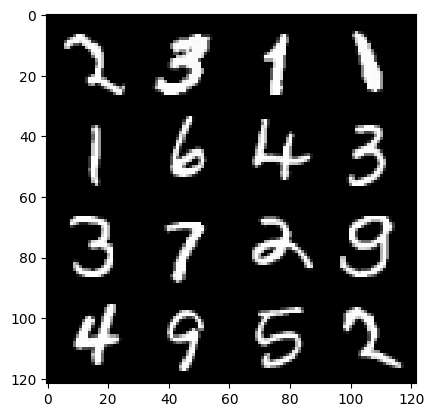

187: step 87900/ gen loss: 1.81337359627088 / disc loss: 0.3219536684453489


  0%|          | 0/469 [00:00<?, ?it/s]

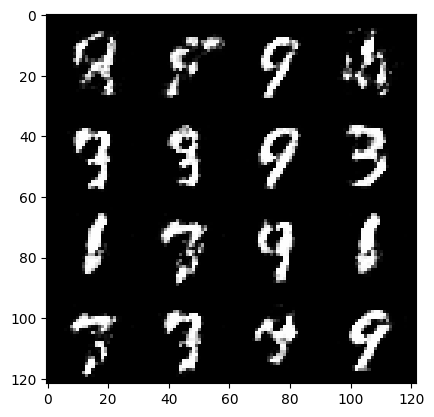

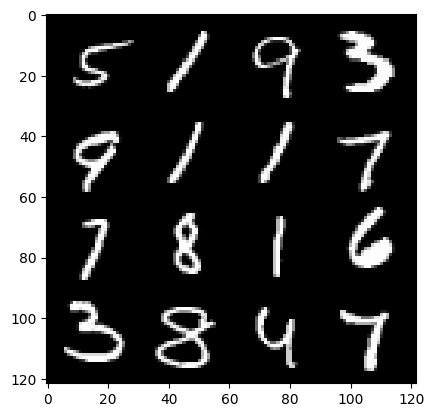

188: step 88200/ gen loss: 1.7367636875311534 / disc loss: 0.35670308286945


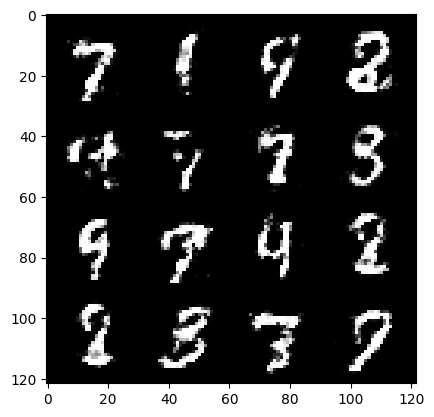

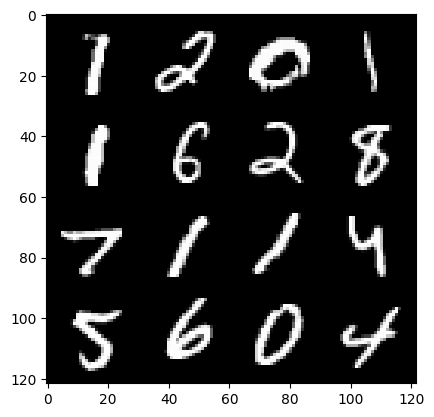

188: step 88500/ gen loss: 1.6716285804907478 / disc loss: 0.36604730894168214


  0%|          | 0/469 [00:00<?, ?it/s]

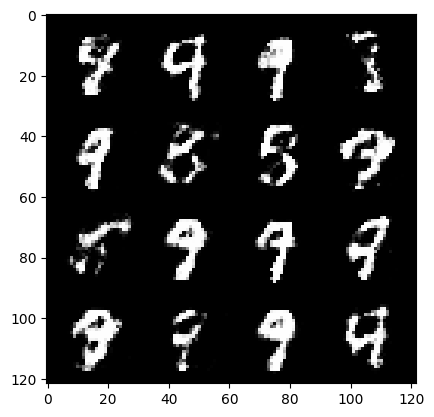

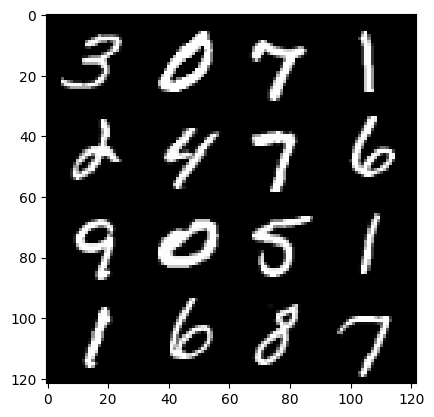

189: step 88800/ gen loss: 1.7601117070515946 / disc loss: 0.34660796999931315


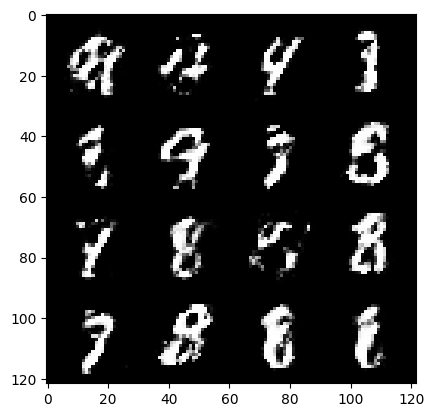

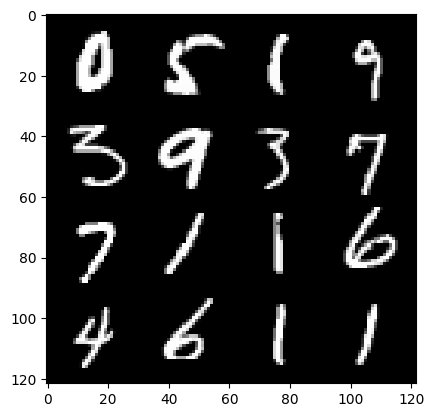

189: step 89100/ gen loss: 1.7190122548739113 / disc loss: 0.3500095931688945


  0%|          | 0/469 [00:00<?, ?it/s]

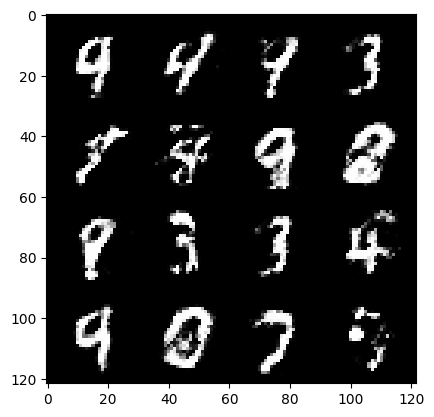

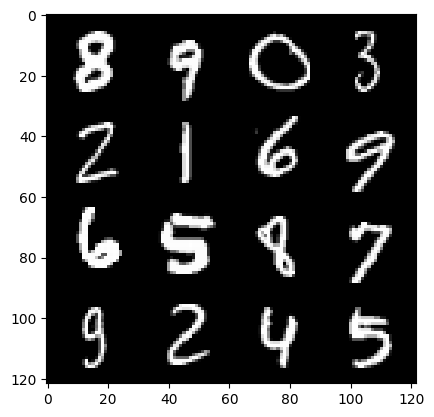

190: step 89400/ gen loss: 1.7490463725725802 / disc loss: 0.34728930900494265


  0%|          | 0/469 [00:00<?, ?it/s]

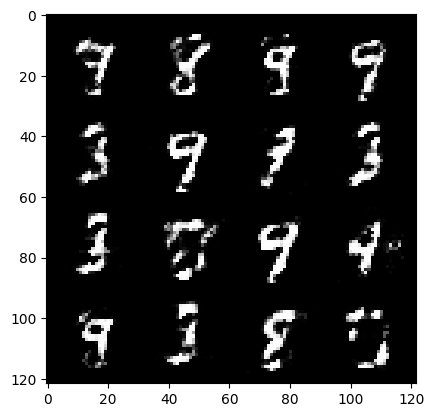

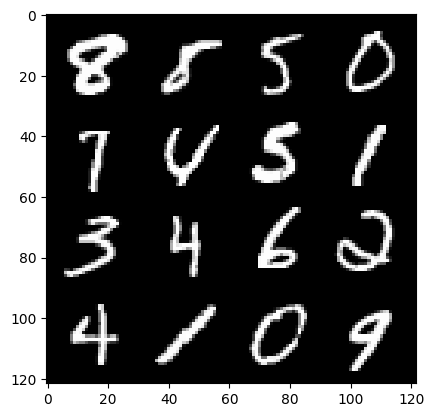

191: step 89700/ gen loss: 1.7959575661023455 / disc loss: 0.3349656609694162


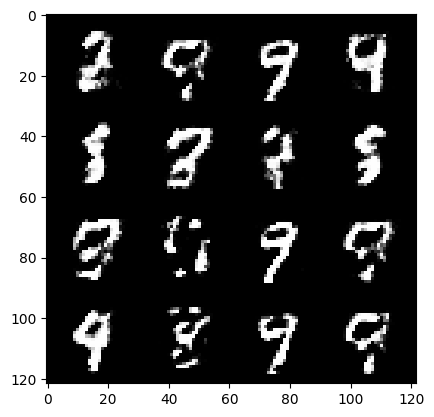

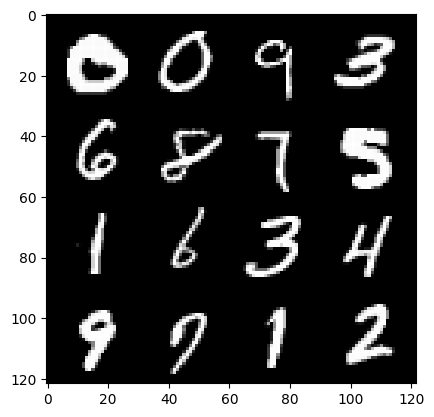

191: step 90000/ gen loss: 1.690010534922282 / disc loss: 0.3645983724792798


  0%|          | 0/469 [00:00<?, ?it/s]

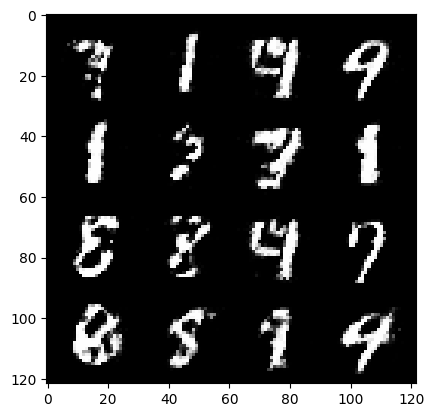

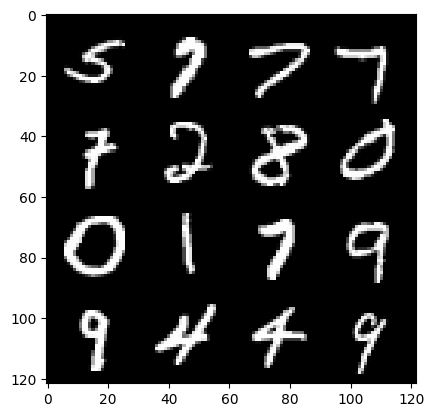

192: step 90300/ gen loss: 1.7241896828015644 / disc loss: 0.3528531142075858


  0%|          | 0/469 [00:00<?, ?it/s]

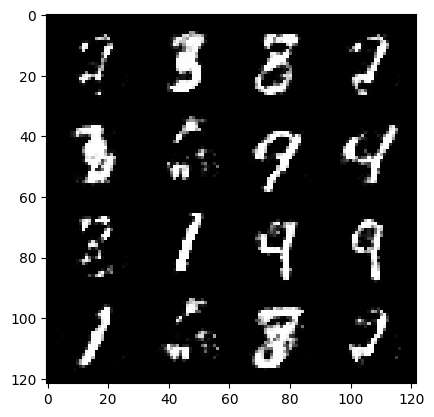

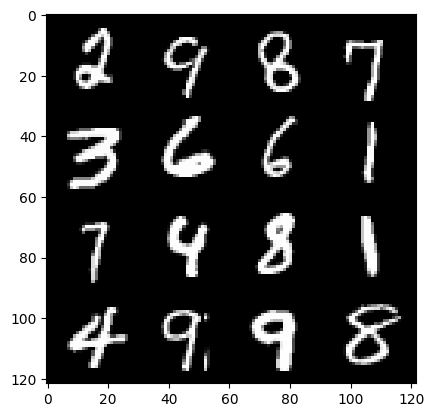

193: step 90600/ gen loss: 1.6384293766816453 / disc loss: 0.3717368659377099


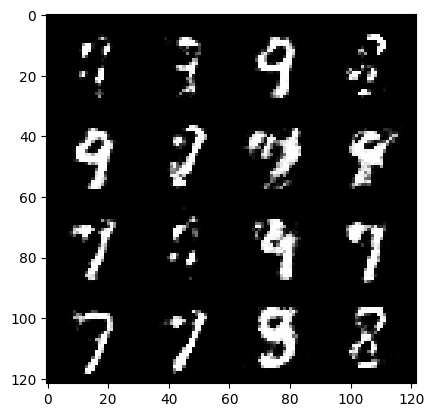

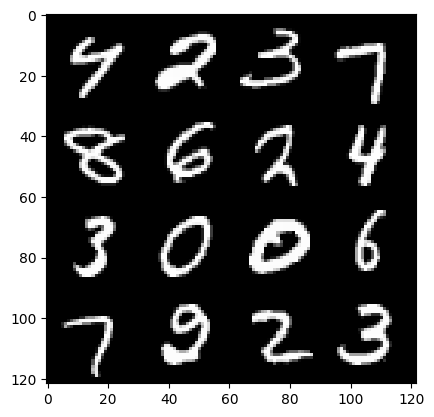

193: step 90900/ gen loss: 1.5697071651617684 / disc loss: 0.3850587738553683


  0%|          | 0/469 [00:00<?, ?it/s]

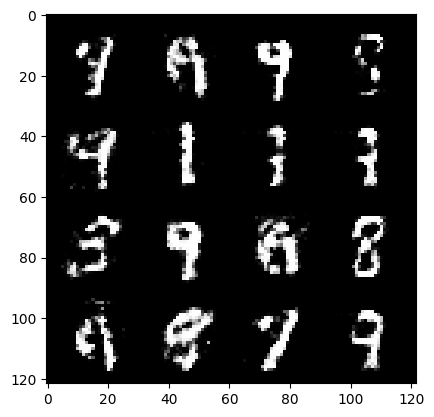

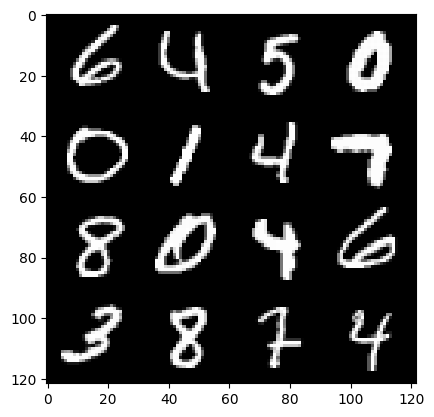

194: step 91200/ gen loss: 1.6174765622615823 / disc loss: 0.37668633331855134


  0%|          | 0/469 [00:00<?, ?it/s]

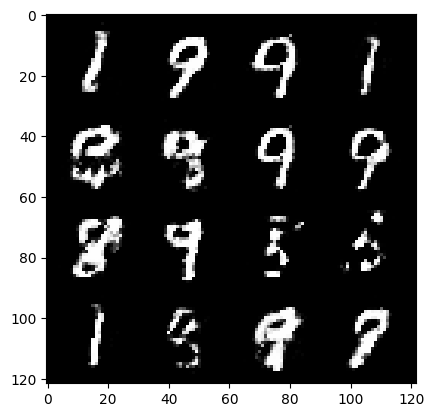

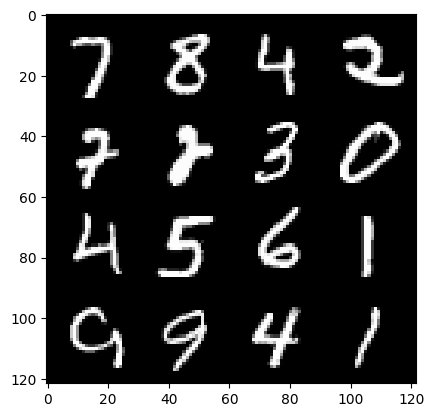

195: step 91500/ gen loss: 1.6523166215419767 / disc loss: 0.36657596190770486


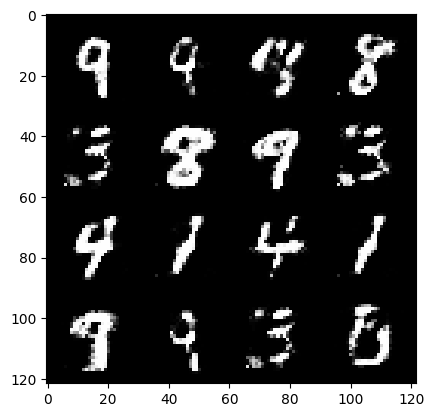

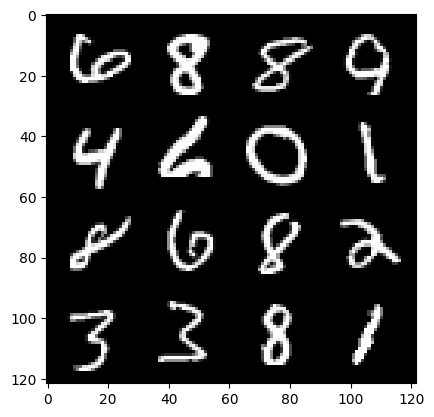

195: step 91800/ gen loss: 1.5387191303571064 / disc loss: 0.409550387263298


  0%|          | 0/469 [00:00<?, ?it/s]

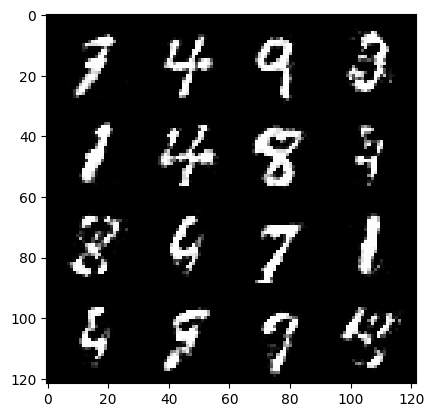

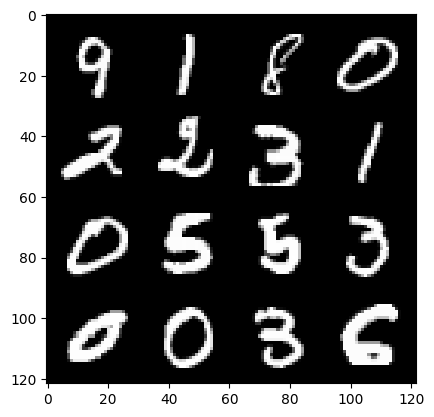

196: step 92100/ gen loss: 1.570521725813547 / disc loss: 0.39153234372536355


  0%|          | 0/469 [00:00<?, ?it/s]

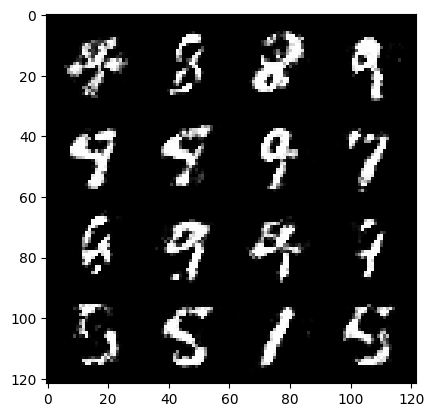

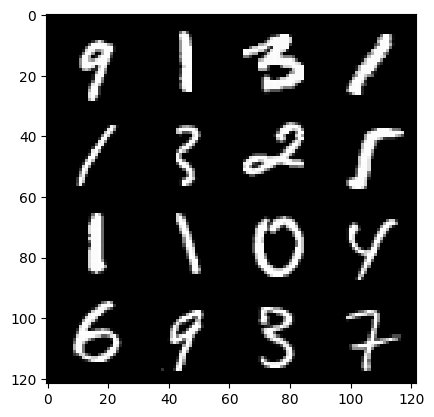

197: step 92400/ gen loss: 1.5566658870379122 / disc loss: 0.3900678408145901


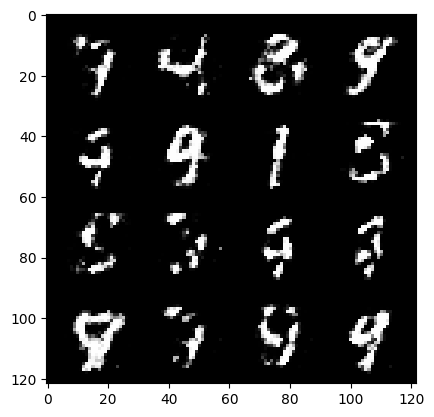

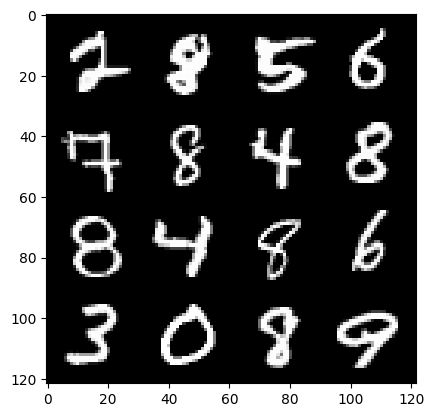

197: step 92700/ gen loss: 1.5852085419495916 / disc loss: 0.38456832051277146


  0%|          | 0/469 [00:00<?, ?it/s]

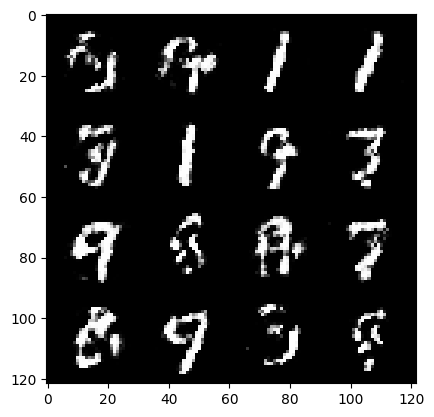

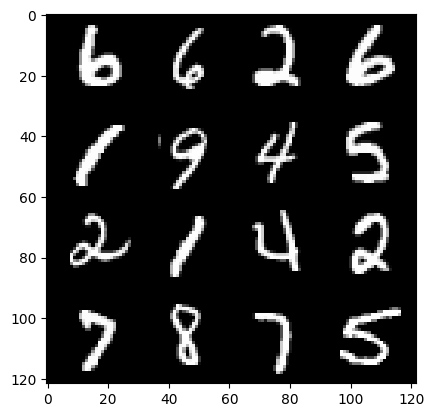

198: step 93000/ gen loss: 1.6704664365450543 / disc loss: 0.36849116067091614


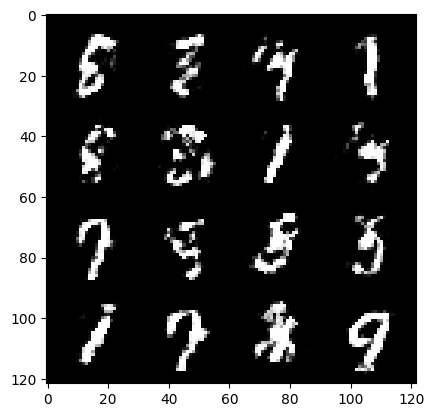

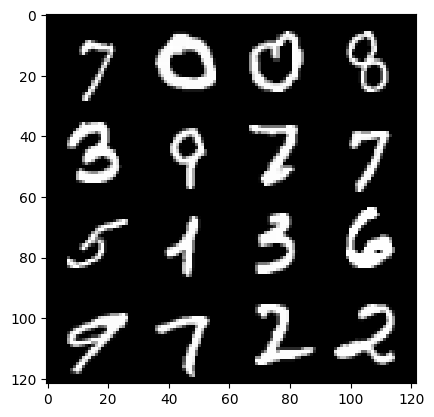

198: step 93300/ gen loss: 1.6091882880528772 / disc loss: 0.378909973402818


  0%|          | 0/469 [00:00<?, ?it/s]

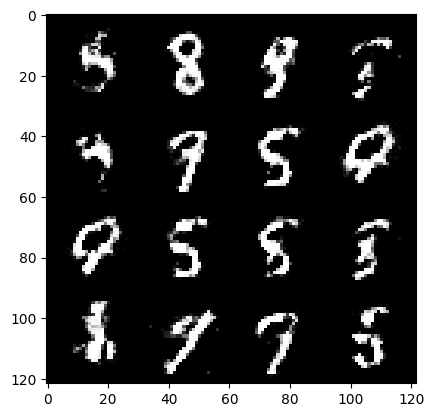

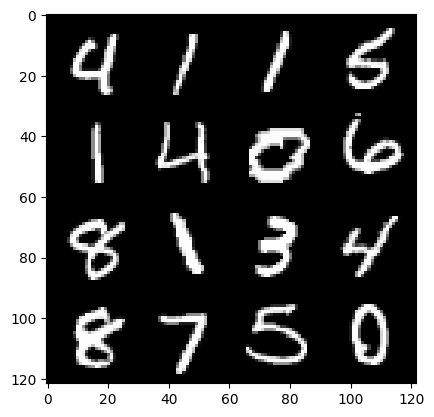

199: step 93600/ gen loss: 1.633718376557032 / disc loss: 0.37420159985621737


  0%|          | 0/469 [00:00<?, ?it/s]

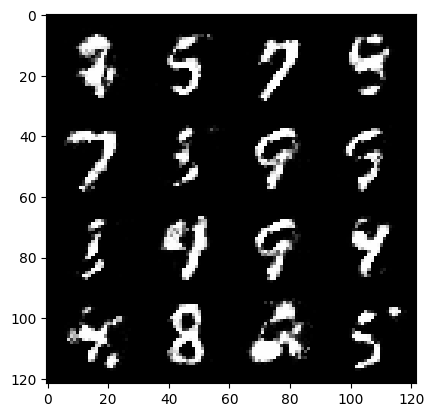

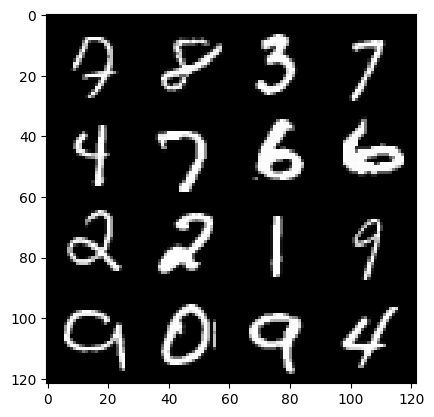

200: step 93900/ gen loss: 1.5999222687880192 / disc loss: 0.38762835681438434


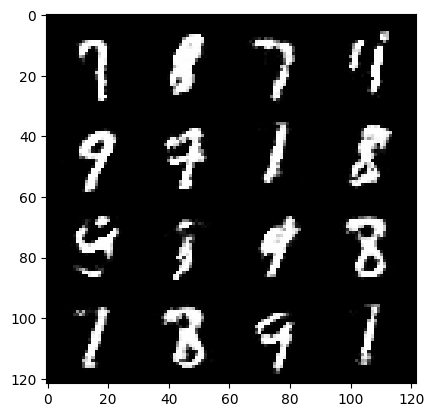

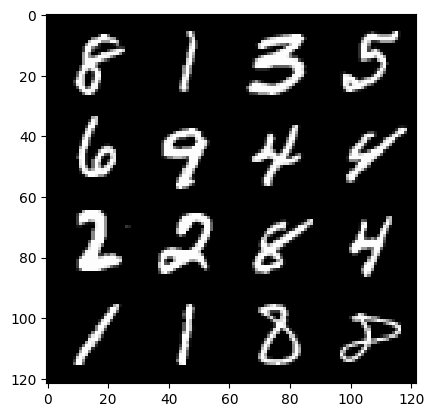

200: step 94200/ gen loss: 1.535272700786591 / disc loss: 0.4010319595535595


  0%|          | 0/469 [00:00<?, ?it/s]

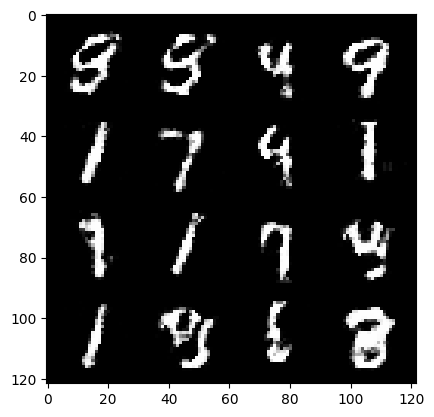

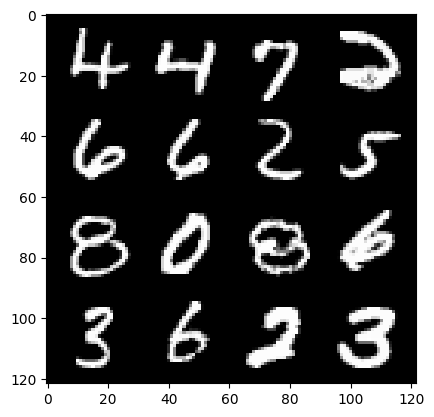

201: step 94500/ gen loss: 1.4969498757521316 / disc loss: 0.4134158668915429


  0%|          | 0/469 [00:00<?, ?it/s]

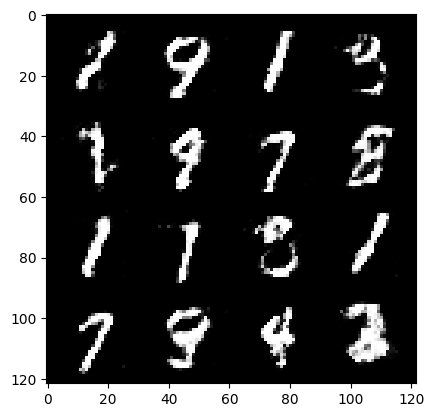

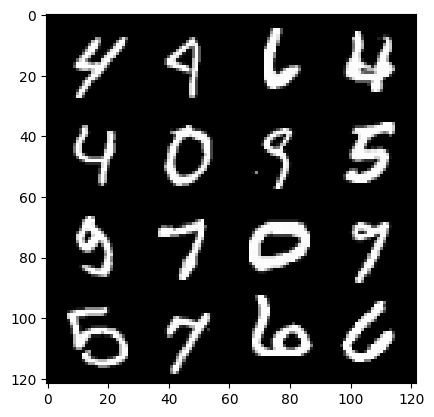

202: step 94800/ gen loss: 1.4542112219333656 / disc loss: 0.4175774539510409


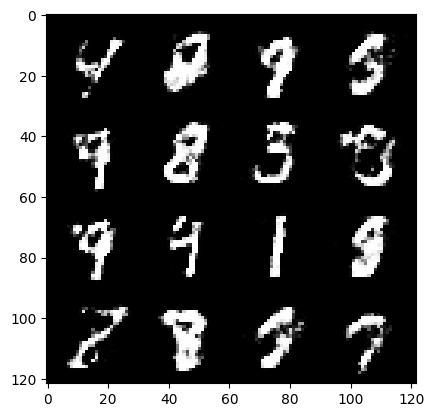

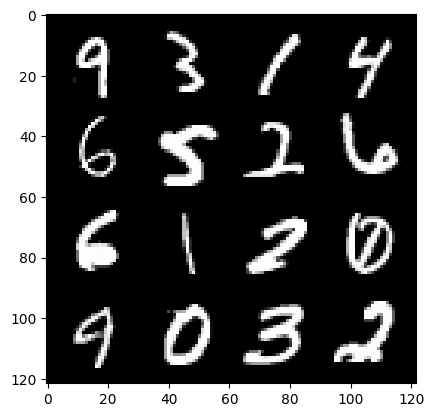

202: step 95100/ gen loss: 1.5014251689116156 / disc loss: 0.3995190636316935


  0%|          | 0/469 [00:00<?, ?it/s]

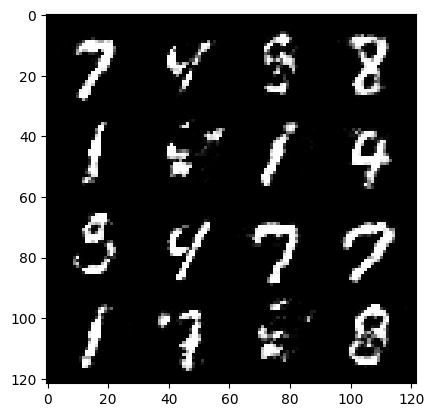

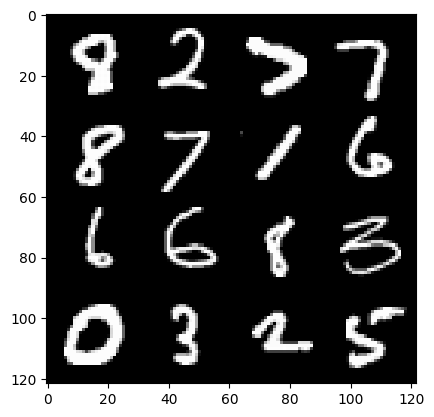

203: step 95400/ gen loss: 1.5420217255751303 / disc loss: 0.3981425186991694


  0%|          | 0/469 [00:00<?, ?it/s]

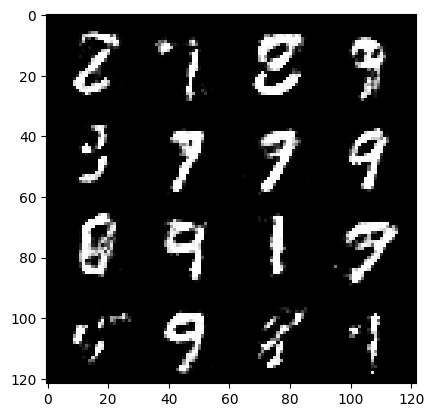

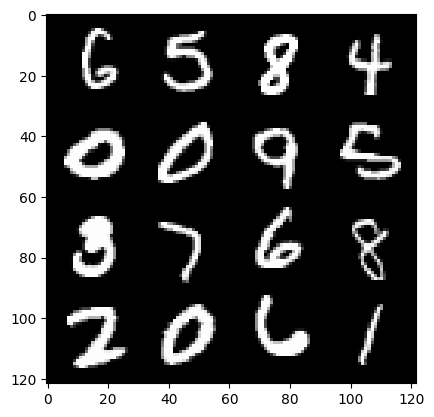

204: step 95700/ gen loss: 1.4573412350813533 / disc loss: 0.4198334403832753


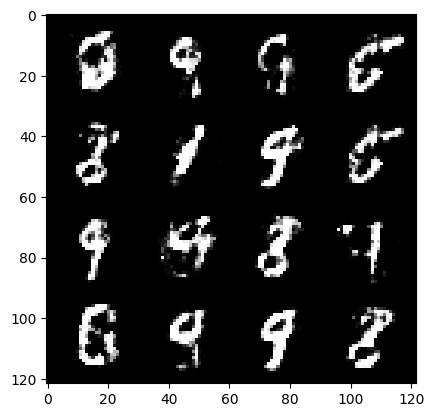

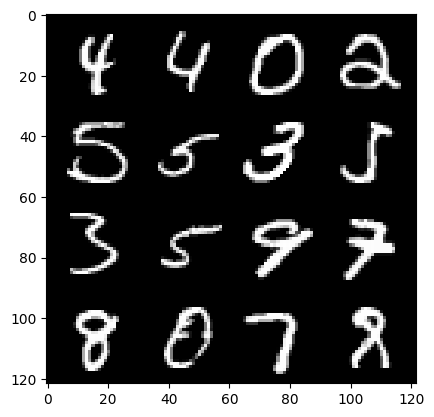

204: step 96000/ gen loss: 1.4665526354312894 / disc loss: 0.4162225541472437


  0%|          | 0/469 [00:00<?, ?it/s]

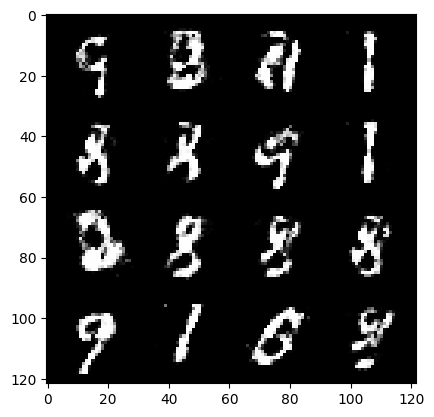

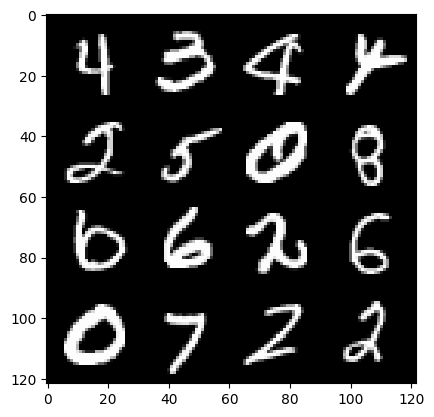

205: step 96300/ gen loss: 1.4836859496434527 / disc loss: 0.41257064759731293


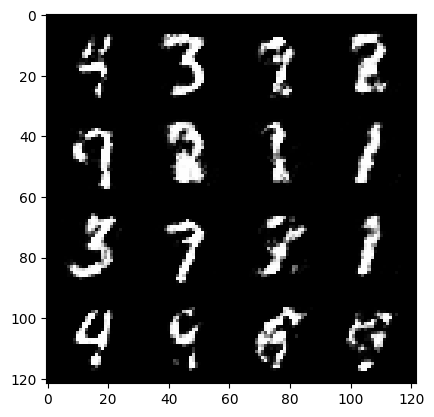

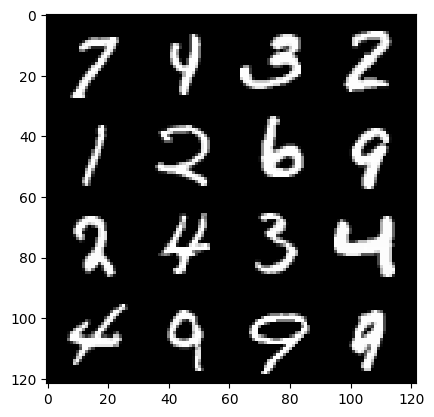

205: step 96600/ gen loss: 1.5114728315671289 / disc loss: 0.4075377622246744


  0%|          | 0/469 [00:00<?, ?it/s]

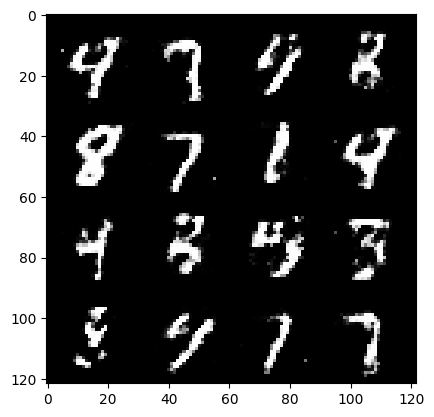

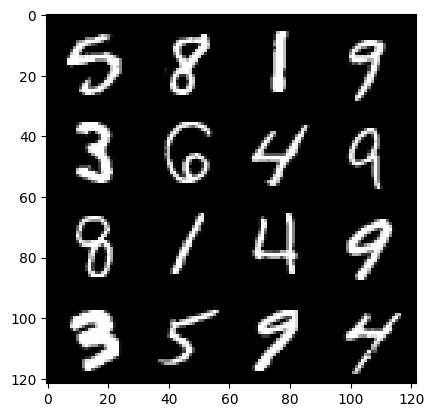

206: step 96900/ gen loss: 1.4410167781511944 / disc loss: 0.4217944340904553


  0%|          | 0/469 [00:00<?, ?it/s]

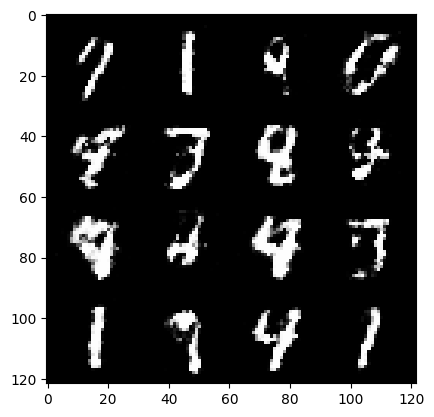

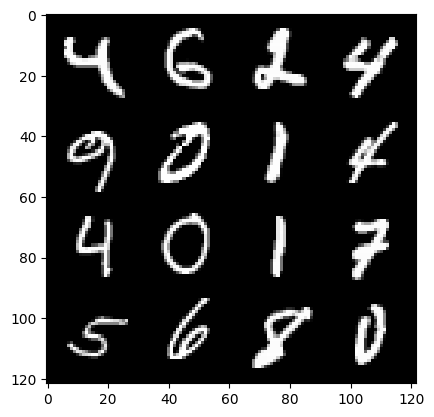

207: step 97200/ gen loss: 1.4080634025732672 / disc loss: 0.43201654046773896


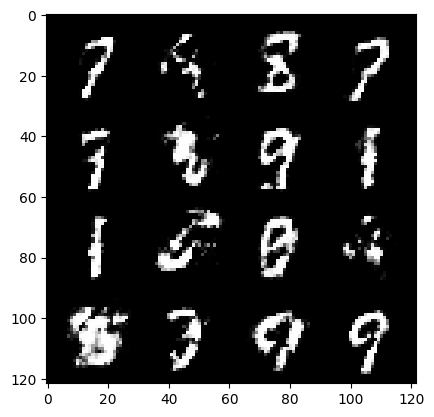

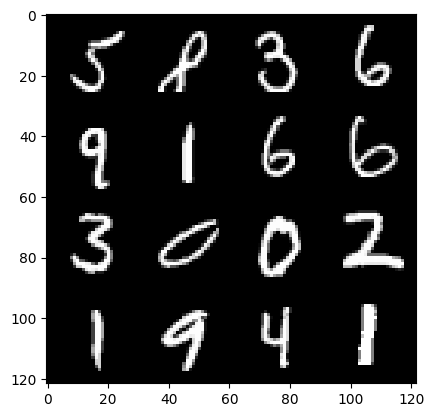

207: step 97500/ gen loss: 1.3568343281745914 / disc loss: 0.4474032997091609


  0%|          | 0/469 [00:00<?, ?it/s]

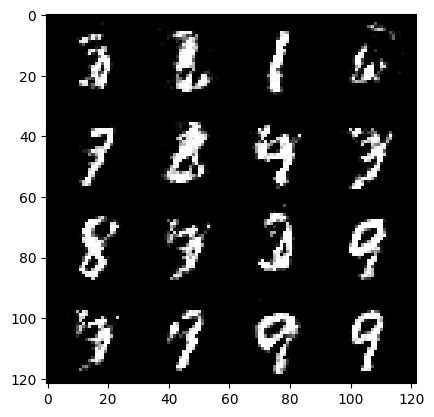

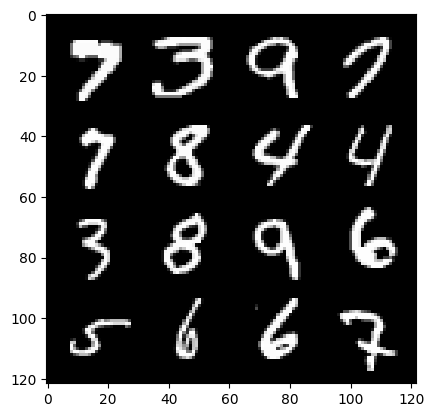

208: step 97800/ gen loss: 1.477080174684525 / disc loss: 0.400496643781662


  0%|          | 0/469 [00:00<?, ?it/s]

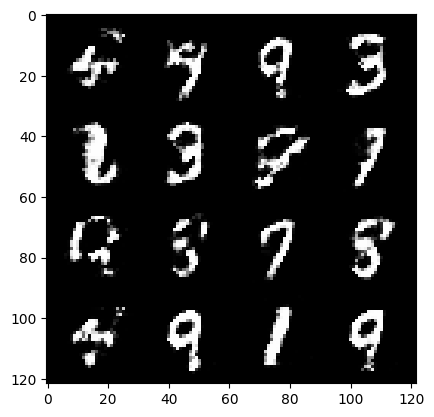

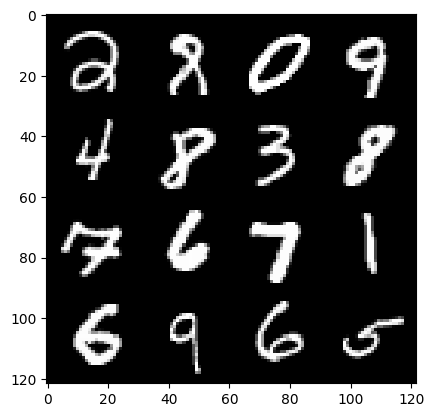

209: step 98100/ gen loss: 1.510692052443822 / disc loss: 0.4121301009257634


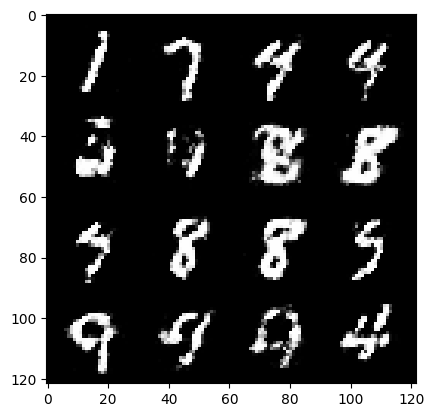

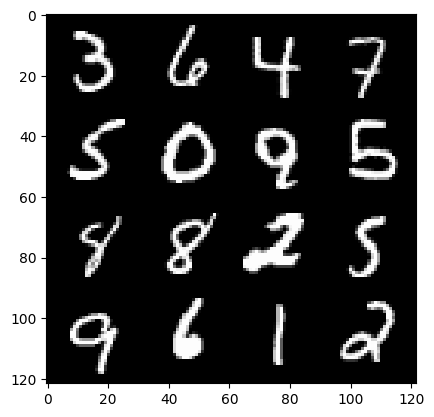

209: step 98400/ gen loss: 1.4186877743403126 / disc loss: 0.4229365824659666


  0%|          | 0/469 [00:00<?, ?it/s]

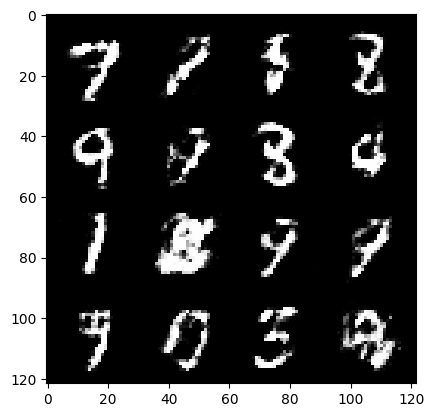

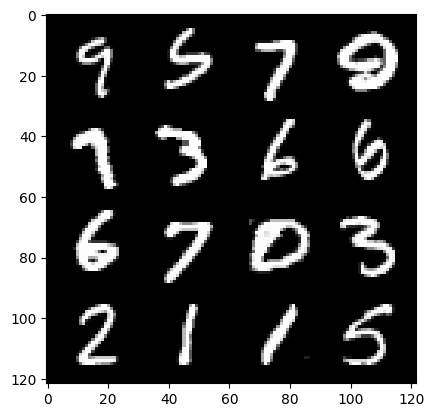

210: step 98700/ gen loss: 1.3816087365150442 / disc loss: 0.428639688094457


  0%|          | 0/469 [00:00<?, ?it/s]

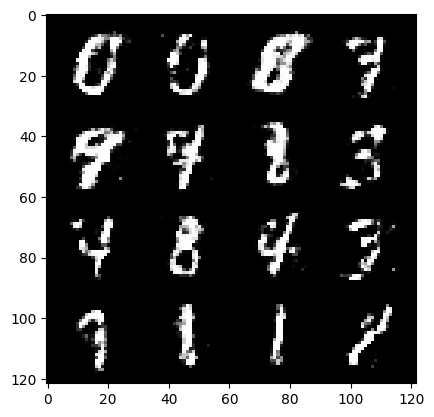

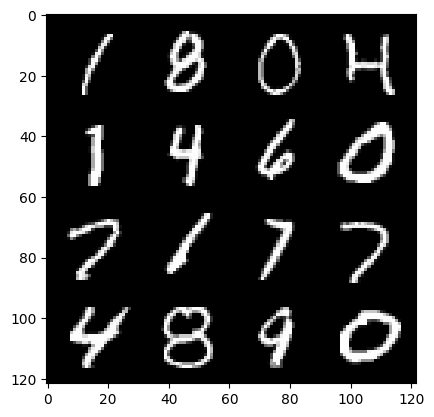

211: step 99000/ gen loss: 1.451925460100174 / disc loss: 0.4213452498118084


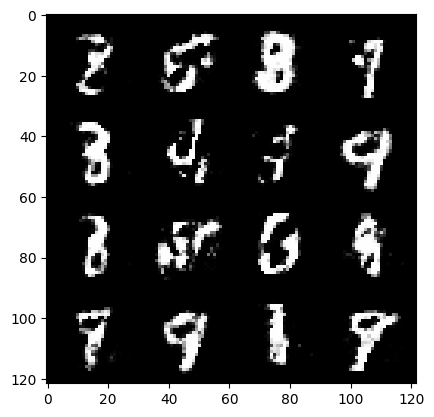

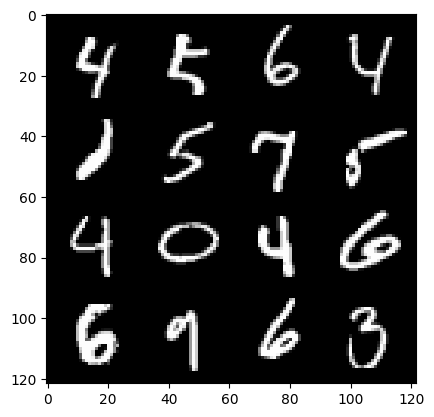

211: step 99300/ gen loss: 1.414221184253692 / disc loss: 0.4256111057599387


  0%|          | 0/469 [00:00<?, ?it/s]

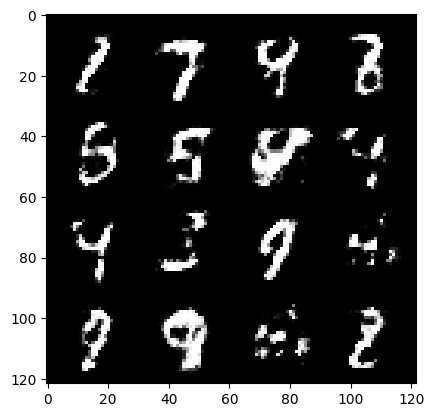

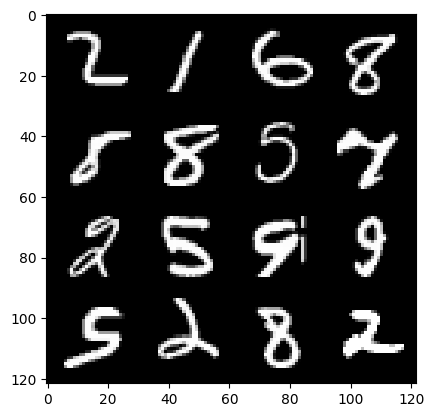

212: step 99600/ gen loss: 1.3646724013487501 / disc loss: 0.44285418361425394


  0%|          | 0/469 [00:00<?, ?it/s]

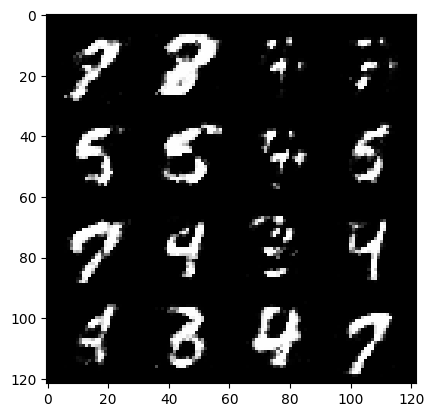

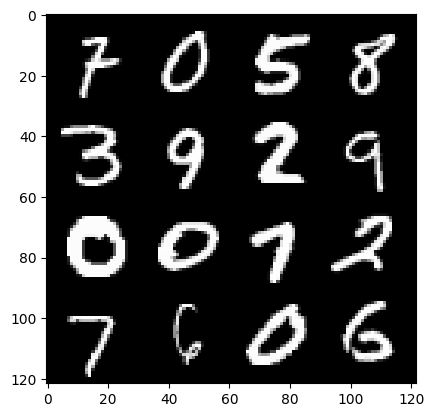

213: step 99900/ gen loss: 1.365821561415989 / disc loss: 0.43044972072045007


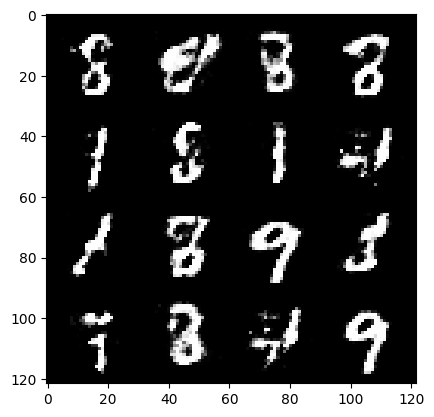

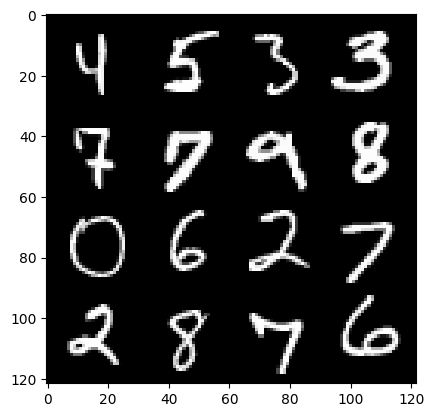

213: step 100200/ gen loss: 1.4150913989543907 / disc loss: 0.42771505276362093


  0%|          | 0/469 [00:00<?, ?it/s]

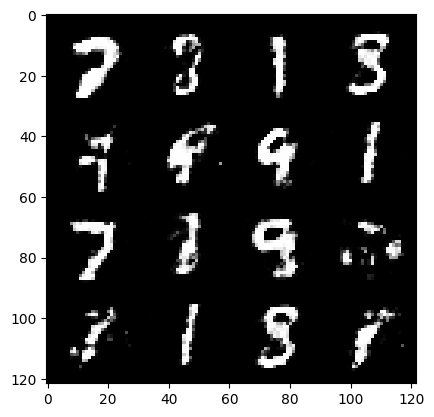

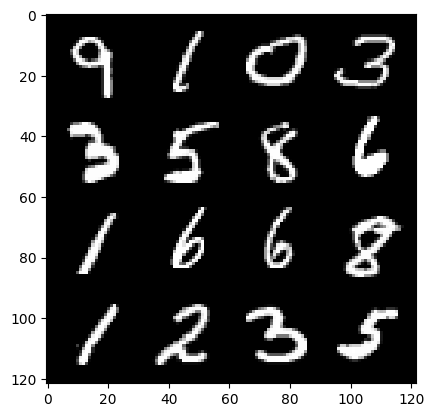

214: step 100500/ gen loss: 1.3823236354192103 / disc loss: 0.44433513899644206


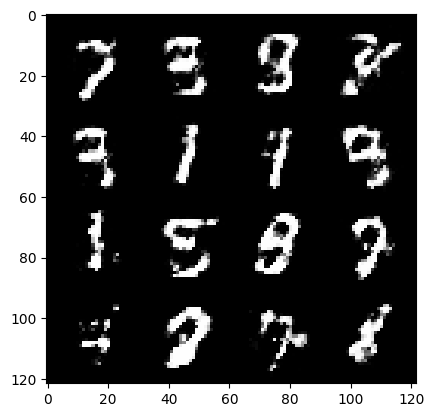

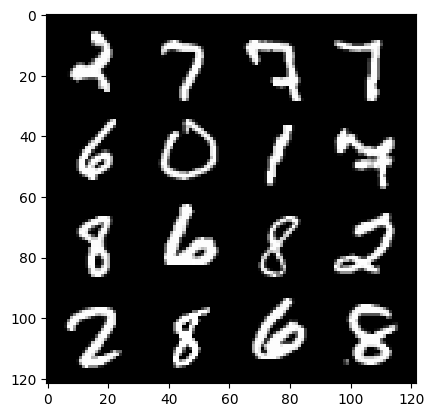

214: step 100800/ gen loss: 1.505370856126149 / disc loss: 0.3885620631774268


  0%|          | 0/469 [00:00<?, ?it/s]

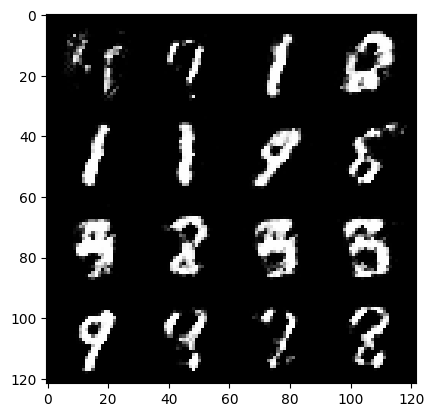

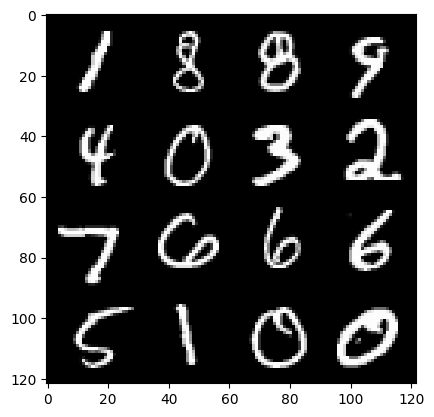

215: step 101100/ gen loss: 1.4578903500239058 / disc loss: 0.4132908885677656


  0%|          | 0/469 [00:00<?, ?it/s]

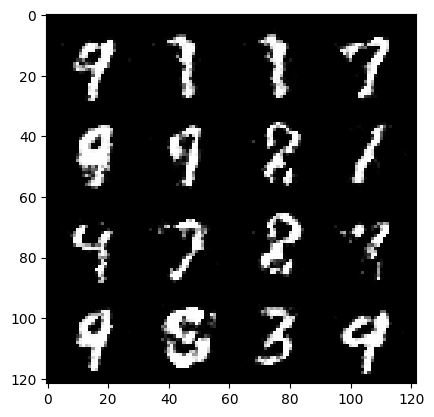

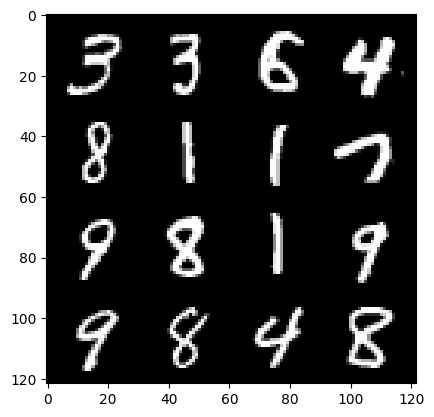

216: step 101400/ gen loss: 1.3700677577654516 / disc loss: 0.4340288197000817


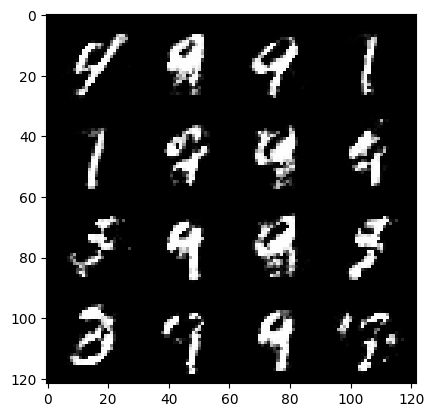

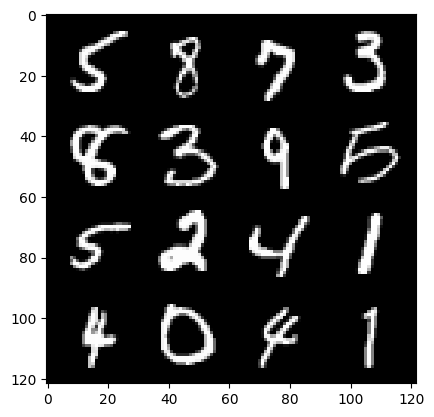

216: step 101700/ gen loss: 1.390715023279189 / disc loss: 0.42817848702271744


  0%|          | 0/469 [00:00<?, ?it/s]

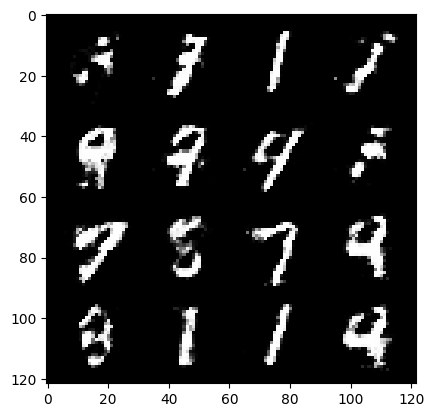

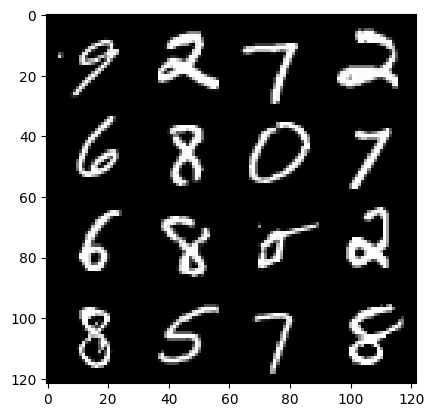

217: step 102000/ gen loss: 1.4311951247851058 / disc loss: 0.41235480566819493


  0%|          | 0/469 [00:00<?, ?it/s]

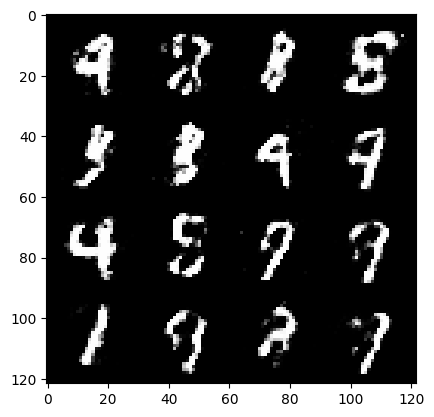

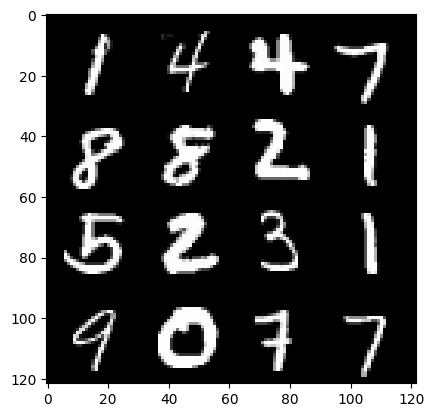

218: step 102300/ gen loss: 1.488761280377705 / disc loss: 0.40534135033686963


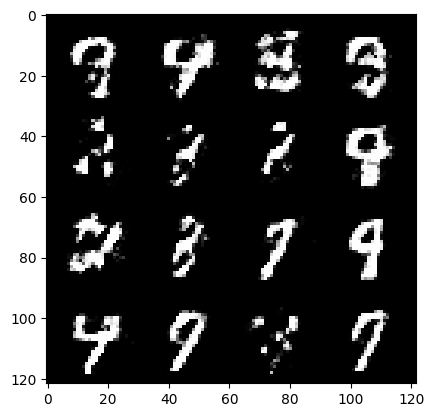

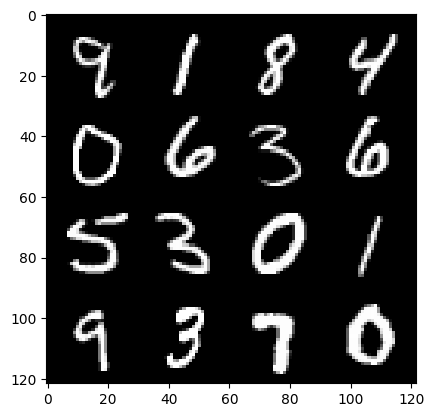

218: step 102600/ gen loss: 1.5023724734783155 / disc loss: 0.4041330908735591


  0%|          | 0/469 [00:00<?, ?it/s]

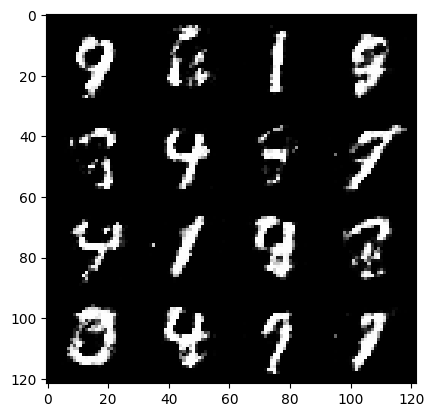

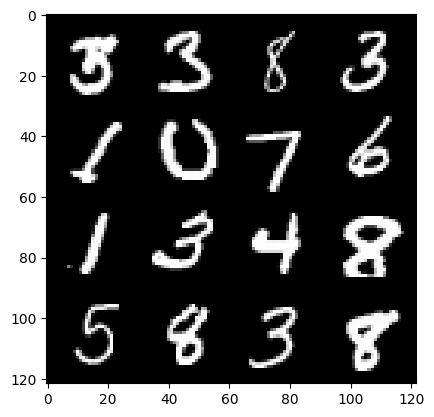

219: step 102900/ gen loss: 1.4606914412975316 / disc loss: 0.4126353733738264


  0%|          | 0/469 [00:00<?, ?it/s]

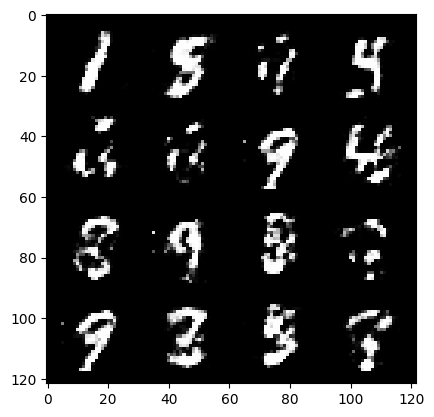

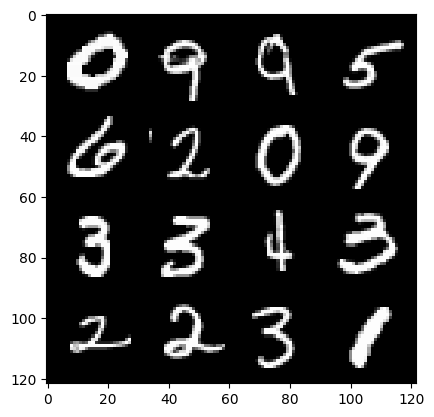

220: step 103200/ gen loss: 1.4465875573952989 / disc loss: 0.4123636387785275


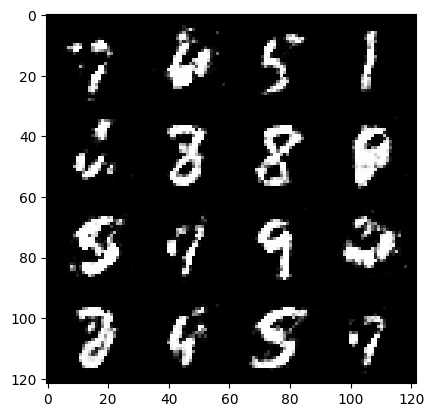

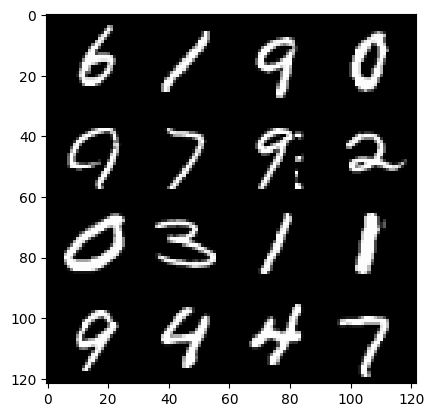

220: step 103500/ gen loss: 1.4204636116822567 / disc loss: 0.418718787332376


  0%|          | 0/469 [00:00<?, ?it/s]

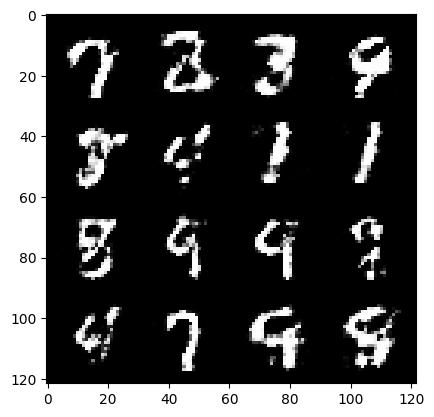

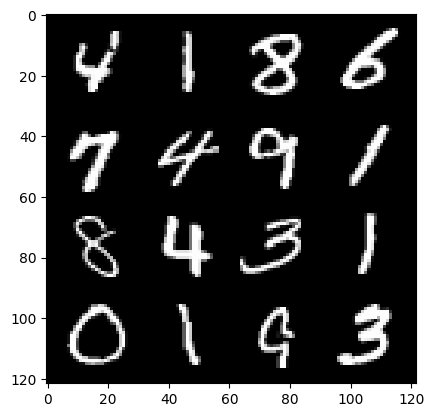

221: step 103800/ gen loss: 1.3791313389937083 / disc loss: 0.4363872652252515


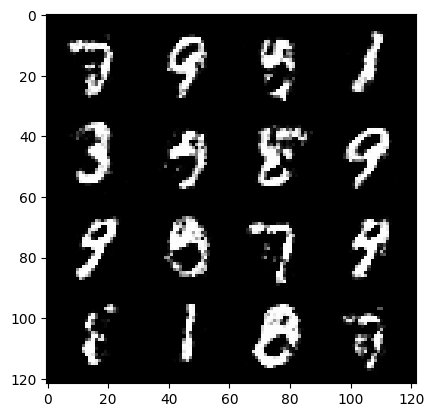

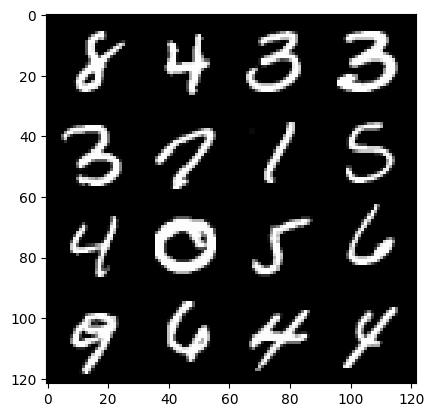

221: step 104100/ gen loss: 1.3945308538277943 / disc loss: 0.43001767486333825


  0%|          | 0/469 [00:00<?, ?it/s]

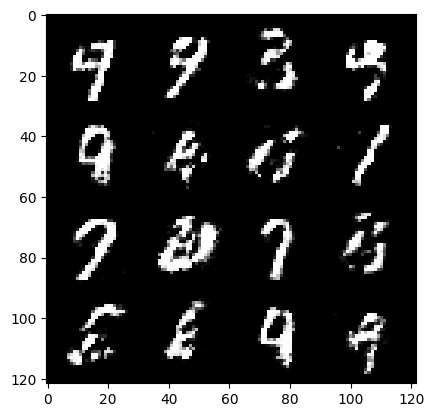

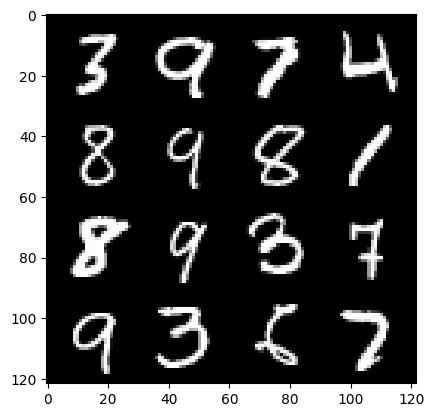

222: step 104400/ gen loss: 1.4216610236962628 / disc loss: 0.42000834484895067


  0%|          | 0/469 [00:00<?, ?it/s]

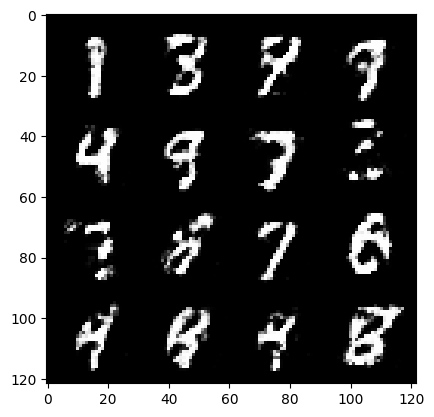

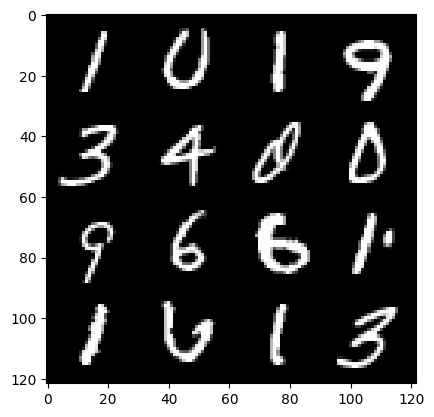

223: step 104700/ gen loss: 1.3397437425454446 / disc loss: 0.44784527172644933


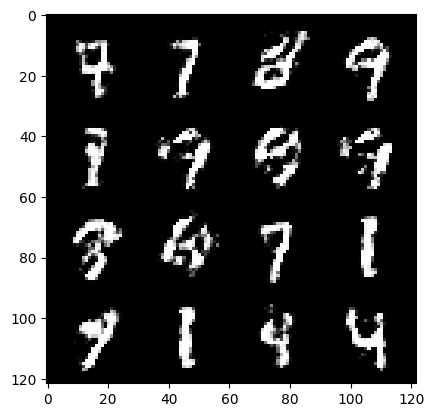

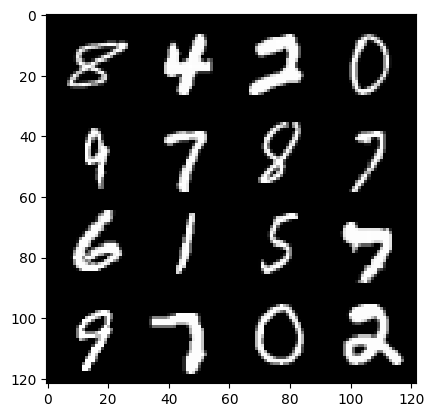

223: step 105000/ gen loss: 1.3930559043089548 / disc loss: 0.4351241602500279


  0%|          | 0/469 [00:00<?, ?it/s]

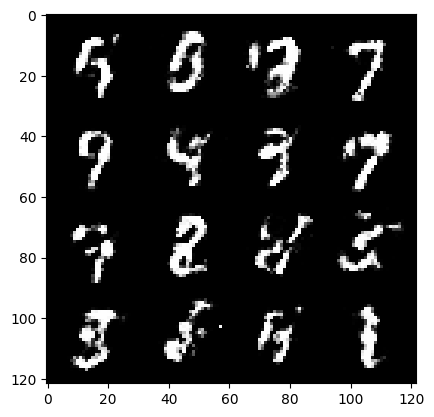

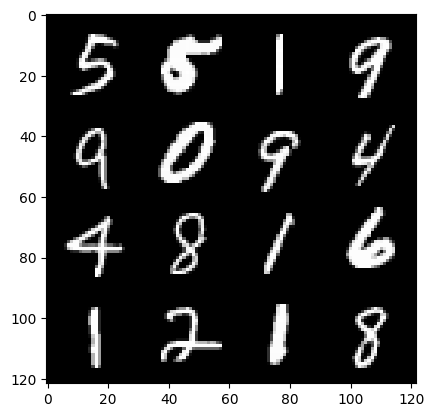

224: step 105300/ gen loss: 1.4954743882020305 / disc loss: 0.40708696037530917


  0%|          | 0/469 [00:00<?, ?it/s]

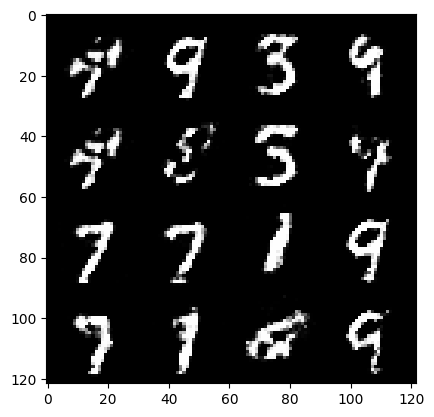

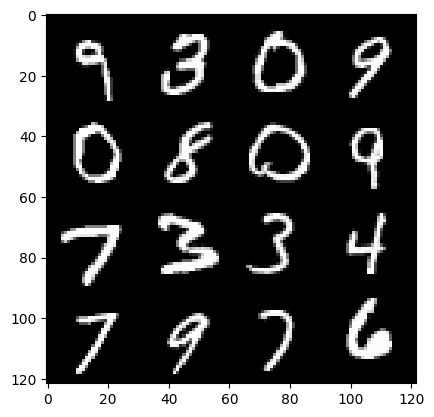

225: step 105600/ gen loss: 1.4098910788695016 / disc loss: 0.42706114689509084


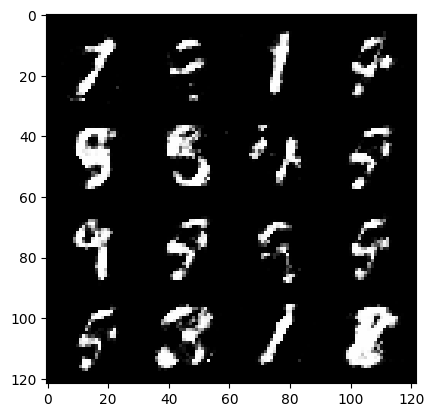

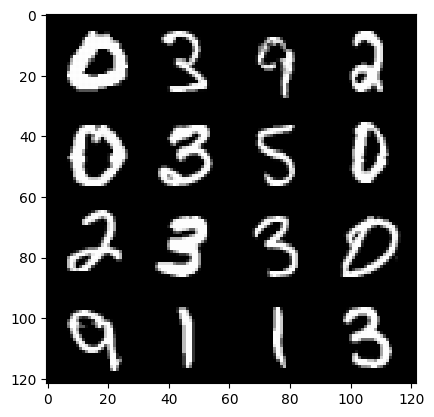

225: step 105900/ gen loss: 1.408217581907908 / disc loss: 0.4261358100175855


  0%|          | 0/469 [00:00<?, ?it/s]

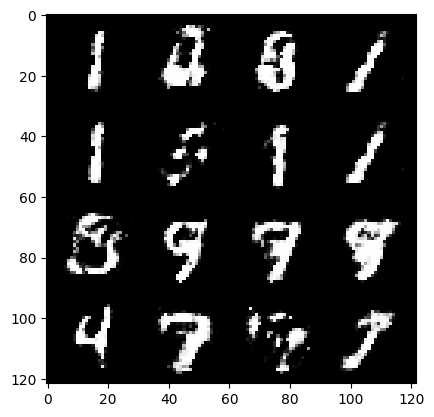

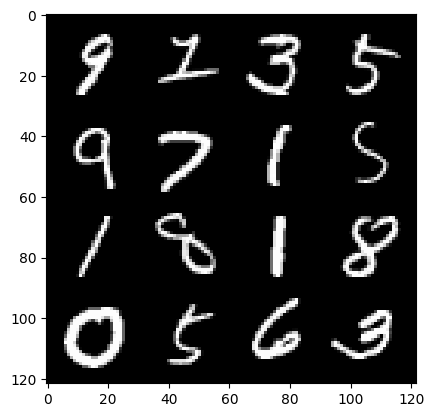

226: step 106200/ gen loss: 1.3744966789086654 / disc loss: 0.4224355192979175


  0%|          | 0/469 [00:00<?, ?it/s]

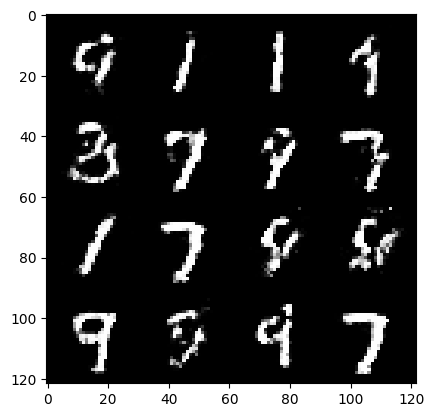

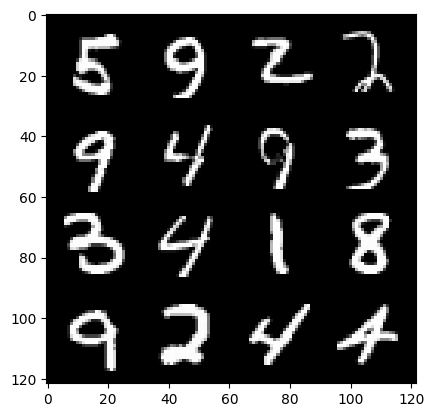

227: step 106500/ gen loss: 1.4284861310323074 / disc loss: 0.41161572376886996


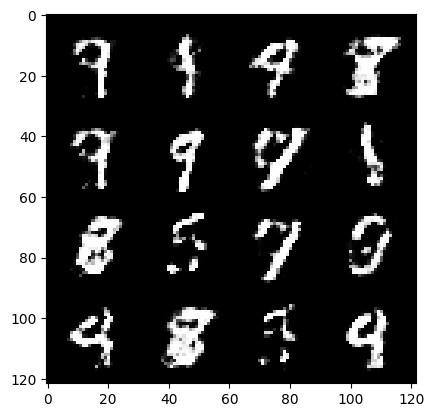

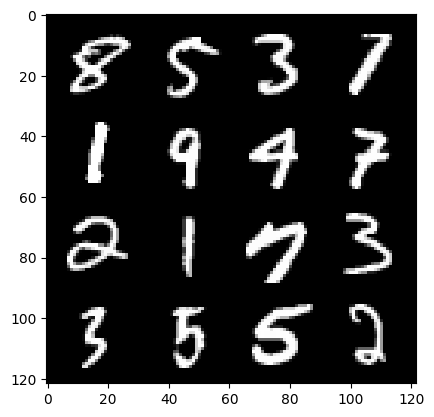

227: step 106800/ gen loss: 1.4277553248405448 / disc loss: 0.41658742090066286


  0%|          | 0/469 [00:00<?, ?it/s]

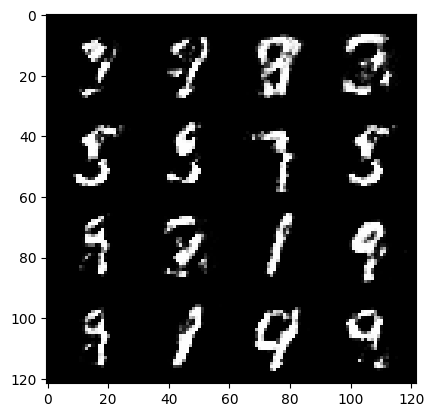

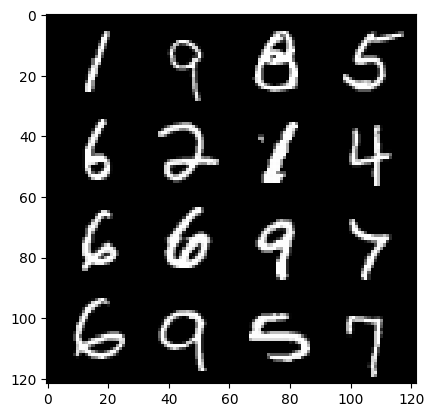

228: step 107100/ gen loss: 1.420241511662801 / disc loss: 0.4173945768674214


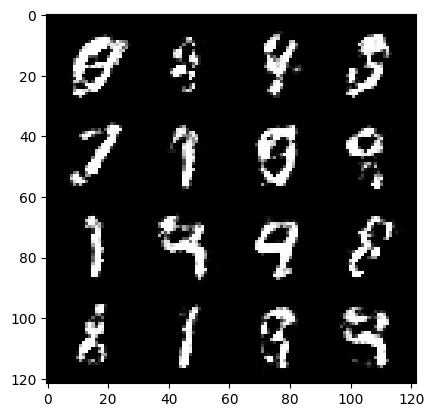

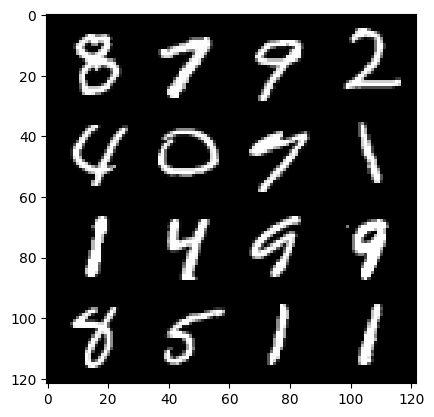

228: step 107400/ gen loss: 1.4169427041212717 / disc loss: 0.4201289274295172


  0%|          | 0/469 [00:00<?, ?it/s]

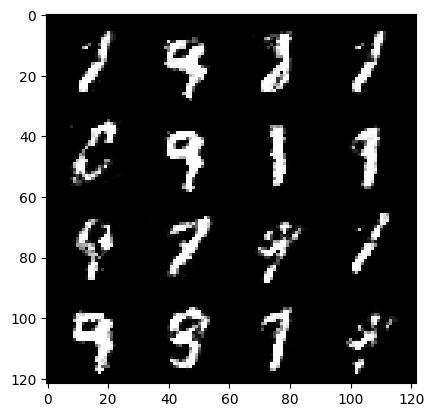

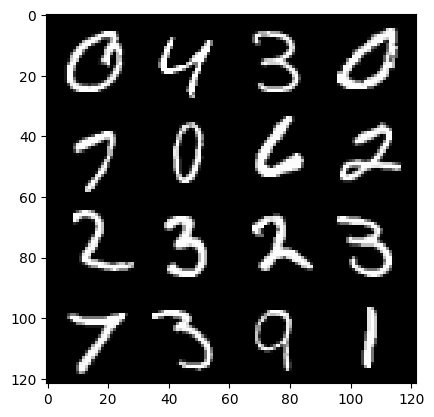

229: step 107700/ gen loss: 1.4264838210741673 / disc loss: 0.41933708935976033


  0%|          | 0/469 [00:00<?, ?it/s]

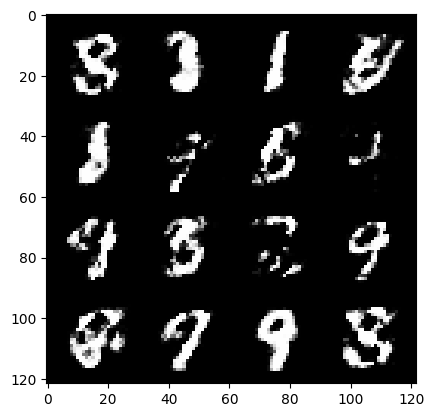

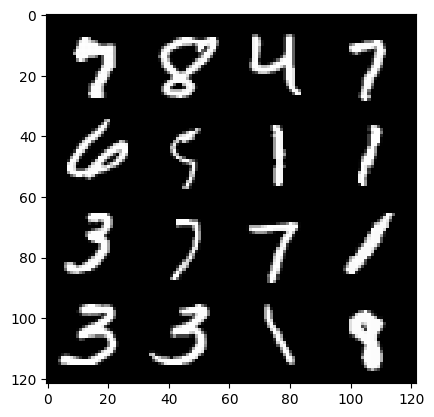

230: step 108000/ gen loss: 1.4251285250981645 / disc loss: 0.41968026638031


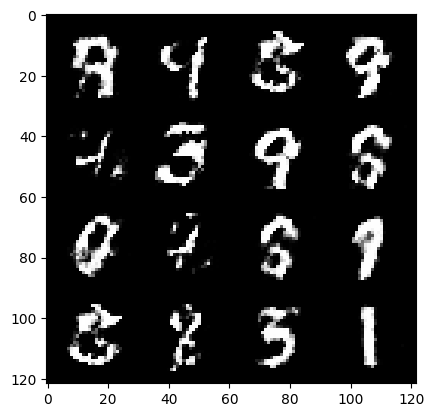

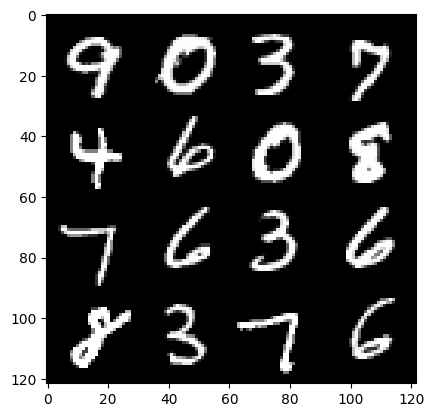

230: step 108300/ gen loss: 1.383520328203837 / disc loss: 0.4322785790761313


  0%|          | 0/469 [00:00<?, ?it/s]

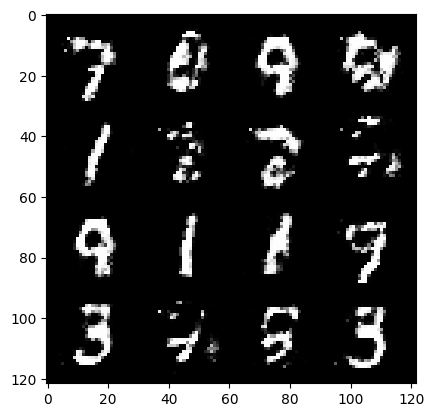

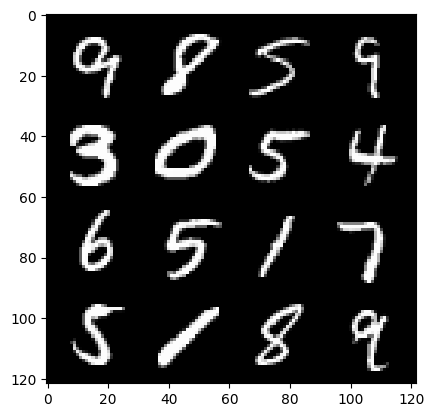

231: step 108600/ gen loss: 1.3742882144451145 / disc loss: 0.43347944448391607


  0%|          | 0/469 [00:00<?, ?it/s]

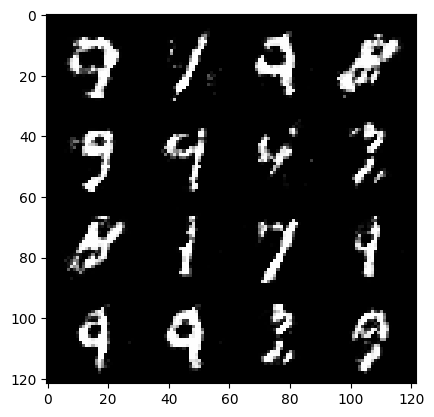

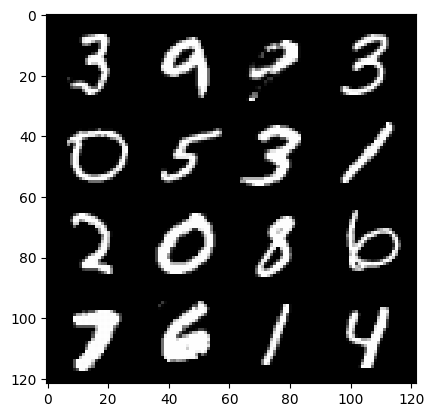

232: step 108900/ gen loss: 1.4050420880317687 / disc loss: 0.4227028779188791


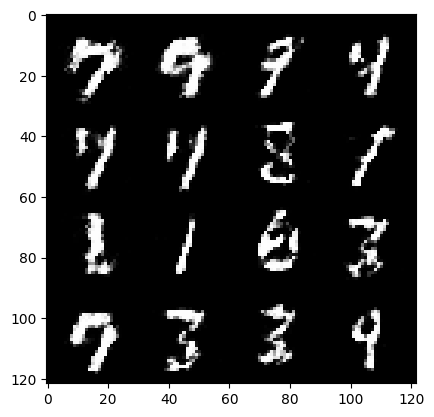

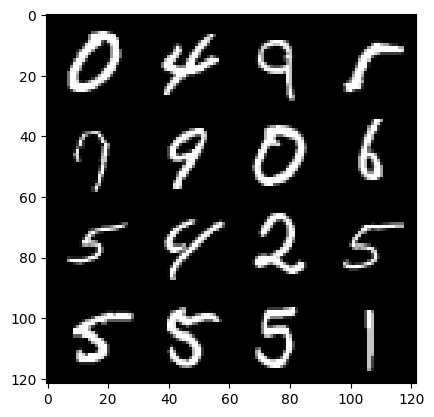

232: step 109200/ gen loss: 1.4417348714669542 / disc loss: 0.41862296005090105


  0%|          | 0/469 [00:00<?, ?it/s]

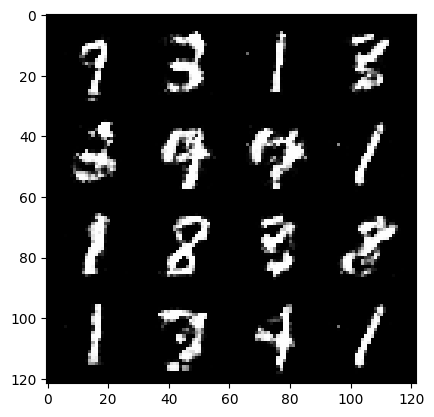

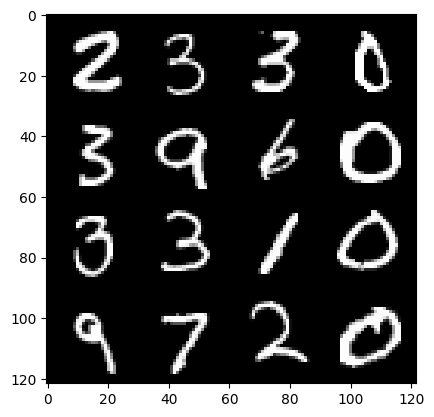

233: step 109500/ gen loss: 1.4143436654408772 / disc loss: 0.4230274793505671


  0%|          | 0/469 [00:00<?, ?it/s]

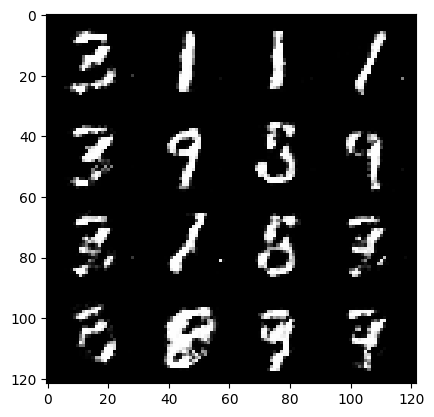

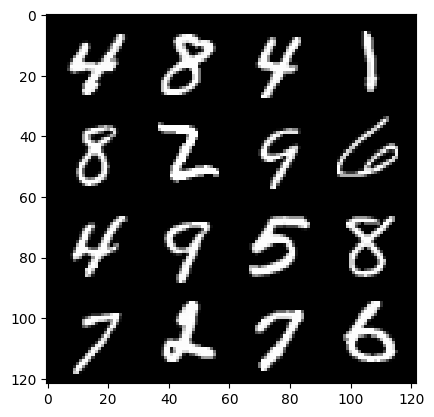

234: step 109800/ gen loss: 1.3466595415274292 / disc loss: 0.443750520348549


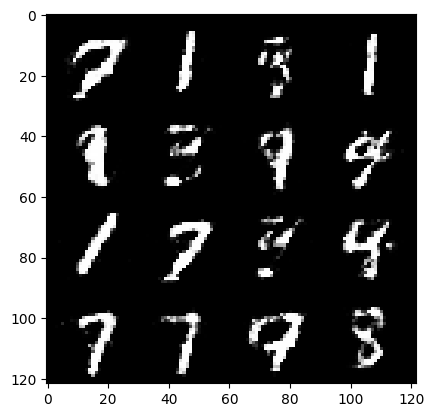

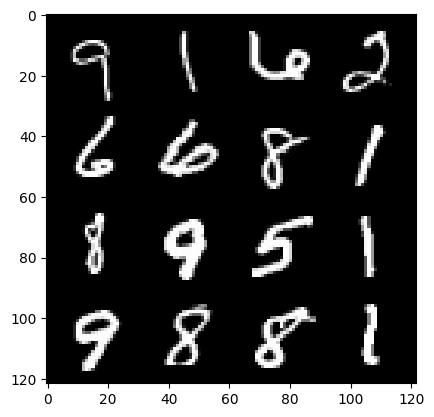

234: step 110100/ gen loss: 1.285553229252497 / disc loss: 0.45402814696232496


  0%|          | 0/469 [00:00<?, ?it/s]

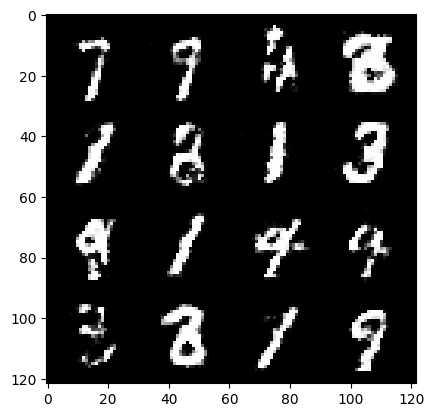

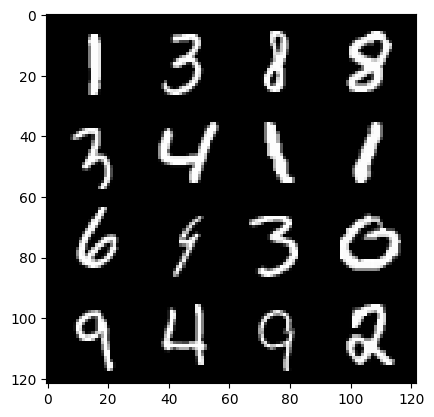

235: step 110400/ gen loss: 1.3562248520056397 / disc loss: 0.43108413348595304


  0%|          | 0/469 [00:00<?, ?it/s]

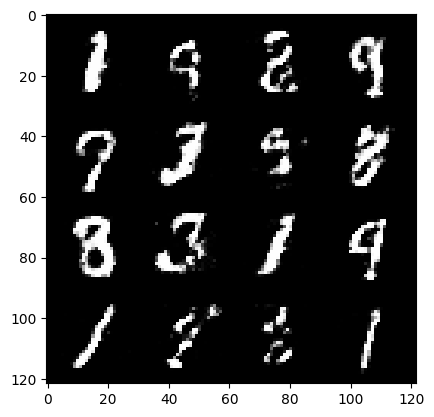

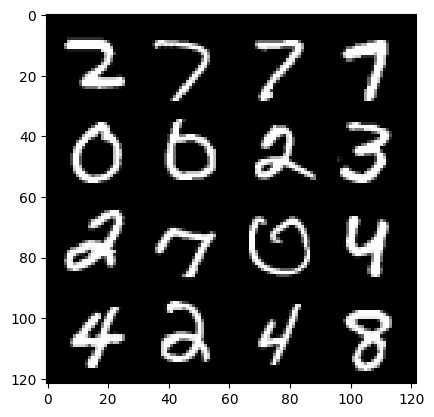

236: step 110700/ gen loss: 1.2874112931887316 / disc loss: 0.44450302322705587


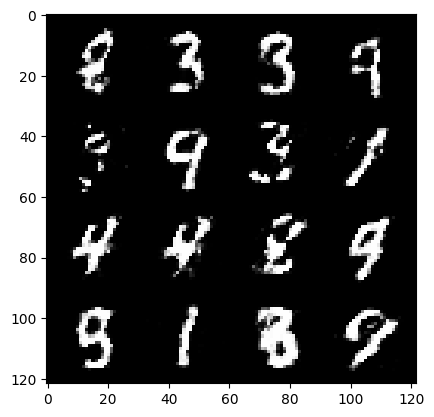

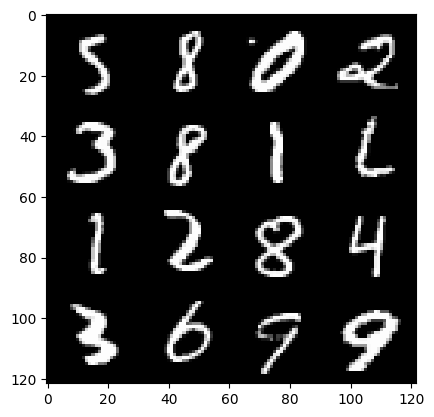

236: step 111000/ gen loss: 1.316085971196492 / disc loss: 0.43642799665530535


  0%|          | 0/469 [00:00<?, ?it/s]

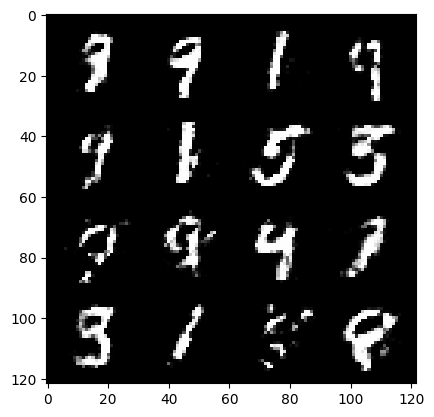

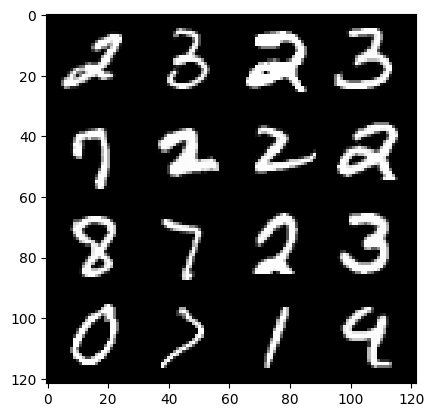

237: step 111300/ gen loss: 1.3015484277407332 / disc loss: 0.447134895424048


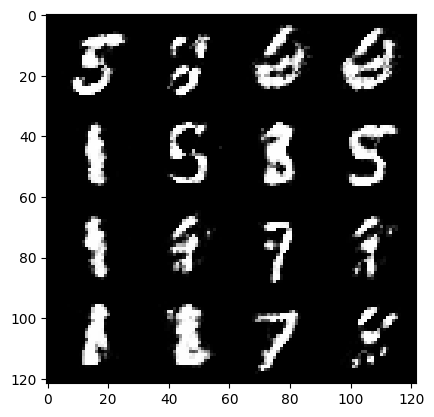

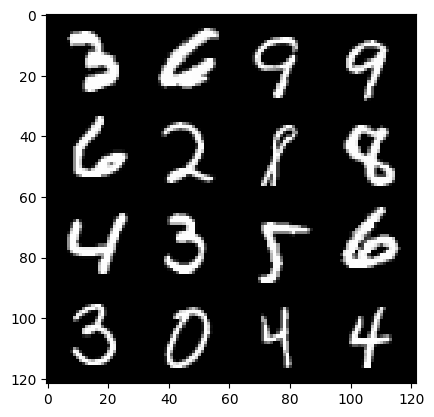

237: step 111600/ gen loss: 1.3345701003074655 / disc loss: 0.4401856858531636


  0%|          | 0/469 [00:00<?, ?it/s]

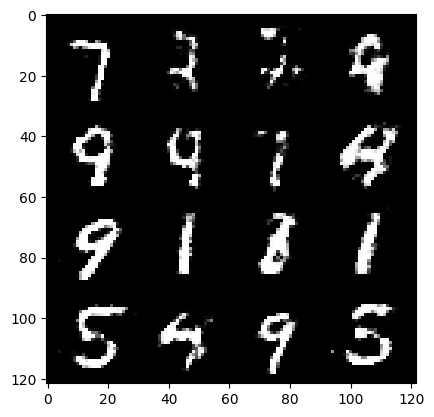

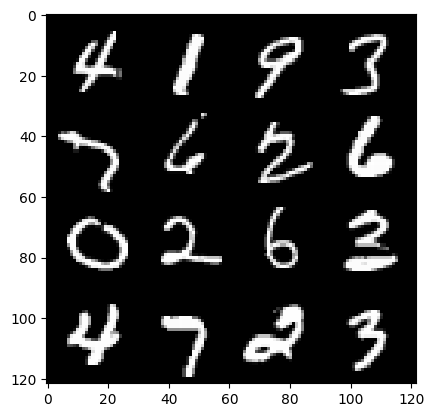

238: step 111900/ gen loss: 1.309849158525468 / disc loss: 0.45284867674112317


  0%|          | 0/469 [00:00<?, ?it/s]

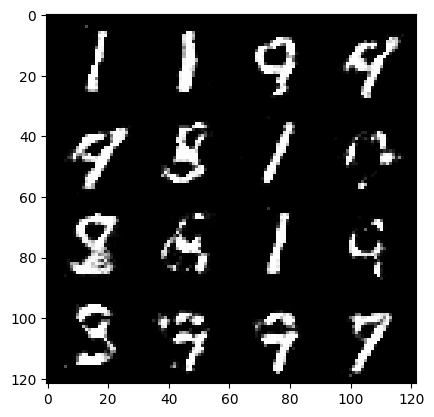

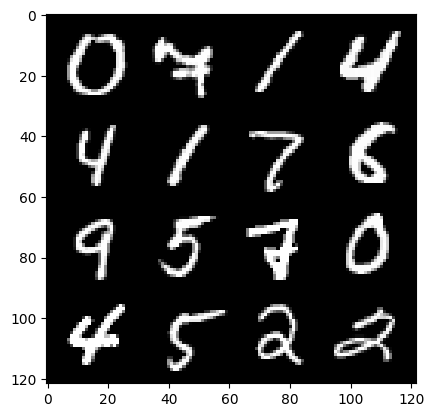

239: step 112200/ gen loss: 1.2597442042827613 / disc loss: 0.4688059832652407


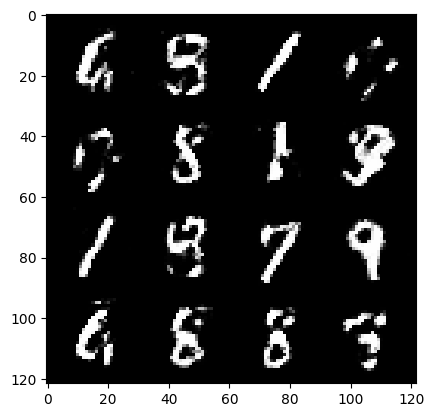

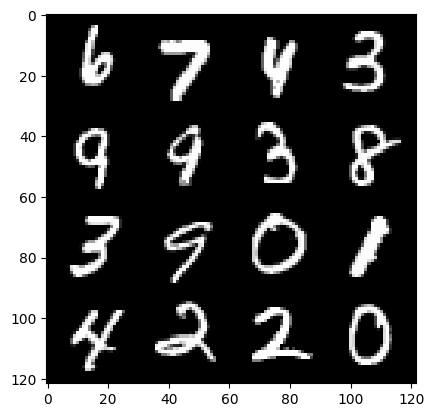

239: step 112500/ gen loss: 1.2610531985759728 / disc loss: 0.4622248442967735


  0%|          | 0/469 [00:00<?, ?it/s]

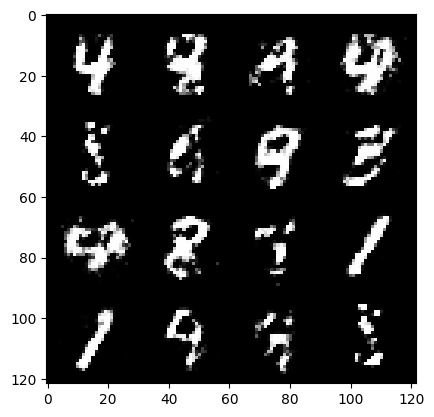

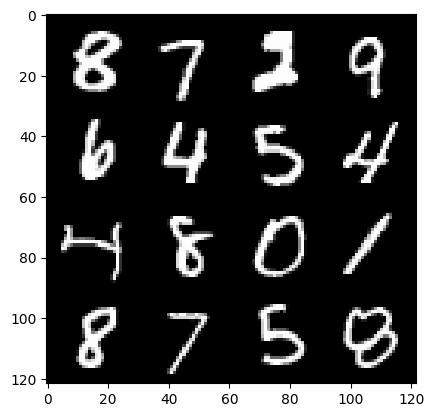

240: step 112800/ gen loss: 1.2398454236984255 / disc loss: 0.45800179749727254


  0%|          | 0/469 [00:00<?, ?it/s]

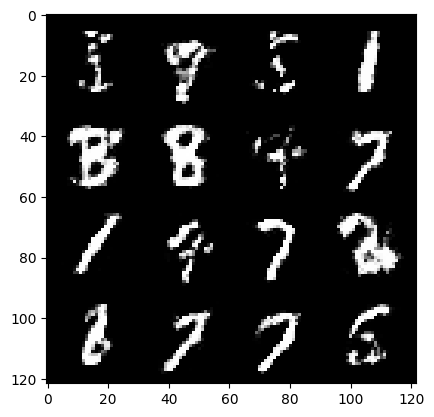

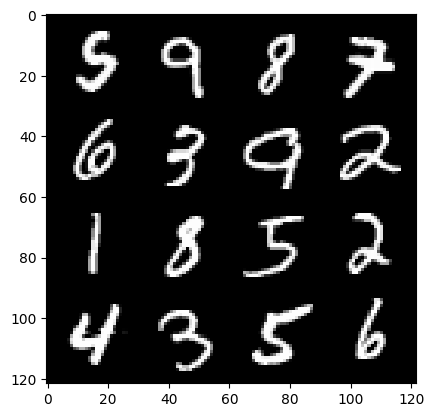

241: step 113100/ gen loss: 1.33935680349668 / disc loss: 0.4369419127702712


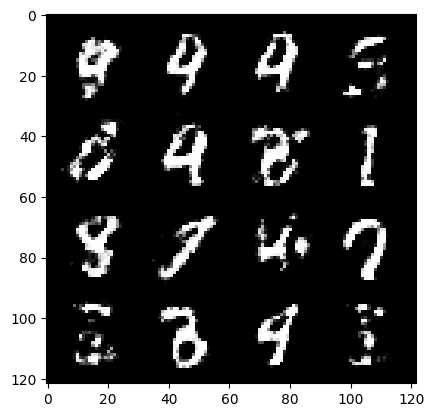

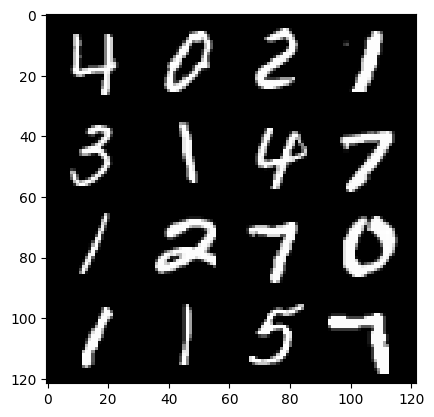

241: step 113400/ gen loss: 1.281976738770802 / disc loss: 0.46302755296230313


  0%|          | 0/469 [00:00<?, ?it/s]

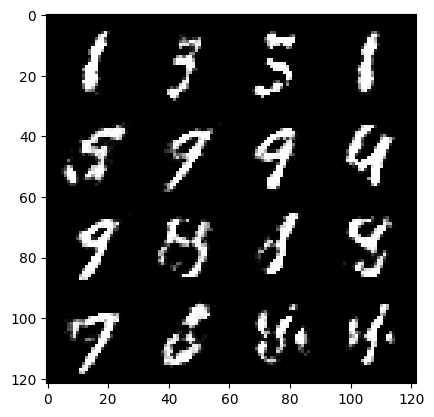

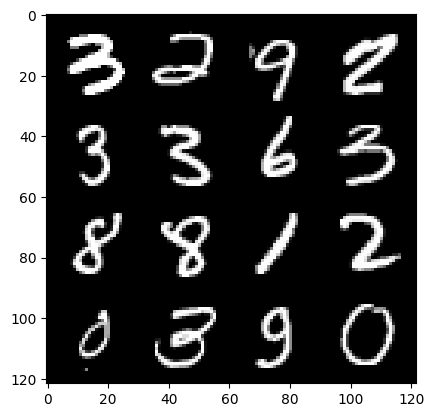

242: step 113700/ gen loss: 1.2425614130496982 / disc loss: 0.4703057492772737


  0%|          | 0/469 [00:00<?, ?it/s]

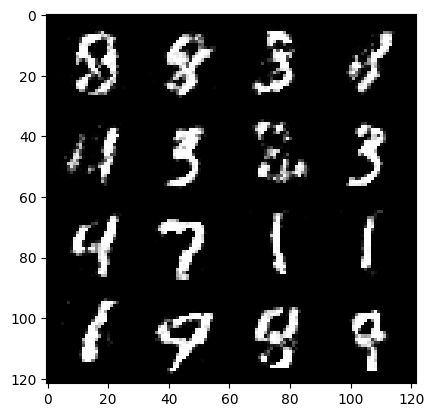

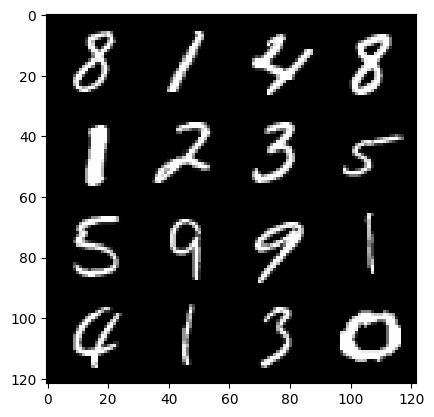

243: step 114000/ gen loss: 1.3027480725447342 / disc loss: 0.4604896184802054


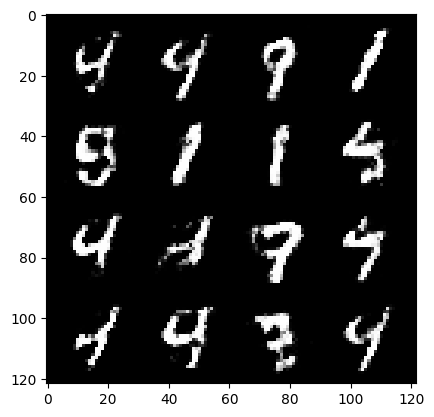

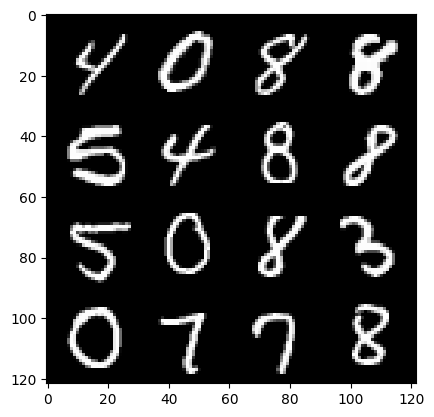

243: step 114300/ gen loss: 1.2003462660312656 / disc loss: 0.48754102498292895


  0%|          | 0/469 [00:00<?, ?it/s]

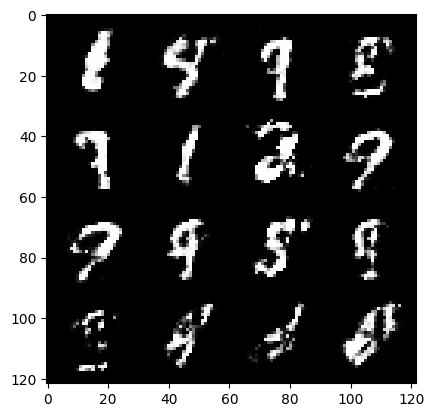

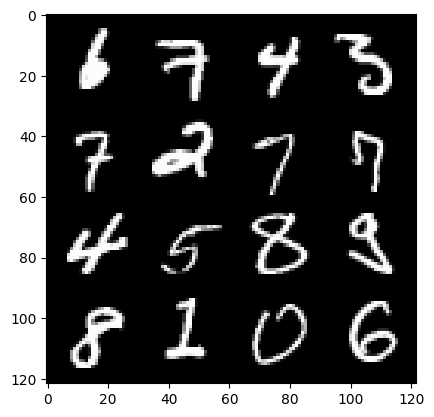

244: step 114600/ gen loss: 1.153892441193263 / disc loss: 0.5004373243451115


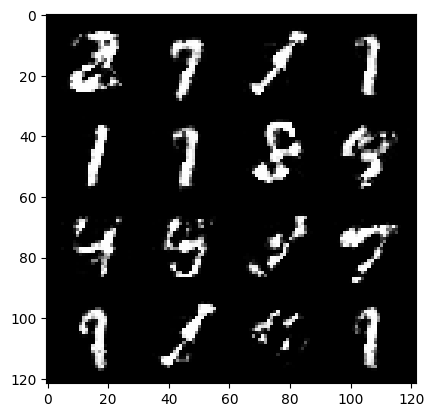

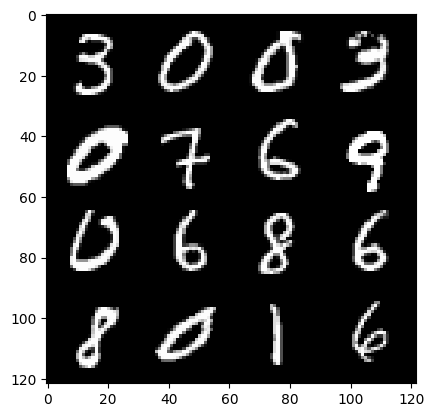

244: step 114900/ gen loss: 1.1886851644516 / disc loss: 0.4834216008583708


  0%|          | 0/469 [00:00<?, ?it/s]

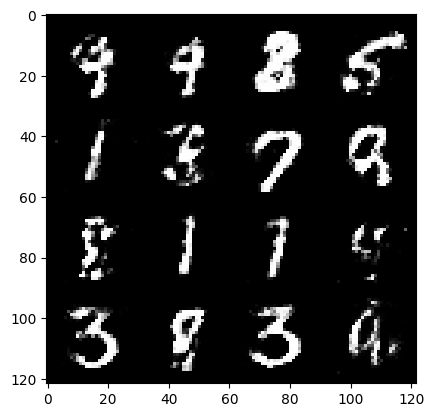

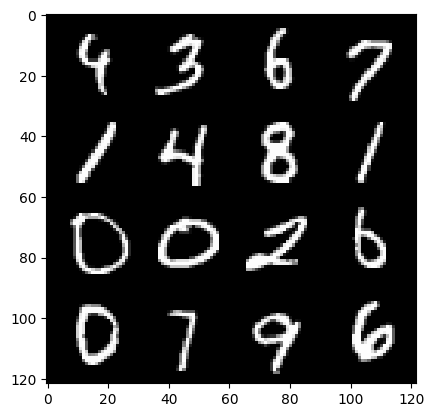

245: step 115200/ gen loss: 1.2389266435305288 / disc loss: 0.46960713158051204


  0%|          | 0/469 [00:00<?, ?it/s]

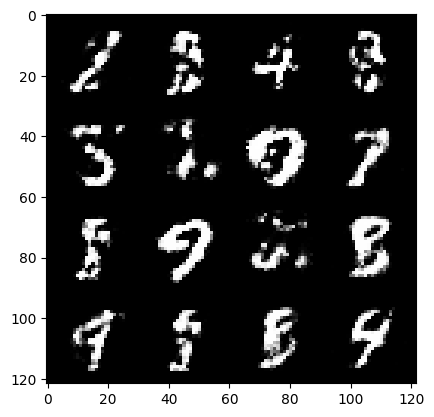

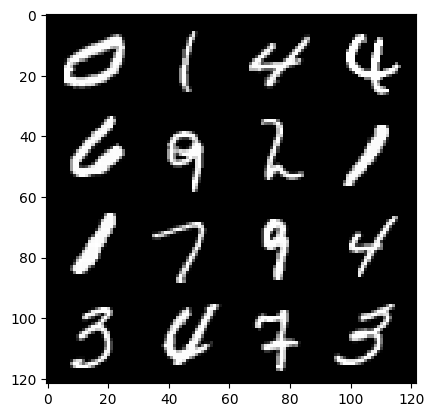

246: step 115500/ gen loss: 1.2374625857671107 / disc loss: 0.460987380047639


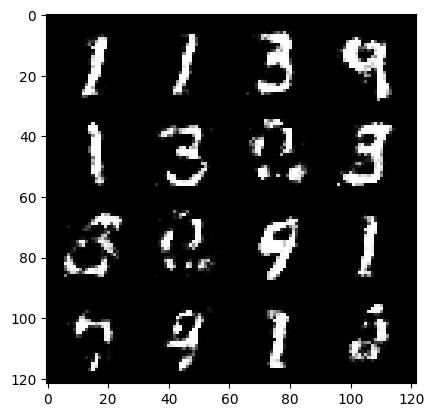

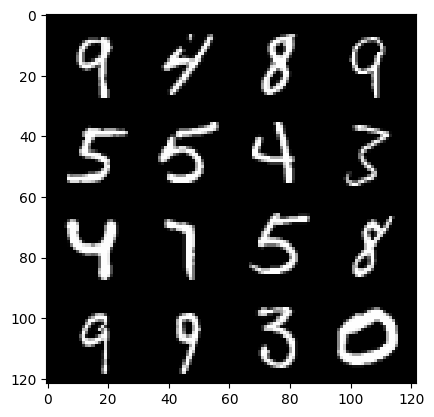

246: step 115800/ gen loss: 1.2451505978902178 / disc loss: 0.46745022575060546


  0%|          | 0/469 [00:00<?, ?it/s]

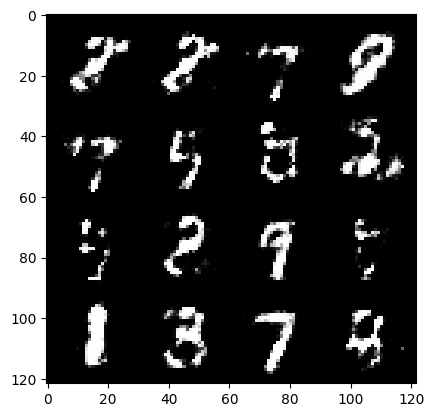

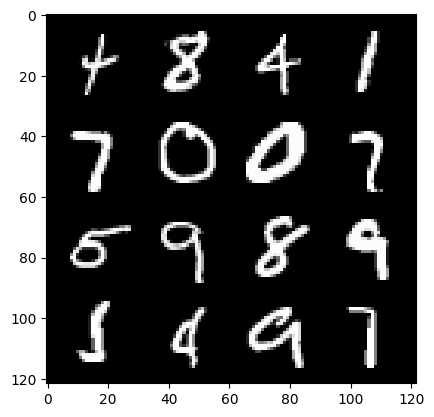

247: step 116100/ gen loss: 1.302390609184901 / disc loss: 0.4465077660481137


  0%|          | 0/469 [00:00<?, ?it/s]

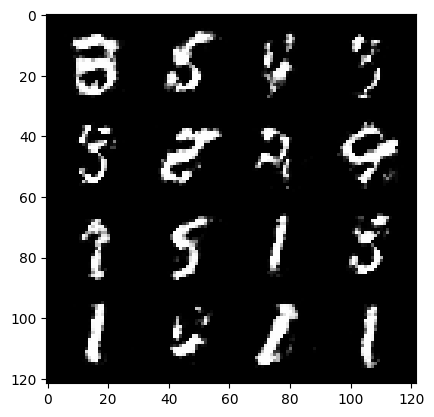

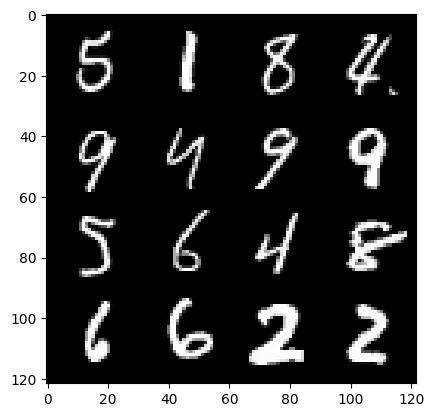

248: step 116400/ gen loss: 1.2655304316679636 / disc loss: 0.46402216980854644


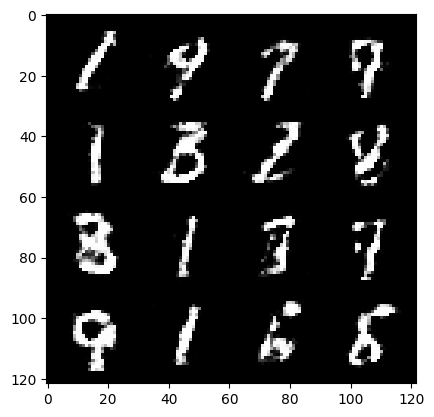

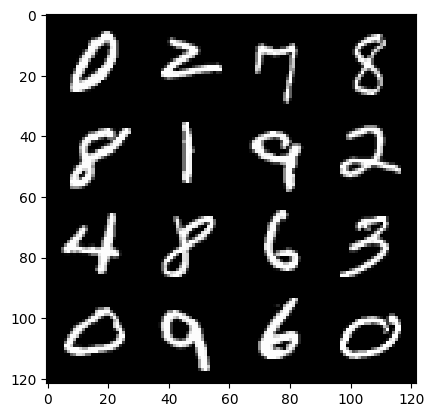

248: step 116700/ gen loss: 1.2330964454015094 / disc loss: 0.4720227404435473


  0%|          | 0/469 [00:00<?, ?it/s]

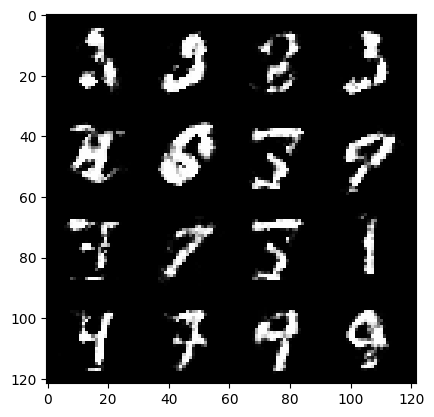

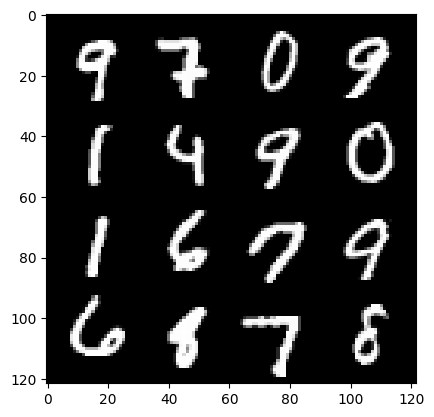

249: step 117000/ gen loss: 1.251784026622772 / disc loss: 0.46537239551544207


  0%|          | 0/469 [00:00<?, ?it/s]

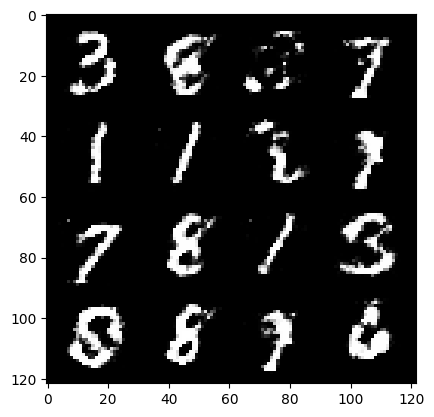

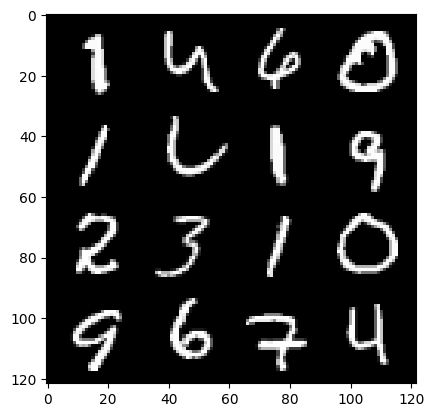

250: step 117300/ gen loss: 1.2506319721539811 / disc loss: 0.46358473996321375


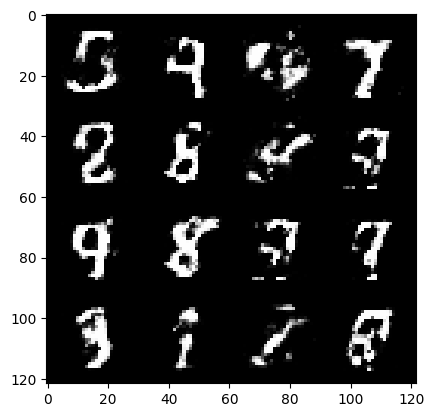

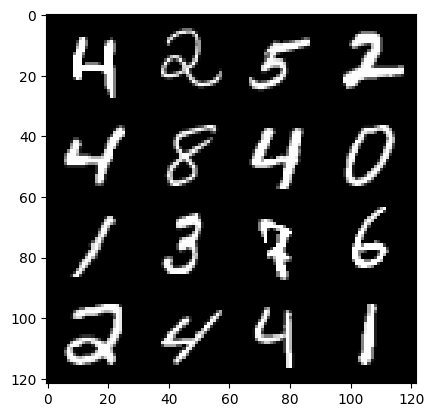

250: step 117600/ gen loss: 1.2328916712601985 / disc loss: 0.4736511904001233


  0%|          | 0/469 [00:00<?, ?it/s]

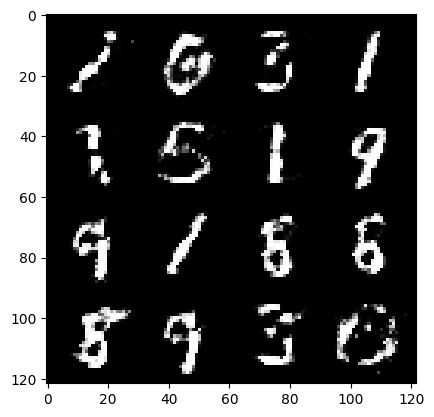

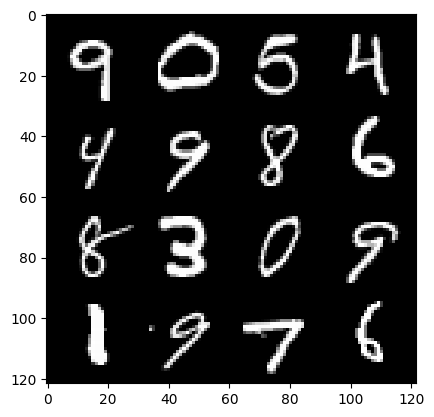

251: step 117900/ gen loss: 1.27552478313446 / disc loss: 0.4593184488018357


  0%|          | 0/469 [00:00<?, ?it/s]

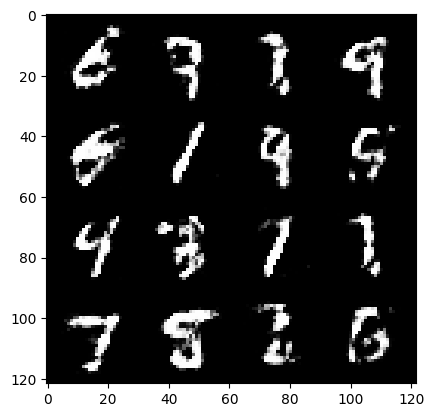

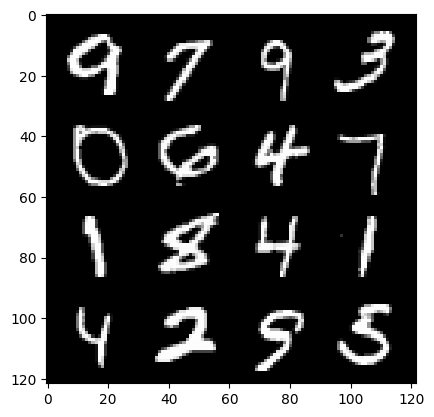

252: step 118200/ gen loss: 1.286111981868744 / disc loss: 0.45616927663485224


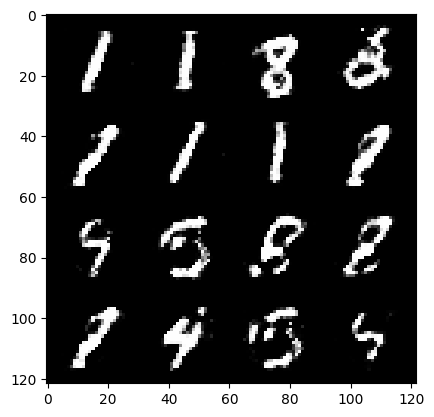

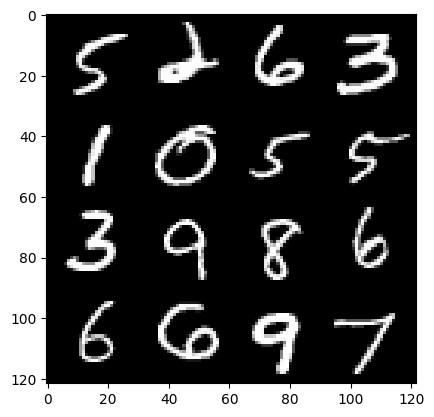

252: step 118500/ gen loss: 1.2043133489290871 / disc loss: 0.48558802833159775


  0%|          | 0/469 [00:00<?, ?it/s]

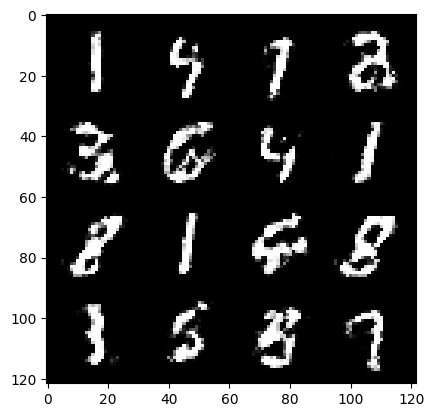

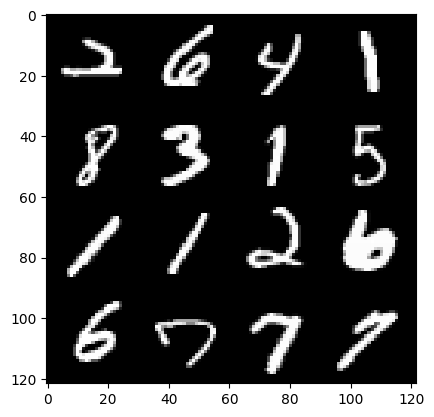

253: step 118800/ gen loss: 1.2325842992464695 / disc loss: 0.4764803919196129


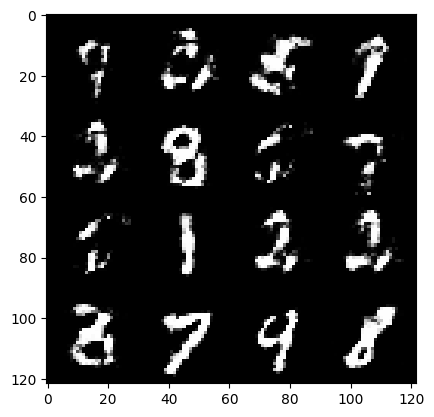

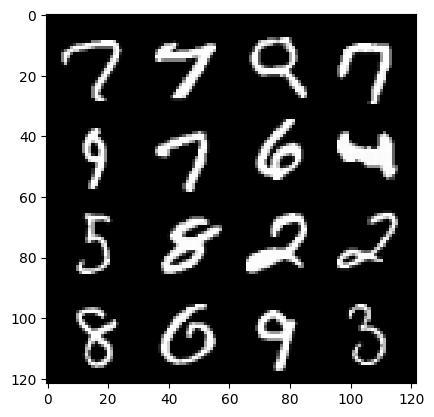

253: step 119100/ gen loss: 1.1954173411925633 / disc loss: 0.4873155866066612


  0%|          | 0/469 [00:00<?, ?it/s]

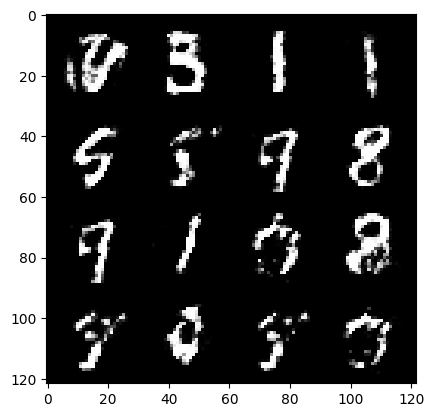

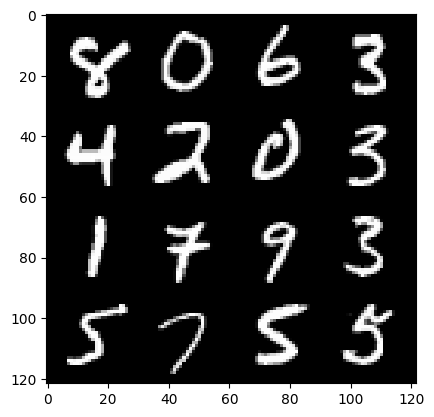

254: step 119400/ gen loss: 1.1793376491467158 / disc loss: 0.4774309365948038


  0%|          | 0/469 [00:00<?, ?it/s]

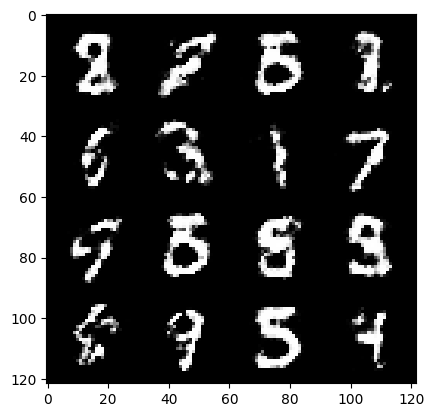

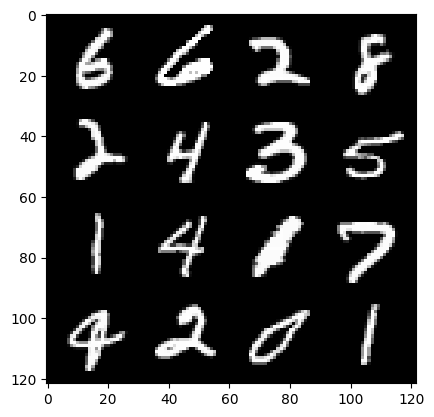

255: step 119700/ gen loss: 1.165069755713145 / disc loss: 0.48812195241451267


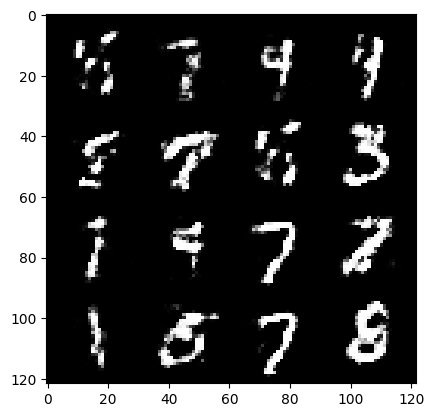

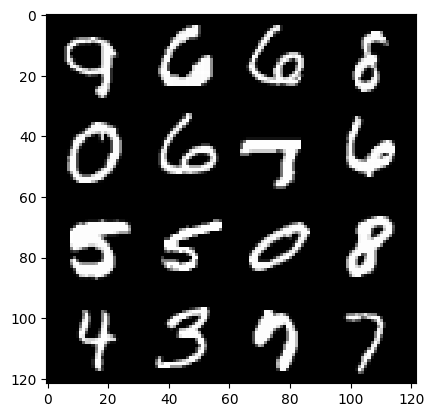

255: step 120000/ gen loss: 1.2115682244300847 / disc loss: 0.4646658336122829


  0%|          | 0/469 [00:00<?, ?it/s]

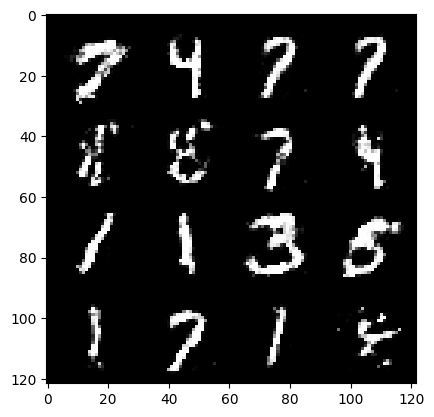

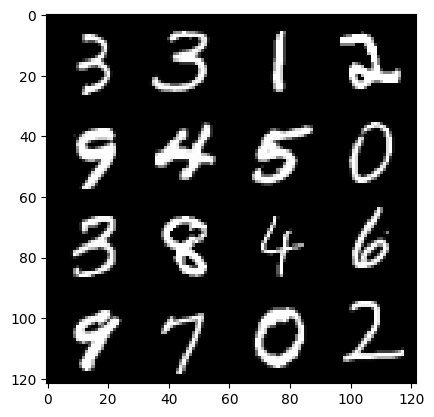

256: step 120300/ gen loss: 1.220130317012469 / disc loss: 0.46936720271905275


  0%|          | 0/469 [00:00<?, ?it/s]

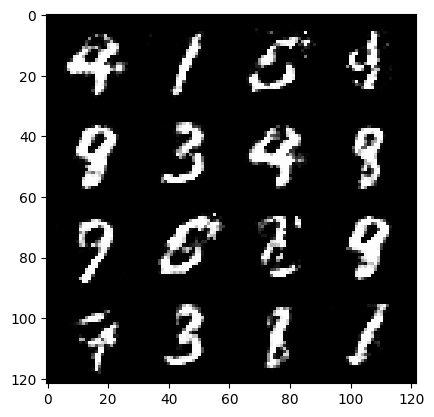

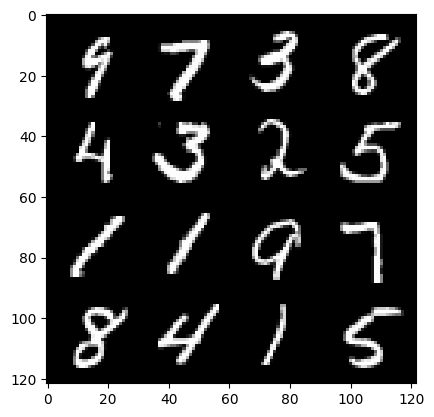

257: step 120600/ gen loss: 1.280413940350215 / disc loss: 0.4609808439016341


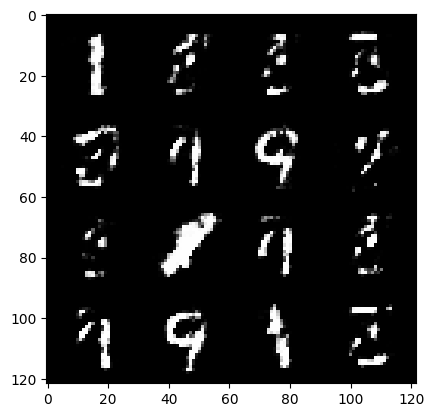

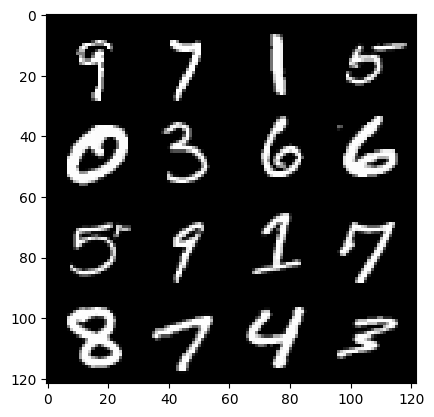

257: step 120900/ gen loss: 1.1937239261468244 / disc loss: 0.4770408382018408


  0%|          | 0/469 [00:00<?, ?it/s]

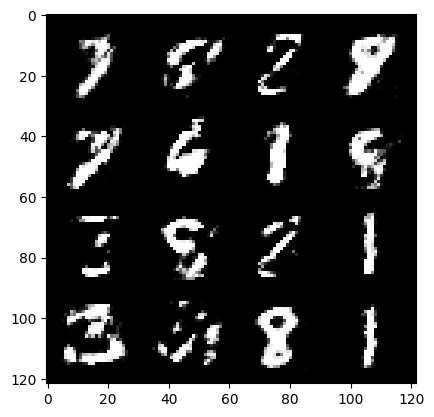

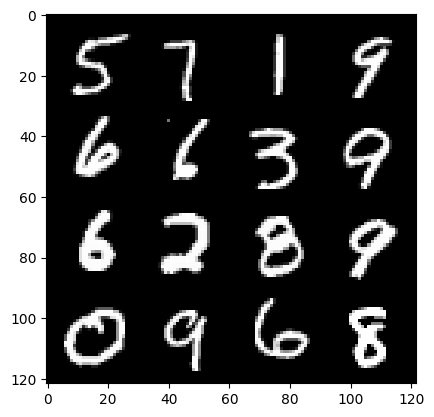

258: step 121200/ gen loss: 1.2210720876852672 / disc loss: 0.46697163244088513


  0%|          | 0/469 [00:00<?, ?it/s]

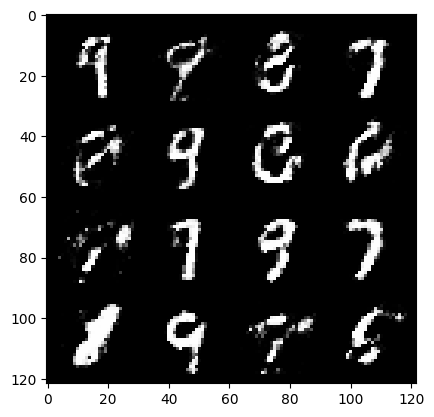

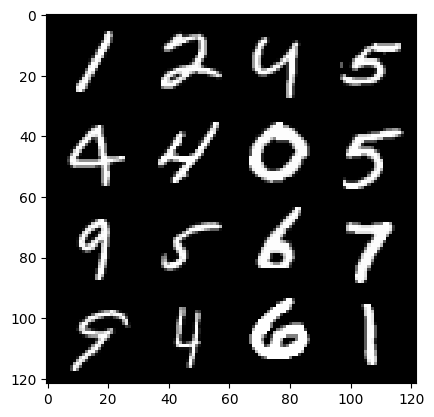

259: step 121500/ gen loss: 1.3173075477282201 / disc loss: 0.4373479381203652


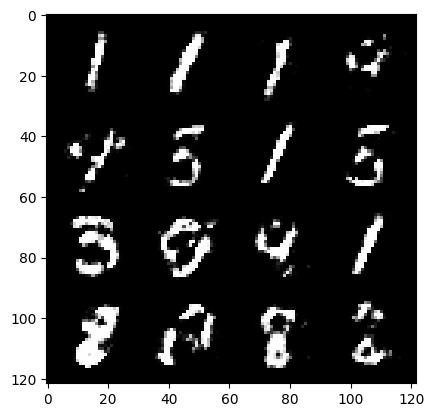

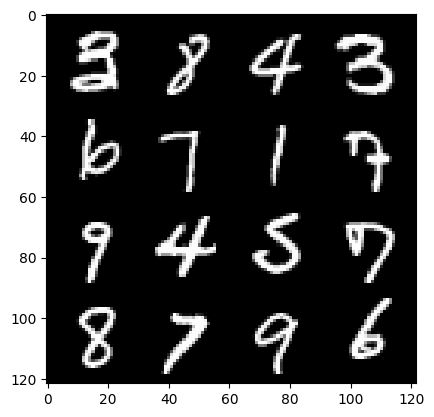

259: step 121800/ gen loss: 1.3031221032142655 / disc loss: 0.43362772474686306


  0%|          | 0/469 [00:00<?, ?it/s]

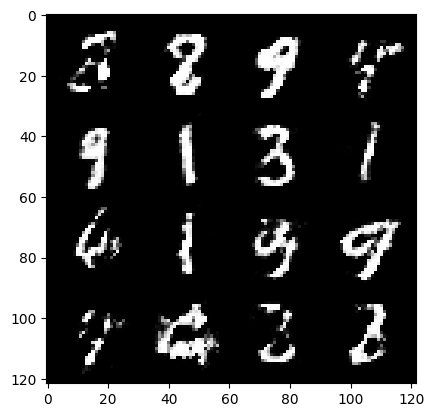

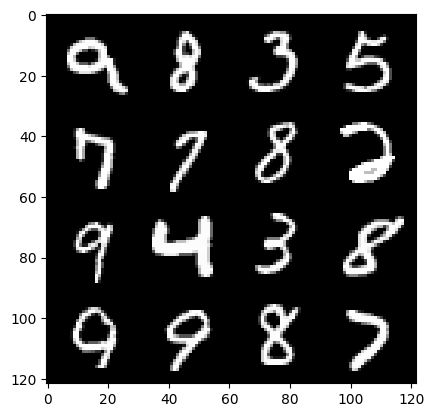

260: step 122100/ gen loss: 1.269133025407791 / disc loss: 0.44768810818592714


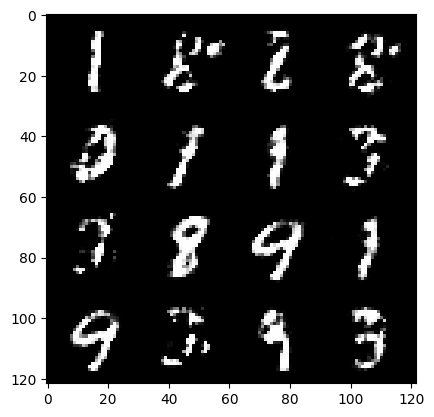

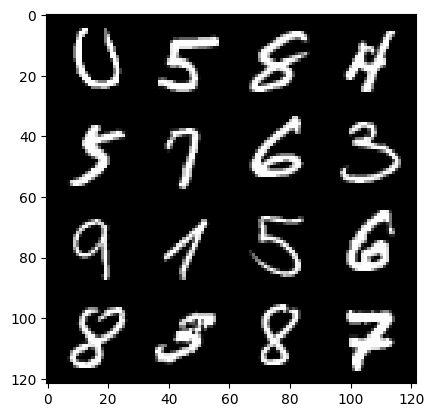

260: step 122400/ gen loss: 1.2988183744748418 / disc loss: 0.4455636722842855


  0%|          | 0/469 [00:00<?, ?it/s]

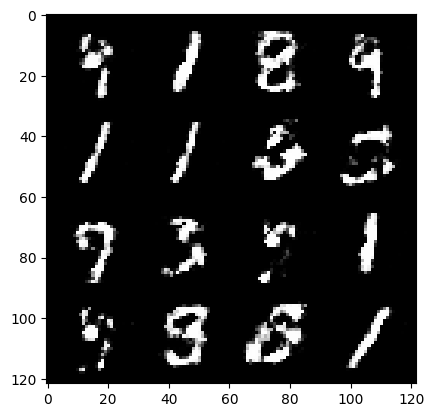

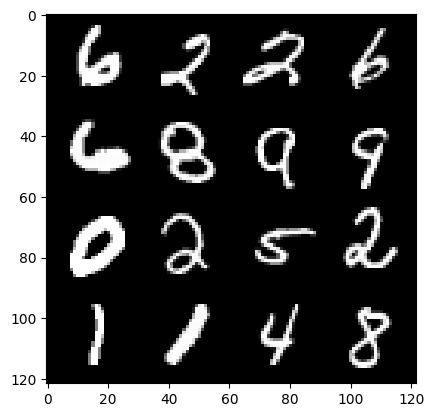

261: step 122700/ gen loss: 1.363473417758941 / disc loss: 0.43187868267297735


  0%|          | 0/469 [00:00<?, ?it/s]

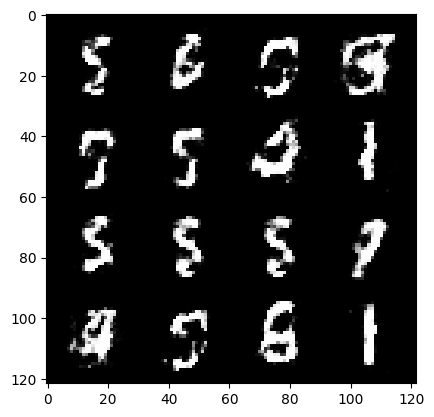

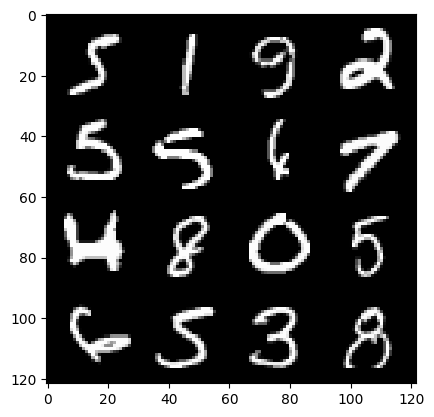

262: step 123000/ gen loss: 1.2582850917180375 / disc loss: 0.4582473859190939


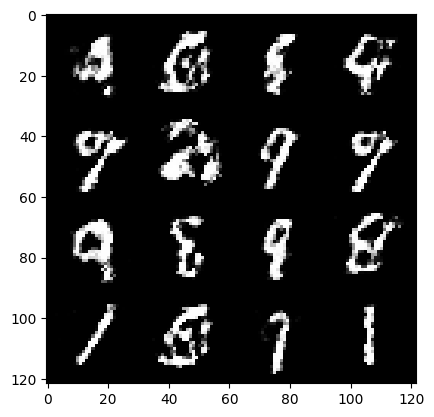

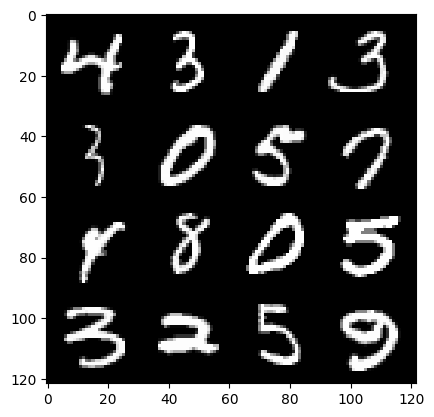

262: step 123300/ gen loss: 1.229148702224096 / disc loss: 0.47014173547426863


  0%|          | 0/469 [00:00<?, ?it/s]

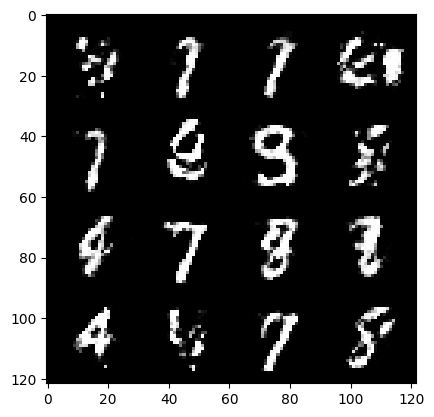

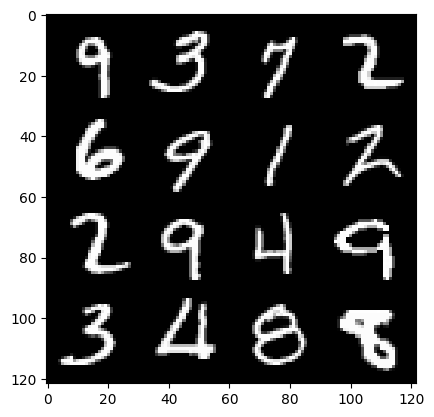

263: step 123600/ gen loss: 1.2316456647713983 / disc loss: 0.4719221613804499


  0%|          | 0/469 [00:00<?, ?it/s]

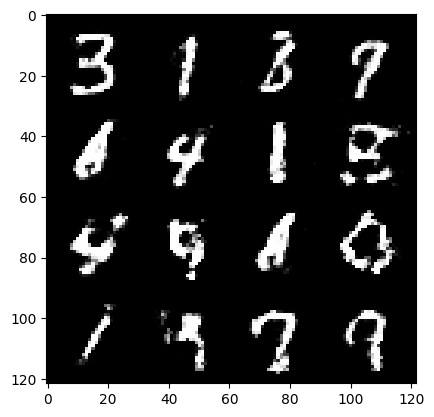

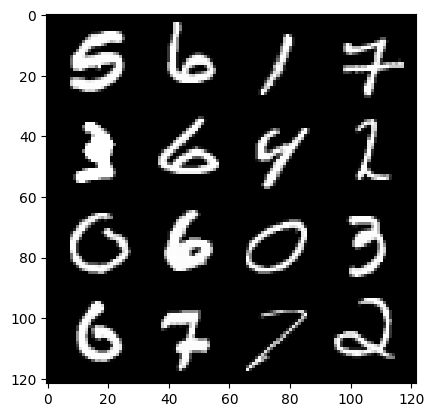

264: step 123900/ gen loss: 1.1856186294555662 / disc loss: 0.4792527449131011


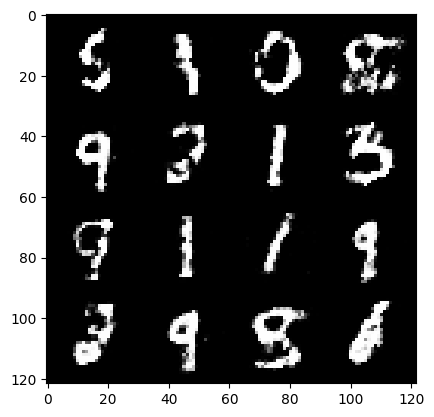

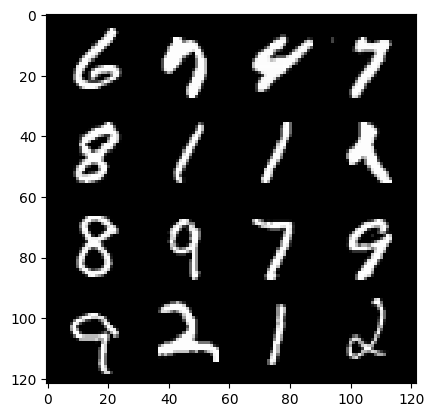

264: step 124200/ gen loss: 1.1856695560614265 / disc loss: 0.48347189803918234


  0%|          | 0/469 [00:00<?, ?it/s]

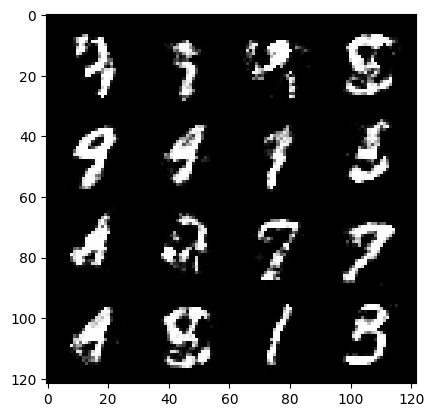

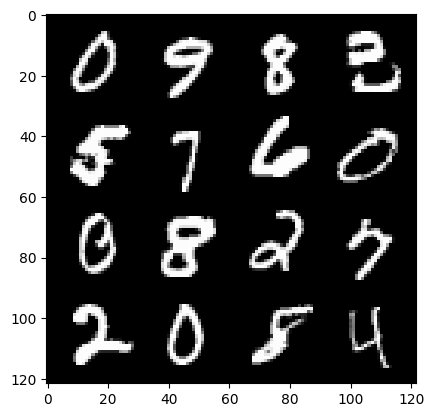

265: step 124500/ gen loss: 1.1665277850627895 / disc loss: 0.4928441901008291


  0%|          | 0/469 [00:00<?, ?it/s]

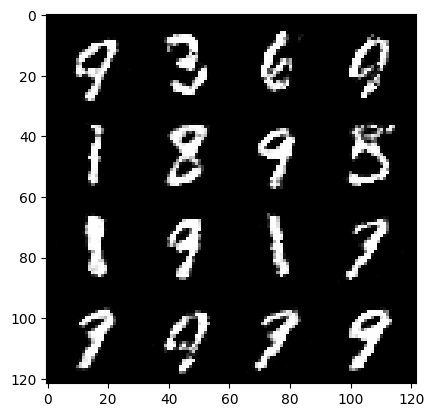

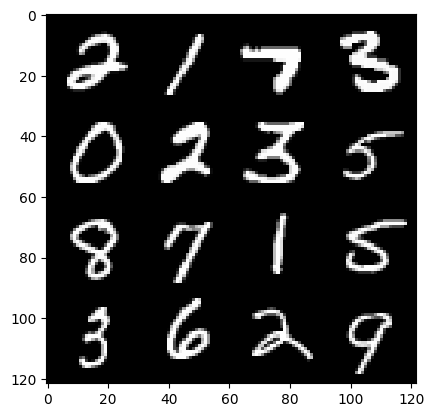

266: step 124800/ gen loss: 1.1932891468207043 / disc loss: 0.4881118664145468


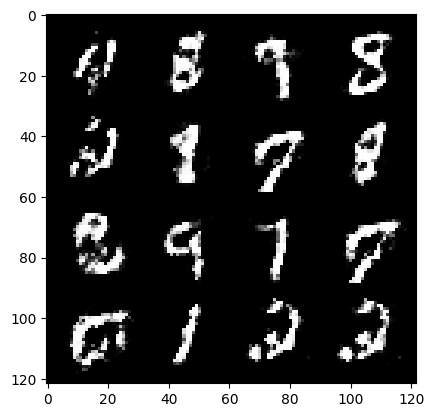

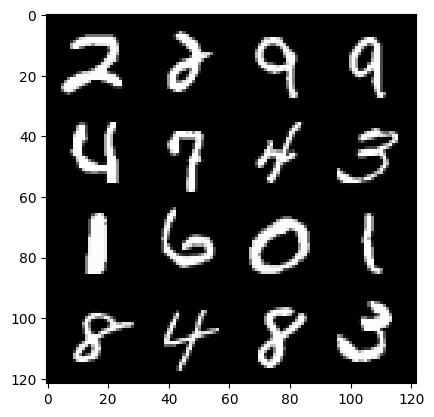

266: step 125100/ gen loss: 1.1946884677807488 / disc loss: 0.48553320874770517


In [ ]:
# training
#### Main loop

for epoch in range(epochs):
  for real,_ in tqdm(dataloader):

    ### discriminator

    disc_opti.zero_grad()

    cur_bs = len(real)  # 128 x 1 x 28 x 28
    real = real.view(cur_bs, -1)   # 128 x 784
    real = real.to(device)

    disc_loss = calc_disc_loss(loss_func, gen, disc, cur_bs, real, z_dim)

    disc_loss.backward(retain_graph=True)
    disc_opti.step()

    ### generator

    gen_opti.zero_grad()
    gen_loss = calc_gen_loss(loss_func,gen,disc,cur_bs,z_dim)
    gen_loss.backward(retain_graph=True)
    gen_opti.step()


    # visualisation

    mean_disc_loss += disc_loss.item()/info_step
    mean_gen_loss += gen_loss.item()/info_step

    if cur_step % info_step == 0 and cur_step >0:
      fake_noise = gen_noise(cur_bs, z_dim)
      fake = gen(fake_noise)
      show(fake)
      show(real)
      print(f"{epoch}: step {cur_step}/ gen loss: {mean_gen_loss} / disc loss: {mean_disc_loss}")
      mean_gen_loss, mean_disc_loss = 0,0
    cur_step += 1

